In [1]:
import numpy as np
import os
import xarray as xr
import glob
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import BoundaryNorm
import matplotlib.colors as mcolors
import dask.array as da
import pickle
from scipy.stats import t

In [2]:
with open('master.pkl', 'rb') as f:
    
    master = pickle.load(f)

In [3]:
## load interpolated u, v, w and q: 

# Step 1: Define the backup directory in your home folder

backup_dir = os.path.expanduser("~/backup_data")  # Expands ~ to full home directory path

file_path = os.path.join(backup_dir, "backup_arrays_for_advection.npz")  # Full path to save file

# Step 5: Load back the saved arrays

data = np.load(file_path)  # Load the .npz file

times=data['times']

lats=data['lats']

lons=data['lons']

interpolated_alt=data['interpolated_alt']

interpolated_pressure = data['interpolated_pressure']

print("interpolated_pressure loaded")

interpolated_q = data['interpolated_q']

print("interpolated_q loaded")

interpolated_u = data['interpolated_u']

print("interpolated_u loaded")

interpolated_v = data['interpolated_v']

print("interpolated_v loaded")

interpolated_w = data['interpolated_w']

print("Arrays successfully loaded!")

interpolated_pressure loaded
interpolated_q loaded
interpolated_u loaded
interpolated_v loaded
Arrays successfully loaded!


In [4]:
## ordering arrays correctly for advection calculation -> they are loaded initially as (time, pressure, lat, lon)

## where pressure goes from bottom to top and latitude is decreasing

## we reverse the order of both so that array goes from top to bottom and latitude is increasing

interpolated_pressure = interpolated_pressure[:, ::-1, ::-1, :] * 100 # converting back to Pa for calculations

interpolated_q = interpolated_q[:, ::-1, ::-1, :]

interpolated_u = interpolated_u[:, ::-1, ::-1, :]

interpolated_v = interpolated_v[:, ::-1, ::-1, :]

interpolated_w = interpolated_w[:, ::-1, ::-1, :]

lats = lats[::-1]

In [5]:
def calculate_horizontal_advection(u, v, q, lat, lon):

    R = 6371000  # radius of Earth (meters)
    
    rho_water = 1000 # kg/m^3
    
    seconds_to_day = 60 * 60 * 24 # to convert from s --> day

    latitude_range = np.sin(np.radians(lat[-1])) - np.sin(np.radians(lat[0]))
    
    longitude_range = np.radians(lon[-1]) - np.radians(lon[0])
    
    lon_grid, lat_grid = np.meshgrid(np.radians(lon), np.radians(lat))
    
    delta_y = np.radians(lat[1]) - np.radians(lat[0])
        
    delta_x = np.radians(lon[1]) - np.radians(lon[0])
    
    # shaped as (#lons, #lats) so first row represents all values for first latitude (eg: 30,30,30...)
    cos_correction = np.cos(lat_grid)
    
    dqdx = np.zeros_like(q)
    
    dqdy = np.zeros_like(q)
    
    # Loop through each pressure level
    
    for k in range(u.shape[0]):
        
        # Central points
    
        dqdx[k, :, 1:-1] = (q[k, :, 2:] - q[k, :, :-2]) / (2 * delta_x)
        dqdy[k, 1:-1, :] = (q[k, 2:, :] - q[k, :-2, :]) / (2 * delta_y)
        
        # Left and right boundaries (x-direction)
        
        dqdx[k, :, 0] = (q[k, :, 1] - q[k, :, 0]) / (delta_x)
        dqdx[k, :, -1] = (q[k, :, -2] - q[k, :, -1]) / (delta_x)

        # Top and bottom boundaries (y-direction)
        
        dqdy[k, 0, :] = (q[k, 1, :] - q[k, 0, :]) / (delta_y)
        dqdy[k, -1, :] = (q[k, -2, :] - q[k, -1, :]) / (delta_y)
        
        dx = R * cos_correction * delta_x
        dy = R * delta_y

        # for every grid point, multiply by the area extent of that grid box 
        
        dqdy[k] = (1/R) * dqdy[k] * dx * dy
        
        dqdx[k] = (1/(R*cos_correction)) * dqdx[k] * dx * dy
        
    meridional_advection = -(v * dqdy)
    
    zonal_advection = -(u * dqdx)
    
    total_area = []
    
    for i in dx: 
        
        total_area.append(i*dy)
        
    A = np.sum(total_area)
        
    # Area weighted average
    zonal_advection_area_weighted = np.sum(zonal_advection, axis=(1,2))*(1/A)*seconds_to_day*rho_water
    
    meridional_advection_area_weighted = np.sum(meridional_advection, axis=(1,2))*(1/A)*seconds_to_day*rho_water

    # Units = 10^3/day 
    # Shapes returned: (#pressure levels) because advection is averaged over the domain for every level 
    
    return zonal_advection_area_weighted, meridional_advection_area_weighted

In [6]:
def calculate_vertical_advection(w, q, pressure, lat, lon):
    
    """
    Calculate vertical advection of specific humidity over a domain without flipping the pressure array.
    
    Args:
        w (ndarray): Vertical velocity (Pa/s), shape = (levels, lat, lon).
        q (ndarray): Specific humidity (kg/kg), shape = (levels, lat, lon).
        pressure (ndarray): Pressure levels (Pa), shape = (levels,).
        lat (ndarray): Latitude values (degrees), shape = (lat,).
        lon (ndarray): Longitude values (degrees), shape = (lon,).
    
    Returns:
        vertical_advection_area_weighted (ndarray): Area-weighted vertical advection (10^3/day),
                                                    shape = (levels,).
    """
    
    R = 6371000  # radius of Earth (meters)
    
    rho_water = 1000  # kg/m^3
    
    seconds_to_day = 60 * 60 * 24  # to convert from s --> day

    # Grid spacing and corrections
    delta_y = np.radians(lat[1]) - np.radians(lat[0])
    
    delta_x = np.radians(lon[1]) - np.radians(lon[0])
    
    lon_grid, lat_grid = np.meshgrid(np.radians(lon), np.radians(lat))
    
    cos_correction = np.cos(lat_grid)

    dx = R * cos_correction * delta_x  # Zonal grid spacing in meters
    
    dy = R * delta_y                   # Meridional grid spacing in meters
    
    grid_area = dx * dy                # Area of each grid cell (lat, lon)
    
    total_area = np.sum(grid_area)     # Total domain area
        
    # Initialize the vertical gradient array
    dqdp = np.zeros_like(q)

    # Compute vertical gradient of specific humidity (dq/dp)
    
    for j in range(1, q.shape[0] - 1):  # Central differencing for interior levels
        
        dqdp[j, :, :] = (q[j - 1, :, :] - q[j + 1, :, :]) / (pressure[j - 1, :, :] - pressure[j + 1, :, :])

    # Forward/backward differencing for boundaries
    dqdp[0, :, :] = (q[0, :, :] - q[1, :, :]) / (pressure[0, :, :] - pressure[1, :, :])
    
    dqdp[-1, :, :] = (q[-2, :, :] - q[-1, :, :]) / (pressure[-2, :, :] - pressure[-1, :, :])

    # Vertical advection term: -omega * dq/dp
    vertical_advection = -(w * dqdp)  # Shape = (levels, lat, lon)
    
    # Area-weighted average across the domain for each pressure level
    vertical_advection_area_weighted = np.sum(vertical_advection * grid_area, axis=(1, 2)) / total_area

    # Convert to mm/day
    vertical_advection_area_weighted *= seconds_to_day * rho_water  

    return vertical_advection_area_weighted

### applying to APEs vs. non-APEs to check that vertical profiles make sense

In [7]:
# removing borders, otherwise can't calculate advection across a 1 deg by 1 deg domain 

apes = master[(master['APE']==True) & 
              (master['latitude'] <= 38.5) & 
              (master['latitude'] >= 30.5) & 
              (master['longitude'] >= -104.5) & 
              (master['longitude'] <= -94.5)][['date','latitude','longitude']].reset_index(drop=True)

nonapes = master[(master['APE']==False) & 
              (master['latitude'] <= 38.5) & 
              (master['latitude'] >= 30.5) & 
              (master['longitude'] >= -104.5) & 
              (master['longitude'] <= -94.5)][['date','latitude','longitude']].reset_index(drop=True)

dryapes = master[(master['dryape']==True) & 
              (master['latitude'] <= 38.5) & 
              (master['latitude'] >= 30.5) & 
              (master['longitude'] >= -104.5) & 
              (master['longitude'] <= -94.5)][['date','latitude','longitude']].reset_index(drop=True)

wetapes = master[(master['wetape']==True) & 
              (master['latitude'] <= 38.5) & 
              (master['latitude'] >= 30.5) & 
              (master['longitude'] >= -104.5) & 
              (master['longitude'] <= -94.5)][['date','latitude','longitude']].reset_index(drop=True)

In [11]:
# wet ape case

small = master[(master['latitude']==38) & (master['longitude']==-104)].reset_index(drop=True)

test_case = small[small['date']==small['date'].iloc[0]].reset_index(drop=True)

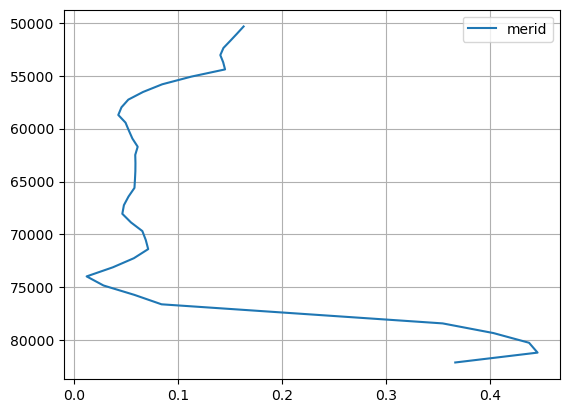

In [21]:
target_date = test_case['date'].iloc[0]

target_lat = test_case['latitude'].iloc[0]

target_lon = test_case['longitude'].iloc[0]

target_date = np.datetime64(target_date)

date_idx = np.where(times == target_date)[0][0]

lat_idx = np.where(lats == target_lat)[0][0]

lon_idx = np.where(lons == target_lon)[0][0]

# Define the center point and half-window (in degrees)

delta = 0.5

lat_mask = (lats >= (target_lat - delta)) & (lats <= (target_lat + delta))

lon_mask = (lons >= (target_lon - delta)) & (lons <= (target_lon + delta))

lat_indices = np.where(lat_mask)[0]

lon_indices = np.where(lon_mask)[0]

lat_mini = lats[lat_indices]

lon_mini = lons[lon_indices]

# select specific time, lat and lon (and surrounding boundary) for every APE

# these all have shapes (pressure_levels, mini_lat, mini_lon) (29, 5, 5)

p_mini = interpolated_pressure[date_idx, :, :, :]

p_mini = p_mini[:, lat_mask, :][:, :, lon_mask]

u_mini = interpolated_u[date_idx, :, :, :]

u_mini = u_mini[:, lat_mask, :][:, :, lon_mask]

v_mini = interpolated_v[date_idx, :, :, :]

v_mini = v_mini[:, lat_mask, :][:, :, lon_mask]

q_mini = interpolated_q[date_idx, :, :, :]

q_mini = q_mini[:, lat_mask, :][:, :, lon_mask]

w_mini = interpolated_w[date_idx, :, :, :]

w_mini = w_mini[:, lat_mask, :][:, :, lon_mask]

# horizontal advection

zonal_adv, merid_adv = calculate_horizontal_advection(u_mini, v_mini, q_mini, lat_mini, lon_mini)

# vertical advection

vertical_adv = calculate_vertical_advection(w_mini, q_mini, p_mini, lat_mini, lon_mini)

# plt.plot(zonal_adv[::-1], p_mini[:, 1, 1][::-1], label='zonal')

plt.plot(merid_adv[::-1], p_mini[:, 1, 1][::-1], label='merid')

# plt.plot(vertical_adv[::-1], p_mini[:, 1, 1][::-1], label='vertical')

plt.gca().invert_yaxis()

# plt.ylim(80000, 50000)

# plt.xlim(-0.5, 0.2)

plt.legend()

plt.grid()

plt.show()

In [349]:
# for apes: 

all_zonal_profiles = []

all_meridional_profiles = []

all_vertical_profiles = []

for ape_date in range(apes.shape[0]):
    
    print(apes['date'].iloc[ape_date])
    
    target_date = apes['date'].iloc[ape_date]  
    
    target_date = np.datetime64(target_date)

    # Now find the index in daily_avg['time'].data
    
    date_idx = np.where(times == target_date)[0][0]
        
    lat_idx = apes['latitude'].iloc[ape_date]

    lon_idx = apes['longitude'].iloc[ape_date]

    # Define the center point and half-window (in degrees)

    delta = 0.5

    lat_mask = (latitude >= (lat_idx - delta)) & (latitude <= (lat_idx + delta))

    lon_mask = (longitude >= (lon_idx - delta)) & (longitude <= (lon_idx + delta))

    lat_indices = np.where(lat_mask)[0]

    lon_indices = np.where(lon_mask)[0]

    lat_mini = latitude[lat_indices]

    lon_mini = longitude[lon_indices]

    # select specific time, lat and lon (and surrounding boundary) for every APE

    # these all have shapes (pressure_levels, mini_lat, mini_lon) (29, 5, 5)
    
    p_mini = interpolated_p[date_idx, :, :, :]
    
    p_mini = p_mini[:, lat_mask, :][:, :, lon_mask]

    u_mini = interpolated_u[date_idx, :, :, :]

    u_mini = u_mini[:, lat_mask, :][:, :, lon_mask]

    v_mini = interpolated_v[date_idx, :, :, :]

    v_mini = v_mini[:, lat_mask, :][:, :, lon_mask]

    q_mini = interpolated_q[date_idx, :, :, :]

    q_mini = q_mini[:, lat_mask, :][:, :, lon_mask]

    w_mini = interpolated_w[date_idx, :, :, :]

    w_mini = w_mini[:, lat_mask, :][:, :, lon_mask]

    # to append

    zonal_advection_profile = []

    meridional_advection_profile = []

    vertical_advection_profile = []

    # horizontal advection

    zonal_adv, merid_adv = calculate_horizontal_advection(u_mini, v_mini, q_mini, lat_mini, lon_mini)

    # vertical advection

    vertical_adv = calculate_vertical_advection(w_mini, q_mini, pressure, lat_mini, lon_mini)
    
    all_zonal_profiles.append(zonal_adv)
    
    all_meridional_profiles.append(merid_adv)
    
    all_vertical_profiles.append(vertical_adv)

#     plt.plot(zonal_adv, pressure, label='zonal')

#     plt.plot(merid_adv, pressure, label='merid')

#     plt.plot(vertical_adv, pressure, label='vertical')

#     plt.gca().invert_yaxis()

#     plt.legend()

#     plt.show()

2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-20 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-28 00:00:00
2001-05-29 00:00:00
2001-05-31 00:00:00
2001-06-02 00:00:00
2001-06-03 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-20 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-04 00:00:00
2001-07-09 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-05 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-28 00:00:00


2008-06-29 00:00:00
2008-06-30 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-16 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-10 00:00:00
2008-09-19 00:00:00
2008-09-21 00:00:00
2009-05-02 00:00:00
2009-05-03 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-19 00:00:00
2009-05-20 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-28 00:00:00
2009-05-29 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-04 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00


2017-06-27 00:00:00
2017-06-28 00:00:00
2017-06-29 00:00:00
2017-07-03 00:00:00
2017-07-06 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-02 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-08-30 00:00:00
2017-09-07 00:00:00
2017-09-08 00:00:00
2017-09-10 00:00:00
2017-09-11 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-15 00:00:00
2018-05-20 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-28 00:00:00


2008-05-08 00:00:00
2008-05-20 00:00:00
2008-05-23 00:00:00
2008-05-31 00:00:00
2008-06-03 00:00:00
2008-06-05 00:00:00
2008-06-08 00:00:00
2008-06-11 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-30 00:00:00
2008-07-02 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-07-31 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-16 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-10 00:00:00
2008-09-19 00:00:00
2008-09-21 00:00:00
2008-09-26 00:00:00


2016-05-01 00:00:00
2016-05-06 00:00:00
2016-05-07 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-15 00:00:00
2016-05-16 00:00:00
2016-05-19 00:00:00
2016-05-20 00:00:00
2016-05-23 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-02 00:00:00
2016-06-05 00:00:00
2016-06-07 00:00:00
2016-06-13 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-15 00:00:00
2016-08-16 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00


2005-05-28 00:00:00
2005-05-31 00:00:00
2005-06-01 00:00:00
2005-06-02 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-21 00:00:00
2005-06-22 00:00:00
2005-06-23 00:00:00
2005-06-24 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-20 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-08 00:00:00
2005-08-15 00:00:00
2005-08-17 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-04 00:00:00
2005-09-07 00:00:00
2005-09-09 00:00:00
2005-09-14 00:00:00
2005-09-24 00:00:00
2006-05-07 00:00:00
2006-05-09 00:00:00


2013-07-26 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-01 00:00:00
2013-08-03 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-21 00:00:00
2013-08-24 00:00:00
2013-08-31 00:00:00
2013-09-02 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-14 00:00:00
2013-09-18 00:00:00
2014-05-02 00:00:00
2014-05-03 00:00:00
2014-05-05 00:00:00
2014-05-09 00:00:00
2014-05-10 00:00:00
2014-05-14 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-27 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-08 00:00:00
2014-06-10 00:00:00
2014-06-11 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-09 00:00:00
2014-07-12 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00


2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-10 00:00:00
2004-07-14 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-15 00:00:00
2004-08-30 00:00:00
2004-09-06 00:00:00
2004-09-10 00:00:00
2004-09-12 00:00:00
2004-09-13 00:00:00
2004-09-14 00:00:00
2004-09-24 00:00:00
2004-09-26 00:00:00
2004-09-29 00:00:00
2005-05-04 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-23 00:00:00
2005-05-27 00:00:00
2005-05-28 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-23 00:00:00
2005-06-24 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00


2012-08-26 00:00:00
2012-09-02 00:00:00
2012-09-03 00:00:00
2012-09-12 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-25 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-13 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-23 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-03 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-09 00:00:00


2002-09-14 00:00:00
2002-09-17 00:00:00
2002-09-24 00:00:00
2002-09-29 00:00:00
2003-05-04 00:00:00
2003-05-07 00:00:00
2003-05-08 00:00:00
2003-05-13 00:00:00
2003-05-18 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-27 00:00:00
2003-05-29 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-28 00:00:00
2003-07-01 00:00:00
2003-07-05 00:00:00
2003-07-07 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-23 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-31 00:00:00


2011-06-08 00:00:00
2011-06-11 00:00:00
2011-06-16 00:00:00
2011-06-28 00:00:00
2011-07-03 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-26 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2012-05-18 00:00:00
2012-05-20 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-06 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00


2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-19 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-29 00:00:00
2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-06 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2002-05-10 00:00:00
2002-05-11 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-23 00:00:00
2002-05-28 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-11 00:00:00
2002-06-14 00:00:00
2002-06-15 00:00:00
2002-06-17 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-23 00:00:00
2002-07-27 00:00:00
2002-07-29 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00


2009-08-25 00:00:00
2009-08-26 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-08 00:00:00
2010-05-09 00:00:00
2010-05-11 00:00:00
2010-05-12 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-19 00:00:00
2010-05-21 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-06 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00


2018-05-11 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-22 00:00:00
2018-06-23 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-25 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-25 00:00:00
2018-08-31 00:00:00
2018-09-04 00:00:00
2018-09-09 00:00:00
2018-09-11 00:00:00
2018-09-15 00:00:00


2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-08-05 00:00:00
2008-08-09 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-16 00:00:00
2008-08-19 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-10 00:00:00
2008-09-12 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2008-09-27 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-15 00:00:00
2009-05-19 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00


2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-03 00:00:00
2016-09-06 00:00:00
2016-09-17 00:00:00
2016-09-23 00:00:00
2017-05-02 00:00:00
2017-05-06 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-25 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-28 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-06 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-12 00:00:00
2017-06-17 00:00:00
2017-06-25 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00


2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-28 00:00:00
2006-08-31 00:00:00
2006-09-07 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-15 00:00:00
2006-09-22 00:00:00
2006-09-27 00:00:00
2007-05-04 00:00:00
2007-05-09 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-22 00:00:00
2007-05-26 00:00:00
2007-05-29 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-26 00:00:00
2007-07-03 00:00:00
2007-07-08 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-04 00:00:00
2007-08-06 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-15 00:00:00


2016-08-10 00:00:00
2016-08-13 00:00:00
2016-08-14 00:00:00
2016-08-15 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-26 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-06 00:00:00
2016-09-17 00:00:00
2017-05-01 00:00:00
2017-05-02 00:00:00
2017-05-06 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-28 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-06 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-17 00:00:00
2017-06-22 00:00:00
2017-06-24 00:00:00
2017-06-25 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00


2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-27 00:00:00
2006-08-31 00:00:00
2006-09-03 00:00:00
2006-09-10 00:00:00
2006-09-15 00:00:00
2006-09-22 00:00:00
2006-09-27 00:00:00
2007-05-04 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-26 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-21 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-08-04 00:00:00
2007-08-06 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-14 00:00:00
2007-08-15 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00


2015-07-08 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-19 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-25 00:00:00
2015-08-27 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-03 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-22 00:00:00
2015-09-24 00:00:00
2015-09-25 00:00:00
2016-05-04 00:00:00
2016-05-06 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-30 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-06 00:00:00
2016-06-07 00:00:00
2016-06-08 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00


2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-22 00:00:00
2007-06-26 00:00:00
2007-07-03 00:00:00
2007-07-08 00:00:00
2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-14 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-09-02 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-12 00:00:00
2007-09-15 00:00:00
2007-09-17 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-03 00:00:00
2008-06-05 00:00:00
2008-06-11 00:00:00
2008-06-18 00:00:00


2015-09-13 00:00:00
2015-09-15 00:00:00
2015-09-22 00:00:00
2015-09-24 00:00:00
2016-05-04 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-01 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-17 00:00:00
2016-06-20 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00


2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-14 00:00:00
2005-09-20 00:00:00
2005-09-24 00:00:00
2006-05-03 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-12 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-06-02 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-07-01 00:00:00
2006-07-03 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-25 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00


2014-06-11 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-29 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-11 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-08-01 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-14 00:00:00
2014-08-16 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-23 00:00:00
2015-05-02 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-14 00:00:00
2015-05-17 00:00:00
2015-05-18 00:00:00
2015-05-24 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00


2004-08-14 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-04 00:00:00
2004-09-06 00:00:00
2004-09-13 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2004-09-27 00:00:00
2005-05-02 00:00:00
2005-05-03 00:00:00
2005-05-05 00:00:00
2005-05-08 00:00:00
2005-05-09 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-06-01 00:00:00
2005-06-02 00:00:00
2005-06-06 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-27 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-31 00:00:00


2013-06-16 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-10 00:00:00
2013-07-14 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-11 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-18 00:00:00
2014-05-08 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-06-01 00:00:00
2014-06-03 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-20 00:00:00


2003-07-21 00:00:00
2003-07-28 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-26 00:00:00
2003-08-29 00:00:00
2003-09-09 00:00:00
2004-05-03 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-29 00:00:00
2004-06-04 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-16 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-05 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-27 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-18 00:00:00
2004-08-20 00:00:00


2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-28 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-11 00:00:00
2012-08-15 00:00:00
2012-08-21 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-25 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-10 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-05 00:00:00


2003-06-28 00:00:00
2003-07-07 00:00:00
2003-07-19 00:00:00
2003-07-21 00:00:00
2003-07-28 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-29 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2004-05-03 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-22 00:00:00
2004-06-04 00:00:00
2004-06-08 00:00:00
2004-06-24 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-05 00:00:00
2004-07-09 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-24 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-08 00:00:00
2004-08-18 00:00:00


2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-11 00:00:00
2012-09-25 00:00:00
2013-05-06 00:00:00
2013-05-08 00:00:00
2013-05-10 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00
2013-06-07 00:00:00
2013-06-09 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-07 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-15 00:00:00


2003-08-29 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-22 00:00:00
2004-06-08 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-16 00:00:00
2004-06-24 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-18 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-04 00:00:00
2004-09-10 00:00:00
2004-09-13 00:00:00


2013-06-07 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-05 00:00:00
2013-07-07 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-30 00:00:00
2013-08-31 00:00:00
2013-09-10 00:00:00
2013-09-12 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00
2014-05-15 00:00:00
2014-05-21 00:00:00
2014-05-29 00:00:00
2014-06-01 00:00:00
2014-06-03 00:00:00
2014-06-11 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00


2005-05-29 00:00:00
2005-06-06 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-18 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-31 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-22 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2005-09-14 00:00:00
2005-09-29 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-23 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00


2014-09-22 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-17 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-05 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-07 00:00:00
2015-07-11 00:00:00
2015-07-13 00:00:00
2015-07-17 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-06 00:00:00
2015-08-07 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-21 00:00:00
2015-08-27 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-15 00:00:00
2015-09-20 00:00:00
2015-09-29 00:00:00
2016-05-01 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00


2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-28 00:00:00
2006-09-04 00:00:00
2006-09-08 00:00:00
2006-09-09 00:00:00
2006-09-10 00:00:00
2006-09-23 00:00:00
2006-09-27 00:00:00
2007-05-01 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-06 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-19 00:00:00
2007-06-23 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-15 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-10 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00


2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2017-05-03 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-13 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-19 00:00:00
2017-06-20 00:00:00
2017-06-21 00:00:00
2017-06-22 00:00:00
2017-06-29 00:00:00
2017-07-02 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-22 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-05 00:00:00
2017-08-08 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-19 00:00:00
2017-09-01 00:00:00
2017-09-13 00:00:00


2008-09-20 00:00:00
2008-09-24 00:00:00
2009-05-02 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-28 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-30 00:00:00
2009-07-02 00:00:00
2009-07-08 00:00:00
2009-07-11 00:00:00
2009-07-12 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-22 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00


2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-12 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00
2002-05-26 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-22 00:00:00
2002-06-30 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-16 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-26 00:00:00
2002-07-28 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-12 00:00:00


2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-25 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-24 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-17 00:00:00
2013-05-21 00:00:00
2013-05-26 00:00:00
2013-05-31 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-05 00:00:00
2013-07-07 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00


2005-05-09 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-17 00:00:00
2005-05-20 00:00:00
2005-05-21 00:00:00
2005-05-25 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-06-04 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-18 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-17 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-31 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-15 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00


2016-05-27 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2017-05-03 00:00:00
2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00


2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-20 00:00:00
2008-09-24 00:00:00
2008-09-28 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-29 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-11 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-23 00:00:00
2009-07-25 00:00:00
2009-07-28 00:00:00
2009-08-02 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-14 00:00:00
2009-08-24 00:00:00
2009-08-28 00:00:00
2009-08-30 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-22 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-03 00:00:00
2010-05-16 00:00:00


2002-05-22 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-11 00:00:00
2002-06-13 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-30 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-08-01 00:00:00
2002-08-04 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-30 00:00:00
2002-09-14 00:00:00
2003-05-03 00:00:00
2003-05-04 00:00:00
2003-05-05 00:00:00
2003-05-13 00:00:00
2003-06-05 00:00:00
2003-06-09 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-24 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00


2014-05-26 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-26 00:00:00
2014-06-30 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-08-06 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-04 00:00:00
2014-09-20 00:00:00
2015-05-03 00:00:00
2015-05-05 00:00:00
2015-05-07 00:00:00
2015-05-09 00:00:00
2015-05-13 00:00:00
2015-05-17 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-03 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-01 00:00:00
2015-07-04 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00
2015-07-13 00:00:00
2015-07-17 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00


2008-05-26 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-06-15 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-08 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-07 00:00:00
2008-09-28 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-10 00:00:00
2009-06-15 00:00:00
2009-06-21 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-07-02 00:00:00
2009-07-11 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00


2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-13 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-06-30 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-08-01 00:00:00
2002-08-04 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-14 00:00:00
2002-09-19 00:00:00
2002-09-29 00:00:00
2003-05-03 00:00:00
2003-05-04 00:00:00
2003-05-05 00:00:00
2003-05-15 00:00:00
2003-06-05 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-07-07 00:00:00


2016-05-22 00:00:00
2016-05-26 00:00:00
2016-05-30 00:00:00
2016-06-06 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-18 00:00:00
2016-07-24 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-16 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-24 00:00:00
2017-05-03 00:00:00
2017-05-10 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-06 00:00:00
2017-06-15 00:00:00
2017-06-20 00:00:00
2017-06-23 00:00:00


2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-01 00:00:00
2010-08-03 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-08 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-22 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-05-19 00:00:00
2011-05-23 00:00:00
2011-06-01 00:00:00
2011-06-04 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-18 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-28 00:00:00
2011-07-31 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00


2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-19 00:00:00
2005-06-21 00:00:00
2005-06-30 00:00:00
2005-07-03 00:00:00
2005-07-07 00:00:00
2005-07-09 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-09-02 00:00:00
2005-09-07 00:00:00
2005-09-19 00:00:00
2006-05-22 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-21 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-25 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-25 00:00:00
2006-09-22 00:00:00
2006-09-27 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-04 00:00:00
2007-05-23 00:00:00
2007-05-29 00:00:00
2007-06-01 00:00:00
2007-06-02 00:00:00
2007-06-04 00:00:00


2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-21 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-15 00:00:00
2001-05-03 00:00:00
2001-05-09 00:00:00
2001-05-16 00:00:00
2001-05-22 00:00:00
2001-05-27 00:00:00
2001-06-01 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-27 00:00:00
2001-07-03 00:00:00
2001-07-09 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-16 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00


2013-07-13 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-29 00:00:00
2013-08-11 00:00:00
2013-08-29 00:00:00
2013-08-31 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2013-09-23 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-17 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-05-31 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-29 00:00:00
2014-07-19 00:00:00
2014-07-25 00:00:00
2014-07-29 00:00:00
2014-08-02 00:00:00
2014-08-03 00:00:00
2014-08-04 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-26 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-19 00:00:00
2014-09-20 00:00:00
2014-09-25 00:00:00
2015-05-01 00:00:00
2015-05-03 00:00:00
2015-05-07 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-23 00:00:00
2015-05-24 00:00:00


2009-07-07 00:00:00
2009-07-11 00:00:00
2009-07-14 00:00:00
2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-27 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-14 00:00:00
2009-08-25 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-12 00:00:00
2009-09-25 00:00:00
2010-05-10 00:00:00
2010-05-23 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-02 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-12 00:00:00
2010-07-14 00:00:00
2010-07-20 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-30 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-08 00:00:00


2004-06-24 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-12 00:00:00
2004-07-14 00:00:00
2004-07-15 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-28 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-14 00:00:00
2004-08-19 00:00:00
2004-08-30 00:00:00
2004-09-01 00:00:00
2004-09-05 00:00:00
2004-09-28 00:00:00
2004-09-29 00:00:00
2005-05-06 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-16 00:00:00
2005-05-18 00:00:00
2005-05-31 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-21 00:00:00
2005-06-25 00:00:00
2005-06-30 00:00:00
2005-07-06 00:00:00
2005-07-12 00:00:00
2005-07-25 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-14 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-31 00:00:00
2005-09-02 00:00:00
2005-09-04 00:00:00
2005-09-07 00:00:00


2018-05-06 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-29 00:00:00
2018-06-11 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-21 00:00:00
2018-08-28 00:00:00
2018-09-01 00:00:00
2018-09-05 00:00:00
2018-09-15 00:00:00
2018-09-17 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-09 00:00:00
2001-05-13 00:00:00
2001-05-22 00:00:00
2001-05-27 00:00:00
2001-05-29 00:00:00
2001-06-01 00:00:00
2001-06-05 00:00:00
2001-06-16 00:00:00
2001-06-27 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00


2012-09-17 00:00:00
2012-09-18 00:00:00
2013-05-06 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-07 00:00:00
2013-06-16 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-27 00:00:00
2013-07-04 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-15 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-06-06 00:00:00
2014-06-09 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-24 00:00:00
2014-06-29 00:00:00
2014-07-16 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-09-05 00:00:00
2014-09-17 00:00:00


2008-08-20 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-03 00:00:00
2009-05-05 00:00:00
2009-05-10 00:00:00
2009-05-13 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-12 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-08 00:00:00
2009-07-11 00:00:00
2009-07-27 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-14 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-30 00:00:00
2009-09-12 00:00:00
2009-09-23 00:00:00
2010-05-02 00:00:00
2010-05-06 00:00:00
2010-05-12 00:00:00
2010-05-30 00:00:00
2010-06-04 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00


2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-29 00:00:00
2003-09-16 00:00:00
2003-09-26 00:00:00
2004-05-08 00:00:00
2004-05-28 00:00:00
2004-05-29 00:00:00
2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-24 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-14 00:00:00
2004-07-15 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-29 00:00:00
2004-08-03 00:00:00
2004-08-19 00:00:00
2004-09-01 00:00:00
2004-09-05 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-16 00:00:00
2005-05-17 00:00:00
2005-05-18 00:00:00
2005-05-22 00:00:00
2005-05-27 00:00:00
2005-06-04 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00
2005-06-21 00:00:00
2005-06-25 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00


2016-08-30 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-13 00:00:00
2017-05-19 00:00:00
2017-05-21 00:00:00
2017-05-23 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-03 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-24 00:00:00
2017-06-25 00:00:00
2017-07-02 00:00:00
2017-07-13 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-31 00:00:00
2017-08-02 00:00:00
2017-08-03 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-14 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-27 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-23 00:00:00
2017-09-24 00:00:00
2018-05-02 00:00:00
2018-05-06 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-22 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00


2011-07-27 00:00:00
2011-07-29 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-21 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2011-09-21 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-19 00:00:00
2012-05-24 00:00:00
2012-05-27 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-25 00:00:00
2012-07-28 00:00:00
2012-07-29 00:00:00
2012-07-31 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-11 00:00:00
2012-08-16 00:00:00
2012-08-25 00:00:00
2012-09-03 00:00:00
2012-09-12 00:00:00
2012-09-15 00:00:00
2012-09-17 00:00:00
2013-05-06 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-22 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-07 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00


2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-13 00:00:00
2008-08-17 00:00:00
2008-08-28 00:00:00
2008-08-31 00:00:00
2008-09-03 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-23 00:00:00
2009-05-02 00:00:00
2009-05-05 00:00:00
2009-05-10 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-18 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-30 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-20 00:00:00
2009-09-24 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-03 00:00:00
2010-05-24 00:00:00


2004-07-01 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-14 00:00:00
2004-07-15 00:00:00
2004-08-12 00:00:00
2004-08-17 00:00:00
2004-08-19 00:00:00
2004-08-27 00:00:00
2004-08-30 00:00:00
2004-09-01 00:00:00
2004-09-05 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-18 00:00:00
2005-05-23 00:00:00
2005-05-27 00:00:00
2005-05-28 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-21 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-22 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-29 00:00:00
2005-09-03 00:00:00
2005-09-13 00:00:00
2005-09-17 00:00:00
2006-05-16 00:00:00
2006-05-19 00:00:00
2006-05-22 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-10 00:00:00


2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-20 00:00:00
2002-05-08 00:00:00
2002-05-19 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-30 00:00:00
2002-06-05 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-24 00:00:00
2002-06-30 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-27 00:00:00
2002-08-06 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-27 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2002-09-18 00:00:00
2003-05-13 00:00:00
2003-05-15 00:00:00
2003-05-17 00:00:00
2003-06-03 00:00:00
2003-06-04 00:00:00


2017-06-02 00:00:00
2017-06-25 00:00:00
2017-06-29 00:00:00
2017-07-02 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-20 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-20 00:00:00
2017-09-23 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-06-07 00:00:00
2018-06-11 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-30 00:00:00
2018-08-04 00:00:00
2018-08-06 00:00:00


2013-08-03 00:00:00
2013-08-11 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-08 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-10 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-23 00:00:00
2014-05-27 00:00:00
2014-06-06 00:00:00
2014-06-09 00:00:00
2014-06-14 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-17 00:00:00
2014-08-05 00:00:00
2014-08-15 00:00:00
2014-08-20 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-09-15 00:00:00
2014-09-19 00:00:00
2014-09-23 00:00:00
2015-05-01 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-09 00:00:00
2015-05-10 00:00:00
2015-05-15 00:00:00
2015-05-22 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-23 00:00:00
2015-06-25 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-16 00:00:00
2015-07-22 00:00:00


2010-08-29 00:00:00
2010-09-06 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-21 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-21 00:00:00
2011-05-30 00:00:00
2011-06-01 00:00:00
2011-06-04 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-14 00:00:00
2011-06-17 00:00:00
2011-06-25 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-12 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-05 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-21 00:00:00
2011-08-29 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2011-09-21 00:00:00
2011-09-24 00:00:00
2012-05-05 00:00:00
2012-05-12 00:00:00
2012-05-28 00:00:00
2012-06-04 00:00:00
2012-06-16 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-19 00:00:00
2012-07-25 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-08 00:00:00
2012-08-25 00:00:00


2008-07-10 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-26 00:00:00
2008-08-06 00:00:00
2008-08-14 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-07 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-21 00:00:00
2008-09-28 00:00:00
2009-05-02 00:00:00
2009-05-05 00:00:00
2009-05-10 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-29 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-12 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-10 00:00:00
2009-07-12 00:00:00
2009-07-23 00:00:00
2009-07-27 00:00:00
2009-07-29 00:00:00
2009-08-04 00:00:00
2009-08-10 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-09-08 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-06 00:00:00
2010-05-19 00:00:00
2010-05-24 00:00:00


2003-06-06 00:00:00
2003-06-08 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-28 00:00:00
2003-07-12 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-16 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-03 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-13 00:00:00
2003-09-20 00:00:00
2003-09-28 00:00:00
2004-05-02 00:00:00
2004-05-04 00:00:00
2004-05-06 00:00:00
2004-05-08 00:00:00


2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-21 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-06 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00
2010-07-14 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-08-02 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-09 00:00:00
2010-08-12 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-09-08 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2011-05-04 00:00:00
2011-05-17 00:00:00
2011-05-20 00:00:00
2011-05-22 00:00:00
2011-05-25 00:00:00
2011-05-28 00:00:00
2011-06-01 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-16 00:00:00
2011-06-24 00:00:00


2017-06-29 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-17 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-08 00:00:00
2017-08-09 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-08-30 00:00:00
2017-08-31 00:00:00
2017-09-04 00:00:00
2017-09-06 00:00:00
2017-09-07 00:00:00
2017-09-08 00:00:00
2017-09-09 00:00:00
2017-09-10 00:00:00
2017-09-11 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2018-05-01 00:00:00


2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-24 00:00:00
2006-09-01 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-08 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2007-05-01 00:00:00
2007-05-03 00:00:00
2007-05-04 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-07 00:00:00
2007-06-09 00:00:00
2007-06-17 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-27 00:00:00
2007-06-29 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00


2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-26 00:00:00
2014-07-27 00:00:00
2014-07-29 00:00:00
2014-08-04 00:00:00
2014-08-05 00:00:00
2014-08-07 00:00:00
2014-08-10 00:00:00
2014-08-15 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-28 00:00:00
2014-09-29 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-04 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-05-23 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-21 00:00:00
2015-06-23 00:00:00


2003-09-28 00:00:00
2004-05-12 00:00:00
2004-05-15 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-28 00:00:00
2004-05-29 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-13 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-14 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-30 00:00:00
2004-09-04 00:00:00
2004-09-06 00:00:00
2004-09-10 00:00:00
2004-09-12 00:00:00
2004-09-14 00:00:00
2004-09-26 00:00:00
2004-09-29 00:00:00


2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-11 00:00:00
2012-08-13 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-12 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-07 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-25 00:00:00
2013-05-28 00:00:00
2013-05-31 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00


2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-23 00:00:00
2002-05-31 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-11 00:00:00
2002-06-14 00:00:00
2002-06-15 00:00:00
2002-06-16 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-15 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-27 00:00:00
2002-07-29 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-03 00:00:00
2002-09-08 00:00:00
2002-09-10 00:00:00


2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-19 00:00:00
2010-09-08 00:00:00
2010-09-20 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-17 00:00:00
2011-05-21 00:00:00
2011-05-22 00:00:00
2011-06-01 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-11 00:00:00
2011-06-17 00:00:00
2011-06-19 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-13 00:00:00
2011-07-17 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-27 00:00:00
2011-08-29 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00


2001-06-20 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-19 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-09-01 00:00:00
2001-09-06 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-08 00:00:00
2002-05-11 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-23 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00


2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2010-05-01 00:00:00
2010-05-08 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-12 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-19 00:00:00
2010-05-21 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-18 00:00:00
2010-06-21 00:00:00
2010-06-24 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-02 00:00:00
2010-07-06 00:00:00
2010-07-14 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-02 00:00:00
2010-08-04 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-09-08 00:00:00
2010-09-20 00:00:00
2011-05-04 00:00:00


2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-26 00:00:00
2018-08-31 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-09 00:00:00
2018-09-15 00:00:00
2001-05-09 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-29 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-02 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-20 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-04 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00


2008-09-21 00:00:00
2008-09-22 00:00:00
2008-09-26 00:00:00
2008-09-27 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-31 00:00:00
2009-06-05 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-06 00:00:00
2009-07-07 00:00:00
2009-07-09 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-12 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-07-26 00:00:00
2009-07-28 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-16 00:00:00


2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-20 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-08-30 00:00:00
2017-08-31 00:00:00
2017-09-01 00:00:00
2017-09-08 00:00:00
2017-09-09 00:00:00
2017-09-10 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-23 00:00:00
2018-05-01 00:00:00
2018-05-02 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-18 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-04 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00


2008-05-14 00:00:00
2008-05-19 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-06-03 00:00:00
2008-06-05 00:00:00
2008-06-09 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-11 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-20 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-08-05 00:00:00
2008-08-09 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-24 00:00:00
2008-08-26 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-10 00:00:00
2008-09-12 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2008-09-27 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-15 00:00:00
2009-05-19 00:00:00


2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-09-02 00:00:00
2016-09-03 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-14 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-01 00:00:00
2017-05-02 00:00:00
2017-05-13 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-28 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-06 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-17 00:00:00
2017-06-25 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00


2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-04 00:00:00
2007-08-06 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-28 00:00:00
2007-09-01 00:00:00
2007-09-02 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-08 00:00:00
2007-09-12 00:00:00
2007-09-17 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-14 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-06-03 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-11 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00


2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-13 00:00:00
2016-08-14 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-22 00:00:00
2017-05-01 00:00:00
2017-05-02 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-17 00:00:00
2017-06-25 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-07-01 00:00:00


2006-09-23 00:00:00
2007-05-04 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-22 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-22 00:00:00
2007-06-26 00:00:00
2007-07-03 00:00:00
2007-07-08 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-26 00:00:00
2007-08-28 00:00:00
2007-09-01 00:00:00
2007-09-02 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-08 00:00:00
2007-09-12 00:00:00
2007-09-22 00:00:00


2015-09-05 00:00:00
2015-09-10 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2015-09-25 00:00:00
2016-05-04 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-06 00:00:00
2016-06-07 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-17 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-04 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-06 00:00:00


2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-07-01 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-20 00:00:00
2006-07-25 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-08-31 00:00:00
2006-09-03 00:00:00
2006-09-05 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2006-09-22 00:00:00
2006-09-27 00:00:00
2007-05-04 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00


2015-05-07 00:00:00
2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-17 00:00:00
2015-05-26 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-30 00:00:00
2015-08-01 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-06 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-27 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00


2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-07-03 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-10 00:00:00
2005-08-12 00:00:00
2005-08-19 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-02 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-14 00:00:00
2005-09-20 00:00:00
2005-09-24 00:00:00
2006-05-07 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00


2014-06-01 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-11 00:00:00
2014-06-14 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-14 00:00:00
2014-08-16 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-31 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-23 00:00:00
2015-05-02 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-24 00:00:00
2015-05-26 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00


2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-14 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-04 00:00:00
2004-09-13 00:00:00
2005-05-02 00:00:00
2005-05-05 00:00:00
2005-05-08 00:00:00
2005-05-09 00:00:00
2005-05-16 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-06-01 00:00:00
2005-06-06 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-07-03 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00


2013-08-06 00:00:00
2013-08-11 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-30 00:00:00
2013-09-03 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-20 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-11 00:00:00
2014-06-14 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-14 00:00:00
2014-08-16 00:00:00


2004-06-17 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-04 00:00:00
2004-09-13 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2005-05-02 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-09 00:00:00
2005-05-13 00:00:00
2005-05-14 00:00:00
2005-05-16 00:00:00
2005-05-17 00:00:00
2005-05-21 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-29 00:00:00
2005-06-02 00:00:00
2005-06-06 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00


2013-06-30 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-19 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-27 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-30 00:00:00
2013-09-10 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-20 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-06-01 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-11 00:00:00
2014-06-14 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00


2004-06-29 00:00:00
2004-07-04 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-24 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-04 00:00:00
2004-09-13 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-09 00:00:00
2005-05-11 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-17 00:00:00
2005-05-21 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-27 00:00:00
2005-07-03 00:00:00
2005-07-07 00:00:00


2013-08-31 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-29 00:00:00
2014-06-01 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-11 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-07-05 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-14 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-31 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-17 00:00:00


2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-31 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-22 00:00:00
2005-08-27 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-11 00:00:00
2005-09-14 00:00:00
2005-09-16 00:00:00
2005-09-29 00:00:00
2006-05-02 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-18 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00


2014-09-20 00:00:00
2014-09-22 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-13 00:00:00
2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-13 00:00:00
2015-07-17 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-06 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-21 00:00:00
2015-08-27 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00


2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-31 00:00:00
2006-09-27 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-25 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-19 00:00:00
2007-06-23 00:00:00
2007-06-27 00:00:00
2007-07-10 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-10 00:00:00


2016-06-02 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-07 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-17 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00


2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-26 00:00:00
2007-09-05 00:00:00
2007-09-13 00:00:00
2007-09-16 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2008-05-01 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-15 00:00:00
2008-05-19 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-05 00:00:00
2008-06-10 00:00:00
2008-06-15 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00


2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-08-01 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-20 00:00:00
2001-05-01 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-18 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00


2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-06 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-08-02 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-02 00:00:00
2011-09-09 00:00:00
2011-09-20 00:00:00
2012-05-17 00:00:00
2012-05-18 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00


2004-06-24 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-20 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-08-29 00:00:00
2004-09-18 00:00:00
2004-09-22 00:00:00
2004-09-24 00:00:00
2005-05-02 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-09 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-17 00:00:00
2005-05-21 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-18 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-06-28 00:00:00
2005-06-29 00:00:00
2005-06-30 00:00:00


2015-07-11 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-17 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-08-01 00:00:00
2015-08-03 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-21 00:00:00
2015-08-26 00:00:00
2015-08-27 00:00:00
2015-09-02 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-10 00:00:00
2015-09-20 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-12 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-27 00:00:00
2016-06-02 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-30 00:00:00


2008-06-05 00:00:00
2008-06-10 00:00:00
2008-06-11 00:00:00
2008-06-15 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-12 00:00:00
2008-08-15 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-20 00:00:00
2008-09-24 00:00:00
2008-09-28 00:00:00
2009-05-02 00:00:00
2009-05-31 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00


2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-09 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-23 00:00:00
2001-08-26 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-15 00:00:00
2002-05-22 00:00:00
2002-05-26 00:00:00
2002-05-30 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-10 00:00:00


2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-19 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-01 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-29 00:00:00
2013-08-08 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-12 00:00:00
2013-09-19 00:00:00
2014-05-11 00:00:00
2014-05-14 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-28 00:00:00


2006-08-04 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-29 00:00:00
2006-09-11 00:00:00
2006-09-15 00:00:00
2006-09-20 00:00:00
2006-09-22 00:00:00
2007-05-01 00:00:00
2007-05-27 00:00:00
2007-06-02 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-29 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-05 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-10 00:00:00
2007-08-16 00:00:00
2007-08-20 00:00:00
2007-09-06 00:00:00
2007-09-13 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-21 00:00:00
2007-09-22 00:00:00
2007-09-28 00:00:00
2008-05-15 00:00:00
2008-05-19 00:00:00
2008-05-22 00:00:00


2018-07-25 00:00:00
2018-07-30 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-21 00:00:00
2018-08-26 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-16 00:00:00
2001-05-22 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-06-01 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-31 00:00:00
2001-08-03 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-13 00:00:00
2001-08-16 00:00:00
2001-08-20 00:00:00


2013-06-29 00:00:00
2013-07-03 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-29 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-31 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-09 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-26 00:00:00
2014-07-05 00:00:00
2014-07-14 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-20 00:00:00
2014-09-25 00:00:00


2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-08 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-23 00:00:00
2009-05-26 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-15 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-28 00:00:00
2009-09-20 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-06 00:00:00
2010-05-10 00:00:00
2010-05-24 00:00:00
2010-06-04 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-25 00:00:00


2002-08-01 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-15 00:00:00
2002-08-22 00:00:00
2002-08-29 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2002-09-19 00:00:00
2003-05-03 00:00:00
2003-05-04 00:00:00
2003-05-05 00:00:00
2003-06-05 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-07-31 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-18 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2004-05-08 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-22 00:00:00
2004-05-28 00:00:00
2004-05-29 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00


2016-08-15 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2016-09-24 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-06 00:00:00
2017-06-12 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-24 00:00:00
2017-06-29 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-26 00:00:00
2017-08-10 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-27 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00


2011-08-17 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-27 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-20 00:00:00
2012-05-12 00:00:00
2012-05-13 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-26 00:00:00
2012-05-27 00:00:00
2012-05-30 00:00:00
2012-06-10 00:00:00
2012-06-14 00:00:00
2012-06-17 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-25 00:00:00
2012-07-29 00:00:00
2012-08-02 00:00:00
2012-08-07 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-09-03 00:00:00
2012-09-17 00:00:00
2012-09-18 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-08 00:00:00


2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-22 00:00:00
2008-05-10 00:00:00
2008-06-05 00:00:00
2008-06-07 00:00:00
2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-05 00:00:00
2008-08-09 00:00:00
2008-08-20 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-08 00:00:00
2008-09-21 00:00:00
2009-05-02 00:00:00
2009-05-13 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-10 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00


2003-06-09 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-19 00:00:00
2003-06-22 00:00:00
2003-06-27 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-07-31 00:00:00
2003-08-05 00:00:00
2003-08-13 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-16 00:00:00
2004-05-08 00:00:00
2004-05-22 00:00:00
2004-05-28 00:00:00
2004-05-29 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-19 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-08-03 00:00:00
2004-08-06 00:00:00


2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-22 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-08-02 00:00:00
2017-08-03 00:00:00
2017-08-14 00:00:00
2017-08-19 00:00:00
2017-09-16 00:00:00
2018-05-02 00:00:00
2018-05-12 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-29 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-20 00:00:00
2018-08-09 00:00:00
2018-08-12 00:00:00
2018-08-21 00:00:00
2018-09-01 00:00:00
2018-09-05 00:00:00
2001-05-09 00:00:00
2001-05-16 00:00:00
2001-05-22 00:00:00
2001-05-27 00:00:00
2001-06-01 00:00:00
2001-06-05 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00


2013-06-24 00:00:00
2013-06-27 00:00:00
2013-07-04 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-29 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-16 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-06-06 00:00:00
2014-06-08 00:00:00
2014-06-09 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-29 00:00:00
2014-07-29 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-09-19 00:00:00
2015-05-09 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-11 00:00:00


2009-08-10 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-18 00:00:00
2010-05-12 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-16 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-12 00:00:00
2010-07-14 00:00:00
2010-07-20 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-30 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-22 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-06 00:00:00


2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-17 00:00:00
2005-06-21 00:00:00
2005-06-25 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-06 00:00:00
2005-07-11 00:00:00
2005-07-15 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-29 00:00:00
2005-08-31 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-07 00:00:00
2005-09-13 00:00:00
2006-05-01 00:00:00
2006-05-14 00:00:00
2006-05-22 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-10 00:00:00
2006-06-16 00:00:00
2006-06-24 00:00:00
2006-06-29 00:00:00
2006-07-03 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00


2002-05-24 00:00:00
2002-05-27 00:00:00
2002-05-30 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-11 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-28 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2003-05-05 00:00:00
2003-05-15 00:00:00
2003-05-17 00:00:00
2003-06-01 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-25 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-07-08 00:00:00


2017-09-16 00:00:00
2017-09-23 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-06 00:00:00
2018-05-07 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-13 00:00:00
2018-08-21 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-13 00:00:00
2018-09-18 00:00:00
2001-05-10 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-06-01 00:00:00
2001-06-05 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00


2013-06-18 00:00:00
2013-06-27 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-15 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-29 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-10 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-27 00:00:00
2014-06-08 00:00:00
2014-06-14 00:00:00
2014-06-20 00:00:00
2014-06-24 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-16 00:00:00
2014-07-17 00:00:00
2014-07-23 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-18 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-29 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-15 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00


2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-20 00:00:00
2009-09-24 00:00:00
2010-05-06 00:00:00
2010-05-24 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-16 00:00:00
2010-06-18 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-08 00:00:00
2010-07-14 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-21 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-07 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-15 00:00:00


2007-05-21 00:00:00
2007-05-22 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-22 00:00:00
2007-07-04 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-20 00:00:00
2007-07-28 00:00:00
2007-08-01 00:00:00
2007-08-03 00:00:00
2007-08-08 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-10 00:00:00
2007-09-16 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2008-05-01 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-22 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-10 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-06 00:00:00
2008-08-13 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-11 00:00:00
2008-09-23 00:00:00
2009-05-05 00:00:00


2004-06-03 00:00:00
2004-06-12 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-14 00:00:00
2004-07-15 00:00:00
2004-08-12 00:00:00
2004-08-13 00:00:00
2004-08-19 00:00:00
2004-08-25 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00
2005-05-05 00:00:00
2005-05-07 00:00:00
2005-05-09 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-22 00:00:00
2005-05-27 00:00:00
2005-05-31 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00
2005-06-12 00:00:00
2005-06-17 00:00:00
2005-06-21 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-05 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-15 00:00:00
2005-07-22 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-29 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-13 00:00:00


2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-09-07 00:00:00
2001-09-15 00:00:00
2001-09-20 00:00:00
2002-05-08 00:00:00
2002-05-19 00:00:00
2002-05-21 00:00:00
2002-05-23 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-24 00:00:00
2002-07-02 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-27 00:00:00
2002-08-06 00:00:00
2002-08-09 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2002-09-18 00:00:00


2017-06-25 00:00:00
2017-06-29 00:00:00
2017-07-02 00:00:00
2017-07-05 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-08-13 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-27 00:00:00
2017-09-04 00:00:00
2017-09-14 00:00:00
2017-09-20 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-05-27 00:00:00
2018-06-07 00:00:00
2018-06-11 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-30 00:00:00
2018-08-06 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-14 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-18 00:00:00
2018-09-25 00:00:00
2001-05-01 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00


2014-05-08 00:00:00
2014-05-10 00:00:00
2014-05-16 00:00:00
2014-05-23 00:00:00
2014-05-27 00:00:00
2014-05-29 00:00:00
2014-06-06 00:00:00
2014-06-09 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-28 00:00:00
2014-07-17 00:00:00
2014-08-01 00:00:00
2014-08-03 00:00:00
2014-08-05 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-09-26 00:00:00
2015-05-01 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-09 00:00:00
2015-05-15 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-23 00:00:00
2015-06-25 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-16 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-08-02 00:00:00
2015-08-04 00:00:00
2015-08-09 00:00:00
2015-08-17 00:00:00
2015-08-18 00:00:00
2015-09-05 00:00:00


2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-29 00:00:00
2010-08-04 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-29 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-08 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-30 00:00:00
2011-06-01 00:00:00
2011-06-04 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-14 00:00:00
2011-06-17 00:00:00
2011-06-25 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-05 00:00:00
2011-08-07 00:00:00
2011-08-18 00:00:00
2011-08-21 00:00:00
2011-08-29 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2011-09-21 00:00:00
2011-09-24 00:00:00
2012-05-05 00:00:00
2012-05-13 00:00:00
2012-05-28 00:00:00


2004-05-10 00:00:00
2004-05-14 00:00:00
2004-05-15 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-28 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-01 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-07 00:00:00
2004-09-10 00:00:00
2004-09-12 00:00:00


2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-07 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-17 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-11 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-24 00:00:00
2011-08-26 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-12 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2012-05-02 00:00:00
2012-05-08 00:00:00


2017-09-10 00:00:00
2017-09-11 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2018-05-01 00:00:00
2018-05-03 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-15 00:00:00
2018-05-20 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-21 00:00:00
2018-06-22 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-05 00:00:00


2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-03 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-09 00:00:00
2007-08-10 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-15 00:00:00
2007-08-16 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-26 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-09-01 00:00:00
2007-09-02 00:00:00
2007-09-04 00:00:00
2007-09-05 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-31 00:00:00
2008-06-02 00:00:00
2008-06-11 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00


2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-03 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-22 00:00:00
2014-09-28 00:00:00
2014-09-29 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-09 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-05-17 00:00:00
2015-05-21 00:00:00
2015-05-23 00:00:00
2015-05-24 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-27 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-08 00:00:00


2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-14 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00
2004-07-20 00:00:00
2004-07-27 00:00:00
2004-07-30 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-14 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-31 00:00:00
2004-09-04 00:00:00
2004-09-10 00:00:00
2004-09-12 00:00:00
2004-09-14 00:00:00
2004-09-26 00:00:00
2004-09-29 00:00:00
2005-05-03 00:00:00
2005-05-04 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-07 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-28 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-08 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-23 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00


2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-24 00:00:00
2012-09-26 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-10 00:00:00
2013-05-18 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-01 00:00:00
2013-06-02 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-10 00:00:00
2013-07-13 00:00:00
2013-07-14 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00


2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-12 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-26 00:00:00
2002-08-28 00:00:00
2002-09-03 00:00:00
2002-09-08 00:00:00
2002-09-09 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-25 00:00:00
2002-09-29 00:00:00
2003-05-04 00:00:00
2003-05-07 00:00:00
2003-05-09 00:00:00
2003-05-18 00:00:00
2003-05-21 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-26 00:00:00
2003-05-30 00:00:00
2003-05-31 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-28 00:00:00
2003-07-05 00:00:00
2003-07-07 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-23 00:00:00
2003-07-27 00:00:00
2003-08-01 00:00:00


2011-07-19 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-11 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-24 00:00:00
2011-08-26 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-26 00:00:00
2012-05-18 00:00:00
2012-05-20 00:00:00
2012-05-24 00:00:00
2012-06-02 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-06-23 00:00:00
2012-06-26 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00


2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-03 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-04 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2002-05-08 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-28 00:00:00
2002-05-31 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00


2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-11 00:00:00
2009-07-12 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-23 00:00:00
2009-07-25 00:00:00
2009-07-26 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-16 00:00:00
2009-08-18 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2010-05-01 00:00:00
2010-05-08 00:00:00
2010-05-09 00:00:00
2010-05-11 00:00:00
2010-05-12 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-19 00:00:00
2010-05-21 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00


2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-20 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-08-31 00:00:00
2017-09-01 00:00:00
2017-09-09 00:00:00
2017-09-10 00:00:00
2017-09-11 00:00:00
2017-09-12 00:00:00
2017-09-15 00:00:00
2017-09-17 00:00:00
2017-09-23 00:00:00
2018-05-01 00:00:00
2018-05-02 00:00:00
2018-05-11 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-27 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-04 00:00:00
2018-06-07 00:00:00


2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-21 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-06 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-15 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-26 00:00:00
2007-09-01 00:00:00
2007-09-04 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-08 00:00:00
2007-09-12 00:00:00
2007-09-17 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-18 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-28 00:00:00
2008-05-30 00:00:00
2008-06-09 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00


2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-27 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-03 00:00:00
2015-09-05 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-10 00:00:00
2015-09-15 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2015-09-28 00:00:00
2016-05-06 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-16 00:00:00
2016-05-19 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-06 00:00:00
2016-06-07 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-17 00:00:00
2016-06-19 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00


2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-03 00:00:00
2005-08-08 00:00:00
2005-08-10 00:00:00
2005-08-13 00:00:00
2005-08-16 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-09-01 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-07 00:00:00
2005-09-08 00:00:00
2005-09-23 00:00:00
2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00


2014-06-09 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-30 00:00:00
2014-07-04 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-12 00:00:00
2014-07-14 00:00:00
2014-07-18 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-07-29 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-14 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-22 00:00:00
2014-09-29 00:00:00
2015-05-02 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-16 00:00:00
2015-05-23 00:00:00
2015-05-26 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00


2004-06-27 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-12 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-04 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-12 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-19 00:00:00
2004-09-26 00:00:00
2004-09-27 00:00:00
2005-05-05 00:00:00
2005-05-07 00:00:00
2005-05-08 00:00:00
2005-05-16 00:00:00
2005-05-20 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00


2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2013-05-08 00:00:00
2013-05-10 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-14 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00


2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-15 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-12 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-31 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-08 00:00:00
2002-09-09 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-24 00:00:00
2002-09-27 00:00:00
2003-05-07 00:00:00
2003-05-09 00:00:00
2003-05-27 00:00:00
2003-06-01 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-27 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00


2010-09-08 00:00:00
2010-09-20 00:00:00
2011-05-04 00:00:00
2011-05-17 00:00:00
2011-05-21 00:00:00
2011-05-22 00:00:00
2011-05-23 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-11 00:00:00
2011-06-13 00:00:00
2011-06-15 00:00:00
2011-06-28 00:00:00
2011-07-02 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-26 00:00:00
2011-08-27 00:00:00
2011-08-30 00:00:00
2011-09-01 00:00:00
2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-16 00:00:00


2001-05-27 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-17 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-10 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00


2009-08-13 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-16 00:00:00
2009-09-21 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-18 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-07 00:00:00
2010-06-10 00:00:00
2010-06-15 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-27 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-08 00:00:00
2010-07-10 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-19 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-08 00:00:00


2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-24 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-22 00:00:00
2018-08-25 00:00:00
2018-08-31 00:00:00
2018-09-03 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2001-05-06 00:00:00
2001-05-10 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00


2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-26 00:00:00
2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-03 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-18 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-07 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-15 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-27 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-08 00:00:00
2010-07-10 00:00:00


2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-25 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-19 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-29 00:00:00
2001-05-30 00:00:00
2001-06-13 00:00:00
2001-06-17 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-10 00:00:00
2001-07-12 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00


2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-19 00:00:00
2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-17 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00


2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-12 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-25 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-25 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-29 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-13 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00


2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-19 00:00:00
2009-07-22 00:00:00
2009-07-28 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-14 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-17 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-23 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-21 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00


2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-20 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-18 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-29 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-13 00:00:00


2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-14 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-14 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-10 00:00:00
2010-06-16 00:00:00
2010-06-20 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-10 00:00:00
2010-07-14 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-09 00:00:00
2010-08-12 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-08 00:00:00


2001-05-10 00:00:00
2001-05-15 00:00:00
2001-05-19 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-06-01 00:00:00
2001-06-07 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-31 00:00:00
2001-08-03 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-07 00:00:00
2001-09-13 00:00:00
2001-09-17 00:00:00
2001-09-19 00:00:00
2001-09-22 00:00:00
2002-05-01 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-12 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-20 00:00:00


2011-08-19 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-08 00:00:00
2011-09-09 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2012-05-03 00:00:00
2012-05-08 00:00:00
2012-05-11 00:00:00
2012-05-17 00:00:00
2012-05-18 00:00:00
2012-05-21 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-08 00:00:00
2012-06-09 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-19 00:00:00
2012-08-20 00:00:00
2012-08-21 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00


2003-08-29 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-05 00:00:00
2004-06-08 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-24 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-31 00:00:00
2004-09-14 00:00:00
2004-09-18 00:00:00
2004-09-24 00:00:00
2005-05-02 00:00:00
2005-05-03 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-09 00:00:00
2005-05-11 00:00:00
2005-05-14 00:00:00


2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-18 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-27 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-13 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00


2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-17 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-31 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-03 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-06 00:00:00
2006-05-19 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-12 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00


2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-11 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-17 00:00:00
2015-07-19 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-26 00:00:00
2015-08-27 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-13 00:00:00
2015-09-15 00:00:00
2015-09-20 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-27 00:00:00
2016-05-30 00:00:00
2016-06-02 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00


2007-06-13 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-26 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-15 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-05 00:00:00
2007-08-07 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-16 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-28 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-13 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2008-05-01 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-10 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-05 00:00:00
2008-06-10 00:00:00
2008-06-15 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-01 00:00:00


2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-22 00:00:00
2018-05-02 00:00:00
2018-05-05 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-09 00:00:00
2018-05-13 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-19 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-08-01 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-28 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-15 00:00:00
2018-09-20 00:00:00


2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-28 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-08-02 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-24 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-08 00:00:00
2013-05-19 00:00:00
2013-05-26 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-29 00:00:00
2013-07-03 00:00:00
2013-07-07 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-27 00:00:00


2006-06-12 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-06 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-01 00:00:00
2006-09-07 00:00:00
2006-09-11 00:00:00
2006-09-22 00:00:00
2007-05-01 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-23 00:00:00
2007-06-26 00:00:00
2007-06-29 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00


2018-05-23 00:00:00
2018-05-27 00:00:00
2018-05-29 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-23 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-08-05 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-21 00:00:00
2018-08-28 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-15 00:00:00
2001-05-05 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-27 00:00:00
2001-06-01 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-09 00:00:00
2001-07-11 00:00:00


2011-09-10 00:00:00
2011-09-20 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-27 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-15 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00


2005-08-12 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-09-11 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-06-10 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-12 00:00:00
2006-07-18 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-29 00:00:00
2006-09-01 00:00:00
2006-09-11 00:00:00
2006-09-15 00:00:00
2006-09-22 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-10 00:00:00
2007-05-19 00:00:00
2007-05-26 00:00:00
2007-06-05 00:00:00
2007-06-14 00:00:00
2007-06-19 00:00:00
2007-06-29 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-15 00:00:00


2018-05-09 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-18 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-07 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-20 00:00:00
2018-07-30 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-26 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-15 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-12 00:00:00
2001-05-16 00:00:00
2001-05-22 00:00:00
2001-05-27 00:00:00
2001-06-01 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-11 00:00:00
2001-07-17 00:00:00


2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-29 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-24 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-06-09 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-07-04 00:00:00
2014-07-26 00:00:00
2014-08-06 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-09 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-29 00:00:00


2008-09-23 00:00:00
2009-05-02 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-15 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-14 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-28 00:00:00
2009-09-18 00:00:00
2009-09-20 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-06 00:00:00
2010-05-10 00:00:00
2010-05-23 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-16 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-26 00:00:00
2010-07-05 00:00:00
2010-07-12 00:00:00
2010-07-14 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00


2002-08-07 00:00:00
2002-08-15 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2002-09-19 00:00:00
2003-05-03 00:00:00
2003-05-04 00:00:00
2003-05-05 00:00:00
2003-05-28 00:00:00
2003-06-05 00:00:00
2003-06-09 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-10 00:00:00
2003-08-23 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2003-09-16 00:00:00
2004-05-08 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-22 00:00:00
2004-05-29 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00


2016-08-30 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2017-05-18 00:00:00
2017-05-20 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-06 00:00:00
2017-06-12 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-24 00:00:00
2017-06-29 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-13 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-03 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2017-09-26 00:00:00
2018-05-01 00:00:00
2018-05-02 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-08 00:00:00


2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-26 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-10 00:00:00
2012-06-14 00:00:00
2012-06-17 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-29 00:00:00
2012-08-02 00:00:00
2012-08-07 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-31 00:00:00
2012-09-03 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2012-09-18 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-16 00:00:00
2013-06-18 00:00:00
2013-06-27 00:00:00
2013-07-03 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00


2009-05-15 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-11 00:00:00
2009-07-14 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-08-09 00:00:00
2009-08-15 00:00:00
2009-08-25 00:00:00
2009-09-07 00:00:00
2009-09-12 00:00:00
2009-09-14 00:00:00
2009-09-18 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-15 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-16 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-07-02 00:00:00
2010-07-05 00:00:00
2010-07-12 00:00:00
2010-07-14 00:00:00


2005-08-24 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-07 00:00:00
2006-05-22 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-10 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-12 00:00:00
2006-07-18 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-25 00:00:00
2006-09-04 00:00:00
2006-09-08 00:00:00
2006-09-16 00:00:00
2006-09-27 00:00:00
2007-05-04 00:00:00
2007-05-10 00:00:00
2007-05-19 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-19 00:00:00
2007-06-25 00:00:00
2007-06-27 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-13 00:00:00
2007-07-14 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00


2002-07-12 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-03 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2003-05-05 00:00:00
2003-05-26 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-22 00:00:00
2003-06-25 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00


2017-05-21 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-24 00:00:00
2017-06-29 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-19 00:00:00
2017-07-22 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-08-03 00:00:00
2017-08-14 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2018-05-02 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-29 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00


2012-07-29 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-11 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-31 00:00:00
2012-09-07 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2013-05-06 00:00:00
2013-05-08 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-16 00:00:00
2013-06-18 00:00:00
2013-06-23 00:00:00
2013-06-27 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-14 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-16 00:00:00


2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-12 00:00:00
2009-06-15 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-08 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-14 00:00:00
2009-08-19 00:00:00
2009-08-25 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-12 00:00:00
2009-09-23 00:00:00
2010-05-01 00:00:00
2010-05-03 00:00:00
2010-05-24 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-12 00:00:00
2010-07-20 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00


2003-09-16 00:00:00
2003-09-26 00:00:00
2003-09-29 00:00:00
2004-05-07 00:00:00
2004-05-28 00:00:00
2004-05-29 00:00:00
2004-05-31 00:00:00
2004-06-02 00:00:00
2004-06-14 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-15 00:00:00
2004-07-18 00:00:00
2004-07-22 00:00:00
2004-08-27 00:00:00
2004-08-30 00:00:00
2004-09-01 00:00:00
2004-09-28 00:00:00
2005-05-04 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-16 00:00:00
2005-05-27 00:00:00
2005-05-31 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00
2005-06-17 00:00:00
2005-06-21 00:00:00
2005-06-27 00:00:00
2005-07-06 00:00:00
2005-07-12 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-13 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00


2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-28 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-21 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-10 00:00:00
2018-09-17 00:00:00
2001-05-01 00:00:00
2001-05-10 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-24 00:00:00
2001-06-01 00:00:00
2001-06-05 00:00:00
2001-06-16 00:00:00
2001-07-09 00:00:00
2001-07-11 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-08 00:00:00


2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2015-05-04 00:00:00
2015-05-09 00:00:00
2015-05-15 00:00:00
2015-06-02 00:00:00
2015-06-05 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-06-14 00:00:00
2015-06-25 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-21 00:00:00
2015-07-24 00:00:00
2015-08-01 00:00:00
2015-08-17 00:00:00
2015-08-21 00:00:00
2015-08-27 00:00:00
2015-09-08 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-26 00:00:00
2016-06-03 00:00:00
2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-13 00:00:00
2016-07-16 00:00:00
2016-07-19 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-08-01 00:00:00


2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-19 00:00:00
2012-07-25 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-16 00:00:00
2012-08-25 00:00:00
2012-09-07 00:00:00
2012-09-17 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-19 00:00:00
2013-05-28 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-18 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-15 00:00:00
2013-07-18 00:00:00
2013-07-29 00:00:00
2013-08-03 00:00:00
2013-08-17 00:00:00
2013-08-31 00:00:00
2013-09-15 00:00:00
2013-09-23 00:00:00
2013-09-24 00:00:00
2014-05-01 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-10 00:00:00
2014-05-16 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-27 00:00:00


2010-09-18 00:00:00
2010-09-21 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-05-21 00:00:00
2011-05-24 00:00:00
2011-06-04 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-17 00:00:00
2011-07-23 00:00:00
2011-07-29 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-21 00:00:00
2012-05-03 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-12 00:00:00
2012-05-24 00:00:00
2012-05-29 00:00:00
2012-06-01 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-12 00:00:00
2012-07-19 00:00:00
2012-07-25 00:00:00


2008-06-21 00:00:00
2008-06-22 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-10 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-06 00:00:00
2008-08-11 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-02 00:00:00
2008-09-11 00:00:00
2008-09-23 00:00:00
2009-05-05 00:00:00
2009-05-10 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-19 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00
2009-07-10 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-29 00:00:00
2009-08-04 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-29 00:00:00
2009-09-12 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-06 00:00:00


2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-10 00:00:00
2006-06-16 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-07-03 00:00:00
2006-07-08 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-30 00:00:00
2006-08-02 00:00:00
2006-08-07 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-28 00:00:00
2007-05-01 00:00:00
2007-05-03 00:00:00
2007-05-05 00:00:00
2007-05-10 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-22 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-05-30 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-18 00:00:00
2007-06-22 00:00:00
2007-06-26 00:00:00
2007-07-04 00:00:00
2007-07-11 00:00:00
2007-07-13 00:00:00
2007-07-20 00:00:00


2002-08-06 00:00:00
2002-08-10 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-27 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-10 00:00:00
2003-05-13 00:00:00
2003-06-12 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-25 00:00:00
2003-06-27 00:00:00
2003-07-01 00:00:00
2003-07-07 00:00:00
2003-07-16 00:00:00
2003-07-20 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-05 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-18 00:00:00
2003-09-26 00:00:00
2003-09-29 00:00:00
2004-05-09 00:00:00
2004-05-29 00:00:00
2004-05-31 00:00:00
2004-06-03 00:00:00
2004-06-19 00:00:00
2004-07-02 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-15 00:00:00
2004-07-21 00:00:00
2004-07-28 00:00:00
2004-08-12 00:00:00


2018-06-11 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-30 00:00:00
2018-07-31 00:00:00
2018-08-02 00:00:00
2018-08-04 00:00:00
2018-08-06 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-18 00:00:00
2018-09-20 00:00:00
2018-09-25 00:00:00
2001-05-01 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-10 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-25 00:00:00
2001-06-02 00:00:00
2001-06-05 00:00:00
2001-06-26 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-27 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00


2016-05-08 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-16 00:00:00
2016-05-21 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-16 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-29 00:00:00
2016-07-05 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-19 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-09-07 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-20 00:00:00
2017-05-27 00:00:00
2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-07-02 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-10 00:00:00
2017-07-13 00:00:00
2017-07-19 00:00:00
2017-07-22 00:00:00
2017-07-27 00:00:00
2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00


2006-05-02 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-09 00:00:00
2006-05-14 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-29 00:00:00
2006-06-02 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-08 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-22 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00


2012-05-16 00:00:00
2012-05-17 00:00:00
2012-05-18 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-31 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-22 00:00:00
2012-06-23 00:00:00
2012-06-24 00:00:00
2012-06-26 00:00:00
2012-06-27 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-11 00:00:00
2012-07-12 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-10 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00


2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-05 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-22 00:00:00
2018-08-26 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-24 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00


2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-03 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-09 00:00:00
2007-08-10 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-15 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-26 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-30 00:00:00
2007-09-02 00:00:00
2007-09-05 00:00:00
2007-09-08 00:00:00
2007-09-11 00:00:00
2007-09-17 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00


2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-21 00:00:00
2014-05-05 00:00:00
2014-05-08 00:00:00
2014-05-09 00:00:00
2014-05-10 00:00:00
2014-05-18 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-24 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-04 00:00:00
2014-06-06 00:00:00
2014-06-08 00:00:00
2014-06-10 00:00:00
2014-06-11 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-30 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-24 00:00:00
2014-07-26 00:00:00
2014-07-27 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-08-01 00:00:00
2014-08-04 00:00:00
2014-08-05 00:00:00
2014-08-07 00:00:00
2014-08-10 00:00:00
2014-08-14 00:00:00


2003-05-04 00:00:00
2003-05-07 00:00:00
2003-05-09 00:00:00
2003-05-13 00:00:00
2003-05-18 00:00:00
2003-05-21 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-26 00:00:00
2003-05-30 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-06 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-28 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-11 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-09-03 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00


2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-17 00:00:00
2011-05-20 00:00:00
2011-05-21 00:00:00
2011-05-22 00:00:00
2011-05-28 00:00:00
2011-06-01 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-17 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-11 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00


2018-06-07 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-24 00:00:00
2018-06-28 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-05 00:00:00
2018-07-07 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-09 00:00:00
2018-09-15 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00


2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-03 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-10 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-16 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-02 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-08 00:00:00
2007-09-15 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-28 00:00:00
2008-05-30 00:00:00
2008-05-31 00:00:00
2008-06-02 00:00:00
2008-06-11 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00


2014-08-27 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-22 00:00:00
2014-09-28 00:00:00
2014-09-29 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-05-24 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-27 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-29 00:00:00


2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-15 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-27 00:00:00
2004-07-29 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-31 00:00:00
2004-09-04 00:00:00
2004-09-10 00:00:00
2004-09-12 00:00:00
2004-09-29 00:00:00
2005-05-03 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-24 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00


2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-24 00:00:00
2012-06-02 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-06-23 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-14 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-05 00:00:00
2012-08-10 00:00:00
2012-08-11 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-24 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-22 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-29 00:00:00
2013-05-08 00:00:00
2013-05-10 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00


2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-04 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-29 00:00:00
2002-05-08 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-26 00:00:00
2002-05-31 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-14 00:00:00
2002-06-15 00:00:00
2002-06-16 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00


2008-08-31 00:00:00
2008-09-10 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2008-09-25 00:00:00
2008-09-27 00:00:00
2009-05-02 00:00:00
2009-05-05 00:00:00
2009-05-15 00:00:00
2009-05-19 00:00:00
2009-05-20 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-27 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-25 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-16 00:00:00
2009-08-18 00:00:00
2009-08-21 00:00:00


2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-08-26 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2017-05-02 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-10 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-17 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00


2005-09-23 00:00:00
2005-09-24 00:00:00
2006-05-08 00:00:00
2006-05-09 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-06-02 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-27 00:00:00


2014-06-13 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-30 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-12 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-07-29 00:00:00
2014-08-05 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-14 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-31 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-25 00:00:00
2014-09-29 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-07 00:00:00
2015-05-10 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-05-24 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00


2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2004-05-05 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-15 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-24 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-06 00:00:00


2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-19 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2012-05-03 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-17 00:00:00
2012-05-18 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-23 00:00:00
2012-05-24 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-12 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-10 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00


2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-19 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-27 00:00:00
2002-05-08 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-19 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-11 00:00:00
2002-06-15 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00


2009-08-13 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-12 00:00:00
2009-09-16 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-26 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00


2018-05-02 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-27 00:00:00
2018-05-30 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-24 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00


2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-05-31 00:00:00
2008-06-02 00:00:00
2008-06-03 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-09 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-16 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-10 00:00:00
2008-09-18 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2008-09-24 00:00:00
2008-09-27 00:00:00


2016-08-19 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-17 00:00:00
2016-09-22 00:00:00
2017-05-07 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-25 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-28 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-08 00:00:00
2017-06-17 00:00:00
2017-06-20 00:00:00
2017-06-21 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00


2007-09-06 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-15 00:00:00
2007-09-16 00:00:00
2007-09-17 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-16 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-06-03 00:00:00
2008-06-15 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-15 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-09 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-16 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00


2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-29 00:00:00
2017-08-01 00:00:00
2017-08-05 00:00:00
2017-08-10 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-01 00:00:00
2017-09-08 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2017-09-23 00:00:00
2017-09-27 00:00:00
2018-05-02 00:00:00
2018-05-03 00:00:00
2018-05-05 00:00:00
2018-05-08 00:00:00
2018-05-09 00:00:00
2018-05-11 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-05-31 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-12 00:00:00


2007-08-13 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-25 00:00:00
2007-08-26 00:00:00
2007-08-28 00:00:00
2007-09-06 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-15 00:00:00
2007-09-16 00:00:00
2007-09-17 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-03 00:00:00
2008-06-15 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00


2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-07 00:00:00
2016-08-11 00:00:00
2016-08-13 00:00:00
2016-08-14 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-09 00:00:00


2006-07-04 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-25 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-27 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-25 00:00:00
2007-05-28 00:00:00
2007-05-31 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-22 00:00:00
2007-06-26 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00


2015-08-27 00:00:00
2015-08-31 00:00:00
2015-09-02 00:00:00
2015-09-04 00:00:00
2015-09-05 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-15 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2015-09-29 00:00:00
2016-05-01 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-13 00:00:00
2016-05-18 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-17 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00


2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-18 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-18 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-06 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-27 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00


2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-13 00:00:00
2015-07-15 00:00:00
2015-07-17 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-10 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-27 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-05 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-15 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2015-09-29 00:00:00
2016-05-01 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-12 00:00:00
2016-05-15 00:00:00
2016-05-18 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00


2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-25 00:00:00
2006-09-06 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-27 00:00:00
2007-05-01 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-21 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-06-02 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-16 00:00:00
2007-06-19 00:00:00
2007-06-26 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-19 00:00:00
2007-07-23 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-25 00:00:00
2007-08-26 00:00:00
2007-08-28 00:00:00
2007-09-06 00:00:00


2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-10 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-20 00:00:00
2017-05-21 00:00:00
2017-05-25 00:00:00
2017-05-26 00:00:00
2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-08 00:00:00
2017-06-16 00:00:00
2017-06-17 00:00:00
2017-06-21 00:00:00
2017-06-22 00:00:00
2017-06-25 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00


2008-06-22 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-05 00:00:00
2008-07-10 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-10 00:00:00
2008-09-19 00:00:00
2008-09-21 00:00:00
2008-09-24 00:00:00
2008-09-25 00:00:00
2009-05-14 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-30 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-26 00:00:00
2009-06-30 00:00:00


2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-01 00:00:00
2017-09-08 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-22 00:00:00
2017-09-27 00:00:00
2017-09-28 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-31 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-21 00:00:00
2018-06-23 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00


2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-10 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-27 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2010-05-02 00:00:00
2010-05-03 00:00:00
2010-05-15 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-12 00:00:00
2010-07-14 00:00:00
2010-07-16 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00


2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-15 00:00:00
2001-05-18 00:00:00
2001-05-19 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-09 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-16 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00


2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-02 00:00:00
2011-09-09 00:00:00
2011-09-17 00:00:00
2012-05-08 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-27 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00


2003-09-10 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-11 00:00:00
2004-05-17 00:00:00
2004-05-21 00:00:00
2004-06-05 00:00:00
2004-06-08 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-24 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-05 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-10 00:00:00
2004-08-16 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-01 00:00:00
2004-09-21 00:00:00
2004-09-22 00:00:00
2005-05-02 00:00:00
2005-05-03 00:00:00
2005-05-09 00:00:00
2005-05-10 00:00:00
2005-05-13 00:00:00
2005-05-15 00:00:00
2005-05-21 00:00:00
2005-05-22 00:00:00
2005-05-24 00:00:00
2005-05-29 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-18 00:00:00


2015-07-19 00:00:00
2015-07-23 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-08-01 00:00:00
2015-08-11 00:00:00
2015-08-14 00:00:00
2015-08-21 00:00:00
2015-08-27 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-20 00:00:00
2015-09-29 00:00:00
2016-05-01 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-30 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-15 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-27 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00


2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-12 00:00:00
2008-08-24 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-24 00:00:00
2008-09-28 00:00:00
2009-05-24 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-10 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-22 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-17 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-28 00:00:00
2009-09-07 00:00:00
2009-09-22 00:00:00
2010-05-01 00:00:00


2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-07-04 00:00:00
2001-07-13 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-16 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-26 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-20 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-11 00:00:00
2002-05-22 00:00:00
2002-05-27 00:00:00
2002-05-30 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-13 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00


2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-18 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-29 00:00:00
2013-08-05 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-14 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-04 00:00:00


2006-08-01 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-08 00:00:00
2006-09-15 00:00:00
2006-09-22 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-08 00:00:00
2007-05-10 00:00:00
2007-05-27 00:00:00
2007-06-05 00:00:00
2007-06-14 00:00:00
2007-06-19 00:00:00
2007-06-29 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-05 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-10 00:00:00
2007-08-20 00:00:00
2007-09-06 00:00:00
2007-09-13 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-28 00:00:00
2008-05-08 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-22 00:00:00
2008-05-28 00:00:00
2008-06-07 00:00:00
2008-06-15 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00


2018-05-29 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-18 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2001-05-05 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-12 00:00:00
2001-05-16 00:00:00
2001-05-27 00:00:00
2001-06-01 00:00:00
2001-06-03 00:00:00
2001-06-05 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-10 00:00:00
2001-07-11 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-03 00:00:00


2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-09 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-24 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-05-31 00:00:00
2014-06-09 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-07-04 00:00:00
2014-07-14 00:00:00
2014-07-23 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00


2008-06-10 00:00:00
2008-06-15 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-08 00:00:00
2008-08-17 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-23 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-15 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-15 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00


2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-06-08 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-22 00:00:00
2002-08-29 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2003-05-05 00:00:00
2003-05-28 00:00:00
2003-06-05 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-22 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-22 00:00:00


2014-09-25 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-13 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-06 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-25 00:00:00
2015-08-01 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-17 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-01 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-06-10 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-05 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00
2016-07-18 00:00:00
2016-07-22 00:00:00


2011-05-19 00:00:00
2011-05-24 00:00:00
2011-05-27 00:00:00
2011-06-04 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-13 00:00:00
2011-06-18 00:00:00
2011-06-21 00:00:00
2011-06-23 00:00:00
2011-06-26 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-15 00:00:00
2011-09-20 00:00:00
2012-05-06 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-10 00:00:00
2012-06-14 00:00:00
2012-06-17 00:00:00


2008-07-22 00:00:00
2008-07-27 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-09 00:00:00
2008-08-17 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2009-05-02 00:00:00
2009-05-15 00:00:00
2009-05-25 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-15 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-28 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-15 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-09-07 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-18 00:00:00
2009-09-25 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00


2005-06-30 00:00:00
2005-07-06 00:00:00
2005-07-10 00:00:00
2005-07-18 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2006-05-22 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-10 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-12 00:00:00
2006-07-18 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-18 00:00:00
2006-08-25 00:00:00
2006-09-04 00:00:00
2006-09-08 00:00:00
2006-09-16 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-10 00:00:00
2007-05-23 00:00:00


2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-03 00:00:00
2002-08-07 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-01 00:00:00
2002-09-04 00:00:00
2002-09-10 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2003-05-03 00:00:00
2003-05-05 00:00:00
2003-05-17 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-01 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00


2017-06-24 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-13 00:00:00
2017-07-19 00:00:00
2017-07-22 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-08-05 00:00:00
2017-08-14 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2018-05-07 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-23 00:00:00
2018-05-29 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-09 00:00:00
2018-07-12 00:00:00
2018-07-15 00:00:00
2018-07-19 00:00:00
2018-08-06 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-21 00:00:00
2018-08-28 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-17 00:00:00


2015-09-25 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-23 00:00:00
2016-06-29 00:00:00
2016-07-05 00:00:00
2016-07-13 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-16 00:00:00
2016-08-24 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-11 00:00:00
2017-05-16 00:00:00
2017-05-19 00:00:00
2017-05-21 00:00:00
2017-05-23 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00


2014-08-29 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2015-05-01 00:00:00
2015-05-04 00:00:00
2015-05-15 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-07 00:00:00
2015-06-25 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-08-01 00:00:00
2015-08-17 00:00:00
2015-08-21 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-25 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-14 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-05 00:00:00
2016-07-13 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-10 00:00:00


2014-05-10 00:00:00
2014-05-15 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-27 00:00:00
2014-06-06 00:00:00
2014-06-14 00:00:00
2014-06-20 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-29 00:00:00
2014-08-01 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-29 00:00:00
2014-09-17 00:00:00
2015-05-01 00:00:00
2015-05-04 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-07 00:00:00
2015-06-25 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-27 00:00:00
2015-08-01 00:00:00
2015-08-17 00:00:00
2015-08-21 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00


2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-08 00:00:00
2010-07-12 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-21 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-05-30 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00


2006-07-26 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-04 00:00:00
2006-09-27 00:00:00
2007-05-03 00:00:00
2007-05-10 00:00:00
2007-05-21 00:00:00
2007-06-03 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-29 00:00:00
2007-07-04 00:00:00
2007-07-11 00:00:00
2007-08-03 00:00:00
2007-08-05 00:00:00
2007-08-18 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-14 00:00:00
2007-09-19 00:00:00
2007-09-27 00:00:00
2008-05-01 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-22 00:00:00
2008-06-01 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-15 00:00:00


2006-06-25 00:00:00
2006-06-27 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-09-10 00:00:00
2006-09-27 00:00:00
2007-05-03 00:00:00
2007-05-10 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-15 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-29 00:00:00
2007-07-11 00:00:00
2007-07-29 00:00:00
2007-08-03 00:00:00
2007-08-05 00:00:00
2007-08-18 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-19 00:00:00
2008-05-01 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-22 00:00:00
2008-06-01 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-26 00:00:00


2005-06-17 00:00:00
2005-07-05 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-06 00:00:00
2005-08-11 00:00:00
2005-08-13 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-19 00:00:00
2006-05-05 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-10 00:00:00
2006-06-16 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-10 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-18 00:00:00


2002-07-14 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-06 00:00:00
2002-08-10 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-27 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2003-05-13 00:00:00
2003-05-15 00:00:00
2003-05-17 00:00:00
2003-05-26 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-25 00:00:00
2003-07-01 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-11 00:00:00
2003-07-20 00:00:00
2003-07-31 00:00:00
2003-08-10 00:00:00
2003-08-18 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-09-26 00:00:00
2003-09-29 00:00:00
2004-05-09 00:00:00
2004-05-29 00:00:00
2004-05-31 00:00:00
2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-19 00:00:00
2004-06-27 00:00:00


2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-22 00:00:00
2018-07-30 00:00:00
2018-08-04 00:00:00
2018-08-06 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-18 00:00:00
2018-09-20 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2018-09-29 00:00:00
2001-05-01 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-10 00:00:00
2001-05-15 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-25 00:00:00
2001-06-05 00:00:00
2001-06-20 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-09 00:00:00


2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-07 00:00:00
2016-09-14 00:00:00
2016-09-24 00:00:00
2017-05-11 00:00:00
2017-05-22 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-10 00:00:00
2017-06-14 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-13 00:00:00
2017-07-19 00:00:00
2017-07-22 00:00:00
2017-07-27 00:00:00
2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-12 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-27 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2018-05-06 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-26 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-07 00:00:00
2018-06-14 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00


2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-07 00:00:00
2016-09-14 00:00:00
2017-05-09 00:00:00
2017-05-11 00:00:00
2017-05-27 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-22 00:00:00
2017-07-02 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-13 00:00:00
2017-07-22 00:00:00
2017-07-27 00:00:00
2017-07-31 00:00:00
2017-08-02 00:00:00
2017-08-03 00:00:00
2017-08-12 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-27 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-06 00:00:00
2018-05-14 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-05-28 00:00:00
2018-06-07 00:00:00
2018-06-14 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00


2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-31 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-07 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-15 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00


2013-09-07 00:00:00
2013-09-09 00:00:00
2013-09-14 00:00:00
2013-09-16 00:00:00
2013-09-18 00:00:00
2013-09-21 00:00:00
2013-09-27 00:00:00
2014-05-08 00:00:00
2014-05-16 00:00:00
2014-05-17 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-04 00:00:00
2014-06-06 00:00:00
2014-06-08 00:00:00
2014-06-10 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-16 00:00:00
2014-07-18 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-24 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-07-27 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-08-01 00:00:00
2014-08-03 00:00:00


2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-14 00:00:00
2002-06-15 00:00:00
2002-06-16 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-15 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-12 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-03 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-11 00:00:00
2002-09-14 00:00:00


2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-08 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-18 00:00:00
2009-06-20 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-26 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-12 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-23 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00


2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-19 00:00:00
2016-06-20 00:00:00
2016-06-21 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-03 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-14 00:00:00
2016-07-18 00:00:00
2016-07-21 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-11 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00


2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-21 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-08 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2006-09-23 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-03 00:00:00
2007-05-04 00:00:00
2007-05-05 00:00:00
2007-05-06 00:00:00
2007-05-09 00:00:00
2007-05-13 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-05-31 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-17 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-03 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00


2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-14 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-20 00:00:00
2014-09-27 00:00:00
2014-09-28 00:00:00
2014-09-29 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-14 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-05-21 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-06-13 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-28 00:00:00


2004-08-07 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-11 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-21 00:00:00
2004-08-23 00:00:00
2004-08-31 00:00:00
2004-09-04 00:00:00
2004-09-10 00:00:00
2004-09-12 00:00:00
2004-09-18 00:00:00
2004-09-29 00:00:00
2005-05-11 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-22 00:00:00
2005-05-24 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-02 00:00:00
2005-06-04 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-23 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-15 00:00:00
2005-07-17 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-31 00:00:00
2005-08-05 00:00:00
2005-08-10 00:00:00


2013-05-18 00:00:00
2013-05-21 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-02 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-12 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-23 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-05 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-14 00:00:00
2013-07-18 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-05 00:00:00
2013-08-08 00:00:00
2013-08-10 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-09-02 00:00:00


2002-07-30 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-24 00:00:00
2002-08-26 00:00:00
2002-08-29 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-08 00:00:00
2002-09-11 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-17 00:00:00
2002-09-25 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2003-05-01 00:00:00
2003-05-05 00:00:00
2003-05-06 00:00:00
2003-05-07 00:00:00
2003-05-15 00:00:00
2003-05-18 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-26 00:00:00
2003-05-27 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-06 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00


2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-15 00:00:00
2009-08-22 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-11 00:00:00
2009-09-15 00:00:00
2009-09-21 00:00:00
2010-05-01 00:00:00
2010-05-09 00:00:00
2010-05-12 00:00:00
2010-05-13 00:00:00
2010-05-14 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-19 00:00:00
2010-05-21 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00


2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-15 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-05 00:00:00
2017-05-06 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-10 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00


2005-05-14 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-22 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-17 00:00:00
2005-07-24 00:00:00
2005-07-31 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-08 00:00:00
2005-08-10 00:00:00
2005-08-16 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00


2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-06-28 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-07-29 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-10 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-20 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-08 00:00:00
2013-05-14 00:00:00


2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-26 00:00:00
2001-09-29 00:00:00
2002-05-04 00:00:00
2002-05-08 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-31 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-13 00:00:00
2002-06-15 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00


2010-05-12 00:00:00
2010-05-15 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-23 00:00:00
2010-05-26 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-05 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-15 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00
2010-07-16 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-02 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-07 00:00:00
2010-08-09 00:00:00
2010-08-12 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-08 00:00:00


2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-08-31 00:00:00
2017-09-07 00:00:00
2017-09-08 00:00:00
2017-09-09 00:00:00
2017-09-10 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2018-05-03 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-18 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00


2006-06-10 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-22 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-27 00:00:00
2006-08-29 00:00:00
2006-09-01 00:00:00
2006-09-05 00:00:00
2006-09-08 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-05 00:00:00
2007-05-08 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-19 00:00:00


2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-10 00:00:00
2013-08-12 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-02 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-09 00:00:00
2014-05-17 00:00:00
2014-05-18 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-26 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-07 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00


2004-05-20 00:00:00
2004-06-04 00:00:00
2004-06-07 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-16 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-24 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-06 00:00:00
2004-09-13 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-07 00:00:00
2005-05-08 00:00:00
2005-05-13 00:00:00
2005-05-16 00:00:00


2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-20 00:00:00
2011-08-27 00:00:00
2011-08-30 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-19 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2012-05-03 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-24 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-07 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-06-23 00:00:00
2012-06-28 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-12 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-24 00:00:00
2012-07-30 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-15 00:00:00


2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-03 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-08 00:00:00
2002-05-10 00:00:00
2002-05-12 00:00:00
2002-05-14 00:00:00
2002-05-16 00:00:00
2002-05-19 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00
2002-06-01 00:00:00


2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-25 00:00:00
2009-07-31 00:00:00
2009-08-03 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2009-09-24 00:00:00
2010-05-09 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-26 00:00:00
2010-05-28 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-25 00:00:00
2010-06-29 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-18 00:00:00


2018-05-30 00:00:00
2018-05-31 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-25 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-06 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-31 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00


2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-10 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-25 00:00:00
2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-03 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2010-05-09 00:00:00
2010-05-18 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-28 00:00:00


2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-14 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-12 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-15 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-02 00:00:00
2002-07-05 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00


2010-07-14 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-08 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-20 00:00:00
2011-05-02 00:00:00
2011-05-12 00:00:00
2011-05-17 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-06 00:00:00
2011-06-28 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00


2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-20 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-19 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-10 00:00:00
2001-06-18 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00


2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-03 00:00:00
2009-09-08 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2010-05-09 00:00:00
2010-05-14 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-29 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-07 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00


2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-20 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-15 00:00:00
2001-05-19 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-10 00:00:00
2001-06-18 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00


2009-09-03 00:00:00
2009-09-08 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2009-09-25 00:00:00
2010-05-14 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-19 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-19 00:00:00
2010-08-23 00:00:00
2010-08-29 00:00:00
2010-09-08 00:00:00
2010-09-13 00:00:00


2018-06-22 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-25 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-20 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-15 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-18 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00


2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-02 00:00:00
2010-07-04 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-03 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-29 00:00:00
2010-09-08 00:00:00
2010-09-14 00:00:00
2010-09-17 00:00:00
2011-05-02 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-20 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00


2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-13 00:00:00
2002-06-15 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-30 00:00:00
2002-07-09 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-30 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-13 00:00:00
2003-05-04 00:00:00
2003-05-10 00:00:00
2003-05-13 00:00:00
2003-05-14 00:00:00
2003-05-28 00:00:00
2003-06-01 00:00:00
2003-06-05 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-17 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00


2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2012-05-03 00:00:00
2012-05-08 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-19 00:00:00
2012-08-21 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-15 00:00:00
2013-05-21 00:00:00


2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-21 00:00:00
2004-06-05 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-24 00:00:00
2004-06-30 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00


2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-07 00:00:00
2013-08-10 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-27 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-04 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-27 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00


2005-07-03 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-31 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-02 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-11 00:00:00
2005-09-17 00:00:00
2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-06-06 00:00:00
2006-06-12 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-24 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-22 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00


2015-09-07 00:00:00
2015-09-20 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-01 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-15 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-09 00:00:00
2016-07-15 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-07 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00


2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-21 00:00:00
2009-06-23 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-10 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-27 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-19 00:00:00
2009-09-24 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-03 00:00:00
2010-05-15 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-06-01 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-16 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00


2002-05-11 00:00:00
2002-05-22 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-15 00:00:00
2002-06-22 00:00:00
2002-06-25 00:00:00
2002-06-30 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-16 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-12 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-29 00:00:00
2003-05-03 00:00:00
2003-05-05 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-28 00:00:00
2003-06-05 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-28 00:00:00
2003-07-07 00:00:00


2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-03 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-28 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-11 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-06-04 00:00:00
2014-06-18 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-27 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-26 00:00:00
2014-08-03 00:00:00
2014-08-05 00:00:00
2014-08-07 00:00:00


2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-13 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-08 00:00:00
2007-05-10 00:00:00
2007-05-11 00:00:00
2007-05-19 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-06-02 00:00:00
2007-06-05 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-19 00:00:00
2007-06-25 00:00:00
2007-06-27 00:00:00
2007-06-29 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-12 00:00:00
2007-07-21 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-05 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-20 00:00:00
2007-08-23 00:00:00
2007-09-06 00:00:00
2007-09-13 00:00:00


2017-06-12 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-29 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-10 00:00:00
2017-08-15 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-22 00:00:00
2017-09-26 00:00:00
2017-09-29 00:00:00
2018-05-01 00:00:00
2018-05-02 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-07-03 00:00:00


2010-09-21 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-23 00:00:00
2011-05-29 00:00:00
2011-06-07 00:00:00
2011-06-13 00:00:00
2011-06-14 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-17 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2012-05-06 00:00:00
2012-05-12 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-22 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00


2005-05-04 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-13 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-18 00:00:00
2005-06-24 00:00:00
2005-06-30 00:00:00
2005-07-04 00:00:00
2005-07-09 00:00:00
2005-07-12 00:00:00
2005-07-19 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-12 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-13 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-25 00:00:00


2018-05-06 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-08 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-21 00:00:00
2018-08-06 00:00:00
2018-08-10 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2001-05-02 00:00:00
2001-05-05 00:00:00
2001-05-10 00:00:00
2001-05-12 00:00:00
2001-05-16 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-27 00:00:00
2001-06-01 00:00:00
2001-06-05 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00


2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-06 00:00:00
2012-06-10 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-17 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-22 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-30 00:00:00
2012-08-02 00:00:00
2012-08-07 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2013-05-15 00:00:00
2013-05-20 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-09 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00


2007-06-02 00:00:00
2007-06-05 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-19 00:00:00
2007-06-27 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-14 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-09-22 00:00:00
2007-09-28 00:00:00
2008-05-05 00:00:00
2008-05-10 00:00:00
2008-05-27 00:00:00
2008-06-03 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-10 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-10 00:00:00
2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-17 00:00:00
2008-08-18 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00


2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-22 00:00:00
2002-08-29 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2003-05-03 00:00:00
2003-05-05 00:00:00
2003-05-31 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-25 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-05 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00


2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00
2016-08-01 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-15 00:00:00
2016-08-19 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2017-05-16 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-23 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-08-03 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-21 00:00:00
2017-09-24 00:00:00
2018-05-02 00:00:00
2018-05-06 00:00:00
2018-05-07 00:00:00


2013-06-18 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-08-05 00:00:00
2013-08-28 00:00:00
2013-09-01 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-11 00:00:00
2014-05-16 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-06-06 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-08-01 00:00:00
2014-08-06 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00


2010-07-26 00:00:00
2010-07-27 00:00:00
2010-08-01 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-13 00:00:00
2010-08-20 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-07 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-11 00:00:00
2011-05-24 00:00:00
2011-05-27 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-11 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-21 00:00:00
2011-06-23 00:00:00
2011-06-26 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00


2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-18 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-16 00:00:00
2007-05-03 00:00:00
2007-05-10 00:00:00
2007-05-14 00:00:00
2007-05-19 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-16 00:00:00
2007-06-19 00:00:00
2007-07-01 00:00:00
2007-07-09 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-18 00:00:00
2007-09-04 00:00:00
2007-09-08 00:00:00
2007-09-10 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2008-05-10 00:00:00
2008-05-26 00:00:00
2008-06-05 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00


2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-01 00:00:00
2002-09-04 00:00:00
2002-09-10 00:00:00
2003-05-03 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-26 00:00:00
2003-05-28 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-25 00:00:00
2003-07-08 00:00:00
2003-07-11 00:00:00
2003-07-20 00:00:00
2003-07-28 00:00:00
2003-08-05 00:00:00
2003-08-09 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-09-10 00:00:00
2003-09-26 00:00:00
2003-09-29 00:00:00
2004-05-07 00:00:00
2004-05-29 00:00:00
2004-05-31 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-15 00:00:00
2004-07-18 00:00:00
2004-08-08 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00


2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2017-09-26 00:00:00
2018-05-06 00:00:00
2018-05-07 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-19 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-15 00:00:00
2018-07-19 00:00:00
2018-08-06 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-09-02 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-01 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-22 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-31 00:00:00
2001-06-01 00:00:00
2001-06-05 00:00:00


2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-01 00:00:00
2016-07-05 00:00:00
2016-07-13 00:00:00
2016-07-16 00:00:00
2016-07-24 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-11 00:00:00
2016-08-16 00:00:00
2016-08-19 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2017-05-11 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-07-02 00:00:00
2017-07-07 00:00:00
2017-07-13 00:00:00
2017-07-22 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-31 00:00:00
2017-08-02 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00


2012-09-17 00:00:00
2012-09-24 00:00:00
2013-05-01 00:00:00
2013-05-06 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-21 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-05-31 00:00:00
2013-06-18 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-20 00:00:00
2013-07-29 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-19 00:00:00
2013-08-23 00:00:00
2013-08-28 00:00:00
2013-09-15 00:00:00
2014-05-01 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-27 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-20 00:00:00
2014-06-24 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-29 00:00:00
2014-08-01 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00


2010-09-02 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-21 00:00:00
2011-05-25 00:00:00
2011-05-30 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-17 00:00:00
2011-08-21 00:00:00
2011-08-27 00:00:00
2011-08-29 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-11 00:00:00
2012-05-12 00:00:00


2008-05-26 00:00:00
2008-06-11 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-08-06 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-24 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-06 00:00:00
2009-05-13 00:00:00
2009-05-16 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-07-07 00:00:00
2009-07-14 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00


2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-21 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-10 00:00:00
2006-09-27 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-03 00:00:00
2007-05-05 00:00:00
2007-05-10 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-06-05 00:00:00
2007-06-12 00:00:00
2007-06-15 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-29 00:00:00
2007-07-04 00:00:00
2007-07-09 00:00:00
2007-07-11 00:00:00
2007-07-23 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-02 00:00:00
2007-08-04 00:00:00
2007-08-18 00:00:00
2007-08-24 00:00:00
2007-09-04 00:00:00
2007-09-08 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2008-05-01 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-22 00:00:00


2004-09-11 00:00:00
2004-09-28 00:00:00
2005-05-03 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-09 00:00:00
2005-05-10 00:00:00
2005-06-06 00:00:00
2005-06-12 00:00:00
2005-07-05 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-14 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-25 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-02 00:00:00
2005-09-19 00:00:00
2005-09-29 00:00:00
2006-05-05 00:00:00
2006-05-14 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-10 00:00:00
2006-06-16 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00


2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-07 00:00:00
2001-09-15 00:00:00
2002-05-03 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-05-16 00:00:00
2002-05-19 00:00:00
2002-05-21 00:00:00
2002-05-27 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-24 00:00:00
2002-06-29 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-06 00:00:00
2002-08-10 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-27 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00


2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-09-07 00:00:00
2016-09-14 00:00:00
2016-09-19 00:00:00
2016-09-24 00:00:00
2017-05-09 00:00:00
2017-05-11 00:00:00
2017-05-22 00:00:00
2017-05-27 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-14 00:00:00
2017-06-22 00:00:00
2017-06-26 00:00:00
2017-07-02 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-11 00:00:00
2017-07-22 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-09 00:00:00
2017-08-12 00:00:00
2017-08-20 00:00:00
2017-08-27 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-06 00:00:00
2018-05-14 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-05-28 00:00:00
2018-06-08 00:00:00
2018-06-11 00:00:00
2018-06-19 00:00:00
2018-06-30 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00


2013-09-08 00:00:00
2013-09-18 00:00:00
2013-09-24 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-12 00:00:00
2014-05-17 00:00:00
2014-05-25 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00
2014-08-03 00:00:00
2014-08-04 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-27 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-19 00:00:00
2015-05-09 00:00:00
2015-05-15 00:00:00
2015-06-03 00:00:00
2015-06-05 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-16 00:00:00
2015-07-05 00:00:00
2015-07-09 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-08-17 00:00:00
2015-08-30 00:00:00
2015-09-05 00:00:00


2011-08-07 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-29 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-15 00:00:00
2011-09-24 00:00:00
2012-05-03 00:00:00
2012-05-05 00:00:00
2012-05-11 00:00:00
2012-05-12 00:00:00
2012-05-13 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-16 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-19 00:00:00
2012-07-26 00:00:00
2012-07-30 00:00:00
2012-08-01 00:00:00
2012-08-04 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-09-03 00:00:00
2012-09-07 00:00:00
2012-09-25 00:00:00
2013-05-02 00:00:00
2013-05-08 00:00:00
2013-05-12 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-25 00:00:00
2013-05-31 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-06-30 00:00:00
2013-07-03 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00


2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-25 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-11 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-29 00:00:00
2004-08-31 00:00:00
2004-09-03 00:00:00
2004-09-08 00:00:00
2004-09-10 00:00:00
2004-09-12 00:00:00
2004-09-25 00:00:00
2004-09-29 00:00:00
2005-05-01 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-07 00:00:00
2005-05-13 00:00:00


2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-09 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-18 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-02 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-12 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-25 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-08 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2011-05-10 00:00:00
2011-05-16 00:00:00
2011-05-17 00:00:00
2011-05-20 00:00:00
2011-05-21 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-01 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-11 00:00:00


2016-06-19 00:00:00
2016-06-20 00:00:00
2016-06-21 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-14 00:00:00
2016-07-18 00:00:00
2016-07-19 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-20 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00


2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-06 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-09 00:00:00
2006-05-20 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-06 00:00:00
2006-06-08 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-05 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-19 00:00:00
2006-07-23 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00


2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-03 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-11 00:00:00
2012-09-17 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-12 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-05-21 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-06-02 00:00:00
2013-06-03 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-12 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-23 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00


2001-06-09 00:00:00
2001-06-17 00:00:00
2001-06-20 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-09 00:00:00
2001-07-12 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-04 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2001-09-29 00:00:00
2002-05-08 00:00:00
2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00


2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-08 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-20 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-26 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-13 00:00:00
2009-08-16 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-14 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00


2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-11 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-22 00:00:00
2017-05-02 00:00:00
2017-05-06 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-10 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-16 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-05 00:00:00
2017-06-06 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-20 00:00:00
2017-06-24 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-06-30 00:00:00
2017-07-01 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-30 00:00:00
2017-08-02 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00


2005-09-07 00:00:00
2005-09-08 00:00:00
2005-09-09 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-23 00:00:00
2005-09-27 00:00:00
2006-05-01 00:00:00
2006-05-04 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-09 00:00:00
2006-05-13 00:00:00
2006-05-20 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-08 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-17 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-03 00:00:00


2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-20 00:00:00
2012-09-22 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2012-09-29 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-12 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-05-21 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-12 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00


2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-04 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-12 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-31 00:00:00
2001-09-05 00:00:00
2001-09-08 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-08 00:00:00
2002-05-10 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-31 00:00:00
2002-06-01 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-09 00:00:00
2002-06-15 00:00:00
2002-06-16 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00


2008-05-06 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-16 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-05-31 00:00:00
2008-06-03 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-22 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-09 00:00:00
2008-07-11 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00


2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-16 00:00:00
2014-09-25 00:00:00
2014-09-27 00:00:00
2014-09-29 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-10 00:00:00
2015-05-14 00:00:00
2015-05-15 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-30 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-25 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00


2003-05-21 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-26 00:00:00
2003-05-27 00:00:00
2003-05-28 00:00:00
2003-06-06 00:00:00
2003-06-08 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-28 00:00:00
2003-07-01 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-19 00:00:00
2003-07-23 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-31 00:00:00
2003-09-01 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00


2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-08-01 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-21 00:00:00
2009-08-22 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-12 00:00:00
2010-05-13 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-23 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00


2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-20 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-06 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-13 00:00:00
2016-08-15 00:00:00
2016-08-18 00:00:00
2016-08-22 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00


2004-09-19 00:00:00
2004-09-24 00:00:00
2004-09-26 00:00:00
2005-05-05 00:00:00
2005-05-08 00:00:00
2005-05-14 00:00:00
2005-05-16 00:00:00
2005-05-21 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-12 00:00:00
2005-06-15 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00


2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-23 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-10 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-06 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-20 00:00:00
2012-09-22 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-10 00:00:00


2001-08-29 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-26 00:00:00
2001-09-27 00:00:00
2002-05-04 00:00:00
2002-05-08 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-31 00:00:00
2002-06-01 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-15 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00


2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-06 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-23 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-11 00:00:00
2009-07-15 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-25 00:00:00
2009-07-31 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-14 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2009-09-24 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-15 00:00:00


2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-05 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-17 00:00:00
2017-06-20 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-06-30 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-05 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-08-01 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-08-31 00:00:00


2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-10 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-18 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-25 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-27 00:00:00
2006-08-29 00:00:00
2006-09-03 00:00:00
2006-09-05 00:00:00
2006-09-08 00:00:00
2006-09-09 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-20 00:00:00
2007-05-01 00:00:00


2014-08-31 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-25 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-16 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-09 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-09 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-30 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00


2003-09-09 00:00:00
2004-05-05 00:00:00
2004-05-06 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-02 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-16 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-24 00:00:00
2004-07-27 00:00:00
2004-08-02 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-06 00:00:00
2004-09-13 00:00:00
2004-09-18 00:00:00
2004-09-24 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00


2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-10 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-11 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-31 00:00:00
2013-09-02 00:00:00
2013-09-11 00:00:00
2013-09-13 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00


2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-31 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-26 00:00:00
2002-09-29 00:00:00
2003-05-04 00:00:00
2003-05-07 00:00:00
2003-05-10 00:00:00
2003-05-24 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-30 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-07 00:00:00
2003-08-10 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-28 00:00:00


2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-16 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-26 00:00:00
2013-06-30 00:00:00
2013-07-02 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-14 00:00:00
2013-07-16 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-13 00:00:00


2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-06-30 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-10 00:00:00
2003-08-16 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2004-05-06 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-02 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00


2012-07-04 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-30 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-20 00:00:00
2012-08-21 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-16 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-26 00:00:00
2013-06-30 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00


2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-11 00:00:00
2002-09-29 00:00:00
2003-05-04 00:00:00
2003-05-07 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-28 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00


2011-08-19 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-30 00:00:00
2011-09-01 00:00:00
2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2012-05-03 00:00:00
2012-05-19 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-06-01 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-30 00:00:00
2012-08-02 00:00:00
2012-08-07 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-21 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00


2002-06-26 00:00:00
2002-06-30 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-29 00:00:00
2003-05-04 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-07-14 00:00:00


2011-09-08 00:00:00
2011-09-10 00:00:00
2011-09-13 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2012-05-03 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-26 00:00:00
2012-06-01 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00
2012-08-07 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-21 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-23 00:00:00
2012-09-25 00:00:00
2013-05-09 00:00:00
2013-05-12 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00


2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-11 00:00:00
2003-05-04 00:00:00
2003-05-10 00:00:00
2003-05-14 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-05 00:00:00
2003-06-11 00:00:00
2003-06-17 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-06-30 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-10 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-21 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-20 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00


2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-15 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-05 00:00:00
2013-07-07 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-28 00:00:00
2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-09 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-06-01 00:00:00
2014-06-04 00:00:00
2014-06-14 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00


2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-23 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-22 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-09 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-17 00:00:00
2005-05-21 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-29 00:00:00
2005-06-03 00:00:00
2005-06-09 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-24 00:00:00
2005-06-27 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-06 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00


2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-25 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-04 00:00:00
2014-06-14 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-07-27 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-13 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-23 00:00:00
2014-09-25 00:00:00
2015-05-02 00:00:00


2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-02 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-24 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-31 00:00:00


2015-09-07 00:00:00
2015-09-20 00:00:00
2015-09-22 00:00:00
2016-05-01 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-31 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-17 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-22 00:00:00
2016-07-27 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-07 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-16 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00


2007-09-27 00:00:00
2008-05-01 00:00:00
2008-05-08 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-19 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-03 00:00:00
2008-06-10 00:00:00
2008-06-11 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-12 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2008-09-28 00:00:00


2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-22 00:00:00
2018-06-23 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-24 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-15 00:00:00
2001-05-01 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-09 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-23 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00


2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-27 00:00:00
2012-05-29 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-26 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-07 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-24 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-15 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-03 00:00:00
2013-07-09 00:00:00


2006-05-31 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-24 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-13 00:00:00
2006-07-17 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-31 00:00:00
2006-09-07 00:00:00
2006-09-15 00:00:00
2007-05-01 00:00:00
2007-05-08 00:00:00
2007-05-10 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-06-02 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-23 00:00:00
2007-06-25 00:00:00
2007-06-27 00:00:00
2007-06-29 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00


2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-12 00:00:00
2017-06-21 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-29 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-10 00:00:00
2017-08-15 00:00:00
2017-08-19 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-26 00:00:00
2017-09-27 00:00:00
2017-09-29 00:00:00
2018-05-01 00:00:00
2018-05-02 00:00:00
2018-05-04 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-13 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-01 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00


2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-16 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-02 00:00:00
2010-07-05 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-20 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-06 00:00:00
2010-09-07 00:00:00
2010-09-14 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-05-29 00:00:00
2011-06-03 00:00:00
2011-06-07 00:00:00
2011-06-13 00:00:00
2011-06-14 00:00:00
2011-06-16 00:00:00
2011-06-23 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00


2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-18 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2004-05-01 00:00:00
2004-05-08 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-22 00:00:00
2004-05-29 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-25 00:00:00


2015-05-27 00:00:00
2015-06-07 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-06 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-25 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-26 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-12 00:00:00
2015-09-17 00:00:00
2015-09-20 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-14 00:00:00
2016-07-18 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-14 00:00:00
2016-08-15 00:00:00


2009-07-10 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-02 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-13 00:00:00
2009-08-17 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-09-06 00:00:00
2009-09-14 00:00:00
2009-09-20 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-20 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-05 00:00:00
2010-07-12 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-12 00:00:00
2010-08-20 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00


2003-06-19 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-29 00:00:00
2003-09-08 00:00:00
2004-05-08 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-16 00:00:00
2004-05-22 00:00:00
2004-05-29 00:00:00
2004-06-06 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-24 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-17 00:00:00
2004-07-22 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00


2015-05-27 00:00:00
2015-06-07 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-19 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-06 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-25 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-26 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-12 00:00:00
2015-09-17 00:00:00
2015-09-22 00:00:00
2015-09-25 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-07-05 00:00:00
2016-07-10 00:00:00
2016-07-18 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-09 00:00:00
2016-08-14 00:00:00
2016-08-16 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00


2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-02 00:00:00
2010-07-05 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-07 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-19 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00


2004-07-02 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-18 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-06 00:00:00
2004-08-12 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-23 00:00:00
2004-08-27 00:00:00
2004-09-17 00:00:00
2004-09-19 00:00:00
2004-09-28 00:00:00
2004-09-29 00:00:00
2005-05-04 00:00:00
2005-05-05 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-13 00:00:00
2005-05-18 00:00:00
2005-05-20 00:00:00
2005-05-29 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-19 00:00:00
2005-06-30 00:00:00
2005-07-12 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00


2017-09-21 00:00:00
2018-05-02 00:00:00
2018-05-06 00:00:00
2018-05-07 00:00:00
2018-05-13 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-06-04 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00
2001-06-01 00:00:00
2001-06-03 00:00:00
2001-06-05 00:00:00
2001-06-07 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-31 00:00:00
2001-08-08 00:00:00


2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-18 00:00:00
2014-08-01 00:00:00
2014-08-02 00:00:00
2014-08-06 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-09-19 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-23 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-30 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-07-01 00:00:00
2015-07-05 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-19 00:00:00
2015-08-02 00:00:00
2015-08-21 00:00:00
2015-08-25 00:00:00


2010-08-09 00:00:00
2010-08-13 00:00:00
2010-08-20 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-03 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-24 00:00:00
2011-05-27 00:00:00
2011-05-28 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-23 00:00:00
2011-06-26 00:00:00
2011-07-03 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00


2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-18 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2007-05-10 00:00:00
2007-05-19 00:00:00
2007-05-27 00:00:00
2007-06-05 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-19 00:00:00
2007-06-26 00:00:00
2007-06-29 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-08 00:00:00
2007-08-18 00:00:00
2007-09-10 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2008-05-10 00:00:00
2008-05-26 00:00:00
2008-06-05 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-07-02 00:00:00
2008-07-08 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00


2003-07-11 00:00:00
2003-07-20 00:00:00
2003-07-28 00:00:00
2003-08-05 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-27 00:00:00
2003-09-10 00:00:00
2003-09-26 00:00:00
2003-09-29 00:00:00
2004-05-07 00:00:00
2004-05-31 00:00:00
2004-06-12 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-10 00:00:00
2004-07-15 00:00:00
2004-07-18 00:00:00
2004-07-23 00:00:00
2004-07-28 00:00:00
2004-08-16 00:00:00
2004-08-27 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-28 00:00:00
2005-05-03 00:00:00
2005-05-07 00:00:00
2005-05-09 00:00:00
2005-05-10 00:00:00
2005-05-13 00:00:00
2005-05-20 00:00:00
2005-05-31 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-12 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-13 00:00:00
2005-08-16 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00


2018-09-02 00:00:00
2018-09-17 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-04 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-22 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-31 00:00:00
2001-06-01 00:00:00
2001-06-05 00:00:00
2001-06-08 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-11 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-22 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-07 00:00:00
2002-05-10 00:00:00
2002-05-22 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-12 00:00:00
2002-06-15 00:00:00
2002-06-29 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-27 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-16 00:00:00


2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-06 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-18 00:00:00
2016-09-21 00:00:00
2017-05-11 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-07-02 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-22 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-08-03 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-06 00:00:00
2018-05-07 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-23 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00


2013-08-28 00:00:00
2013-09-01 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-24 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-17 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-06-05 00:00:00
2014-06-18 00:00:00
2014-06-28 00:00:00
2014-07-13 00:00:00
2014-07-19 00:00:00
2014-08-01 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2015-05-04 00:00:00
2015-05-09 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-07 00:00:00
2015-06-25 00:00:00
2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-10 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-19 00:00:00
2015-07-22 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-21 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-18 00:00:00
2015-09-29 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00


2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-27 00:00:00
2011-08-29 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2011-09-15 00:00:00
2012-05-11 00:00:00
2012-05-24 00:00:00
2012-05-27 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-16 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-26 00:00:00
2012-07-29 00:00:00
2012-07-30 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-11 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-25 00:00:00
2012-08-31 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-15 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-21 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-31 00:00:00


2009-07-27 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-16 00:00:00
2010-05-24 00:00:00
2010-05-26 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-17 00:00:00
2010-07-19 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-03 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-05-28 00:00:00
2011-06-06 00:00:00


2007-05-10 00:00:00
2007-05-11 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-05-30 00:00:00
2007-06-05 00:00:00
2007-06-12 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-22 00:00:00
2007-06-29 00:00:00
2007-07-01 00:00:00
2007-07-04 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-02 00:00:00
2007-08-18 00:00:00
2007-08-24 00:00:00
2007-09-04 00:00:00
2007-09-18 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-22 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-26 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-08-06 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-24 00:00:00


2005-05-06 00:00:00
2005-05-09 00:00:00
2005-05-10 00:00:00
2005-06-06 00:00:00
2005-06-17 00:00:00
2005-07-05 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-14 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-19 00:00:00
2005-09-29 00:00:00
2006-05-05 00:00:00
2006-05-14 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-16 00:00:00
2006-06-24 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00


2002-05-03 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-05-16 00:00:00
2002-05-19 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-24 00:00:00
2002-06-29 00:00:00
2002-07-01 00:00:00
2002-07-04 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-06 00:00:00
2002-08-10 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-27 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2003-05-15 00:00:00
2003-05-28 00:00:00
2003-06-01 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-19 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00


2017-08-21 00:00:00
2017-08-27 00:00:00
2017-09-17 00:00:00
2017-09-20 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2018-05-04 00:00:00
2018-05-06 00:00:00
2018-05-14 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-05-28 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-05 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-30 00:00:00
2018-08-06 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-09 00:00:00
2018-09-20 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2018-09-29 00:00:00
2001-05-01 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-10 00:00:00
2001-05-15 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-24 00:00:00
2001-05-29 00:00:00


2015-05-04 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-07 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-16 00:00:00
2015-06-25 00:00:00
2015-07-03 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-29 00:00:00
2015-08-30 00:00:00
2015-09-25 00:00:00
2016-05-02 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-06-01 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-19 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-11 00:00:00
2016-08-19 00:00:00
2016-08-25 00:00:00


2012-09-07 00:00:00
2012-09-14 00:00:00
2012-09-25 00:00:00
2013-05-12 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-06-15 00:00:00
2013-06-24 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-08-03 00:00:00
2013-08-15 00:00:00
2013-08-24 00:00:00
2013-08-29 00:00:00
2013-08-31 00:00:00
2013-09-08 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-24 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-12 00:00:00
2014-05-25 00:00:00
2014-05-31 00:00:00
2014-06-06 00:00:00
2014-06-08 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-07-10 00:00:00
2014-07-17 00:00:00
2014-07-23 00:00:00
2014-08-03 00:00:00
2014-08-04 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-09-09 00:00:00
2015-05-09 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00


2004-05-28 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-13 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-23 00:00:00
2004-07-25 00:00:00
2004-07-26 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-02 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00


2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-13 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-17 00:00:00
2009-09-18 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-05 00:00:00
2010-05-11 00:00:00
2010-05-12 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-19 00:00:00
2010-05-20 00:00:00
2010-05-21 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-05 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-09 00:00:00


2014-09-13 00:00:00
2014-09-14 00:00:00
2014-09-20 00:00:00
2014-09-21 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2014-09-26 00:00:00
2014-09-27 00:00:00
2014-09-28 00:00:00
2014-09-29 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-10 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-05-17 00:00:00
2015-05-18 00:00:00
2015-05-20 00:00:00
2015-05-21 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-30 00:00:00
2015-06-01 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-13 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-19 00:00:00
2015-06-21 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00


2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-24 00:00:00
2001-09-25 00:00:00
2001-09-28 00:00:00
2001-09-29 00:00:00
2002-05-02 00:00:00
2002-05-04 00:00:00
2002-05-14 00:00:00
2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-24 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-05-31 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-09 00:00:00
2002-06-14 00:00:00
2002-06-15 00:00:00
2002-06-16 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-04 00:00:00


2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-25 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-02 00:00:00


2012-07-26 00:00:00
2012-07-28 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-20 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-10 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2012-09-20 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2012-09-29 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00


2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-26 00:00:00
2017-09-29 00:00:00
2018-05-03 00:00:00
2018-05-07 00:00:00
2018-05-09 00:00:00
2018-05-15 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-27 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00


2005-09-20 00:00:00
2005-09-27 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-06 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-09 00:00:00
2006-05-13 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-03 00:00:00
2006-06-07 00:00:00
2006-06-08 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-24 00:00:00


2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-20 00:00:00
2012-06-22 00:00:00
2012-06-26 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-28 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-10 00:00:00
2012-09-11 00:00:00
2012-09-17 00:00:00
2012-09-20 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00


2018-05-21 00:00:00
2018-05-23 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-04 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00


2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-08 00:00:00
2005-09-09 00:00:00
2005-09-20 00:00:00
2005-09-27 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-06 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-09 00:00:00
2006-05-13 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-07 00:00:00
2006-06-08 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-15 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00


2011-08-28 00:00:00
2011-08-29 00:00:00
2011-09-01 00:00:00
2011-09-08 00:00:00
2011-09-11 00:00:00
2011-09-12 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-31 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-20 00:00:00
2012-06-22 00:00:00
2012-06-26 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-28 00:00:00
2012-07-30 00:00:00


2017-07-21 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-28 00:00:00
2017-07-30 00:00:00
2017-08-02 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00
2017-08-08 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-13 00:00:00
2017-08-20 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-08-31 00:00:00
2017-09-01 00:00:00
2017-09-04 00:00:00
2017-09-07 00:00:00
2017-09-08 00:00:00
2017-09-09 00:00:00
2017-09-10 00:00:00
2017-09-11 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-23 00:00:00
2018-05-03 00:00:00
2018-05-04 00:00:00
2018-05-05 00:00:00
2018-05-07 00:00:00
2018-05-09 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00


2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-08 00:00:00
2005-09-20 00:00:00
2005-09-24 00:00:00
2005-09-27 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-06 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-09 00:00:00
2006-05-13 00:00:00
2006-05-20 00:00:00
2006-05-22 00:00:00
2006-06-02 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-22 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00


2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2012-05-02 00:00:00
2012-05-08 00:00:00
2012-05-14 00:00:00
2012-05-17 00:00:00
2012-05-18 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-24 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-06 00:00:00
2012-06-08 00:00:00
2012-06-10 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-20 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-29 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-11 00:00:00
2012-08-15 00:00:00


2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-26 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-06 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-20 00:00:00
2018-08-21 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00
2018-08-26 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-09 00:00:00
2018-09-11 00:00:00
2018-09-19 00:00:00


2006-09-08 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2007-05-02 00:00:00
2007-05-04 00:00:00
2007-05-05 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-22 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-30 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-14 00:00:00
2007-07-19 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-02 00:00:00
2007-08-04 00:00:00


2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-17 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-14 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-25 00:00:00
2014-07-26 00:00:00
2014-07-29 00:00:00
2014-08-05 00:00:00
2014-08-09 00:00:00
2014-08-14 00:00:00
2014-08-16 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-31 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-20 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2014-09-27 00:00:00
2014-09-29 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00


2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2003-05-04 00:00:00
2003-05-06 00:00:00
2003-05-07 00:00:00
2003-05-10 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-26 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-06 00:00:00
2003-06-08 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-27 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-01 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-23 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00


2010-06-14 00:00:00
2010-06-21 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-08 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00
2010-07-13 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-18 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-19 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-09 00:00:00
2010-09-20 00:00:00
2011-05-02 00:00:00
2011-05-04 00:00:00
2011-05-11 00:00:00
2011-05-17 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-12 00:00:00
2011-06-17 00:00:00
2011-06-24 00:00:00
2011-06-25 00:00:00


2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-30 00:00:00
2017-08-01 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-09-01 00:00:00
2017-09-07 00:00:00
2017-09-09 00:00:00
2017-09-10 00:00:00
2017-09-11 00:00:00
2017-09-12 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2018-05-03 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-14 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00


2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-16 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-27 00:00:00
2006-08-29 00:00:00
2006-09-05 00:00:00
2006-09-08 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2007-05-05 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-17 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-05-30 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-19 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00


2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-20 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2014-09-29 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-16 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-09 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-17 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-21 00:00:00
2015-06-22 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-19 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00


2003-07-15 00:00:00
2003-07-20 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-10 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-31 00:00:00
2003-09-06 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2004-05-01 00:00:00
2004-05-04 00:00:00
2004-05-05 00:00:00
2004-05-06 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00


2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-26 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2012-05-08 00:00:00
2012-05-11 00:00:00
2012-05-13 00:00:00
2012-05-22 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-06-23 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-15 00:00:00


2018-09-09 00:00:00
2018-09-11 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-18 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00


2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-16 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-15 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2009-05-05 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00


2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-01 00:00:00
2017-09-11 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-27 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00


2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-03 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-11 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-18 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2008-09-24 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-16 00:00:00


2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-09 00:00:00
2016-09-17 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-03 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-25 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-06-02 00:00:00
2017-06-09 00:00:00
2017-06-21 00:00:00
2017-06-22 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-08-01 00:00:00
2017-08-05 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00


2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-19 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-26 00:00:00
2007-08-28 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-09 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-15 00:00:00
2007-09-16 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-27 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-06-03 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00


2015-09-04 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-15 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-07 00:00:00
2016-05-09 00:00:00
2016-05-16 00:00:00
2016-05-18 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-07 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00


2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-24 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2007-05-01 00:00:00
2007-05-14 00:00:00
2007-05-20 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-03 00:00:00


2015-05-27 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-21 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-11 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-30 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-16 00:00:00
2015-08-25 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-15 00:00:00


2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-03 00:00:00
2005-09-05 00:00:00
2005-09-11 00:00:00
2006-05-02 00:00:00
2006-05-07 00:00:00
2006-05-15 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-24 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-17 00:00:00


2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-21 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-11 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00


2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-13 00:00:00
2006-05-15 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-18 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-06 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-06 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-26 00:00:00
2007-05-01 00:00:00


2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-29 00:00:00
2015-08-02 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-27 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-15 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-21 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-31 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-16 00:00:00
2016-06-22 00:00:00
2016-06-25 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-10 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00


2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-09 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-26 00:00:00
2007-05-01 00:00:00
2007-05-06 00:00:00
2007-05-10 00:00:00
2007-05-14 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-06-01 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-29 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-13 00:00:00
2007-08-18 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00


2016-05-27 00:00:00
2016-05-31 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-16 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-10 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-08-01 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2016-09-24 00:00:00
2017-05-10 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00


2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-23 00:00:00
2007-08-26 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-13 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2008-05-08 00:00:00
2008-05-14 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-03 00:00:00
2008-06-05 00:00:00
2008-06-10 00:00:00
2008-06-11 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00


2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2017-05-14 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-25 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-04 00:00:00
2017-06-08 00:00:00
2017-06-11 00:00:00
2017-06-13 00:00:00
2017-06-21 00:00:00
2017-06-25 00:00:00
2017-06-29 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-16 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-27 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00


2009-06-21 00:00:00
2009-06-23 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-07-28 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-16 00:00:00
2009-08-21 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-09-07 00:00:00
2009-09-19 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-14 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-06-01 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-16 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00


2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-15 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-08 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-27 00:00:00
2002-08-02 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-26 00:00:00
2002-08-30 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2003-05-03 00:00:00
2003-05-10 00:00:00
2003-05-14 00:00:00
2003-05-20 00:00:00
2003-05-28 00:00:00
2003-06-01 00:00:00
2003-06-05 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-30 00:00:00
2003-07-07 00:00:00
2003-07-12 00:00:00
2003-07-14 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00


2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-07 00:00:00
2013-08-16 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-11 00:00:00
2014-05-15 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-06-16 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-27 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-22 00:00:00
2014-08-05 00:00:00
2014-08-15 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-11 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-08 00:00:00
2015-05-19 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00


2007-05-18 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-06-02 00:00:00
2007-06-09 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-23 00:00:00
2007-06-25 00:00:00
2007-06-29 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-23 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-23 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-13 00:00:00
2007-09-17 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2008-05-14 00:00:00
2008-05-22 00:00:00
2008-05-26 00:00:00
2008-06-03 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00


2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-21 00:00:00
2018-06-22 00:00:00
2018-06-23 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-04 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-16 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-06-05 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-23 00:00:00
2001-06-25 00:00:00


2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-08 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2012-05-06 00:00:00
2012-05-12 00:00:00
2012-05-14 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-17 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00


2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-19 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-31 00:00:00
2005-09-12 00:00:00
2006-05-01 00:00:00
2006-05-05 00:00:00
2006-05-22 00:00:00
2006-05-23 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-17 00:00:00
2006-06-24 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-06 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-17 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-07 00:00:00


2017-06-08 00:00:00
2017-06-12 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-07-03 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-11 00:00:00
2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-10 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2018-05-02 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-29 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00


2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-19 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2012-05-06 00:00:00
2012-05-11 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-17 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00


2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2007-05-04 00:00:00
2007-05-10 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-06-05 00:00:00
2007-06-10 00:00:00
2007-06-14 00:00:00
2007-06-24 00:00:00
2007-06-30 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-28 00:00:00
2008-05-10 00:00:00
2008-05-22 00:00:00
2008-05-27 00:00:00
2008-06-03 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-10 00:00:00
2008-06-16 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00


2018-08-06 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-08-14 00:00:00
2018-08-23 00:00:00
2018-09-07 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-16 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-27 00:00:00
2001-06-05 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-11 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-31 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-24 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-07 00:00:00
2001-09-12 00:00:00


2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-16 00:00:00
2012-08-23 00:00:00
2012-08-31 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-09 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-25 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-18 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00


2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-17 00:00:00
2008-08-18 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-03 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-24 00:00:00
2009-05-04 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-15 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-27 00:00:00
2009-07-02 00:00:00
2009-07-04 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-05 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-25 00:00:00
2009-08-29 00:00:00


2003-06-10 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-19 00:00:00
2003-07-25 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-05 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-09-01 00:00:00
2003-09-10 00:00:00
2003-09-16 00:00:00
2003-09-26 00:00:00
2003-09-29 00:00:00
2004-05-10 00:00:00
2004-05-29 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-10 00:00:00
2004-07-18 00:00:00
2004-07-27 00:00:00
2004-08-03 00:00:00
2004-08-12 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-27 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-28 00:00:00
2005-05-07 00:00:00


2017-06-23 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-27 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-27 00:00:00
2017-09-21 00:00:00
2017-09-24 00:00:00
2018-05-02 00:00:00
2018-05-07 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-06-04 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-19 00:00:00
2018-08-04 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-09-03 00:00:00


2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-31 00:00:00
2012-09-04 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2013-05-04 00:00:00
2013-05-05 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-18 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-18 00:00:00
2013-06-24 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-07 00:00:00
2013-08-24 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00


2009-07-13 00:00:00
2009-07-16 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-17 00:00:00
2009-08-29 00:00:00
2009-09-07 00:00:00
2009-09-11 00:00:00
2009-09-15 00:00:00
2009-09-20 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-26 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-02 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-12 00:00:00


2005-09-07 00:00:00
2005-09-11 00:00:00
2005-09-29 00:00:00
2006-05-02 00:00:00
2006-05-15 00:00:00
2006-05-22 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-10 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-29 00:00:00
2006-09-03 00:00:00
2006-09-15 00:00:00
2007-05-10 00:00:00
2007-05-11 00:00:00
2007-05-19 00:00:00
2007-05-28 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-12 00:00:00
2007-06-18 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-29 00:00:00


2002-05-12 00:00:00
2002-05-22 00:00:00
2002-06-04 00:00:00
2002-06-12 00:00:00
2002-06-15 00:00:00
2002-06-25 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-17 00:00:00
2002-07-20 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-11 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-08 00:00:00
2002-09-13 00:00:00
2003-05-19 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00
2003-07-08 00:00:00
2003-07-20 00:00:00
2003-07-28 00:00:00
2003-08-12 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-09-09 00:00:00
2003-09-26 00:00:00
2004-05-07 00:00:00


2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-15 00:00:00
2018-07-19 00:00:00
2018-08-04 00:00:00
2018-08-06 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-28 00:00:00
2018-09-29 00:00:00
2001-05-01 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-23 00:00:00
2001-05-24 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-06-03 00:00:00
2001-06-05 00:00:00
2001-06-08 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-04 00:00:00
2001-08-08 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-07 00:00:00
2002-05-07 00:00:00


2015-09-07 00:00:00
2015-09-08 00:00:00
2016-05-01 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-31 00:00:00
2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-01 00:00:00
2016-07-05 00:00:00
2016-07-13 00:00:00
2016-07-16 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-15 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-19 00:00:00
2017-05-11 00:00:00
2017-05-15 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-07-02 00:00:00
2017-07-07 00:00:00


2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-28 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-21 00:00:00
2013-05-24 00:00:00
2013-06-18 00:00:00
2013-06-23 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-18 00:00:00
2013-07-20 00:00:00
2013-08-05 00:00:00
2013-08-14 00:00:00
2013-08-19 00:00:00
2013-08-23 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-09-18 00:00:00
2013-09-23 00:00:00
2013-09-24 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-28 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-19 00:00:00
2014-08-01 00:00:00
2014-08-08 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00


2011-05-25 00:00:00
2011-05-28 00:00:00
2011-05-30 00:00:00
2011-06-10 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-25 00:00:00
2011-06-27 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-21 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2011-09-15 00:00:00
2012-05-05 00:00:00
2012-05-24 00:00:00
2012-05-29 00:00:00
2012-06-10 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-25 00:00:00
2012-07-29 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00


2008-09-08 00:00:00
2008-09-12 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-16 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-22 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-11 00:00:00
2009-07-25 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-09-07 00:00:00
2009-09-13 00:00:00
2009-09-24 00:00:00
2010-05-24 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-12 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-07 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-17 00:00:00
2010-07-19 00:00:00
2010-07-22 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00


2007-07-01 00:00:00
2007-07-04 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-02 00:00:00
2007-08-18 00:00:00
2007-08-24 00:00:00
2007-09-04 00:00:00
2007-09-18 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-22 00:00:00
2008-05-26 00:00:00
2008-06-15 00:00:00
2008-06-22 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-06 00:00:00
2008-07-11 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-25 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-11 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-12 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-07 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-18 00:00:00


2005-06-10 00:00:00
2005-07-05 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-22 00:00:00
2005-07-26 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-11 00:00:00
2005-09-28 00:00:00
2005-09-29 00:00:00
2006-05-14 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-11 00:00:00
2006-06-16 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00


2002-06-24 00:00:00
2002-06-29 00:00:00
2002-07-01 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-14 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-06 00:00:00
2002-08-10 00:00:00
2002-08-18 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-27 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2003-05-15 00:00:00
2003-05-26 00:00:00
2003-06-01 00:00:00
2003-06-14 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-17 00:00:00
2003-07-20 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-20 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-26 00:00:00


2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-09 00:00:00
2018-09-18 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2018-09-29 00:00:00
2001-05-01 00:00:00
2001-05-03 00:00:00
2001-05-04 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-10 00:00:00
2001-05-20 00:00:00
2001-05-22 00:00:00
2001-06-06 00:00:00
2001-06-26 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-09 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00


2015-07-05 00:00:00
2015-07-09 00:00:00
2015-07-14 00:00:00
2015-07-17 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-24 00:00:00
2015-07-27 00:00:00
2015-07-29 00:00:00
2015-08-04 00:00:00
2015-08-09 00:00:00
2015-08-21 00:00:00
2015-08-30 00:00:00
2015-09-08 00:00:00
2016-05-02 00:00:00
2016-05-03 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-08-01 00:00:00
2016-08-04 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2017-05-04 00:00:00
2017-05-11 00:00:00


2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-04 00:00:00
2004-09-08 00:00:00
2004-09-09 00:00:00
2004-09-10 00:00:00
2004-09-12 00:00:00
2004-09-13 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-27 00:00:00
2004-09-29 00:00:00
2005-05-01 00:00:00
2005-05-03 00:00:00
2005-05-04 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-13 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-17 00:00:00
2005-05-20 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-27 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-04 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-15 00:00:00
2005-06-21 00:00:00
2005-06-22 00:00:00
2005-06-23 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00


2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-12 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-18 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-05 00:00:00
2010-05-14 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-19 00:00:00
2010-05-21 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-05 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00


2015-05-06 00:00:00
2015-05-10 00:00:00
2015-05-11 00:00:00
2015-05-16 00:00:00
2015-05-21 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-27 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-02 00:00:00


2001-08-19 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-24 00:00:00
2001-09-25 00:00:00
2001-09-26 00:00:00
2001-09-28 00:00:00
2001-09-29 00:00:00
2002-05-02 00:00:00
2002-05-14 00:00:00
2002-05-17 00:00:00
2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-05-31 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-04 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-09 00:00:00
2002-06-13 00:00:00
2002-06-15 00:00:00
2002-06-16 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00


2006-07-22 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-08-31 00:00:00
2006-09-01 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-08 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-12 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-04 00:00:00
2007-05-05 00:00:00
2007-05-08 00:00:00
2007-05-10 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00


2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-10 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-26 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-05 00:00:00
2011-09-08 00:00:00
2011-09-09 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-21 00:00:00
2011-09-26 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-14 00:00:00
2012-05-17 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-24 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00


2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-11 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-16 00:00:00
2016-09-21 00:00:00
2017-05-02 00:00:00
2017-05-05 00:00:00
2017-05-06 00:00:00
2017-05-08 00:00:00
2017-05-12 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-19 00:00:00
2017-05-22 00:00:00
2017-05-24 00:00:00
2017-05-27 00:00:00
2017-05-28 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-05 00:00:00
2017-06-06 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-20 00:00:00
2017-06-22 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-30 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00


2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-29 00:00:00
2003-09-04 00:00:00
2003-09-05 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-11 00:00:00
2003-09-16 00:00:00
2003-09-20 00:00:00
2004-05-02 00:00:00
2004-05-04 00:00:00
2004-05-06 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-13 00:00:00
2004-05-15 00:00:00
2004-06-01 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-03 00:00:00


2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-27 00:00:00
2009-05-29 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-06 00:00:00
2009-06-11 00:00:00
2009-06-13 00:00:00
2009-06-16 00:00:00
2009-06-17 00:00:00
2009-06-19 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-21 00:00:00
2009-07-24 00:00:00
2009-07-26 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-16 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00


2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-10 00:00:00
2015-05-24 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-09 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-19 00:00:00
2015-06-22 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-04 00:00:00
2015-08-06 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00


2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-24 00:00:00
2002-08-29 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-11 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-17 00:00:00
2002-09-23 00:00:00


2007-09-08 00:00:00
2007-09-11 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2008-05-02 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-09 00:00:00
2008-05-13 00:00:00
2008-05-18 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-05-31 00:00:00
2008-06-01 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00


2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-03 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-21 00:00:00
2014-05-03 00:00:00
2014-05-09 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-04 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-13 00:00:00
2014-06-15 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00


2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-05 00:00:00
2001-07-09 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-04 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-19 00:00:00


2006-09-20 00:00:00
2006-09-25 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-04 00:00:00
2007-05-05 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-05-30 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00


2012-09-20 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-05-22 00:00:00
2013-05-25 00:00:00
2013-06-02 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-02 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-21 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-27 00:00:00


2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-21 00:00:00
2018-08-23 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-09 00:00:00
2018-09-10 00:00:00
2018-09-11 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2018-09-22 00:00:00
2018-09-25 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-02 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-14 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00


2007-07-27 00:00:00
2007-08-02 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-10 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-26 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-05 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-12 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-02 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-09 00:00:00
2008-05-13 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-29 00:00:00
2008-06-03 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-30 00:00:00
2008-07-01 00:00:00


2014-08-05 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-13 00:00:00
2014-08-14 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-25 00:00:00
2014-08-31 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-14 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-20 00:00:00
2014-09-21 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2014-09-29 00:00:00
2015-05-02 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-12 00:00:00
2015-05-15 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00


2003-06-27 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-01 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-23 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-10 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2004-05-04 00:00:00
2004-05-05 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-15 00:00:00
2004-05-18 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00


2011-05-06 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-06 00:00:00
2011-06-12 00:00:00
2011-06-17 00:00:00
2011-06-24 00:00:00
2011-06-28 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-28 00:00:00
2011-09-02 00:00:00
2011-09-08 00:00:00
2011-09-11 00:00:00
2011-09-12 00:00:00


2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-25 00:00:00
2018-07-26 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-21 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-09 00:00:00
2018-09-11 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2018-09-25 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00


2007-06-26 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-14 00:00:00
2007-07-19 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-07 00:00:00
2007-08-10 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-16 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-26 00:00:00
2007-08-28 00:00:00
2007-09-07 00:00:00
2007-09-12 00:00:00
2007-09-15 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-02 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-09 00:00:00
2008-05-13 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-03 00:00:00
2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-22 00:00:00
2008-06-24 00:00:00


2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-21 00:00:00
2015-06-22 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-10 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-27 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-03 00:00:00
2015-09-05 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-15 00:00:00
2016-05-03 00:00:00


2004-06-26 00:00:00
2004-06-30 00:00:00
2004-07-02 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-16 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-24 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-02 00:00:00
2004-08-04 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-28 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-03 00:00:00
2004-09-13 00:00:00
2004-09-24 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-13 00:00:00
2005-05-16 00:00:00
2005-05-21 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-04 00:00:00
2005-06-06 00:00:00


2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-30 00:00:00
2012-08-07 00:00:00
2012-08-11 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-22 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-29 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-15 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00


2001-08-24 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-08 00:00:00
2002-05-10 00:00:00
2002-05-14 00:00:00
2002-05-16 00:00:00
2002-05-19 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-30 00:00:00
2002-07-02 00:00:00
2002-07-05 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00


2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-25 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-17 00:00:00
2009-08-25 00:00:00
2009-08-28 00:00:00
2009-09-02 00:00:00
2009-09-06 00:00:00
2009-09-09 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-22 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-14 00:00:00
2010-05-18 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-29 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00


2017-06-02 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00
2017-06-19 00:00:00
2017-06-21 00:00:00
2017-06-27 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-08-01 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-11 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-01 00:00:00
2017-09-11 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00


2007-08-16 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-25 00:00:00
2007-08-26 00:00:00
2007-08-28 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-15 00:00:00
2007-09-16 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-02 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-17 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-05-31 00:00:00
2008-06-03 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-07 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-04 00:00:00


2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-16 00:00:00
2016-08-21 00:00:00
2016-08-27 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00


2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-07 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-23 00:00:00
2006-08-27 00:00:00


2014-07-27 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-13 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-16 00:00:00
2015-05-27 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-13 00:00:00


2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-26 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-13 00:00:00
2004-09-21 00:00:00
2004-09-24 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-06-01 00:00:00


2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-20 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-05-30 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-13 00:00:00


2002-09-29 00:00:00
2003-05-07 00:00:00
2003-05-10 00:00:00
2003-05-15 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-04 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-06-30 00:00:00
2003-07-07 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-21 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-17 00:00:00
2003-09-20 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00


2012-06-30 00:00:00
2012-07-04 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-24 00:00:00
2012-09-26 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-15 00:00:00
2013-05-20 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-01 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00


2003-06-12 00:00:00
2003-06-23 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-08 00:00:00
2003-08-16 00:00:00
2003-08-18 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-17 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-01 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-29 00:00:00
2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00


2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-25 00:00:00
2013-07-28 00:00:00
2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-31 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-07 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-22 00:00:00
2014-07-26 00:00:00


2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-21 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-14 00:00:00
2004-09-21 00:00:00
2004-09-22 00:00:00
2004-09-27 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-24 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00


2014-05-28 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-02 00:00:00
2014-06-07 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-06-30 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-11 00:00:00
2014-08-13 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-20 00:00:00
2014-09-23 00:00:00
2014-09-25 00:00:00


2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-05 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-06 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00


2015-07-03 00:00:00
2015-07-13 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-08-14 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-14 00:00:00
2015-09-20 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-09 00:00:00
2016-05-21 00:00:00
2016-05-24 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-16 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00


2007-09-13 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2008-05-05 00:00:00
2008-05-08 00:00:00
2008-05-14 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-03 00:00:00
2008-06-14 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-17 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-08 00:00:00
2008-09-19 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00


2018-05-29 00:00:00
2018-06-01 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-25 00:00:00
2018-08-03 00:00:00
2018-08-10 00:00:00
2018-08-16 00:00:00
2018-08-21 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2001-05-02 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-10 00:00:00
2001-05-16 00:00:00
2001-05-23 00:00:00
2001-05-27 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00


2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-14 00:00:00
2010-09-18 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-23 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-11 00:00:00
2011-06-13 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-23 00:00:00
2011-06-24 00:00:00
2011-06-26 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00


2003-05-03 00:00:00
2003-05-10 00:00:00
2003-05-14 00:00:00
2003-05-20 00:00:00
2003-05-28 00:00:00
2003-06-01 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-18 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-12 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-10 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2004-05-01 00:00:00
2004-05-08 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-05-22 00:00:00
2004-05-26 00:00:00
2004-06-01 00:00:00
2004-06-08 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00


2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-09 00:00:00
2013-05-12 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-18 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-07 00:00:00
2013-08-16 00:00:00
2013-08-31 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-08 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-21 00:00:00
2014-05-30 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00


2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-31 00:00:00
2006-09-07 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2007-05-04 00:00:00
2007-05-08 00:00:00
2007-05-10 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-24 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-23 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-13 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2008-05-10 00:00:00
2008-05-22 00:00:00
2008-05-26 00:00:00
2008-06-03 00:00:00


2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-10 00:00:00
2017-08-16 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-21 00:00:00
2018-05-01 00:00:00
2018-05-02 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-21 00:00:00
2018-06-22 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-08-02 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00


2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-23 00:00:00
2011-06-26 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2012-05-06 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00


2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-11 00:00:00
2005-06-18 00:00:00
2005-06-30 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-25 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2006-05-01 00:00:00
2006-05-05 00:00:00
2006-05-20 00:00:00
2006-05-22 00:00:00
2006-05-23 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-29 00:00:00
2006-07-03 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-17 00:00:00
2006-07-22 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00


2018-09-07 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-06-05 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-07 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2002-05-04 00:00:00
2002-05-07 00:00:00
2002-05-23 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00


2014-05-09 00:00:00
2014-05-11 00:00:00
2014-05-15 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-29 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-13 00:00:00
2014-07-23 00:00:00
2014-08-01 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-28 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-06 00:00:00
2015-05-13 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-19 00:00:00
2015-07-25 00:00:00
2015-07-29 00:00:00
2015-08-26 00:00:00
2015-09-06 00:00:00


2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-06-07 00:00:00
2011-06-09 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-26 00:00:00
2011-06-27 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00


2007-06-26 00:00:00
2007-07-05 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-28 00:00:00
2008-05-10 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-03 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-08 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-04 00:00:00
2008-07-08 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-17 00:00:00
2008-08-20 00:00:00
2008-08-22 00:00:00
2008-08-24 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-08 00:00:00


2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-09-04 00:00:00
2003-09-10 00:00:00
2003-09-26 00:00:00
2003-09-29 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-29 00:00:00
2004-06-05 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-05 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-18 00:00:00
2004-07-27 00:00:00
2004-08-03 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-16 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00
2004-09-17 00:00:00
2004-09-28 00:00:00
2005-05-07 00:00:00
2005-05-08 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-13 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-05-31 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-07-07 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00


2001-06-13 00:00:00
2001-06-19 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-08 00:00:00
2001-08-22 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-07 00:00:00
2001-09-08 00:00:00
2001-09-12 00:00:00
2002-05-07 00:00:00
2002-05-10 00:00:00
2002-05-12 00:00:00
2002-05-22 00:00:00
2002-06-04 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-07 00:00:00
2002-08-11 00:00:00
2002-08-15 00:00:00


2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-23 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-27 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-17 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-25 00:00:00
2018-05-02 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-26 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-16 00:00:00
2018-08-04 00:00:00
2018-08-06 00:00:00
2018-08-10 00:00:00


2015-08-25 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2016-05-07 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-16 00:00:00
2016-05-26 00:00:00
2016-05-30 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-15 00:00:00
2016-08-16 00:00:00
2016-08-28 00:00:00
2016-09-03 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-24 00:00:00
2017-05-11 00:00:00
2017-05-19 00:00:00
2017-05-21 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00
2017-06-23 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00


2014-05-18 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-28 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-24 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-01 00:00:00
2014-08-08 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-29 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2014-09-19 00:00:00
2015-05-04 00:00:00
2015-05-23 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-14 00:00:00
2015-06-19 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00
2015-07-10 00:00:00
2015-07-29 00:00:00
2015-08-05 00:00:00
2015-08-17 00:00:00
2015-08-25 00:00:00
2015-08-28 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2016-05-07 00:00:00
2016-05-13 00:00:00
2016-05-16 00:00:00


2013-07-22 00:00:00
2013-08-05 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-09-12 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-06-04 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-01 00:00:00
2014-08-08 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-26 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-15 00:00:00
2015-05-04 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-14 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00


2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-31 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-25 00:00:00
2012-09-28 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-21 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-06-18 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-20 00:00:00
2013-08-05 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-08-29 00:00:00
2013-09-12 00:00:00
2013-09-18 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-28 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00


2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2012-05-04 00:00:00
2012-05-13 00:00:00
2012-05-24 00:00:00
2012-05-29 00:00:00
2012-06-10 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-28 00:00:00
2013-05-01 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-21 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-06-18 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00


2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-08 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2011-09-15 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-24 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-10 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-28 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-21 00:00:00
2013-05-24 00:00:00
2013-05-31 00:00:00
2013-06-23 00:00:00
2013-07-04 00:00:00


2011-09-03 00:00:00
2011-09-10 00:00:00
2012-05-05 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-10 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-12 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-24 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-25 00:00:00
2012-09-28 00:00:00
2013-05-02 00:00:00
2013-05-15 00:00:00
2013-05-20 00:00:00
2013-05-24 00:00:00
2013-05-31 00:00:00
2013-06-07 00:00:00
2013-06-14 00:00:00
2013-06-23 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-20 00:00:00


2011-08-20 00:00:00
2011-08-22 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2012-05-05 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-17 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-29 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-08 00:00:00
2012-08-11 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-14 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-02 00:00:00
2013-05-15 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-24 00:00:00
2013-05-29 00:00:00
2013-06-07 00:00:00
2013-06-14 00:00:00
2013-06-23 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00


2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-08 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-15 00:00:00
2012-05-05 00:00:00
2012-05-13 00:00:00
2012-05-28 00:00:00
2012-06-17 00:00:00
2012-07-02 00:00:00
2012-07-08 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-29 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-08 00:00:00
2012-08-11 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-02 00:00:00
2013-05-15 00:00:00
2013-05-20 00:00:00


2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-30 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-04 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-23 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-02 00:00:00
2013-05-15 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-29 00:00:00
2013-06-23 00:00:00
2013-07-03 00:00:00
2013-07-06 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-08-24 00:00:00
2013-08-30 00:00:00
2013-08-31 00:00:00
2013-09-08 00:00:00
2013-09-12 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-24 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-15 00:00:00
2014-05-25 00:00:00
2014-05-27 00:00:00
2014-06-14 00:00:00


2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-04 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-13 00:00:00
2012-09-23 00:00:00
2012-09-26 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-06-20 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-07-03 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-08-24 00:00:00
2013-08-31 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-24 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-15 00:00:00
2014-05-18 00:00:00
2014-05-25 00:00:00
2014-05-29 00:00:00
2014-06-14 00:00:00
2014-06-15 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-07-07 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-16 00:00:00
2014-07-17 00:00:00
2014-07-23 00:00:00
2014-08-04 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-19 00:00:00


2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-15 00:00:00
2005-07-17 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-01 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-10 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-08 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-07 00:00:00
2006-05-15 00:00:00
2006-05-16 00:00:00
2006-05-18 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-07 00:00:00
2006-06-08 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00


2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-05 00:00:00
2011-09-06 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-26 00:00:00
2011-09-29 00:00:00
2012-05-06 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-12 00:00:00
2012-05-13 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-31 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00


2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-08-29 00:00:00
2017-08-30 00:00:00
2017-08-31 00:00:00
2017-09-01 00:00:00
2017-09-03 00:00:00
2017-09-04 00:00:00
2017-09-07 00:00:00
2017-09-08 00:00:00
2017-09-09 00:00:00
2017-09-11 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2017-09-17 00:00:00
2018-05-02 00:00:00
2018-05-03 00:00:00
2018-05-04 00:00:00
2018-05-15 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-21 00:00:00
2018-05-23 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-04 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-21 00:00:00
2018-06-23 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00


2004-09-01 00:00:00
2004-09-02 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-08 00:00:00
2004-09-09 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2005-05-05 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-13 00:00:00
2005-05-22 00:00:00
2005-05-24 00:00:00
2005-05-27 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-04 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-01 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00


2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-02 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-08-28 00:00:00
2010-09-08 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2011-05-11 00:00:00
2011-05-21 00:00:00
2011-05-22 00:00:00
2011-05-23 00:00:00
2011-05-28 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-10 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00


2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-15 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-16 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2017-05-02 00:00:00
2017-05-05 00:00:00
2017-05-06 00:00:00


2003-09-05 00:00:00
2003-09-07 00:00:00
2003-09-11 00:00:00
2003-09-16 00:00:00
2004-05-02 00:00:00
2004-05-04 00:00:00
2004-05-06 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-13 00:00:00
2004-05-14 00:00:00
2004-05-15 00:00:00
2004-05-25 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-12 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00


2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-22 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2009-09-29 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-20 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-09 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-07-03 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00


2016-07-21 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-14 00:00:00
2016-08-15 00:00:00
2016-08-16 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-13 00:00:00
2016-09-16 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2017-05-02 00:00:00
2017-05-05 00:00:00
2017-05-06 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-10 00:00:00
2017-05-12 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-16 00:00:00
2017-05-19 00:00:00
2017-05-21 00:00:00


2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2005-05-03 00:00:00
2005-05-04 00:00:00
2005-05-05 00:00:00
2005-05-10 00:00:00
2005-05-13 00:00:00
2005-05-20 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-27 00:00:00
2005-05-30 00:00:00
2005-06-04 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-22 00:00:00
2005-06-24 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-27 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-10 00:00:00
2005-08-11 00:00:00
2005-08-14 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00
2005-08-21 00:00:00


2011-08-25 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-05 00:00:00
2011-09-11 00:00:00
2011-09-12 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-19 00:00:00
2011-09-27 00:00:00
2012-05-03 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-13 00:00:00
2012-05-18 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-24 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-10 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-20 00:00:00
2012-06-22 00:00:00
2012-06-28 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00


2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-26 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-13 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-21 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-29 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-09 00:00:00
2018-09-10 00:00:00
2018-09-11 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00


2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-08 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2007-05-02 00:00:00
2007-05-05 00:00:00
2007-05-12 00:00:00
2007-05-14 00:00:00
2007-05-17 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-05-30 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-25 00:00:00


2013-05-22 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-03 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-08 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00


2001-07-11 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-19 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-22 00:00:00
2001-09-27 00:00:00
2001-09-28 00:00:00
2001-09-29 00:00:00
2002-05-08 00:00:00


2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-05-31 00:00:00
2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-30 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-29 00:00:00
2008-07-31 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-18 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00


2015-07-13 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-31 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-16 00:00:00
2015-08-24 00:00:00
2015-08-28 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-15 00:00:00
2015-09-29 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-17 00:00:00
2016-05-23 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-03 00:00:00
2016-06-05 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00


2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-17 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-28 00:00:00
2004-08-29 00:00:00
2004-08-31 00:00:00
2004-09-02 00:00:00
2004-09-03 00:00:00
2004-09-18 00:00:00
2004-09-24 00:00:00
2005-05-03 00:00:00
2005-05-05 00:00:00
2005-05-13 00:00:00
2005-05-14 00:00:00
2005-05-21 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-27 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-04 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-20 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00


2013-05-21 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-09 00:00:00
2013-06-10 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-14 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-08 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00


2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-26 00:00:00
2002-08-29 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-24 00:00:00
2002-09-25 00:00:00
2002-09-28 00:00:00
2003-05-06 00:00:00
2003-05-07 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-23 00:00:00
2003-05-28 00:00:00
2003-06-01 00:00:00
2003-06-06 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00


2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-02 00:00:00
2011-09-08 00:00:00
2011-09-11 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-19 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2012-05-03 00:00:00
2012-05-08 00:00:00
2012-05-11 00:00:00
2012-05-18 00:00:00
2012-05-19 00:00:00
2012-05-22 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-14 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00


2018-08-17 00:00:00
2018-08-19 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-09 00:00:00
2018-09-11 00:00:00
2018-09-14 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-02 00:00:00
2001-06-10 00:00:00
2001-06-14 00:00:00
2001-06-17 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00


2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-29 00:00:00
2008-08-06 00:00:00
2008-08-09 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2008-09-24 00:00:00
2009-05-05 00:00:00


2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-08 00:00:00
2017-06-19 00:00:00
2017-06-21 00:00:00
2017-06-29 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00


2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-19 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-09 00:00:00
2007-08-10 00:00:00
2007-08-13 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-28 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-15 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-08 00:00:00
2008-05-09 00:00:00
2008-05-16 00:00:00


2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-09 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-30 00:00:00
2015-08-03 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-16 00:00:00
2015-08-24 00:00:00
2015-08-27 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00


2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-13 00:00:00
2004-08-17 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-31 00:00:00
2004-09-06 00:00:00
2004-09-13 00:00:00
2004-09-21 00:00:00
2004-09-24 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00
2005-05-13 00:00:00
2005-05-16 00:00:00
2005-05-23 00:00:00
2005-05-31 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-24 00:00:00
2005-06-27 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-07-31 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-10 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-19 00:00:00


2013-07-12 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-27 00:00:00
2014-05-01 00:00:00
2014-05-13 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-13 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-26 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00


2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-30 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-16 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-13 00:00:00
2004-08-17 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00


2013-05-23 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-27 00:00:00
2013-07-31 00:00:00
2013-08-03 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-24 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-13 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-29 00:00:00


2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-26 00:00:00
2004-05-30 00:00:00
2004-06-01 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00


2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-05 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-25 00:00:00
2013-07-28 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-24 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00


2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-21 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-21 00:00:00
2004-05-26 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-29 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-24 00:00:00
2004-07-28 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00


2013-07-20 00:00:00
2013-07-25 00:00:00
2013-07-28 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-17 00:00:00
2013-08-28 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-01 00:00:00
2014-06-02 00:00:00
2014-06-07 00:00:00
2014-06-13 00:00:00
2014-06-18 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-18 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00


2004-09-22 00:00:00
2005-05-13 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-11 00:00:00
2005-09-20 00:00:00
2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-20 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00


2016-05-07 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-20 00:00:00
2016-05-21 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-08 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-06 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00


2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-28 00:00:00
2007-09-04 00:00:00
2007-09-05 00:00:00
2007-09-07 00:00:00
2007-09-13 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-01 00:00:00
2008-05-05 00:00:00
2008-05-08 00:00:00
2008-05-14 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-05-31 00:00:00
2008-06-03 00:00:00
2008-06-10 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00


2016-09-21 00:00:00
2017-05-11 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-25 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-06-01 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-11 00:00:00
2017-06-13 00:00:00
2017-06-21 00:00:00
2017-06-25 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-04 00:00:00
2017-09-16 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-27 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00


2008-07-26 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-19 00:00:00
2008-09-23 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00


2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-26 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-10 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-16 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-16 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-06-02 00:00:00
2001-06-05 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00


2010-08-15 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-14 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-23 00:00:00
2011-05-29 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-13 00:00:00
2011-06-14 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-24 00:00:00
2011-06-26 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00


2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-10 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2004-05-01 00:00:00
2004-05-08 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-05-22 00:00:00
2004-05-27 00:00:00
2004-06-01 00:00:00
2004-06-08 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-20 00:00:00
2004-07-26 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-09-20 00:00:00
2004-09-21 00:00:00
2004-09-26 00:00:00
2004-09-28 00:00:00


2014-09-19 00:00:00
2015-05-04 00:00:00
2015-05-08 00:00:00
2015-05-13 00:00:00
2015-05-19 00:00:00
2015-05-24 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-16 00:00:00
2015-07-18 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-29 00:00:00
2015-08-21 00:00:00
2015-08-25 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-27 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00


2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-14 00:00:00
2008-08-24 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-07-01 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00


2001-06-02 00:00:00
2001-06-07 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-28 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-09 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-07 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-15 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-20 00:00:00


2013-06-07 00:00:00
2013-06-16 00:00:00
2013-06-18 00:00:00
2013-06-21 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-12 00:00:00
2013-08-24 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-15 00:00:00
2014-05-16 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-07-28 00:00:00


2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-08 00:00:00
2008-07-12 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-14 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-20 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-04 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-07-28 00:00:00
2009-08-02 00:00:00


2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-03 00:00:00
2002-09-10 00:00:00
2002-09-14 00:00:00
2003-05-23 00:00:00
2003-05-28 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-12 00:00:00
2003-07-19 00:00:00
2003-07-21 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2004-05-01 00:00:00
2004-05-10 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00


2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-29 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-14 00:00:00
2017-07-23 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-10 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-16 00:00:00
2017-09-24 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00


2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-17 00:00:00
2012-05-04 00:00:00
2012-05-11 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-27 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-10 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-13 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-22 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00


2007-07-23 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2008-05-01 00:00:00
2008-05-05 00:00:00
2008-05-10 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-01 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-08 00:00:00
2008-06-16 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-30 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-08 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-20 00:00:00
2008-08-22 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-02 00:00:00


2002-05-22 00:00:00
2002-06-04 00:00:00
2002-06-27 00:00:00
2002-07-01 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-11 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-03 00:00:00
2002-09-10 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-28 00:00:00
2003-06-07 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-07-08 00:00:00
2003-07-12 00:00:00
2003-07-19 00:00:00
2003-07-25 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00


2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-06-01 00:00:00
2016-06-10 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-24 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-14 00:00:00
2016-08-18 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-31 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2017-05-11 00:00:00
2017-05-16 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-04 00:00:00
2017-06-06 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-14 00:00:00


2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-19 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-29 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2011-09-17 00:00:00
2012-05-30 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00
2012-08-04 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-09-04 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2012-09-26 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-21 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00


2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2009-05-04 00:00:00
2009-05-13 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-15 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-07-02 00:00:00
2009-07-04 00:00:00
2009-07-07 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-18 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-04 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-26 00:00:00
2009-09-04 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-15 00:00:00
2009-09-20 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-12 00:00:00
2010-05-24 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-06 00:00:00
2010-06-12 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-06 00:00:00


2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-28 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2006-05-02 00:00:00
2006-05-20 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-03 00:00:00
2006-09-15 00:00:00
2007-05-10 00:00:00
2007-05-11 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00


2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-08 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-05-22 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-13 00:00:00
2002-06-21 00:00:00
2002-06-29 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-24 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-13 00:00:00
2003-05-17 00:00:00
2003-05-28 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-19 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00
2003-07-08 00:00:00
2003-07-12 00:00:00
2003-07-19 00:00:00


2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-16 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-07 00:00:00
2018-05-09 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-28 00:00:00
2018-08-04 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-10 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-03 00:00:00


2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-07 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-14 00:00:00
2017-05-10 00:00:00
2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-29 00:00:00
2017-06-03 00:00:00
2017-06-04 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-20 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-07 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-06-05 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00


2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-28 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-13 00:00:00
2014-07-16 00:00:00
2014-07-19 00:00:00
2014-07-23 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-15 00:00:00
2015-05-05 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-21 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00
2015-07-10 00:00:00
2015-07-20 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-09 00:00:00
2015-08-30 00:00:00
2015-09-05 00:00:00
2016-05-13 00:00:00
2016-05-16 00:00:00
2016-05-19 00:00:00
2016-05-25 00:00:00
2016-05-27 00:00:00
2016-06-02 00:00:00
2016-06-14 00:00:00


2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-24 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00
2012-05-27 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-07-01 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-29 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-31 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00


2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-04 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-20 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-19 00:00:00
2010-09-22 00:00:00
2011-05-03 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-05-30 00:00:00
2011-06-06 00:00:00
2011-06-14 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-23 00:00:00
2011-06-25 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-06 00:00:00


2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-25 00:00:00
2008-08-05 00:00:00
2008-08-14 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-09 00:00:00
2008-09-12 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-07 00:00:00
2009-05-10 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-07-03 00:00:00
2009-07-06 00:00:00
2009-07-12 00:00:00
2009-07-13 00:00:00
2009-07-26 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-24 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-16 00:00:00
2010-05-24 00:00:00


2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-23 00:00:00
2007-09-04 00:00:00
2007-09-18 00:00:00
2007-09-23 00:00:00
2008-05-07 00:00:00
2008-05-13 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-22 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-30 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-16 00:00:00
2008-08-22 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-01 00:00:00
2008-09-05 00:00:00
2008-09-09 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-07 00:00:00


2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-28 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-05 00:00:00
2006-06-16 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-06 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-09 00:00:00
2007-05-03 00:00:00
2007-05-09 00:00:00
2007-05-10 00:00:00
2007-05-11 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-06-12 00:00:00
2007-06-16 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-20 00:00:00
2007-07-26 00:00:00
2007-07-30 00:00:00


2004-07-16 00:00:00
2004-07-21 00:00:00
2004-07-23 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-19 00:00:00
2004-09-15 00:00:00
2004-09-28 00:00:00
2005-05-05 00:00:00
2005-05-31 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-10 00:00:00
2005-06-12 00:00:00
2005-07-05 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-15 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-10 00:00:00
2005-08-12 00:00:00
2005-08-20 00:00:00
2005-08-26 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-28 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-16 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00


2002-05-07 00:00:00
2002-05-12 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-06-09 00:00:00
2002-06-16 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-20 00:00:00
2002-07-28 00:00:00
2002-08-02 00:00:00
2002-08-06 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-18 00:00:00
2002-09-01 00:00:00
2002-09-03 00:00:00
2003-05-03 00:00:00
2003-05-06 00:00:00
2003-05-15 00:00:00
2003-05-28 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-30 00:00:00
2003-07-02 00:00:00
2003-07-07 00:00:00
2003-07-12 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00


2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-22 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-12 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-20 00:00:00
2001-05-21 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-01 00:00:00
2001-06-02 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-14 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00


2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-29 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-08 00:00:00
2006-09-10 00:00:00
2006-09-22 00:00:00
2007-05-01 00:00:00
2007-05-05 00:00:00
2007-05-07 00:00:00
2007-05-09 00:00:00
2007-05-11 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-27 00:00:00
2007-05-29 00:00:00
2007-05-30 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-10 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00


2013-05-18 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-27 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-08 00:00:00


2018-08-31 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-09 00:00:00
2018-09-11 00:00:00
2018-09-15 00:00:00
2018-09-25 00:00:00
2001-05-02 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-20 00:00:00
2001-05-23 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-02 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-14 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-13 00:00:00


2007-06-23 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-18 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-26 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-02 00:00:00
2007-08-04 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-26 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-02 00:00:00
2007-09-03 00:00:00
2007-09-05 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-09 00:00:00


2014-05-31 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-12 00:00:00
2014-06-13 00:00:00
2014-06-17 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-06-30 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-16 00:00:00
2014-07-17 00:00:00
2014-07-18 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-26 00:00:00
2014-07-29 00:00:00
2014-08-01 00:00:00
2014-08-03 00:00:00
2014-08-04 00:00:00
2014-08-05 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-09-04 00:00:00
2014-09-11 00:00:00
2014-09-14 00:00:00
2014-09-21 00:00:00
2014-09-23 00:00:00


2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-10 00:00:00
2002-08-16 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-09 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-26 00:00:00
2003-05-01 00:00:00
2003-05-05 00:00:00
2003-05-13 00:00:00
2003-05-15 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-04 00:00:00
2003-06-05 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00


2009-07-26 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-23 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00


2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-14 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-13 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2017-05-02 00:00:00
2017-05-05 00:00:00
2017-05-06 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-10 00:00:00
2017-05-12 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-21 00:00:00
2017-05-27 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-05 00:00:00
2017-06-06 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-20 00:00:00
2017-06-22 00:00:00
2017-06-25 00:00:00
2017-06-27 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00


2005-07-12 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-28 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-10 00:00:00
2005-08-11 00:00:00
2005-08-14 00:00:00
2005-08-16 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-02 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-27 00:00:00
2006-05-01 00:00:00
2006-05-03 00:00:00
2006-05-07 00:00:00
2006-05-08 00:00:00
2006-05-09 00:00:00
2006-05-15 00:00:00
2006-05-18 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-06-02 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00


2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-20 00:00:00
2012-09-23 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2012-09-28 00:00:00
2012-09-29 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-12 00:00:00
2013-05-15 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-03 00:00:00
2013-06-05 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00


2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-20 00:00:00
2001-09-26 00:00:00
2001-09-27 00:00:00
2001-09-29 00:00:00
2002-05-08 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-01 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-12 00:00:00
2002-06-16 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00


2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-22 00:00:00
2009-05-18 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-20 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00


2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-13 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-16 00:00:00
2015-08-20 00:00:00
2015-08-24 00:00:00
2015-08-26 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-14 00:00:00
2015-09-15 00:00:00
2015-09-18 00:00:00
2015-09-26 00:00:00
2015-09-29 00:00:00
2016-05-09 00:00:00
2016-05-10 00:00:00
2016-05-28 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00


2003-09-06 00:00:00
2003-09-11 00:00:00
2003-09-20 00:00:00
2004-05-02 00:00:00
2004-05-04 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-15 00:00:00
2004-07-16 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-23 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00


2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-08 00:00:00
2011-09-11 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2011-09-19 00:00:00
2011-09-27 00:00:00
2012-05-08 00:00:00
2012-05-11 00:00:00
2012-05-13 00:00:00
2012-05-18 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-20 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00


2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-25 00:00:00
2018-07-26 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-08-14 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-20 00:00:00
2018-08-21 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-09 00:00:00
2018-09-10 00:00:00
2018-09-11 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00


2007-09-08 00:00:00
2007-09-12 00:00:00
2007-09-17 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-22 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-08-04 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-13 00:00:00
2008-08-18 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-04 00:00:00
2008-09-11 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00


2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-22 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-13 00:00:00
2016-08-16 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-02 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-10 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-27 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-05 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00


2006-05-08 00:00:00
2006-05-17 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-24 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00


2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-14 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-18 00:00:00
2014-09-20 00:00:00
2014-09-21 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2015-05-01 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-12 00:00:00
2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00


2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2004-05-01 00:00:00
2004-05-04 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-05-30 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-27 00:00:00


2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-17 00:00:00
2012-08-20 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-10 00:00:00
2012-09-22 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-29 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00


2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-12 00:00:00


2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-02 00:00:00
2010-08-05 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-28 00:00:00
2010-09-08 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2011-05-20 00:00:00
2011-05-24 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-06 00:00:00
2011-06-15 00:00:00
2011-06-20 00:00:00


2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-25 00:00:00
2018-07-31 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00


2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2009-05-15 00:00:00
2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-29 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-25 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-17 00:00:00
2009-08-25 00:00:00
2009-08-28 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00


2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-11 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-01 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-22 00:00:00
2018-05-08 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-21 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-21 00:00:00
2018-06-22 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-07 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00


2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-09 00:00:00
2007-08-11 00:00:00
2007-08-18 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-26 00:00:00
2007-09-05 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-15 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-29 00:00:00
2008-05-16 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-07 00:00:00
2008-07-14 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00


2015-09-19 00:00:00
2015-09-26 00:00:00
2016-05-07 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-06-01 00:00:00
2016-06-07 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-06 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-16 00:00:00
2016-08-18 00:00:00


2006-05-26 00:00:00
2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-09-01 00:00:00
2006-09-03 00:00:00
2006-09-10 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-08 00:00:00
2007-05-10 00:00:00
2007-05-14 00:00:00
2007-05-23 00:00:00


2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-22 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-08-03 00:00:00
2015-08-06 00:00:00
2015-08-07 00:00:00
2015-08-09 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-09-01 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-15 00:00:00
2015-09-19 00:00:00
2015-09-26 00:00:00
2015-09-29 00:00:00
2016-05-07 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-20 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-27 00:00:00
2016-05-28 00:00:00
2016-05-31 00:00:00


2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-01 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-11 00:00:00
2005-09-28 00:00:00
2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00


2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-21 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-14 00:00:00
2015-06-18 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-11 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00


2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2005-09-28 00:00:00
2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-15 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00


2014-09-15 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-11 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-16 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-14 00:00:00
2015-09-20 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-07 00:00:00


2005-07-21 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-11 00:00:00
2006-05-02 00:00:00
2006-05-08 00:00:00
2006-05-20 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-09 00:00:00
2006-07-17 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00


2014-06-07 00:00:00
2014-06-13 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-27 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-25 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-08 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-07 00:00:00


2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-11 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-08 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-09 00:00:00
2006-07-13 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00


2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-23 00:00:00
2014-09-25 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-08 00:00:00
2015-05-19 00:00:00
2015-05-24 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-18 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-28 00:00:00
2015-08-14 00:00:00
2015-08-25 00:00:00
2015-08-27 00:00:00
2015-09-06 00:00:00
2015-09-20 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-07 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-30 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00


2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-09-01 00:00:00
2006-09-10 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2006-09-20 00:00:00
2006-09-26 00:00:00
2007-05-02 00:00:00
2007-05-04 00:00:00
2007-05-08 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00
2007-05-19 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-06-29 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00


2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-26 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-15 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-23 00:00:00
2017-05-11 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-25 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-06 00:00:00
2017-06-13 00:00:00


2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-11 00:00:00
2009-06-15 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-27 00:00:00
2009-06-30 00:00:00
2009-07-04 00:00:00
2009-07-07 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-08 00:00:00


2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-10 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-29 00:00:00
2001-06-02 00:00:00
2001-06-07 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-05 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-09 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-20 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00


2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-23 00:00:00
2011-06-24 00:00:00
2011-06-26 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2011-09-08 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2012-05-04 00:00:00
2012-05-06 00:00:00


2004-06-05 00:00:00
2004-06-09 00:00:00
2004-06-10 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-21 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-05 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-22 00:00:00
2004-07-25 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-17 00:00:00
2004-09-20 00:00:00
2004-09-25 00:00:00
2004-09-26 00:00:00
2004-09-28 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-22 00:00:00
2005-05-31 00:00:00
2005-06-03 00:00:00
2005-06-07 00:00:00
2005-06-10 00:00:00
2005-06-18 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-09 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00


2014-05-30 00:00:00
2014-06-02 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-01 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-11 00:00:00
2014-09-15 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-29 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-08 00:00:00
2015-05-19 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-29 00:00:00


2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2008-05-07 00:00:00
2008-05-10 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-15 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-08 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-14 00:00:00
2008-08-17 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2008-09-20 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00


2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-06-02 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-26 00:00:00
2001-07-05 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-09 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-31 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-20 00:00:00
2002-05-04 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-23 00:00:00
2002-05-30 00:00:00
2002-06-04 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00


2013-06-27 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-24 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-16 00:00:00
2013-09-27 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-15 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-06-15 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-06-27 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-01 00:00:00
2014-08-09 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00


2008-08-09 00:00:00
2008-08-14 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2008-09-20 00:00:00
2009-05-04 00:00:00
2009-05-13 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-06-01 00:00:00
2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-04 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-25 00:00:00
2009-07-28 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-13 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-24 00:00:00
2009-09-02 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00


2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-11 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-29 00:00:00
2002-09-03 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2003-05-23 00:00:00
2003-05-28 00:00:00
2003-06-07 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-07-08 00:00:00
2003-07-12 00:00:00
2003-07-19 00:00:00
2003-07-21 00:00:00
2003-07-25 00:00:00
2003-07-29 00:00:00
2003-08-02 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-01 00:00:00
2003-09-10 00:00:00
2003-09-22 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-24 00:00:00


2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-19 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-23 00:00:00
2015-07-26 00:00:00
2015-08-01 00:00:00
2015-08-05 00:00:00
2015-08-09 00:00:00
2015-08-26 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-18 00:00:00
2015-09-23 00:00:00
2015-09-25 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-24 00:00:00
2016-05-25 00:00:00
2016-06-10 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-24 00:00:00
2016-08-02 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-18 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-31 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00


2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00
2011-05-02 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-18 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-26 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00


2006-05-22 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-08 00:00:00
2006-07-10 00:00:00
2006-07-18 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-09-04 00:00:00
2006-09-08 00:00:00
2006-09-15 00:00:00
2007-05-10 00:00:00
2007-05-11 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-22 00:00:00
2007-06-26 00:00:00


2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-12 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-07 00:00:00
2001-09-12 00:00:00
2001-09-14 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00
2002-05-24 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-26 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-23 00:00:00
2002-08-29 00:00:00
2002-08-31 00:00:00
2002-09-03 00:00:00
2002-09-11 00:00:00
2002-09-13 00:00:00


2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-23 00:00:00
2015-05-26 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-10 00:00:00
2015-07-29 00:00:00
2015-08-05 00:00:00
2015-08-09 00:00:00
2015-08-17 00:00:00
2015-08-24 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-18 00:00:00
2015-09-23 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-25 00:00:00
2016-05-26 00:00:00
2016-05-30 00:00:00
2016-06-02 00:00:00
2016-06-10 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00


2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-22 00:00:00
2010-09-23 00:00:00
2011-05-03 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-13 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-23 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00


2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2007-05-11 00:00:00
2007-05-19 00:00:00
2007-05-29 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-12 00:00:00
2007-06-15 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-11 00:00:00
2007-07-16 00:00:00
2007-07-22 00:00:00
2007-07-27 00:00:00
2007-07-31 00:00:00
2007-08-07 00:00:00
2007-08-17 00:00:00
2007-08-24 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-19 00:00:00


2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-15 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-05-22 00:00:00
2002-06-05 00:00:00
2002-06-08 00:00:00
2002-06-24 00:00:00
2002-06-29 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-24 00:00:00
2002-08-01 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-11 00:00:00
2002-09-13 00:00:00
2003-05-08 00:00:00
2003-05-28 00:00:00
2003-06-07 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00


2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-22 00:00:00
2017-05-29 00:00:00
2017-06-01 00:00:00
2017-06-04 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-16 00:00:00
2017-09-20 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-07 00:00:00
2018-05-09 00:00:00
2018-05-23 00:00:00
2018-06-05 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-10 00:00:00
2018-07-13 00:00:00
2018-07-27 00:00:00
2018-08-04 00:00:00
2018-08-10 00:00:00
2018-08-14 00:00:00
2018-08-30 00:00:00
2018-09-02 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00


2013-06-27 00:00:00
2013-07-03 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-24 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-12 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-27 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-13 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-09 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-26 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-15 00:00:00
2015-05-04 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-14 00:00:00


2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-06 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-12 00:00:00
2010-09-19 00:00:00
2011-05-03 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-27 00:00:00
2011-06-14 00:00:00
2011-06-18 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-06 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00


2007-07-09 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-27 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-02 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-23 00:00:00
2008-05-01 00:00:00
2008-05-07 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-30 00:00:00
2008-05-31 00:00:00
2008-06-13 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-01 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-10 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-16 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-05 00:00:00
2008-09-06 00:00:00
2008-09-08 00:00:00
2008-09-09 00:00:00
2008-09-12 00:00:00


2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2003-09-13 00:00:00
2003-09-21 00:00:00
2003-09-22 00:00:00
2003-09-29 00:00:00
2004-05-26 00:00:00
2004-05-28 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-05 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-05 00:00:00
2004-07-10 00:00:00
2004-07-20 00:00:00
2004-07-23 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-19 00:00:00
2004-08-23 00:00:00
2004-08-25 00:00:00
2004-08-27 00:00:00
2004-09-02 00:00:00
2004-09-18 00:00:00
2004-09-23 00:00:00
2004-09-28 00:00:00
2005-05-06 00:00:00
2005-05-07 00:00:00
2005-05-08 00:00:00
2005-05-23 00:00:00
2005-06-03 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-26 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00


2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-30 00:00:00
2003-09-13 00:00:00
2003-09-18 00:00:00
2003-09-22 00:00:00
2003-09-29 00:00:00
2004-05-02 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-05-28 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-05 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-20 00:00:00
2004-07-23 00:00:00
2004-08-04 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-19 00:00:00
2004-08-23 00:00:00
2004-08-25 00:00:00
2004-09-02 00:00:00
2004-09-11 00:00:00
2004-09-18 00:00:00
2004-09-23 00:00:00
2004-09-28 00:00:00
2005-05-06 00:00:00
2005-05-23 00:00:00
2005-06-03 00:00:00
2005-06-07 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-07-05 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00


2018-05-14 00:00:00
2018-05-19 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-11 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-20 00:00:00
2018-06-30 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-24 00:00:00
2018-09-28 00:00:00
2001-05-01 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-15 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-14 00:00:00
2001-06-27 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-04 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-15 00:00:00


2014-08-09 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-09-03 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2015-05-09 00:00:00
2015-05-10 00:00:00
2015-05-22 00:00:00
2015-05-29 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-06-30 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-20 00:00:00
2015-07-29 00:00:00
2015-08-09 00:00:00
2015-09-01 00:00:00
2015-09-07 00:00:00
2015-09-14 00:00:00
2015-09-18 00:00:00
2016-05-02 00:00:00
2016-05-03 00:00:00
2016-05-13 00:00:00
2016-05-18 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-07-01 00:00:00
2016-07-05 00:00:00
2016-07-16 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-30 00:00:00


2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-12 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-22 00:00:00
2011-09-10 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-18 00:00:00
2012-05-05 00:00:00
2012-05-11 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-15 00:00:00
2012-06-26 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-11 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-08-30 00:00:00
2012-09-06 00:00:00
2012-09-24 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-05 00:00:00
2013-05-06 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00


2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-02 00:00:00
2007-08-03 00:00:00
2007-08-10 00:00:00
2007-08-19 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-03 00:00:00
2007-09-10 00:00:00
2007-09-13 00:00:00
2007-09-19 00:00:00
2007-09-23 00:00:00
2008-05-07 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-31 00:00:00
2008-06-08 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-29 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-22 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-01 00:00:00
2008-09-10 00:00:00
2008-09-12 00:00:00
2008-09-25 00:00:00
2009-05-04 00:00:00


2002-05-18 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-25 00:00:00
2002-05-28 00:00:00
2002-06-02 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-16 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-16 00:00:00
2002-08-20 00:00:00


2009-05-01 00:00:00
2009-05-02 00:00:00
2009-05-08 00:00:00
2009-05-17 00:00:00
2009-05-18 00:00:00
2009-05-20 00:00:00
2009-05-21 00:00:00
2009-05-22 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-23 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-30 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00


2016-05-11 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-05 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-18 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-18 00:00:00
2016-07-19 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00


2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-30 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-12 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-02 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-14 00:00:00
2004-08-19 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-02 00:00:00
2004-09-03 00:00:00
2004-09-12 00:00:00
2004-09-13 00:00:00
2004-09-18 00:00:00
2004-09-26 00:00:00
2005-05-05 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-13 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-28 00:00:00


2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-26 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-06 00:00:00
2011-09-12 00:00:00
2011-09-19 00:00:00
2011-09-20 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-06 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-13 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00


2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-08-29 00:00:00
2017-08-30 00:00:00
2017-08-31 00:00:00
2017-09-01 00:00:00
2017-09-03 00:00:00
2017-09-04 00:00:00
2017-09-07 00:00:00
2017-09-08 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2018-05-07 00:00:00
2018-05-09 00:00:00
2018-05-13 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-21 00:00:00
2018-06-23 00:00:00
2018-06-27 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00


2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-20 00:00:00
2006-06-22 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-08 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-23 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-08 00:00:00
2006-09-10 00:00:00
2007-05-01 00:00:00
2007-05-05 00:00:00
2007-05-08 00:00:00
2007-05-14 00:00:00


2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-27 00:00:00
2013-07-28 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-13 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-26 00:00:00
2013-09-01 00:00:00
2013-09-13 00:00:00
2013-09-18 00:00:00
2014-05-03 00:00:00
2014-05-08 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-17 00:00:00
2014-05-21 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-03 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-12 00:00:00
2014-06-13 00:00:00
2014-06-17 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00


2002-05-08 00:00:00
2002-05-10 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-04 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-16 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-28 00:00:00
2002-08-31 00:00:00


2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-23 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-12 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-23 00:00:00


2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-17 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-03 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-13 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-02 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-10 00:00:00
2017-05-12 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-06-02 00:00:00
2017-06-05 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00
2017-06-19 00:00:00
2017-06-20 00:00:00
2017-06-21 00:00:00
2017-06-27 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00


2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-20 00:00:00
2006-06-22 00:00:00
2006-06-27 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-02 00:00:00
2006-07-05 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2007-05-01 00:00:00
2007-05-05 00:00:00
2007-05-14 00:00:00
2007-05-17 00:00:00
2007-05-20 00:00:00


2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-26 00:00:00
2014-07-27 00:00:00
2014-08-05 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-13 00:00:00
2014-08-14 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-09-11 00:00:00
2014-09-18 00:00:00
2014-09-20 00:00:00
2014-09-21 00:00:00
2014-09-23 00:00:00
2014-09-25 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-08 00:00:00
2015-05-10 00:00:00
2015-05-14 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-05-24 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-16 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00


2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-01 00:00:00
2003-09-06 00:00:00
2003-09-11 00:00:00
2003-09-20 00:00:00
2003-09-28 00:00:00
2004-05-04 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-05-30 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00


2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-28 00:00:00
2011-09-01 00:00:00
2011-09-02 00:00:00
2011-09-08 00:00:00
2011-09-11 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2011-09-19 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-06 00:00:00
2012-05-11 00:00:00
2012-05-13 00:00:00
2012-05-18 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-10 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00


2001-06-25 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-09 00:00:00
2001-07-14 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-03 00:00:00
2001-08-06 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-19 00:00:00
2001-08-21 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-27 00:00:00
2002-05-10 00:00:00
2002-05-12 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00


2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-29 00:00:00
2010-06-02 00:00:00
2010-06-05 00:00:00
2010-06-06 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-07 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-16 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-23 00:00:00
2010-08-28 00:00:00
2010-09-02 00:00:00
2010-09-08 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00


2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-09 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-21 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-09 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-18 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-02 00:00:00


2008-09-11 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-24 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-21 00:00:00
2009-07-25 00:00:00
2009-07-29 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-22 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-28 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00


2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-21 00:00:00
2017-06-30 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-23 00:00:00
2018-05-08 00:00:00
2018-05-12 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00


2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-05 00:00:00
2007-08-07 00:00:00
2007-08-09 00:00:00
2007-08-11 00:00:00
2007-08-13 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-28 00:00:00
2007-08-30 00:00:00
2007-09-05 00:00:00
2007-09-12 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-06 00:00:00
2008-05-13 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-08 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-15 00:00:00


2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-26 00:00:00
2015-09-29 00:00:00
2016-05-17 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-02 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-20 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-06 00:00:00
2016-07-09 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-13 00:00:00
2016-08-14 00:00:00
2016-08-16 00:00:00
2016-08-21 00:00:00


2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-20 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-03 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-17 00:00:00
2007-05-20 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00


2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-21 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2014-09-26 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-11 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-22 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-28 00:00:00
2015-08-06 00:00:00
2015-08-07 00:00:00


2004-07-20 00:00:00
2004-07-28 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-12 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-31 00:00:00
2004-09-13 00:00:00
2004-09-21 00:00:00
2004-09-24 00:00:00
2004-09-29 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-16 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-06-06 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-22 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00


2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-13 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-16 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-04 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-26 00:00:00
2014-08-05 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00


2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-05 00:00:00
2003-09-06 00:00:00
2003-09-20 00:00:00
2004-05-01 00:00:00
2004-05-04 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-27 00:00:00
2004-05-30 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-28 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-12 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00


2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-22 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-08 00:00:00
2013-06-09 00:00:00
2013-06-12 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-24 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-31 00:00:00


2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-23 00:00:00
2003-05-07 00:00:00
2003-05-12 00:00:00
2003-05-15 00:00:00
2003-05-20 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-21 00:00:00
2003-07-27 00:00:00
2003-07-29 00:00:00
2003-08-02 00:00:00


2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-19 00:00:00
2011-08-28 00:00:00
2011-09-08 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2012-05-14 00:00:00
2012-05-17 00:00:00
2012-05-26 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-21 00:00:00


2003-06-27 00:00:00
2003-06-28 00:00:00
2003-06-30 00:00:00
2003-07-07 00:00:00
2003-07-12 00:00:00
2003-07-14 00:00:00
2003-07-21 00:00:00
2003-07-27 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-17 00:00:00
2004-05-01 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-19 00:00:00
2004-05-21 00:00:00
2004-05-30 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-21 00:00:00


2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2012-05-14 00:00:00
2012-05-17 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-17 00:00:00
2012-09-22 00:00:00
2012-09-26 00:00:00


2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2003-05-07 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-06-30 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00


2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-08 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2012-05-14 00:00:00
2012-05-17 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-06 00:00:00
2012-08-14 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00


2002-08-05 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-08-26 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-15 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-07-07 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-04 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2004-05-01 00:00:00


2011-09-13 00:00:00
2012-05-14 00:00:00
2012-05-25 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-17 00:00:00
2012-09-22 00:00:00
2012-09-26 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-12 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00


2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-24 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2002-09-17 00:00:00
2003-05-14 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-15 00:00:00
2003-06-18 00:00:00
2003-06-22 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-10 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00


2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-17 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-08 00:00:00
2011-09-13 00:00:00
2012-05-06 00:00:00
2012-05-14 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-06 00:00:00


2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-15 00:00:00
2003-06-18 00:00:00
2003-06-22 00:00:00
2003-06-28 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-12 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-09-07 00:00:00
2003-09-10 00:00:00
2004-05-08 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-06-01 00:00:00
2004-06-05 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-16 00:00:00
2004-07-20 00:00:00


2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-12 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-16 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00


2005-05-13 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-28 00:00:00
2005-05-31 00:00:00
2005-06-03 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00


2015-05-04 00:00:00
2015-05-08 00:00:00
2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-19 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-17 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-16 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-05 00:00:00
2015-08-14 00:00:00
2015-09-20 00:00:00
2015-09-25 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-15 00:00:00
2016-05-24 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00


2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-08-01 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-17 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-27 00:00:00
2009-06-30 00:00:00


2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-03 00:00:00
2001-05-04 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-29 00:00:00
2001-06-02 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-03 00:00:00
2001-07-05 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00


2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2011-09-08 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2012-05-03 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-27 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-09 00:00:00


2004-08-27 00:00:00
2004-08-31 00:00:00
2004-09-20 00:00:00
2004-09-28 00:00:00
2005-05-05 00:00:00
2005-05-10 00:00:00
2005-05-13 00:00:00
2005-05-22 00:00:00
2005-05-28 00:00:00
2005-05-31 00:00:00
2005-06-03 00:00:00
2005-06-05 00:00:00
2005-06-07 00:00:00
2005-06-10 00:00:00
2005-06-18 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-28 00:00:00
2006-05-02 00:00:00
2006-05-06 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00


2016-06-11 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-23 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-08 00:00:00
2016-07-12 00:00:00
2016-07-24 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-15 00:00:00
2016-08-23 00:00:00
2016-08-27 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-24 00:00:00
2017-05-03 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-06-04 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-25 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-16 00:00:00


2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-11 00:00:00
2011-05-19 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-23 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00


2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-30 00:00:00
2003-09-01 00:00:00
2003-09-10 00:00:00
2003-09-22 00:00:00
2003-09-24 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-18 00:00:00
2004-05-24 00:00:00
2004-05-26 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-29 00:00:00
2004-07-05 00:00:00
2004-07-10 00:00:00
2004-07-23 00:00:00
2004-07-27 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-27 00:00:00
2005-05-03 00:00:00
2005-05-08 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-13 00:00:00
2005-05-16 00:00:00
2005-05-22 00:00:00
2005-05-28 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00


2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-18 00:00:00
2015-09-23 00:00:00
2015-09-25 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-15 00:00:00
2016-05-20 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-24 00:00:00
2016-05-25 00:00:00
2016-06-10 00:00:00
2016-06-14 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-11 00:00:00
2016-07-24 00:00:00
2016-07-28 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-31 00:00:00
2016-09-04 00:00:00
2016-09-13 00:00:00
2016-09-17 00:00:00
2017-05-02 00:00:00
2017-05-11 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00


2010-08-21 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-13 00:00:00
2011-05-18 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-23 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-07-03 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-06 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00


2005-07-12 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-18 00:00:00
2006-05-02 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-07 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-20 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00


2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-20 00:00:00
2018-08-05 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-17 00:00:00
2018-08-30 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-28 00:00:00
2001-05-06 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-06-08 00:00:00
2001-06-27 00:00:00
2001-07-05 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-09 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-07 00:00:00
2001-09-14 00:00:00


2014-06-21 00:00:00
2014-07-05 00:00:00
2014-07-13 00:00:00
2014-07-23 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-25 00:00:00
2014-09-05 00:00:00
2014-09-15 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-23 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-12 00:00:00
2015-06-29 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-08 00:00:00
2015-07-10 00:00:00
2015-07-23 00:00:00
2015-07-29 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2015-08-09 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-18 00:00:00
2015-09-23 00:00:00
2015-09-25 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-24 00:00:00
2016-05-30 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-24 00:00:00
2016-06-27 00:00:00
2016-06-29 00:00:00
2016-07-05 00:00:00


2010-06-12 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-16 00:00:00
2010-07-19 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-22 00:00:00
2010-09-23 00:00:00
2011-05-03 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-18 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-06-06 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-20 00:00:00


2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-07 00:00:00
2005-09-29 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-11 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-02 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00
2007-05-29 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00


2018-09-06 00:00:00
2018-09-17 00:00:00
2018-09-23 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-06-05 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-12 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-12 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00
2002-05-30 00:00:00
2002-06-05 00:00:00


2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-30 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-09-07 00:00:00
2013-09-12 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-13 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-17 00:00:00
2015-05-05 00:00:00
2015-05-16 00:00:00


2009-09-15 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-19 00:00:00
2010-05-27 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-14 00:00:00
2010-07-19 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-17 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2011-05-03 00:00:00
2011-05-05 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-27 00:00:00
2011-06-06 00:00:00
2011-06-14 00:00:00


2005-07-18 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-02 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-16 00:00:00
2005-08-19 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-02 00:00:00
2005-09-28 00:00:00
2006-05-01 00:00:00
2006-05-03 00:00:00
2006-05-15 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-03 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00


2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-23 00:00:00
2018-09-28 00:00:00
2018-09-29 00:00:00
2001-05-01 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-23 00:00:00
2001-05-26 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-27 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-15 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-08 00:00:00
2001-09-15 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-05-20 00:00:00
2002-06-06 00:00:00
2002-06-08 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-14 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00


2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-09-03 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-09 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-28 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-26 00:00:00
2015-07-01 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-20 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-09 00:00:00
2015-08-24 00:00:00
2015-08-26 00:00:00
2015-09-05 00:00:00
2015-09-18 00:00:00
2016-05-03 00:00:00
2016-05-14 00:00:00
2016-05-27 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-10 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-18 00:00:00
2016-06-24 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-20 00:00:00


2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-08 00:00:00
2010-09-13 00:00:00
2010-09-19 00:00:00
2010-09-22 00:00:00
2011-05-03 00:00:00
2011-05-05 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-19 00:00:00
2011-05-27 00:00:00
2011-06-06 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-18 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00


2007-05-05 00:00:00
2007-05-09 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-02 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-08 00:00:00
2007-09-18 00:00:00
2007-09-23 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-31 00:00:00
2008-06-13 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00


2003-07-14 00:00:00
2003-07-15 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-30 00:00:00
2003-09-13 00:00:00
2003-09-16 00:00:00
2003-09-18 00:00:00
2003-09-22 00:00:00
2003-09-29 00:00:00
2004-05-24 00:00:00
2004-05-26 00:00:00
2004-06-01 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-07-05 00:00:00
2004-07-10 00:00:00
2004-07-20 00:00:00
2004-07-23 00:00:00
2004-08-04 00:00:00
2004-08-10 00:00:00
2004-08-19 00:00:00
2004-08-25 00:00:00
2004-09-02 00:00:00
2004-09-11 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-23 00:00:00
2004-09-28 00:00:00
2005-05-06 00:00:00
2005-05-18 00:00:00
2005-05-24 00:00:00
2005-06-03 00:00:00
2005-06-07 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-07-05 00:00:00


2018-08-14 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-07 00:00:00
2018-09-24 00:00:00
2018-09-28 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-15 00:00:00
2001-05-20 00:00:00
2001-05-23 00:00:00
2001-05-24 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-14 00:00:00
2001-06-27 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-08 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-06-20 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00


2015-06-30 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-09 00:00:00
2015-07-20 00:00:00
2015-07-29 00:00:00
2015-08-05 00:00:00
2015-08-30 00:00:00
2015-09-06 00:00:00
2015-09-14 00:00:00
2016-05-02 00:00:00
2016-05-14 00:00:00
2016-05-18 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-18 00:00:00
2016-07-01 00:00:00
2016-07-05 00:00:00
2016-07-14 00:00:00
2016-07-16 00:00:00
2016-07-19 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-25 00:00:00
2016-08-29 00:00:00
2017-06-01 00:00:00
2017-06-14 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-28 00:00:00
2017-07-31 00:00:00


2011-07-26 00:00:00
2011-07-29 00:00:00
2011-08-04 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-22 00:00:00
2011-08-31 00:00:00
2011-09-10 00:00:00
2011-09-15 00:00:00
2011-09-18 00:00:00
2012-05-03 00:00:00
2012-05-05 00:00:00
2012-05-11 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-11 00:00:00
2012-06-15 00:00:00
2012-06-26 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-09-07 00:00:00
2012-09-14 00:00:00
2012-09-24 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-05 00:00:00
2013-05-06 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00


2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-24 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-29 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-14 00:00:00
2008-08-22 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2008-09-10 00:00:00
2008-09-12 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-08 00:00:00
2009-05-10 00:00:00
2009-05-23 00:00:00
2009-05-25 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-30 00:00:00
2009-07-07 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-18 00:00:00
2009-07-25 00:00:00
2009-07-26 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-16 00:00:00
2009-08-27 00:00:00
2009-09-04 00:00:00
2009-09-08 00:00:00


2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-22 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2003-05-05 00:00:00
2003-05-13 00:00:00
2003-05-15 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-27 00:00:00
2003-05-28 00:00:00
2003-05-31 00:00:00


2008-09-07 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-15 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2008-09-24 00:00:00
2008-09-26 00:00:00
2009-05-02 00:00:00
2009-05-03 00:00:00
2009-05-05 00:00:00
2009-05-08 00:00:00
2009-05-18 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-13 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-23 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00


2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00
2015-07-13 00:00:00
2015-07-16 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-20 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-08-31 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-10 00:00:00
2015-09-12 00:00:00
2015-09-14 00:00:00
2015-09-29 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-10 00:00:00
2016-05-15 00:00:00
2016-05-19 00:00:00
2016-05-23 00:00:00


2003-09-10 00:00:00
2003-09-16 00:00:00
2004-05-02 00:00:00
2004-05-04 00:00:00
2004-05-06 00:00:00
2004-05-09 00:00:00
2004-05-15 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-12 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-19 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00


2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-08-02 00:00:00
2012-08-03 00:00:00
2012-08-06 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2012-09-28 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-19 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00


2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-12 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-27 00:00:00
2002-06-04 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-16 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-20 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00


2010-05-02 00:00:00
2010-05-15 00:00:00
2010-05-23 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-09 00:00:00
2010-06-16 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-07-03 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-19 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-16 00:00:00
2010-08-21 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2011-05-19 00:00:00
2011-05-20 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00


2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-23 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-18 00:00:00
2018-07-23 00:00:00
2018-07-26 00:00:00
2018-07-31 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-19 00:00:00
2018-08-21 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-31 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-09 00:00:00
2018-09-11 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00


2008-08-24 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-19 00:00:00
2008-09-21 00:00:00
2008-09-22 00:00:00
2009-05-05 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-23 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-23 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-08-02 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-18 00:00:00
2009-08-23 00:00:00


2017-08-22 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-09-08 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-17 00:00:00
2017-09-23 00:00:00
2018-05-15 00:00:00
2018-05-23 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-23 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-18 00:00:00
2018-07-23 00:00:00
2018-07-25 00:00:00
2018-07-27 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-21 00:00:00


2007-09-01 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-13 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-06-05 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-01 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-11 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-07-30 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00


2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-18 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-02 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00


2005-08-25 00:00:00
2005-08-26 00:00:00
2005-09-01 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-10 00:00:00
2005-09-20 00:00:00
2006-05-07 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-16 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-02 00:00:00
2006-07-05 00:00:00
2006-07-07 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00


2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-12 00:00:00
2014-05-13 00:00:00
2014-05-17 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-06-03 00:00:00
2014-06-05 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-27 00:00:00
2014-08-05 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-13 00:00:00
2014-08-14 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-18 00:00:00
2014-09-24 00:00:00


2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-30 00:00:00
2004-06-05 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-20 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-05 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-18 00:00:00
2004-09-24 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-16 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-30 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-24 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00


2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-27 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-08 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-24 00:00:00
2013-08-29 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-12 00:00:00
2014-05-13 00:00:00
2014-05-16 00:00:00
2014-05-17 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-05 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-20 00:00:00


2005-06-20 00:00:00
2005-06-24 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-06 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-20 00:00:00
2005-09-28 00:00:00
2006-05-07 00:00:00
2006-05-16 00:00:00
2006-05-17 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-30 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00


2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-24 00:00:00
2013-08-29 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-12 00:00:00
2014-05-13 00:00:00
2014-05-16 00:00:00
2014-05-17 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-05 00:00:00
2014-06-07 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-27 00:00:00
2014-07-28 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-14 00:00:00
2014-08-15 00:00:00


2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-21 00:00:00
2004-05-30 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-20 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-02 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-02 00:00:00
2004-08-07 00:00:00
2004-08-13 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-13 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-24 00:00:00
2005-05-06 00:00:00
2005-05-16 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00


2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-02 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-19 00:00:00
2013-07-24 00:00:00
2013-07-27 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-08 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-24 00:00:00
2013-08-29 00:00:00
2013-09-02 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-05 00:00:00


2003-05-06 00:00:00
2003-05-07 00:00:00
2003-05-15 00:00:00
2003-05-23 00:00:00
2003-05-28 00:00:00
2003-06-01 00:00:00
2003-06-05 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-02 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-25 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-06 00:00:00
2003-08-10 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2004-05-01 00:00:00
2004-05-04 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00


2011-09-01 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-29 00:00:00
2012-05-06 00:00:00
2012-05-12 00:00:00
2012-05-17 00:00:00
2012-05-20 00:00:00
2012-05-26 00:00:00
2012-05-30 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-27 00:00:00
2012-08-02 00:00:00
2012-08-07 00:00:00
2012-08-11 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-22 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2012-09-29 00:00:00


2002-05-12 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-28 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-06 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-30 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00


2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-08 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2011-05-12 00:00:00
2011-05-20 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-13 00:00:00
2011-06-15 00:00:00
2011-06-20 00:00:00
2011-06-28 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00


2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-16 00:00:00
2001-07-20 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-08-03 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-16 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-06 00:00:00
2001-09-07 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-05 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00


2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-03 00:00:00
2010-07-06 00:00:00
2010-07-11 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-19 00:00:00
2010-08-23 00:00:00
2010-08-30 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-21 00:00:00
2010-09-24 00:00:00
2011-05-12 00:00:00


2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-08 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-21 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-02 00:00:00
2001-06-07 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00


2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-21 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-20 00:00:00
2008-09-24 00:00:00
2009-05-14 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-11 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-06 00:00:00
2009-07-07 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-17 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00


2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-13 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-22 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-26 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00


2007-08-17 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-05 00:00:00
2007-09-10 00:00:00
2007-09-13 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-10 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-13 00:00:00


2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-23 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2016-09-23 00:00:00
2017-05-02 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-19 00:00:00
2017-06-22 00:00:00
2017-06-25 00:00:00
2017-06-28 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-13 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00


2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-09-04 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-10 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-05 00:00:00
2008-05-10 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00


2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-13 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-26 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-21 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00


2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-14 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-21 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-06 00:00:00
2008-09-08 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-11 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00


2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-15 00:00:00
2017-06-25 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-13 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00


2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-11 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-25 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-14 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-08-06 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-06 00:00:00
2008-09-08 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-11 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-19 00:00:00


2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-21 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-26 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-06-01 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-21 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00


2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-16 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-21 00:00:00
2010-05-24 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-05 00:00:00
2010-07-07 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00


2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-27 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-26 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-10 00:00:00
2002-09-14 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-06-03 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-18 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-07-09 00:00:00
2003-07-12 00:00:00
2003-07-21 00:00:00
2003-07-27 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-11 00:00:00
2003-08-14 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00


2013-05-12 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-04 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-08-01 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-06-02 00:00:00
2014-06-14 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00


2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-01 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-10 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2006-09-26 00:00:00
2007-05-02 00:00:00
2007-05-04 00:00:00
2007-05-19 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-11 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-23 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00


2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-16 00:00:00
2017-09-21 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-21 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00
2018-07-21 00:00:00
2018-08-07 00:00:00


2011-05-24 00:00:00
2011-05-29 00:00:00
2011-06-07 00:00:00
2011-06-09 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-26 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-08 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2011-09-08 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00


2005-05-22 00:00:00
2005-05-28 00:00:00
2005-05-31 00:00:00
2005-06-05 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-18 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-07 00:00:00
2005-09-28 00:00:00
2006-05-02 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-25 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-21 00:00:00


2017-07-03 00:00:00
2017-07-08 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-16 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-09-16 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2018-05-02 00:00:00
2018-05-06 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00


2012-06-06 00:00:00
2012-06-09 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-22 00:00:00
2012-08-24 00:00:00
2012-09-04 00:00:00
2012-09-07 00:00:00
2012-09-15 00:00:00
2012-09-25 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-24 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-16 00:00:00
2013-06-18 00:00:00
2013-06-21 00:00:00
2013-06-26 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-20 00:00:00
2013-07-25 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-24 00:00:00


2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-20 00:00:00
2006-08-26 00:00:00
2006-08-31 00:00:00
2006-09-08 00:00:00
2006-09-15 00:00:00
2006-09-26 00:00:00
2007-05-11 00:00:00
2007-05-20 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00
2007-06-10 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-11 00:00:00
2007-07-23 00:00:00
2007-07-28 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-25 00:00:00
2008-05-05 00:00:00
2008-05-07 00:00:00
2008-05-10 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-14 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-07-02 00:00:00
2008-07-07 00:00:00
2008-07-10 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00


2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-06 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-16 00:00:00
2002-05-24 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-22 00:00:00
2002-06-28 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-13 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-30 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00


2014-05-23 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-06-02 00:00:00
2014-06-15 00:00:00
2014-06-16 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-07-06 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-15 00:00:00
2014-07-23 00:00:00
2014-07-24 00:00:00
2014-07-27 00:00:00
2014-07-29 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-27 00:00:00
2014-09-02 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-17 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-06 00:00:00
2015-05-08 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-12 00:00:00
2015-06-19 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-10 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-26 00:00:00


2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-24 00:00:00
2009-09-02 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-11 00:00:00
2009-09-18 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-11 00:00:00
2010-05-30 00:00:00
2010-06-06 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-19 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-16 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00


2004-08-07 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-16 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-28 00:00:00
2005-05-05 00:00:00
2005-05-07 00:00:00
2005-05-08 00:00:00
2005-05-13 00:00:00
2005-05-22 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-05-31 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2006-05-02 00:00:00
2006-05-06 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-04 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00


2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-27 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-11 00:00:00
2018-08-17 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-03 00:00:00
2018-09-06 00:00:00
2018-09-23 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-01 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-22 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-06-05 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-27 00:00:00
2001-07-02 00:00:00
2001-07-05 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00


2013-06-21 00:00:00
2013-06-26 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-05 00:00:00
2013-08-15 00:00:00
2013-09-12 00:00:00
2013-09-16 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-29 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00


2008-06-13 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-08-01 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-14 00:00:00
2008-08-17 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2009-05-04 00:00:00
2009-05-08 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-06-01 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-21 00:00:00
2009-06-24 00:00:00
2009-06-25 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-07 00:00:00
2009-07-11 00:00:00
2009-07-13 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00


2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-09-11 00:00:00
2002-09-13 00:00:00
2003-05-08 00:00:00
2003-05-13 00:00:00
2003-05-23 00:00:00
2003-05-28 00:00:00
2003-06-07 00:00:00
2003-06-10 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-20 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00
2003-07-02 00:00:00
2003-07-12 00:00:00
2003-07-15 00:00:00
2003-07-19 00:00:00
2003-07-21 00:00:00
2003-07-25 00:00:00
2003-07-27 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-07 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-09-02 00:00:00
2003-09-22 00:00:00
2003-09-29 00:00:00
2004-05-01 00:00:00
2004-05-26 00:00:00
2004-06-06 00:00:00
2004-06-12 00:00:00


2015-07-31 00:00:00
2015-08-05 00:00:00
2015-09-18 00:00:00
2016-05-02 00:00:00
2016-05-03 00:00:00
2016-05-07 00:00:00
2016-05-14 00:00:00
2016-05-18 00:00:00
2016-05-19 00:00:00
2016-05-26 00:00:00
2016-05-27 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-24 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-07 00:00:00
2016-08-11 00:00:00
2016-08-15 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-09-05 00:00:00
2016-09-17 00:00:00
2016-09-23 00:00:00
2017-05-10 00:00:00
2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-22 00:00:00
2017-06-04 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-14 00:00:00


2010-09-21 00:00:00
2011-05-03 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-18 00:00:00
2011-05-25 00:00:00
2011-06-06 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-13 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00


2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-16 00:00:00
2005-08-19 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-02 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-28 00:00:00
2006-05-15 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-07-03 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00


2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-23 00:00:00
2018-09-28 00:00:00
2018-09-29 00:00:00
2001-05-01 00:00:00
2001-05-04 00:00:00
2001-05-06 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-27 00:00:00
2001-07-05 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-08 00:00:00
2001-09-15 00:00:00


2013-09-07 00:00:00
2013-09-12 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-13 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-27 00:00:00
2014-06-07 00:00:00
2014-06-18 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-22 00:00:00
2014-09-03 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-09 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-28 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-20 00:00:00


2010-07-26 00:00:00
2010-07-28 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-12 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-08 00:00:00
2010-09-10 00:00:00
2010-09-18 00:00:00
2011-05-03 00:00:00
2011-05-05 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-13 00:00:00
2011-05-19 00:00:00
2011-05-27 00:00:00
2011-06-07 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-18 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-30 00:00:00
2011-08-01 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-22 00:00:00
2011-08-24 00:00:00


2007-05-06 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-28 00:00:00
2007-06-01 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-17 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-24 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-10 00:00:00
2007-09-18 00:00:00
2007-09-23 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-05-30 00:00:00
2008-05-31 00:00:00
2008-06-13 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-27 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00


2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-15 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-30 00:00:00
2003-09-12 00:00:00
2003-09-16 00:00:00
2003-09-29 00:00:00
2004-06-01 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-05 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-23 00:00:00
2004-08-04 00:00:00
2004-08-10 00:00:00
2004-08-19 00:00:00
2004-08-26 00:00:00
2004-09-02 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-23 00:00:00
2005-05-18 00:00:00
2005-05-24 00:00:00
2005-06-03 00:00:00
2005-06-07 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-07-05 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00


2001-05-11 00:00:00
2001-05-23 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-14 00:00:00
2001-06-27 00:00:00
2001-07-13 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-04 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-17 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-04 00:00:00
2001-09-14 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-05-27 00:00:00
2002-06-09 00:00:00
2002-06-20 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-30 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-20 00:00:00
2002-09-07 00:00:00


2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2017-05-04 00:00:00
2017-05-26 00:00:00
2017-06-01 00:00:00
2017-06-14 00:00:00
2017-06-16 00:00:00
2017-06-23 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-12 00:00:00
2017-07-23 00:00:00
2017-07-28 00:00:00
2017-08-12 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-27 00:00:00
2017-09-20 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2018-05-01 00:00:00
2018-05-06 00:00:00
2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-31 00:00:00
2018-06-02 00:00:00
2018-06-04 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-20 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00


2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-09-07 00:00:00
2012-09-26 00:00:00
2013-05-05 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-21 00:00:00
2013-06-14 00:00:00
2013-06-22 00:00:00
2013-06-25 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-10 00:00:00
2013-07-14 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-28 00:00:00
2013-08-02 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-12 00:00:00
2013-08-23 00:00:00
2013-08-30 00:00:00
2013-09-01 00:00:00
2013-09-12 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-28 00:00:00
2014-05-01 00:00:00
2014-05-12 00:00:00
2014-05-15 00:00:00
2014-05-18 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-15 00:00:00
2014-06-19 00:00:00
2014-06-25 00:00:00
2014-07-05 00:00:00


2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-27 00:00:00
2009-09-08 00:00:00
2009-09-15 00:00:00
2009-09-18 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-24 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-07 00:00:00
2010-06-17 00:00:00
2010-06-21 00:00:00
2010-06-25 00:00:00
2010-07-04 00:00:00
2010-07-11 00:00:00
2010-07-15 00:00:00
2010-07-17 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-09 00:00:00
2010-08-12 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-24 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-08 00:00:00
2010-09-13 00:00:00
2010-09-18 00:00:00
2011-05-01 00:00:00
2011-05-05 00:00:00
2011-05-07 00:00:00
2011-05-11 00:00:00


2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-07-01 00:00:00
2003-07-04 00:00:00
2003-07-07 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-26 00:00:00
2003-07-31 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-29 00:00:00
2003-09-02 00:00:00
2003-09-03 00:00:00
2003-09-04 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2004-05-04 00:00:00
2004-05-06 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00


2011-09-06 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-26 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-15 00:00:00
2012-05-17 00:00:00
2012-05-18 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-31 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-29 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-07-30 00:00:00
2012-08-01 00:00:00
2012-08-02 00:00:00
2012-08-06 00:00:00
2012-08-11 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-20 00:00:00
2012-08-23 00:00:00


2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-19 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-09 00:00:00
2018-09-11 00:00:00
2018-09-12 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-25 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-07 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00


2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-23 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-12 00:00:00
2009-09-15 00:00:00


2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-29 00:00:00
2017-06-01 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00
2017-06-19 00:00:00
2017-06-20 00:00:00
2017-06-21 00:00:00
2017-06-22 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-28 00:00:00
2017-08-01 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-08-29 00:00:00
2017-09-01 00:00:00
2017-09-07 00:00:00
2017-09-08 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-16 00:00:00
2017-09-23 00:00:00
2018-05-02 00:00:00
2018-05-04 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00


2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-09-01 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-16 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-30 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00


2017-05-11 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-29 00:00:00
2017-06-08 00:00:00
2017-06-19 00:00:00
2017-06-20 00:00:00
2017-06-21 00:00:00
2017-06-22 00:00:00
2017-06-24 00:00:00
2017-06-27 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-28 00:00:00
2017-07-31 00:00:00
2017-08-01 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-22 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-09-01 00:00:00
2017-09-08 00:00:00
2017-09-13 00:00:00
2017-09-17 00:00:00
2017-09-23 00:00:00
2018-05-15 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00


2007-08-04 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-09 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-09-01 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-13 00:00:00
2008-05-20 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-06-05 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-24 00:00:00
2008-07-30 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00


2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-21 00:00:00
2016-08-25 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-11 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2017-05-03 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-11 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-29 00:00:00
2017-06-08 00:00:00
2017-06-21 00:00:00
2017-06-27 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-28 00:00:00
2017-08-01 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00


2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-28 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-09 00:00:00
2007-08-13 00:00:00
2007-08-18 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-09-01 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-13 00:00:00
2008-05-23 00:00:00


2015-08-21 00:00:00
2015-08-24 00:00:00
2015-08-26 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-07 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-21 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00


2006-06-16 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-28 00:00:00
2006-06-30 00:00:00
2006-07-02 00:00:00
2006-07-07 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-16 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-01 00:00:00
2006-09-03 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2007-05-01 00:00:00
2007-05-14 00:00:00
2007-05-17 00:00:00
2007-05-23 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00


2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-24 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-10 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-14 00:00:00
2016-05-17 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00


2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-07-01 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-09 00:00:00
2007-08-11 00:00:00
2007-08-13 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-07 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-05 00:00:00
2008-05-13 00:00:00
2008-05-23 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-05 00:00:00


2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-23 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-18 00:00:00
2018-07-20 00:00:00
2018-07-23 00:00:00
2018-07-25 00:00:00


2008-08-03 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-21 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-04 00:00:00
2008-09-11 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-25 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00


2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-18 00:00:00
2018-07-20 00:00:00
2018-07-23 00:00:00
2018-07-25 00:00:00
2018-07-26 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00


2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-04 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00


2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-23 00:00:00
2017-05-02 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-08 00:00:00
2017-06-21 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-08 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-22 00:00:00
2017-09-28 00:00:00
2018-05-10 00:00:00
2018-05-14 00:00:00


2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-15 00:00:00
2007-07-17 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-09 00:00:00
2007-08-13 00:00:00
2007-08-17 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-26 00:00:00
2007-09-05 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-23 00:00:00
2007-09-29 00:00:00
2008-05-01 00:00:00
2008-05-04 00:00:00
2008-05-06 00:00:00
2008-05-13 00:00:00
2008-05-16 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-05 00:00:00
2008-06-08 00:00:00
2008-06-10 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00


2015-08-24 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-17 00:00:00
2015-09-26 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-28 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-01 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-06 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00
2016-07-21 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00


2006-05-26 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-09-03 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2007-05-14 00:00:00


2015-06-04 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-19 00:00:00
2015-07-22 00:00:00
2015-07-23 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-24 00:00:00
2015-08-27 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-17 00:00:00
2015-09-26 00:00:00
2015-09-29 00:00:00
2016-05-03 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00


2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2005-09-17 00:00:00
2005-09-18 00:00:00
2005-09-19 00:00:00
2005-09-28 00:00:00
2006-05-07 00:00:00
2006-05-15 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-07 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-24 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00


2014-05-01 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-01 00:00:00
2014-06-06 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-27 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-19 00:00:00
2014-09-21 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00


2004-06-14 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-12 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-31 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-21 00:00:00
2004-09-22 00:00:00
2004-09-25 00:00:00
2004-09-27 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-23 00:00:00
2005-05-30 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-25 00:00:00
2005-06-30 00:00:00
2005-07-03 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00


2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-09 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-15 00:00:00
2013-07-17 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-17 00:00:00
2013-08-19 00:00:00
2013-08-24 00:00:00
2013-08-31 00:00:00
2013-09-02 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-01 00:00:00


2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-20 00:00:00
2004-05-01 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-17 00:00:00
2004-05-19 00:00:00
2004-05-21 00:00:00
2004-06-01 00:00:00
2004-06-03 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-14 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-30 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-07-30 00:00:00
2004-08-03 00:00:00
2004-08-07 00:00:00
2004-08-12 00:00:00
2004-08-13 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-23 00:00:00


2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-02 00:00:00
2012-08-06 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-05 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-19 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-02 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00


2003-07-29 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-20 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-17 00:00:00
2004-05-21 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-14 00:00:00
2004-06-16 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-30 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-07 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00


2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-02 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-08-01 00:00:00
2013-08-03 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-01 00:00:00
2014-06-04 00:00:00
2014-06-06 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00


2005-05-31 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-05 00:00:00
2005-09-11 00:00:00
2005-09-17 00:00:00
2005-09-18 00:00:00
2005-09-19 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00


2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2014-05-01 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-05-31 00:00:00
2014-06-01 00:00:00
2014-06-02 00:00:00
2014-06-04 00:00:00
2014-06-06 00:00:00
2014-06-14 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-20 00:00:00
2014-07-27 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-02 00:00:00


2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-05 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-18 00:00:00
2005-09-19 00:00:00
2005-09-23 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-21 00:00:00


2014-06-24 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-11 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2014-09-29 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00


2006-05-28 00:00:00
2006-05-30 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-19 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-01 00:00:00
2006-09-03 00:00:00
2006-09-05 00:00:00
2006-09-10 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2006-09-26 00:00:00
2007-05-04 00:00:00
2007-05-19 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00


2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-15 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-07 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-24 00:00:00
2017-05-03 00:00:00
2017-05-25 00:00:00
2017-05-29 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-07 00:00:00
2017-06-12 00:00:00
2017-06-15 00:00:00
2017-06-26 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-21 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00


2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-20 00:00:00
2010-05-21 00:00:00
2010-05-24 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-15 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-05 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00


2002-08-22 00:00:00
2002-08-24 00:00:00
2002-08-26 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2003-05-19 00:00:00
2003-05-28 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-22 00:00:00
2003-06-28 00:00:00
2003-07-12 00:00:00
2003-07-21 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-11 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-30 00:00:00
2003-09-04 00:00:00
2003-09-07 00:00:00
2004-05-10 00:00:00
2004-05-18 00:00:00
2004-05-22 00:00:00
2004-06-01 00:00:00
2004-06-06 00:00:00
2004-06-09 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-18 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00


2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-06-16 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-06-29 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-20 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00


2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-24 00:00:00
2006-08-26 00:00:00
2006-08-31 00:00:00
2006-09-04 00:00:00
2006-09-10 00:00:00
2006-09-15 00:00:00
2006-09-26 00:00:00
2007-05-04 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-20 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-11 00:00:00
2007-07-23 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00


2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-21 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-09 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-21 00:00:00
2018-07-29 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-17 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-17 00:00:00
2018-09-20 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-23 00:00:00
2001-05-29 00:00:00
2001-06-16 00:00:00
2001-06-18 00:00:00


2012-07-05 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-16 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-22 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-05 00:00:00
2012-09-15 00:00:00
2012-09-25 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-16 00:00:00
2013-06-21 00:00:00
2013-06-26 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00


2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-07 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-25 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-31 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-07-02 00:00:00
2008-07-17 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-13 00:00:00
2008-08-17 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2009-05-10 00:00:00
2009-05-14 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-14 00:00:00
2009-06-16 00:00:00
2009-06-21 00:00:00
2009-07-04 00:00:00
2009-07-08 00:00:00
2009-07-13 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-25 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00


2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-30 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-29 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2003-05-19 00:00:00
2003-06-07 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-15 00:00:00
2003-07-20 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-04 00:00:00
2003-09-10 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-24 00:00:00
2004-05-26 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00


2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2014-09-24 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-12 00:00:00
2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-08 00:00:00
2015-07-10 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-17 00:00:00
2015-08-25 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-18 00:00:00
2015-09-23 00:00:00
2015-09-25 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00


2011-05-27 00:00:00
2011-06-06 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-17 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-29 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2011-09-10 00:00:00
2011-09-17 00:00:00
2012-05-29 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-22 00:00:00
2012-07-01 00:00:00


2005-05-18 00:00:00
2005-05-22 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-05-31 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2006-05-02 00:00:00
2006-05-06 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-03 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00


2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-03 00:00:00
2001-09-07 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-16 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-08-01 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-23 00:00:00
2002-08-29 00:00:00
2002-09-03 00:00:00
2002-09-06 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2003-05-09 00:00:00
2003-05-28 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-15 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-07-01 00:00:00
2003-07-12 00:00:00


2015-06-29 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2015-08-11 00:00:00
2015-09-18 00:00:00
2015-09-23 00:00:00
2016-05-03 00:00:00
2016-05-15 00:00:00
2016-05-21 00:00:00
2016-05-24 00:00:00
2016-05-25 00:00:00
2016-06-10 00:00:00
2016-06-15 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-27 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-31 00:00:00
2016-08-03 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-15 00:00:00
2016-08-28 00:00:00
2016-09-17 00:00:00
2017-05-10 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-22 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-04 00:00:00
2017-06-27 00:00:00


2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-19 00:00:00
2011-05-03 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-18 00:00:00
2011-05-24 00:00:00
2011-06-06 00:00:00
2011-06-11 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-29 00:00:00
2011-07-03 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-24 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-06-01 00:00:00


2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-13 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-22 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-11 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-09-01 00:00:00
2006-09-04 00:00:00
2006-09-10 00:00:00
2007-05-03 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00


2017-09-29 00:00:00
2018-05-07 00:00:00
2018-05-09 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-24 00:00:00
2018-05-29 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-27 00:00:00
2018-08-04 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-01 00:00:00
2001-05-09 00:00:00
2001-05-17 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-07-05 00:00:00


2014-06-21 00:00:00
2014-06-25 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-13 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-22 00:00:00
2014-08-27 00:00:00
2014-09-03 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-05 00:00:00
2015-05-09 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-14 00:00:00
2015-06-16 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-27 00:00:00
2015-09-18 00:00:00


2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-11 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-26 00:00:00
2010-07-05 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-24 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-08 00:00:00
2010-09-14 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-21 00:00:00
2011-05-03 00:00:00
2011-05-10 00:00:00
2011-06-06 00:00:00


2004-06-28 00:00:00
2004-07-05 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-16 00:00:00
2004-07-25 00:00:00
2004-08-08 00:00:00
2004-08-12 00:00:00
2004-08-15 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-18 00:00:00
2004-09-23 00:00:00
2005-05-03 00:00:00
2005-05-08 00:00:00
2005-05-22 00:00:00
2005-05-24 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-07-02 00:00:00
2005-07-05 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-16 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-28 00:00:00
2006-05-15 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00


2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-20 00:00:00
2016-09-23 00:00:00
2017-05-10 00:00:00
2017-05-22 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-27 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-14 00:00:00
2017-07-23 00:00:00
2017-07-28 00:00:00
2017-07-31 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-08-30 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-29 00:00:00
2018-05-06 00:00:00
2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-14 00:00:00
2018-07-18 00:00:00


2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-15 00:00:00
2013-09-07 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2014-05-07 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-24 00:00:00
2014-05-27 00:00:00
2014-06-05 00:00:00
2014-06-07 00:00:00
2014-06-18 00:00:00
2014-06-25 00:00:00
2014-07-01 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-22 00:00:00
2014-08-27 00:00:00
2014-09-01 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-09 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-06 00:00:00
2015-06-14 00:00:00


2010-06-18 00:00:00
2010-06-20 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-17 00:00:00
2010-07-21 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-12 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-08 00:00:00
2010-09-10 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2011-05-03 00:00:00
2011-05-05 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-19 00:00:00
2011-05-21 00:00:00
2011-05-25 00:00:00
2011-05-27 00:00:00
2011-06-07 00:00:00
2011-06-11 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-18 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00


2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-11 00:00:00
2006-09-16 00:00:00
2007-05-03 00:00:00
2007-05-05 00:00:00
2007-05-06 00:00:00
2007-05-08 00:00:00
2007-05-09 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-28 00:00:00
2007-06-09 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-20 00:00:00
2007-06-26 00:00:00
2007-06-27 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-15 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-31 00:00:00
2007-08-24 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-10 00:00:00
2007-09-13 00:00:00
2007-09-23 00:00:00
2008-05-10 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-06-06 00:00:00
2008-06-11 00:00:00
2008-06-13 00:00:00


2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-20 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-26 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-30 00:00:00
2003-09-08 00:00:00
2003-09-12 00:00:00
2003-09-16 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2003-09-29 00:00:00
2004-06-01 00:00:00
2004-06-05 00:00:00
2004-06-26 00:00:00
2004-06-29 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-08-10 00:00:00
2004-08-13 00:00:00
2004-08-19 00:00:00
2004-08-26 00:00:00
2004-08-28 00:00:00
2004-09-02 00:00:00
2004-09-18 00:00:00
2004-09-23 00:00:00
2005-05-06 00:00:00
2005-05-08 00:00:00


2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-27 00:00:00
2017-08-30 00:00:00
2017-09-16 00:00:00
2017-09-20 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-24 00:00:00
2018-05-01 00:00:00
2018-05-06 00:00:00
2018-05-07 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-06-02 00:00:00
2018-06-04 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-17 00:00:00
2018-06-20 00:00:00
2018-06-25 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-20 00:00:00
2018-07-27 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-20 00:00:00
2018-09-26 00:00:00
2018-09-29 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-06-06 00:00:00


2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-14 00:00:00
2014-06-19 00:00:00
2014-06-25 00:00:00
2014-07-01 00:00:00
2014-07-05 00:00:00
2014-07-08 00:00:00
2014-07-16 00:00:00
2014-07-27 00:00:00
2014-07-29 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-27 00:00:00
2014-09-21 00:00:00
2015-05-03 00:00:00
2015-05-05 00:00:00
2015-05-09 00:00:00
2015-05-23 00:00:00
2015-05-29 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-26 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-09 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00
2015-09-04 00:00:00
2015-09-05 00:00:00
2016-05-14 00:00:00
2016-05-18 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-31 00:00:00


2010-06-27 00:00:00
2010-07-04 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-15 00:00:00
2010-07-17 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-24 00:00:00
2010-08-29 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-08 00:00:00
2011-05-05 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-27 00:00:00
2011-06-07 00:00:00
2011-06-18 00:00:00
2011-06-24 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00


2006-08-17 00:00:00
2006-08-20 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-26 00:00:00
2006-09-21 00:00:00
2006-09-24 00:00:00
2007-05-06 00:00:00
2007-05-11 00:00:00
2007-05-15 00:00:00
2007-05-24 00:00:00
2007-05-28 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-03 00:00:00
2007-08-19 00:00:00
2007-08-24 00:00:00
2007-08-30 00:00:00
2007-09-13 00:00:00
2007-09-23 00:00:00
2008-05-07 00:00:00
2008-05-10 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-06-08 00:00:00
2008-06-13 00:00:00
2008-07-01 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00


2002-05-28 00:00:00
2002-05-31 00:00:00
2002-06-01 00:00:00
2002-06-02 00:00:00
2002-06-04 00:00:00
2002-06-16 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-16 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-04 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00


2010-07-09 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-16 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-27 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-21 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2011-05-12 00:00:00
2011-05-22 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00


2018-05-19 00:00:00
2018-05-23 00:00:00
2018-05-30 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-19 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-06 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-30 00:00:00
2018-09-02 00:00:00
2018-09-07 00:00:00
2018-09-09 00:00:00
2018-09-11 00:00:00
2018-09-26 00:00:00


2007-09-17 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-21 00:00:00
2008-07-24 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-03 00:00:00
2008-08-07 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-16 00:00:00
2008-08-19 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-31 00:00:00
2008-09-07 00:00:00
2008-09-11 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00


2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-19 00:00:00
2015-09-29 00:00:00
2016-05-11 00:00:00
2016-05-17 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-19 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-07-03 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-18 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-12 00:00:00
2016-08-21 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2016-09-22 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00


2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-03 00:00:00
2006-09-06 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2007-05-05 00:00:00
2007-05-06 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-26 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-26 00:00:00


2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-23 00:00:00
2015-07-25 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-18 00:00:00
2015-08-20 00:00:00
2015-08-24 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-08-31 00:00:00
2015-09-03 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-19 00:00:00
2016-05-11 00:00:00
2016-05-17 00:00:00
2016-05-19 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-18 00:00:00
2016-07-25 00:00:00


2006-05-22 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-08 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-20 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-01 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-11 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-18 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-03 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-10 00:00:00
2007-05-05 00:00:00
2007-05-06 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00


2014-09-17 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-08 00:00:00
2015-05-10 00:00:00
2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-12 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00


2005-05-29 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-08 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-10 00:00:00
2005-09-17 00:00:00
2006-05-07 00:00:00
2006-05-16 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-28 00:00:00


2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-03 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-26 00:00:00
2014-07-27 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-13 00:00:00
2014-08-14 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-09-04 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-23 00:00:00
2014-09-24 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-10 00:00:00
2015-05-14 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00


2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-12 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-13 00:00:00
2004-09-16 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-16 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-27 00:00:00
2005-05-29 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-25 00:00:00


2012-09-12 00:00:00
2012-09-26 00:00:00
2013-05-05 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-25 00:00:00
2013-06-05 00:00:00
2013-06-09 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-02 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-28 00:00:00
2013-07-30 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-29 00:00:00
2013-08-30 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00


2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-25 00:00:00
2003-07-27 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2003-09-28 00:00:00
2004-05-04 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00


2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-10 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-20 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-12 00:00:00
2012-09-22 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-05 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-25 00:00:00
2013-06-05 00:00:00
2013-06-08 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00


2002-08-30 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-12 00:00:00
2002-09-18 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2003-05-06 00:00:00
2003-05-12 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-30 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-05 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-25 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-17 00:00:00


2011-06-28 00:00:00
2011-07-02 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-22 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-16 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-12 00:00:00
2012-05-13 00:00:00
2012-05-17 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-30 00:00:00
2012-06-05 00:00:00
2012-06-12 00:00:00


2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-23 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-04 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-03 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-06 00:00:00
2001-09-13 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00


2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-25 00:00:00
2009-07-28 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-18 00:00:00
2009-08-25 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-19 00:00:00
2009-09-24 00:00:00
2010-05-01 00:00:00
2010-05-18 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-05 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00


2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-08 00:00:00
2017-06-21 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-08 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-30 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-09 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-22 00:00:00
2017-09-28 00:00:00
2018-05-08 00:00:00
2018-05-10 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-25 00:00:00


2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-20 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-09-05 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-06 00:00:00
2008-05-13 00:00:00
2008-05-16 00:00:00
2008-05-25 00:00:00
2008-05-28 00:00:00
2008-06-05 00:00:00
2008-06-07 00:00:00
2008-06-16 00:00:00
2008-06-22 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00


2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-04 00:00:00
2015-07-08 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-22 00:00:00
2015-07-23 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-24 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-09-01 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-11 00:00:00
2015-09-13 00:00:00
2015-09-14 00:00:00
2015-09-17 00:00:00
2015-09-26 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-29 00:00:00
2016-06-01 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-13 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00


2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2005-09-17 00:00:00
2005-09-28 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-19 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-07-03 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00


2014-07-16 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-27 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-22 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2014-09-29 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-04 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-04 00:00:00
2015-07-08 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00


2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-20 00:00:00
2004-09-21 00:00:00
2004-09-22 00:00:00
2004-09-25 00:00:00
2004-09-27 00:00:00
2004-09-29 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-30 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-25 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-01 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00


2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-09 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-24 00:00:00
2013-06-29 00:00:00
2013-07-12 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-28 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-24 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-14 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-01 00:00:00


2003-08-04 00:00:00
2003-08-10 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-17 00:00:00
2003-09-20 00:00:00
2003-09-29 00:00:00
2004-05-03 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-19 00:00:00
2004-05-21 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-14 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-08-02 00:00:00


2012-06-05 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-12 00:00:00
2012-09-17 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-05 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-12 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00


2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-25 00:00:00
2002-09-03 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2003-05-06 00:00:00
2003-05-07 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-25 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-16 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-27 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-12 00:00:00
2003-07-15 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-28 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-06 00:00:00


2011-07-16 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-20 00:00:00
2011-09-29 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-13 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00


2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-15 00:00:00
2002-06-22 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-07-08 00:00:00
2002-07-11 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-25 00:00:00
2002-08-26 00:00:00
2002-08-28 00:00:00
2002-09-03 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2003-05-07 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-25 00:00:00
2003-06-03 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-16 00:00:00
2003-06-18 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-07-09 00:00:00
2003-07-12 00:00:00
2003-07-21 00:00:00
2003-07-24 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00


2012-09-17 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-05 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-16 00:00:00
2013-05-18 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-29 00:00:00
2013-07-02 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-08-01 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00


2005-05-12 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-30 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-25 00:00:00
2005-06-30 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-07 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-05 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-17 00:00:00
2005-09-18 00:00:00
2005-09-19 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00


2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-20 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-19 00:00:00
2014-09-24 00:00:00
2014-09-29 00:00:00
2015-05-04 00:00:00
2015-05-08 00:00:00
2015-05-12 00:00:00
2015-05-16 00:00:00
2015-05-26 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-08 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-25 00:00:00


2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-17 00:00:00
2006-06-21 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-21 00:00:00
2006-09-03 00:00:00
2006-09-05 00:00:00
2006-09-09 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2006-09-26 00:00:00
2007-05-04 00:00:00
2007-05-19 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00


2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-07 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-15 00:00:00
2017-05-16 00:00:00
2017-05-25 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00


2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-04 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-22 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-22 00:00:00
2009-08-26 00:00:00
2009-09-02 00:00:00
2009-09-04 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-23 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-12 00:00:00
2010-05-20 00:00:00
2010-05-21 00:00:00
2010-05-24 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00


2002-06-08 00:00:00
2002-06-12 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-06-30 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-08-01 00:00:00
2002-08-09 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-24 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-10 00:00:00
2002-09-11 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-17 00:00:00
2003-05-19 00:00:00
2003-05-28 00:00:00
2003-06-07 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-17 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-07-12 00:00:00
2003-07-25 00:00:00
2003-07-29 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-14 00:00:00


2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-29 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-10 00:00:00
2015-07-20 00:00:00
2015-07-22 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-08-09 00:00:00
2015-08-11 00:00:00
2015-08-14 00:00:00
2015-08-17 00:00:00
2015-08-18 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-08 00:00:00
2015-09-18 00:00:00
2015-09-25 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-09 00:00:00
2016-05-13 00:00:00
2016-05-15 00:00:00


2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-13 00:00:00
2008-08-17 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2009-05-01 00:00:00
2009-05-14 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-11 00:00:00
2009-06-14 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-27 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-04 00:00:00
2009-07-06 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-22 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00


2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2002-05-06 00:00:00
2002-05-16 00:00:00
2002-05-19 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-27 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-22 00:00:00
2002-06-28 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-08 00:00:00
2002-07-11 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00


2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-24 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-12 00:00:00
2013-08-24 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-17 00:00:00
2013-09-27 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-06-16 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-07-04 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-20 00:00:00
2014-07-27 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-09-02 00:00:00
2014-09-07 00:00:00


2008-08-17 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-09 00:00:00
2009-05-01 00:00:00
2009-05-08 00:00:00
2009-05-10 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-14 00:00:00
2009-06-16 00:00:00
2009-06-21 00:00:00
2009-06-30 00:00:00
2009-07-04 00:00:00
2009-07-08 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-22 00:00:00
2009-07-25 00:00:00
2009-07-31 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-23 00:00:00
2009-09-02 00:00:00
2009-09-04 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-16 00:00:00
2010-05-24 00:00:00
2010-05-31 00:00:00


2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-01 00:00:00
2003-09-04 00:00:00
2003-09-07 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-24 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-06 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-17 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-05 00:00:00
2004-07-09 00:00:00
2004-07-16 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-19 00:00:00
2005-05-11 00:00:00
2005-05-28 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-05 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00


2017-08-16 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-25 00:00:00
2017-09-17 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2018-05-06 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-19 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-06-04 00:00:00
2018-06-10 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-21 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-26 00:00:00
2018-07-27 00:00:00
2018-08-04 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-17 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-16 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-23 00:00:00
2001-05-02 00:00:00
2001-05-04 00:00:00
2001-05-05 00:00:00


2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-04 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-22 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-31 00:00:00
2013-06-16 00:00:00
2013-06-21 00:00:00
2013-06-26 00:00:00
2013-07-03 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-10 00:00:00
2013-08-14 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00


2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-14 00:00:00
2007-06-16 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-06-27 00:00:00
2007-06-29 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-23 00:00:00
2007-07-28 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-06 00:00:00
2007-09-22 00:00:00
2008-05-05 00:00:00
2008-05-23 00:00:00
2008-05-31 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-06 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-07-03 00:00:00
2008-07-10 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-17 00:00:00
2008-08-20 00:00:00


2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-27 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-07 00:00:00
2001-09-12 00:00:00
2001-09-14 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-16 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-07-06 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-19 00:00:00


2013-08-07 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-27 00:00:00
2013-08-31 00:00:00
2013-09-06 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-06-02 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-23 00:00:00
2014-07-29 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-09-03 00:00:00
2014-09-07 00:00:00
2014-09-14 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-04 00:00:00
2015-05-05 00:00:00
2015-05-07 00:00:00


2009-07-02 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-08-01 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-09-02 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-15 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-11 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-04 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-19 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-16 00:00:00
2010-07-19 00:00:00
2010-07-23 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00


2004-08-27 00:00:00
2004-09-04 00:00:00
2005-05-05 00:00:00
2005-05-08 00:00:00
2005-05-22 00:00:00
2005-06-03 00:00:00
2005-06-08 00:00:00
2005-06-13 00:00:00
2005-07-04 00:00:00
2005-07-12 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-20 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-13 00:00:00
2006-05-02 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-11 00:00:00
2006-06-17 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00


2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-24 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-16 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-01 00:00:00
2001-05-15 00:00:00
2001-05-17 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-27 00:00:00


2011-09-13 00:00:00
2011-09-17 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00
2012-05-28 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-27 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-22 00:00:00
2012-09-21 00:00:00
2012-09-25 00:00:00
2012-09-28 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-06-14 00:00:00


2007-05-19 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-29 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-16 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-08-02 00:00:00
2007-08-17 00:00:00
2007-08-24 00:00:00
2007-08-30 00:00:00
2007-09-04 00:00:00
2007-09-05 00:00:00
2007-09-10 00:00:00
2007-09-18 00:00:00
2008-05-01 00:00:00
2008-05-13 00:00:00
2008-05-22 00:00:00
2008-05-24 00:00:00
2008-05-26 00:00:00
2008-05-28 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-25 00:00:00
2008-07-30 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-14 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-07 00:00:00


2001-08-09 00:00:00
2001-08-17 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-08 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-05-22 00:00:00
2002-06-09 00:00:00
2002-06-13 00:00:00
2002-06-21 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-30 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-23 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2003-05-08 00:00:00
2003-05-09 00:00:00


2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-30 00:00:00
2014-09-03 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-03 00:00:00
2015-05-07 00:00:00
2015-05-09 00:00:00
2015-05-13 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-17 00:00:00
2015-06-26 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-23 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2016-05-01 00:00:00
2016-05-14 00:00:00
2016-05-18 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-24 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-06-01 00:00:00
2016-06-11 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-24 00:00:00
2016-06-30 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-16 00:00:00


2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-08 00:00:00
2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2011-05-03 00:00:00
2011-05-10 00:00:00
2011-06-06 00:00:00
2011-06-11 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00


2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-16 00:00:00
2006-06-17 00:00:00
2006-06-24 00:00:00
2006-07-10 00:00:00
2006-07-14 00:00:00
2006-07-16 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-23 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-28 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-16 00:00:00
2007-05-03 00:00:00
2007-05-05 00:00:00
2007-05-09 00:00:00
2007-05-11 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-24 00:00:00
2007-05-26 00:00:00
2007-06-01 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00


2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-04 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-17 00:00:00
2001-08-23 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-07-03 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-24 00:00:00
2002-07-30 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-10 00:00:00
2002-08-13 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2003-05-03 00:00:00
2003-05-07 00:00:00
2003-05-08 00:00:00
2003-05-09 00:00:00
2003-05-19 00:00:00


2015-07-23 00:00:00
2015-07-29 00:00:00
2015-08-07 00:00:00
2015-08-11 00:00:00
2015-08-18 00:00:00
2015-08-29 00:00:00
2015-09-04 00:00:00
2016-05-14 00:00:00
2016-05-18 00:00:00
2016-05-19 00:00:00
2016-05-23 00:00:00
2016-05-29 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-14 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-30 00:00:00
2016-07-01 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-20 00:00:00
2016-07-27 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-31 00:00:00
2016-09-05 00:00:00
2016-09-08 00:00:00
2016-09-14 00:00:00
2016-09-17 00:00:00
2016-09-24 00:00:00
2017-05-04 00:00:00
2017-06-04 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00


2011-08-31 00:00:00
2011-09-18 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-19 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-09-16 00:00:00
2013-05-05 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-27 00:00:00
2013-06-15 00:00:00
2013-06-22 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00


2008-06-26 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-08-01 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-20 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-06 00:00:00
2008-09-09 00:00:00
2008-09-12 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00
2009-05-01 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-06-08 00:00:00
2009-06-10 00:00:00
2009-06-27 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-27 00:00:00
2009-08-03 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00


2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-30 00:00:00
2003-08-31 00:00:00
2003-09-04 00:00:00
2003-09-08 00:00:00
2003-09-12 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2003-09-29 00:00:00
2004-06-01 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-26 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-23 00:00:00
2004-07-28 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-19 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-28 00:00:00
2004-09-05 00:00:00
2004-09-18 00:00:00
2004-09-24 00:00:00
2005-05-24 00:00:00
2005-06-03 00:00:00
2005-06-10 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-16 00:00:00


2017-05-22 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-23 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-20 00:00:00
2017-07-23 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-05 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-31 00:00:00
2017-09-16 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-24 00:00:00
2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-06-02 00:00:00
2018-06-04 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-21 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-27 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00


2011-08-20 00:00:00
2011-08-22 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-10 00:00:00
2011-09-18 00:00:00
2012-05-05 00:00:00
2012-05-11 00:00:00
2012-05-13 00:00:00
2012-05-20 00:00:00
2012-05-28 00:00:00
2012-06-11 00:00:00
2012-06-18 00:00:00
2012-06-21 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-09-05 00:00:00
2012-09-16 00:00:00
2012-09-26 00:00:00
2013-05-05 00:00:00
2013-05-06 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-24 00:00:00
2013-05-29 00:00:00
2013-06-04 00:00:00
2013-06-14 00:00:00


2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-21 00:00:00
2006-09-24 00:00:00
2007-05-05 00:00:00
2007-05-06 00:00:00
2007-05-11 00:00:00
2007-05-15 00:00:00
2007-05-24 00:00:00
2007-05-28 00:00:00
2007-06-07 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-16 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-25 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-08-02 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-30 00:00:00
2007-09-03 00:00:00
2007-09-13 00:00:00
2007-09-19 00:00:00
2007-09-23 00:00:00
2008-05-07 00:00:00
2008-05-10 00:00:00
2008-05-14 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-06 00:00:00
2008-06-08 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-27 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00


2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-03 00:00:00
2001-08-04 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2002-05-02 00:00:00
2002-05-20 00:00:00
2002-05-31 00:00:00
2002-06-04 00:00:00
2002-06-13 00:00:00
2002-06-16 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00


2009-05-29 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-09 00:00:00
2009-06-14 00:00:00
2009-06-23 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-31 00:00:00
2009-08-03 00:00:00
2009-08-07 00:00:00
2009-08-11 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-08-30 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-23 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-19 00:00:00
2010-05-26 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-06-05 00:00:00
2010-06-06 00:00:00


2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-21 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-10 00:00:00
2017-05-14 00:00:00
2017-05-16 00:00:00
2017-05-21 00:00:00
2017-05-29 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-19 00:00:00
2017-06-20 00:00:00
2017-06-21 00:00:00
2017-06-22 00:00:00
2017-06-24 00:00:00
2017-06-27 00:00:00
2017-06-30 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-30 00:00:00
2017-08-01 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00
2017-08-10 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-09-07 00:00:00
2017-09-08 00:00:00


2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-03 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2007-05-05 00:00:00
2007-05-06 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-17 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-27 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-14 00:00:00
2007-07-17 00:00:00
2007-07-21 00:00:00


2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-10 00:00:00
2014-09-18 00:00:00
2014-09-24 00:00:00
2014-09-29 00:00:00
2015-05-02 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-10 00:00:00
2015-05-12 00:00:00
2015-05-14 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-11 00:00:00
2015-06-15 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-21 00:00:00
2015-06-22 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-12 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00


2004-08-04 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-23 00:00:00
2004-08-28 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-04 00:00:00
2004-09-18 00:00:00
2004-09-26 00:00:00
2005-05-06 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-07-31 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-08 00:00:00
2005-08-10 00:00:00
2005-08-12 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00


2014-05-08 00:00:00
2014-05-17 00:00:00
2014-05-21 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-07-01 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-22 00:00:00
2014-07-26 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-13 00:00:00
2014-08-14 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-10 00:00:00
2014-09-18 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2014-09-29 00:00:00


2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-23 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-13 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-26 00:00:00
2004-09-29 00:00:00
2005-05-06 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-20 00:00:00
2005-06-21 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-28 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00


2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-12 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-29 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-17 00:00:00
2014-05-21 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-27 00:00:00


2003-09-20 00:00:00
2003-09-29 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-08 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-23 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-13 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00


2013-05-11 00:00:00
2013-05-12 00:00:00
2013-05-25 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-24 00:00:00
2013-06-30 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-08 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-24 00:00:00
2013-07-27 00:00:00
2013-07-28 00:00:00
2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-12 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-29 00:00:00
2013-09-01 00:00:00
2013-09-09 00:00:00
2013-09-11 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-08 00:00:00
2014-05-17 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00


2003-07-21 00:00:00
2003-07-23 00:00:00
2003-07-25 00:00:00
2003-07-28 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2003-09-29 00:00:00
2004-05-04 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00


2012-06-20 00:00:00
2012-06-22 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-06 00:00:00
2012-08-10 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-20 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-12 00:00:00
2012-09-22 00:00:00
2012-09-26 00:00:00
2012-09-29 00:00:00
2013-05-05 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00


2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-18 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-29 00:00:00
2003-05-06 00:00:00
2003-05-12 00:00:00
2003-05-14 00:00:00
2003-05-19 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-05 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00


2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-18 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-16 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-12 00:00:00
2012-05-13 00:00:00
2012-05-17 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-06-04 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-21 00:00:00
2012-06-22 00:00:00


2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-18 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2003-05-06 00:00:00
2003-05-12 00:00:00
2003-05-14 00:00:00
2003-05-19 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-30 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00


2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-08 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2011-05-25 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-15 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00


2018-09-01 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-09 00:00:00
2018-09-13 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-24 00:00:00
2001-05-27 00:00:00
2001-05-31 00:00:00
2001-06-06 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-03 00:00:00
2001-08-05 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00


2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-01 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-28 00:00:00
2009-08-03 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00


2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-13 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-23 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-11 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-30 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-08 00:00:00
2017-06-21 00:00:00
2017-06-23 00:00:00
2017-06-28 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-09 00:00:00
2017-07-13 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00


2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-09-01 00:00:00
2006-09-03 00:00:00
2006-09-05 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2006-09-20 00:00:00
2006-09-26 00:00:00
2007-05-02 00:00:00
2007-05-12 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-27 00:00:00
2007-05-29 00:00:00
2007-05-31 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-14 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-20 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00


2014-07-28 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-14 00:00:00
2014-09-18 00:00:00
2014-09-29 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-07 00:00:00
2015-05-14 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-10 00:00:00
2015-06-12 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00


2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-22 00:00:00
2004-09-24 00:00:00
2004-09-25 00:00:00
2004-09-27 00:00:00
2004-09-29 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-27 00:00:00
2005-06-05 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-25 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-12 00:00:00


2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-24 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-11 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-18 00:00:00
2013-09-27 00:00:00
2014-05-01 00:00:00
2014-05-07 00:00:00
2014-05-14 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-01 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00


2003-07-28 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2003-09-29 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-21 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00


2011-09-27 00:00:00
2012-05-10 00:00:00
2012-05-13 00:00:00
2012-05-20 00:00:00
2012-05-26 00:00:00
2012-05-30 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-22 00:00:00
2012-09-26 00:00:00


2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2003-09-29 00:00:00
2004-05-01 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-21 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-22 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00


2013-06-29 00:00:00
2013-07-02 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-06 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-16 00:00:00
2013-08-30 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-14 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-01 00:00:00
2014-06-04 00:00:00
2014-06-06 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00


2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-12 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-21 00:00:00
2004-08-23 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00
2004-09-22 00:00:00
2004-09-25 00:00:00
2005-05-08 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-05-27 00:00:00
2005-05-29 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00


2013-07-24 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-06 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-16 00:00:00
2013-08-30 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-01 00:00:00
2014-06-04 00:00:00
2014-06-06 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00


2005-06-20 00:00:00
2005-06-25 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-19 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-07 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-05 00:00:00
2005-09-11 00:00:00
2005-09-17 00:00:00
2005-09-18 00:00:00
2005-09-19 00:00:00
2006-05-02 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-17 00:00:00
2006-06-18 00:00:00


2015-09-20 00:00:00
2015-09-24 00:00:00
2016-05-07 00:00:00
2016-05-13 00:00:00
2016-05-20 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-06-01 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-23 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-02 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-07 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00


2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-06 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-23 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2008-05-05 00:00:00
2008-05-15 00:00:00
2008-05-16 00:00:00
2008-05-17 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-08 00:00:00
2008-06-11 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-21 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00


2017-07-13 00:00:00
2017-07-17 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-26 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-21 00:00:00
2018-06-22 00:00:00
2018-06-23 00:00:00
2018-06-25 00:00:00
2018-06-27 00:00:00


2009-08-18 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-09-02 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-16 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-12 00:00:00
2010-05-20 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-10 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00


2001-06-06 00:00:00
2001-06-07 00:00:00
2001-06-10 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-29 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-14 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-16 00:00:00
2001-09-20 00:00:00
2001-09-22 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-22 00:00:00


2012-06-29 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-24 00:00:00
2012-07-27 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-18 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-07 00:00:00
2013-06-15 00:00:00
2013-06-20 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-24 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00


2006-06-25 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-16 00:00:00
2006-09-26 00:00:00
2007-05-02 00:00:00
2007-05-04 00:00:00
2007-05-19 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-27 00:00:00


2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-20 00:00:00
2001-05-01 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-26 00:00:00
2001-05-29 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-08 00:00:00
2001-06-12 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-27 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-30 00:00:00
2001-09-05 00:00:00
2001-09-16 00:00:00
2001-09-22 00:00:00
2002-05-06 00:00:00
2002-05-16 00:00:00
2002-05-19 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00


2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-18 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-16 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-26 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-20 00:00:00
2013-08-01 00:00:00
2013-08-03 00:00:00
2013-08-12 00:00:00
2013-08-28 00:00:00
2013-08-31 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-12 00:00:00
2013-09-17 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-20 00:00:00
2014-05-21 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-06-06 00:00:00
2014-06-16 00:00:00
2014-06-18 00:00:00


2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-09-10 00:00:00
2006-09-15 00:00:00
2007-05-04 00:00:00
2007-05-11 00:00:00
2007-05-18 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-16 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-11 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-06 00:00:00
2007-09-09 00:00:00
2007-09-22 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-12 00:00:00
2008-07-18 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00


2001-07-19 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-11 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-17 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-06-04 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-22 00:00:00
2002-07-08 00:00:00
2002-07-11 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-08 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-24 00:00:00
2002-08-31 00:00:00
2002-09-03 00:00:00
2002-09-13 00:00:00
2003-05-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00


2014-08-30 00:00:00
2014-09-02 00:00:00
2014-09-07 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-21 00:00:00
2014-09-24 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-24 00:00:00
2015-05-25 00:00:00
2015-05-31 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-07-02 00:00:00
2015-07-09 00:00:00
2015-07-20 00:00:00
2015-07-23 00:00:00
2015-07-26 00:00:00
2015-07-29 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-18 00:00:00
2015-08-25 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-18 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-15 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-31 00:00:00
2016-06-10 00:00:00
2016-06-13 00:00:00
2016-06-17 00:00:00
2016-06-26 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-24 00:00:00


2010-08-21 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-23 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-29 00:00:00
2011-07-03 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-29 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-15 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-08 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2012-05-04 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00


2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-31 00:00:00
2006-09-01 00:00:00
2006-09-10 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2007-05-04 00:00:00
2007-05-11 00:00:00
2007-05-18 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-16 00:00:00
2007-06-21 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-27 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-06 00:00:00
2007-09-22 00:00:00
2008-05-05 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-05-31 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-15 00:00:00


2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-29 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-22 00:00:00
2001-05-01 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-27 00:00:00
2001-07-12 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00


2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-14 00:00:00
2013-08-24 00:00:00
2013-08-27 00:00:00
2013-08-31 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-06-14 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-20 00:00:00
2014-07-23 00:00:00
2014-07-30 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-22 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00


2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-17 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-06 00:00:00
2009-05-25 00:00:00
2009-06-01 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-14 00:00:00
2009-06-21 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-07 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-26 00:00:00
2009-09-02 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-11 00:00:00
2010-05-21 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-06 00:00:00


2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-13 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-23 00:00:00
2002-08-29 00:00:00
2002-09-13 00:00:00
2002-09-18 00:00:00
2003-05-17 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-07 00:00:00
2003-07-12 00:00:00
2003-07-20 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-09-04 00:00:00
2003-09-10 00:00:00
2004-05-01 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-24 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-11 00:00:00
2004-06-26 00:00:00
2004-07-02 00:00:00


2017-05-18 00:00:00
2017-05-30 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-03 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-23 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-13 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-28 00:00:00
2017-09-29 00:00:00
2018-05-02 00:00:00
2018-05-06 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-24 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00


2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-09-01 00:00:00
2011-09-07 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-28 00:00:00
2012-05-29 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-22 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00


2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-13 00:00:00
2005-09-28 00:00:00
2006-05-02 00:00:00
2006-05-15 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-06-01 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-28 00:00:00
2006-09-01 00:00:00
2007-05-03 00:00:00


2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2017-09-28 00:00:00
2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-24 00:00:00
2018-05-29 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-27 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-04 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-09-01 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-16 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-01 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-29 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-27 00:00:00
2001-07-05 00:00:00


2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-17 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00
2012-05-19 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-30 00:00:00


2006-06-01 00:00:00
2006-06-24 00:00:00
2006-07-10 00:00:00
2006-07-14 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-08-28 00:00:00
2006-09-01 00:00:00
2006-09-11 00:00:00
2007-05-03 00:00:00
2007-05-09 00:00:00
2007-05-11 00:00:00
2007-05-19 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-29 00:00:00
2007-06-01 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-29 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-31 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00


2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-07-05 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-04 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-11 00:00:00
2002-05-12 00:00:00
2002-05-22 00:00:00
2002-06-08 00:00:00
2002-06-13 00:00:00
2002-06-21 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00


2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-29 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-15 00:00:00
2014-05-29 00:00:00
2014-06-07 00:00:00
2014-06-14 00:00:00
2014-06-15 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-11 00:00:00
2014-07-14 00:00:00
2014-07-27 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-03 00:00:00
2015-05-09 00:00:00
2015-05-13 00:00:00


2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-13 00:00:00
2009-09-18 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-03 00:00:00
2010-06-14 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-16 00:00:00
2010-07-17 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-10 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2011-05-05 00:00:00
2011-05-10 00:00:00


2005-08-26 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-24 00:00:00
2005-09-28 00:00:00
2006-05-15 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-16 00:00:00
2006-06-24 00:00:00
2006-07-02 00:00:00
2006-07-10 00:00:00
2006-07-14 00:00:00
2006-07-16 00:00:00
2006-07-19 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-08-29 00:00:00
2006-09-10 00:00:00
2006-09-16 00:00:00
2006-09-21 00:00:00
2007-05-05 00:00:00
2007-05-11 00:00:00
2007-05-24 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00


2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-27 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-04 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-17 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-09-17 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-25 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-24 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-09-07 00:00:00


2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-29 00:00:00
2015-09-04 00:00:00
2015-09-28 00:00:00
2016-05-14 00:00:00
2016-05-18 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-11 00:00:00
2016-06-14 00:00:00
2016-06-16 00:00:00
2016-06-30 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-20 00:00:00
2016-07-28 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-22 00:00:00
2016-08-27 00:00:00
2016-09-05 00:00:00
2016-09-08 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2017-05-04 00:00:00
2017-05-22 00:00:00
2017-05-26 00:00:00
2017-05-30 00:00:00
2017-06-23 00:00:00
2017-07-10 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-05 00:00:00


2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-04 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-31 00:00:00
2011-09-10 00:00:00
2011-09-13 00:00:00
2011-09-18 00:00:00
2012-05-05 00:00:00
2012-05-13 00:00:00
2012-05-20 00:00:00
2012-05-28 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-09-05 00:00:00
2013-05-05 00:00:00


2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-29 00:00:00
2007-08-02 00:00:00
2007-08-03 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-24 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-03 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-13 00:00:00
2007-09-23 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-06-08 00:00:00
2008-06-11 00:00:00
2008-06-13 00:00:00
2008-06-24 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-23 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-27 00:00:00
2008-07-29 00:00:00
2008-08-01 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-18 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-08 00:00:00
2008-09-12 00:00:00
2008-09-18 00:00:00
2009-05-01 00:00:00
2009-05-04 00:00:00
2009-05-21 00:00:00


2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-06 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2002-09-16 00:00:00
2003-05-03 00:00:00
2003-05-04 00:00:00
2003-05-10 00:00:00
2003-05-13 00:00:00
2003-05-24 00:00:00
2003-06-03 00:00:00
2003-06-04 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-30 00:00:00
2003-07-02 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-09 00:00:00
2003-07-13 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-08-05 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-04 00:00:00


2014-08-10 00:00:00
2014-08-19 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-16 00:00:00
2014-09-20 00:00:00
2014-09-21 00:00:00
2014-09-29 00:00:00
2015-05-05 00:00:00
2015-05-07 00:00:00
2015-05-10 00:00:00
2015-05-22 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-17 00:00:00
2015-06-24 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-24 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-08-06 00:00:00
2015-08-08 00:00:00
2015-08-10 00:00:00
2015-08-16 00:00:00
2015-08-18 00:00:00
2015-08-28 00:00:00
2015-09-01 00:00:00
2015-09-04 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-14 00:00:00
2015-09-16 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-14 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-06-11 00:00:00
2016-06-16 00:00:00


2009-07-29 00:00:00
2009-07-30 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-24 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-24 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-05 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00


2002-09-05 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-27 00:00:00
2002-09-28 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-28 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-05 00:00:00
2003-06-10 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-20 00:00:00
2003-06-27 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-25 00:00:00
2003-07-28 00:00:00
2003-08-01 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00


2010-08-23 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-04 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-22 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-08-31 00:00:00


2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-19 00:00:00
2018-07-23 00:00:00
2018-07-26 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-06 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-16 00:00:00
2018-08-19 00:00:00
2018-08-21 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-09 00:00:00
2018-09-10 00:00:00
2018-09-11 00:00:00
2018-09-12 00:00:00
2018-09-14 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-02 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-19 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00


2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-17 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-05 00:00:00
2008-05-06 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-23 00:00:00
2008-05-29 00:00:00
2008-06-05 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-22 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-11 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-16 00:00:00
2008-08-19 00:00:00


2015-08-17 00:00:00
2015-08-18 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-08-31 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-11 00:00:00
2015-09-22 00:00:00
2015-09-29 00:00:00
2016-05-11 00:00:00
2016-05-27 00:00:00
2016-05-29 00:00:00
2016-06-03 00:00:00
2016-06-07 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-07 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-21 00:00:00


2005-09-17 00:00:00
2005-09-28 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-07 00:00:00
2006-05-16 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-06-03 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-08 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-20 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-07 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-18 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-18 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-03 00:00:00
2006-09-10 00:00:00
2007-05-01 00:00:00
2007-05-05 00:00:00


2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-22 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-13 00:00:00
2014-08-14 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-06 00:00:00
2014-09-08 00:00:00
2014-09-10 00:00:00
2014-09-15 00:00:00
2014-09-18 00:00:00
2014-09-21 00:00:00
2014-09-23 00:00:00
2014-09-25 00:00:00
2014-09-27 00:00:00
2014-09-29 00:00:00


2004-05-13 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-28 00:00:00
2004-07-02 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00
2005-05-06 00:00:00
2005-05-14 00:00:00
2005-05-16 00:00:00
2005-05-22 00:00:00


2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-10 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-10 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2012-09-29 00:00:00
2013-05-05 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-06-05 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-28 00:00:00


2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-30 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-07 00:00:00
2002-09-09 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2002-09-23 00:00:00
2002-09-26 00:00:00
2002-09-27 00:00:00
2002-09-29 00:00:00
2003-05-02 00:00:00
2003-05-06 00:00:00
2003-05-12 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-25 00:00:00


2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-08 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-10 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00


2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-26 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-03 00:00:00
2018-08-05 00:00:00
2018-08-08 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-14 00:00:00
2018-09-16 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-02 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-05-31 00:00:00
2001-06-16 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00


2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-23 00:00:00
2009-05-02 00:00:00
2009-05-12 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-30 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-09 00:00:00
2009-06-14 00:00:00


2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-30 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2016-09-22 00:00:00
2017-05-02 00:00:00
2017-05-08 00:00:00
2017-05-16 00:00:00
2017-05-21 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-06-02 00:00:00
2017-06-06 00:00:00
2017-06-23 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-13 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-30 00:00:00


2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-21 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-09-03 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-14 00:00:00
2006-09-20 00:00:00
2006-09-26 00:00:00
2007-05-01 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-27 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-02 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-13 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-06-30 00:00:00
2007-07-04 00:00:00
2007-07-15 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00


2015-07-19 00:00:00
2015-07-24 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-08-02 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-11 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-18 00:00:00
2015-08-21 00:00:00
2015-08-24 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-04 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-11 00:00:00
2015-09-13 00:00:00
2015-09-15 00:00:00
2015-09-16 00:00:00
2015-09-17 00:00:00
2015-09-22 00:00:00
2015-09-26 00:00:00
2016-05-13 00:00:00
2016-05-18 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-07 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00


2005-07-30 00:00:00
2005-08-01 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-01 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-07 00:00:00
2005-09-11 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00
2005-09-18 00:00:00
2005-09-19 00:00:00
2006-05-03 00:00:00
2006-05-07 00:00:00
2006-05-15 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-30 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00


2013-08-20 00:00:00
2013-08-28 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-29 00:00:00
2014-06-01 00:00:00
2014-06-04 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-07-28 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-30 00:00:00


2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-25 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-06 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-17 00:00:00
2003-09-29 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00


2011-05-02 00:00:00
2011-05-25 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-15 00:00:00
2011-06-20 00:00:00
2011-06-22 00:00:00
2011-06-28 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2012-05-06 00:00:00


2001-06-21 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-27 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-03 00:00:00
2001-08-05 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-21 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-11 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-20 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-29 00:00:00
2002-06-02 00:00:00


2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-28 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-23 00:00:00
2009-08-27 00:00:00
2009-08-30 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-15 00:00:00
2009-09-23 00:00:00
2009-09-24 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-09 00:00:00
2010-05-16 00:00:00
2010-05-18 00:00:00
2010-05-19 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-05 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00


2017-07-26 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-09 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-22 00:00:00
2018-05-08 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-22 00:00:00
2018-06-24 00:00:00
2018-06-26 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00


2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-21 00:00:00
2007-09-23 00:00:00
2007-09-29 00:00:00
2008-05-06 00:00:00
2008-05-13 00:00:00
2008-05-16 00:00:00
2008-05-17 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-07 00:00:00
2008-06-10 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-22 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-20 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-18 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-01 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2009-05-14 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00


2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-19 00:00:00
2018-06-24 00:00:00
2018-06-26 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-10 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-20 00:00:00
2018-07-26 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-02 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-21 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-28 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-10 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-18 00:00:00
2001-05-19 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-06 00:00:00


2008-07-27 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-21 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-25 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00


2016-08-27 00:00:00
2016-08-30 00:00:00
2016-09-04 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-08 00:00:00
2017-05-11 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-21 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-15 00:00:00
2017-06-19 00:00:00
2017-06-21 00:00:00
2017-06-22 00:00:00
2017-06-23 00:00:00
2017-06-28 00:00:00
2017-06-30 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-09 00:00:00
2017-07-14 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-09 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00


2007-05-21 00:00:00
2007-05-23 00:00:00
2007-05-26 00:00:00
2007-05-29 00:00:00
2007-06-02 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-25 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-21 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-12 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-30 00:00:00
2007-09-04 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-21 00:00:00
2007-09-22 00:00:00
2007-09-26 00:00:00
2008-05-13 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00


2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-30 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-02 00:00:00
2017-05-08 00:00:00
2017-05-11 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-07 00:00:00


2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-19 00:00:00
2006-08-25 00:00:00
2006-08-30 00:00:00
2006-09-01 00:00:00
2006-09-08 00:00:00
2006-09-09 00:00:00
2006-09-10 00:00:00
2006-09-20 00:00:00
2006-09-26 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-29 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-28 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-15 00:00:00
2007-07-21 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-06 00:00:00
2007-08-08 00:00:00


2016-05-07 00:00:00
2016-05-13 00:00:00
2016-05-20 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-29 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-07 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-02 00:00:00
2017-05-14 00:00:00


2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-13 00:00:00
2007-09-14 00:00:00
2007-09-15 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2008-05-05 00:00:00
2008-05-16 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-26 00:00:00
2008-05-29 00:00:00
2008-06-08 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-02 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-21 00:00:00
2008-08-26 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00


2018-08-11 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-19 00:00:00
2001-05-29 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-07 00:00:00
2001-06-10 00:00:00
2001-06-19 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00


2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-24 00:00:00
2011-05-17 00:00:00
2011-05-29 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-09 00:00:00
2011-06-12 00:00:00
2011-06-13 00:00:00
2011-06-16 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-22 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-05 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00


2003-05-28 00:00:00
2003-06-07 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-16 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-28 00:00:00
2003-07-12 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-28 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-07 00:00:00
2003-09-16 00:00:00
2004-05-01 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-05-19 00:00:00
2004-05-21 00:00:00
2004-05-22 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00
2004-06-01 00:00:00
2004-06-09 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00


2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-07-04 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-03 00:00:00
2013-08-08 00:00:00
2013-08-12 00:00:00
2013-08-23 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2014-05-01 00:00:00
2014-05-11 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-05-28 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-04 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00


2006-06-25 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-05 00:00:00
2006-09-10 00:00:00
2006-09-16 00:00:00
2006-09-26 00:00:00
2007-05-04 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-30 00:00:00


2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-01 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-21 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-24 00:00:00
2018-08-03 00:00:00
2018-08-09 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00


2011-08-06 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-25 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2012-05-03 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-27 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-16 00:00:00
2012-06-29 00:00:00
2012-07-05 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-27 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-23 00:00:00
2012-09-05 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-07 00:00:00


2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-18 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-07-02 00:00:00
2006-07-05 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-19 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-10 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-11 00:00:00
2007-05-12 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00


2017-08-22 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2017-09-28 00:00:00
2018-05-08 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-21 00:00:00
2018-06-23 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-29 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-24 00:00:00


2012-06-17 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-14 00:00:00
2012-08-22 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-18 00:00:00
2013-05-27 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-16 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-26 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-02 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-24 00:00:00
2013-08-27 00:00:00
2013-09-01 00:00:00
2013-09-06 00:00:00


2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-11 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-14 00:00:00
2007-09-29 00:00:00
2008-05-31 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-08 00:00:00
2008-06-16 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-01 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-12 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-13 00:00:00
2008-08-17 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-06 00:00:00
2008-09-09 00:00:00
2009-05-01 00:00:00
2009-05-08 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-07 00:00:00
2009-06-10 00:00:00
2009-06-14 00:00:00


2002-06-22 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-11 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-24 00:00:00
2002-08-29 00:00:00
2003-05-09 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-16 00:00:00
2003-06-28 00:00:00
2003-07-12 00:00:00
2003-07-25 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-15 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-31 00:00:00
2003-09-01 00:00:00
2003-09-10 00:00:00
2003-09-12 00:00:00
2004-05-12 00:00:00
2004-05-16 00:00:00
2004-05-24 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00


2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-15 00:00:00
2016-08-24 00:00:00
2016-09-15 00:00:00
2016-09-23 00:00:00
2016-09-24 00:00:00
2017-05-10 00:00:00
2017-05-18 00:00:00
2017-05-22 00:00:00
2017-06-04 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-07-08 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-15 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-25 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00


2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-23 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-01 00:00:00
2011-09-03 00:00:00
2011-09-13 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-09 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-11 00:00:00
2012-07-13 00:00:00


2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-09-01 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-15 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-21 00:00:00
2007-06-25 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-23 00:00:00
2007-07-31 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-06 00:00:00
2007-09-14 00:00:00
2008-05-05 00:00:00


2018-09-03 00:00:00
2018-09-06 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-06-08 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-27 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-15 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-03 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-16 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-25 00:00:00


2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-05-30 00:00:00
2013-06-16 00:00:00
2013-06-21 00:00:00
2013-06-27 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-14 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-27 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-06-02 00:00:00
2014-06-14 00:00:00
2014-06-15 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00


2008-08-17 00:00:00
2008-08-20 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-06 00:00:00
2008-09-08 00:00:00
2009-05-01 00:00:00
2009-05-25 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-14 00:00:00
2009-06-19 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-07-02 00:00:00
2009-07-04 00:00:00
2009-07-07 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-04 00:00:00


2002-08-19 00:00:00
2002-08-23 00:00:00
2002-08-29 00:00:00
2002-09-13 00:00:00
2002-09-18 00:00:00
2003-05-07 00:00:00
2003-05-09 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-06 00:00:00
2003-07-12 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-02 00:00:00
2003-09-04 00:00:00
2003-09-12 00:00:00
2003-09-29 00:00:00
2004-05-23 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-18 00:00:00
2004-06-28 00:00:00
2004-07-02 00:00:00
2004-07-05 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00


2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-07 00:00:00
2015-08-11 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-09-23 00:00:00
2016-05-01 00:00:00
2016-05-08 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-04 00:00:00
2016-06-11 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-27 00:00:00
2016-06-30 00:00:00
2016-07-01 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-15 00:00:00
2016-08-27 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-04 00:00:00
2016-09-08 00:00:00
2017-05-10 00:00:00
2017-05-11 00:00:00
2017-05-18 00:00:00
2017-05-22 00:00:00
2017-06-04 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00


2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-30 00:00:00
2010-09-02 00:00:00
2010-09-10 00:00:00
2010-09-16 00:00:00
2010-09-19 00:00:00
2010-09-20 00:00:00
2011-05-03 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-18 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-06-01 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-01 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00


2006-05-26 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-28 00:00:00
2006-09-01 00:00:00
2006-09-11 00:00:00
2007-05-03 00:00:00
2007-05-09 00:00:00
2007-05-11 00:00:00
2007-05-18 00:00:00
2007-05-24 00:00:00
2007-06-04 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-16 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-27 00:00:00
2007-06-28 00:00:00
2007-06-29 00:00:00


2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-14 00:00:00
2018-09-16 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-01 00:00:00
2001-05-06 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-06-06 00:00:00
2001-06-09 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00


2013-08-07 00:00:00
2013-08-15 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-06 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-27 00:00:00
2014-05-06 00:00:00
2014-05-15 00:00:00
2014-05-25 00:00:00
2014-05-29 00:00:00
2014-06-05 00:00:00
2014-06-14 00:00:00
2014-06-15 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-07-01 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-14 00:00:00
2014-07-27 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-21 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-09 00:00:00
2014-09-14 00:00:00
2014-09-21 00:00:00
2015-05-03 00:00:00
2015-05-13 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-25 00:00:00


2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-07-27 00:00:00
2009-08-03 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-17 00:00:00
2009-08-20 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-18 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-09 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-17 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00


2004-05-26 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-18 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-29 00:00:00
2004-07-02 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-16 00:00:00
2004-07-23 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-26 00:00:00
2004-09-16 00:00:00
2004-09-23 00:00:00
2004-09-29 00:00:00
2005-05-03 00:00:00
2005-05-18 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-26 00:00:00
2005-05-29 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00
2005-07-02 00:00:00
2005-07-10 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-13 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00


2017-05-19 00:00:00
2017-05-22 00:00:00
2017-05-23 00:00:00
2017-05-30 00:00:00
2017-06-04 00:00:00
2017-06-23 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-05 00:00:00
2017-08-14 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-30 00:00:00
2017-09-04 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-25 00:00:00
2018-05-07 00:00:00
2018-05-20 00:00:00
2018-05-24 00:00:00
2018-06-02 00:00:00
2018-06-04 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-20 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-07 00:00:00


2012-08-16 00:00:00
2012-08-19 00:00:00
2012-09-07 00:00:00
2012-09-29 00:00:00
2013-05-02 00:00:00
2013-05-05 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-19 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-04 00:00:00
2013-06-14 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-22 00:00:00
2013-06-24 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-28 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-23 00:00:00
2013-08-30 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2014-05-15 00:00:00
2014-05-24 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-07 00:00:00
2014-06-14 00:00:00
2014-06-25 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-27 00:00:00


2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-04 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-27 00:00:00
2009-08-01 00:00:00
2009-08-03 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-15 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-24 00:00:00
2010-05-26 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-09 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-17 00:00:00
2010-07-24 00:00:00


2007-06-25 00:00:00
2007-06-30 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-24 00:00:00
2007-08-26 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-10 00:00:00
2007-09-13 00:00:00
2007-09-23 00:00:00
2008-05-07 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-06-11 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-12 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-27 00:00:00
2008-07-29 00:00:00
2008-08-03 00:00:00
2008-08-07 00:00:00
2008-08-16 00:00:00
2008-08-18 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-12 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-07 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00


2001-08-11 00:00:00
2001-08-23 00:00:00
2001-08-26 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-08 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-05-27 00:00:00
2002-05-31 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-09-01 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00


2012-08-17 00:00:00
2012-08-19 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-22 00:00:00
2012-09-27 00:00:00
2013-05-05 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-02 00:00:00
2013-06-04 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-25 00:00:00
2013-06-27 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-26 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-09 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-30 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-12 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-12 00:00:00
2014-05-15 00:00:00
2014-05-30 00:00:00
2014-06-02 00:00:00


2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-21 00:00:00
2006-09-22 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00


2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-09-05 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2017-05-04 00:00:00
2017-05-11 00:00:00
2017-05-18 00:00:00
2017-05-22 00:00:00
2017-05-23 00:00:00
2017-05-30 00:00:00
2017-06-27 00:00:00
2017-06-30 00:00:00
2017-07-07 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-20 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-05 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-31 00:00:00
2017-09-16 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2017-09-27 00:00:00
2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00


2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-09-01 00:00:00
2010-09-08 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2011-05-01 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-21 00:00:00
2011-06-07 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-18 00:00:00
2011-06-24 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-09-04 00:00:00
2011-09-10 00:00:00
2011-09-14 00:00:00
2011-09-18 00:00:00


2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-17 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-12 00:00:00
2003-08-15 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-09-06 00:00:00
2003-09-08 00:00:00
2003-09-11 00:00:00
2003-09-20 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-13 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00


2011-08-26 00:00:00
2011-08-29 00:00:00
2011-09-03 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2011-09-19 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-07 00:00:00
2012-05-11 00:00:00
2012-05-17 00:00:00
2012-05-21 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-08 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00


2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-12 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2002-05-02 00:00:00
2002-05-28 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00


2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-02 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2011-05-02 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00


2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-13 00:00:00
2001-07-16 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-26 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-03 00:00:00
2001-08-07 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-20 00:00:00
2002-05-02 00:00:00
2002-05-15 00:00:00
2002-05-20 00:00:00
2002-05-26 00:00:00
2002-05-28 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-12 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00


2009-09-17 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00


2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-03 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-18 00:00:00
2001-09-20 00:00:00
2001-09-29 00:00:00
2002-05-02 00:00:00
2002-05-20 00:00:00
2002-05-26 00:00:00
2002-05-28 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-12 00:00:00
2002-06-20 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00


2010-05-19 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00


2001-07-10 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-03 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-08 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-29 00:00:00
2002-05-02 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-26 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00


2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-18 00:00:00
2009-08-25 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-09 00:00:00
2009-09-12 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-17 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-19 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-12 00:00:00
2010-06-17 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00


2018-07-24 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-03 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-19 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-14 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-08 00:00:00
2001-05-10 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-06-07 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-22 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00


2008-07-25 00:00:00
2008-07-28 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-23 00:00:00
2009-05-02 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-09 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-07-02 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-21 00:00:00
2009-07-28 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00


2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-26 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-29 00:00:00
2018-05-08 00:00:00
2018-05-10 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-24 00:00:00
2018-06-26 00:00:00
2018-06-28 00:00:00
2018-06-30 00:00:00


2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-07 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-20 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-23 00:00:00
2009-05-02 00:00:00
2009-05-23 00:00:00


2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-30 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-24 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2018-05-08 00:00:00
2018-05-10 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-26 00:00:00
2018-06-29 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-08 00:00:00
2018-07-10 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-19 00:00:00


2007-07-10 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-29 00:00:00
2007-09-05 00:00:00
2007-09-08 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-19 00:00:00
2007-09-23 00:00:00
2007-09-29 00:00:00
2008-05-06 00:00:00
2008-05-16 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00


2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-07 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-18 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-06 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-29 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00


2006-05-13 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-09 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-20 00:00:00
2006-08-25 00:00:00
2006-08-29 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00


2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-13 00:00:00
2014-09-18 00:00:00
2014-09-21 00:00:00
2014-09-27 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-12 00:00:00
2015-07-13 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00
2015-07-18 00:00:00
2015-07-22 00:00:00


2004-07-19 00:00:00
2004-07-22 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-08-30 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00
2004-09-24 00:00:00
2004-09-27 00:00:00
2004-09-29 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-30 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-20 00:00:00
2005-06-25 00:00:00
2005-06-27 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-19 00:00:00


2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-05-28 00:00:00
2013-06-05 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-02 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-28 00:00:00
2013-09-01 00:00:00


2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-23 00:00:00
2003-05-06 00:00:00
2003-05-15 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-28 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-15 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-27 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00


2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-11 00:00:00
2011-08-13 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-13 00:00:00
2012-05-21 00:00:00
2012-05-26 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00


2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-27 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-15 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00


2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-24 00:00:00
2011-05-02 00:00:00
2011-05-20 00:00:00
2011-05-25 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-22 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00


2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-18 00:00:00
2001-05-19 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-06 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00


2009-07-21 00:00:00
2009-07-23 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-15 00:00:00
2009-09-23 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-14 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-21 00:00:00
2010-05-22 00:00:00
2010-05-25 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00


2018-05-26 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-20 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-25 00:00:00
2018-07-26 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-10 00:00:00


2008-09-20 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-11 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-27 00:00:00
2009-07-04 00:00:00
2009-07-08 00:00:00
2009-07-09 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-23 00:00:00
2009-08-05 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-22 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-12 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-14 00:00:00


2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-20 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-25 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-10 00:00:00
2018-09-19 00:00:00
2018-09-28 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00


2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-16 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-05 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-18 00:00:00
2013-05-22 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-15 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00


2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-08-02 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-09-17 00:00:00
2004-09-20 00:00:00
2004-09-26 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-17 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-06-05 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00


2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-11 00:00:00
2014-09-24 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-10 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00
2015-07-16 00:00:00
2015-07-20 00:00:00
2015-07-22 00:00:00
2015-07-26 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-07-31 00:00:00
2015-08-02 00:00:00
2015-08-05 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-18 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-25 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-08 00:00:00
2015-09-14 00:00:00


2007-06-15 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-25 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-15 00:00:00
2007-07-20 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-24 00:00:00
2007-08-29 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2008-05-05 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-06-08 00:00:00
2008-06-11 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-01 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00


2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-16 00:00:00
2017-09-21 00:00:00
2018-05-08 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-26 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-24 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-24 00:00:00
2018-07-29 00:00:00
2018-08-03 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00


2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-20 00:00:00
2010-09-23 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-25 00:00:00
2011-06-26 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-13 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-16 00:00:00


2004-05-18 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-09 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-20 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-05 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-26 00:00:00
2004-07-30 00:00:00
2004-08-04 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-09-15 00:00:00
2004-09-18 00:00:00
2004-09-20 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-22 00:00:00
2005-05-25 00:00:00
2005-06-05 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-16 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-02 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00


2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-07 00:00:00
2016-06-10 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-18 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-11 00:00:00
2017-05-22 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00


2010-05-18 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-02 00:00:00
2010-07-08 00:00:00
2010-07-10 00:00:00
2010-07-13 00:00:00
2010-07-15 00:00:00
2010-07-22 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-19 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00


2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-18 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-28 00:00:00
2006-09-01 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-11 00:00:00
2007-05-12 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-05 00:00:00


2017-06-30 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-07-28 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2017-09-28 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-21 00:00:00
2018-06-23 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00


2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-28 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-09 00:00:00
2012-06-15 00:00:00
2012-06-17 00:00:00
2012-07-01 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-18 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00


2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-23 00:00:00
2010-09-24 00:00:00
2011-05-02 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-10 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-19 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-13 00:00:00
2011-07-22 00:00:00
2011-07-30 00:00:00
2011-08-08 00:00:00


2006-06-13 00:00:00
2006-06-25 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-01 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-10 00:00:00
2006-09-16 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-28 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-21 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-11 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-17 00:00:00


2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2002-05-07 00:00:00
2002-05-16 00:00:00
2002-06-04 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-18 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00
2002-08-21 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-08-29 00:00:00
2002-09-06 00:00:00
2002-09-13 00:00:00
2003-05-09 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-07 00:00:00
2003-07-12 00:00:00
2003-07-25 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-11 00:00:00


2016-06-14 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-29 00:00:00
2016-07-01 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-14 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-08 00:00:00
2016-09-15 00:00:00
2017-05-10 00:00:00
2017-05-18 00:00:00
2017-05-22 00:00:00
2017-06-01 00:00:00
2017-06-15 00:00:00
2017-07-08 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-28 00:00:00
2017-08-01 00:00:00
2017-08-05 00:00:00
2017-08-13 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-24 00:00:00
2017-09-02 00:00:00
2017-09-16 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-23 00:00:00
2018-05-02 00:00:00


2012-06-05 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-22 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-11 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-17 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-13 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-05-25 00:00:00
2013-06-05 00:00:00
2013-06-16 00:00:00
2013-06-21 00:00:00
2013-07-03 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00


2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-06 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-31 00:00:00
2012-05-04 00:00:00
2012-05-06 00:00:00
2012-05-28 00:00:00
2012-05-29 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-22 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00


2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-28 00:00:00
2006-09-03 00:00:00
2007-05-03 00:00:00
2007-05-11 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-27 00:00:00
2007-06-01 00:00:00
2007-06-04 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-21 00:00:00
2007-06-24 00:00:00
2007-06-28 00:00:00
2007-06-29 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-11 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-31 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-13 00:00:00
2008-05-01 00:00:00
2008-05-05 00:00:00
2008-05-17 00:00:00
2008-05-24 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-01 00:00:00
2008-06-10 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-28 00:00:00


2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-09-04 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-13 00:00:00
2002-06-25 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-30 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-07 00:00:00
2002-08-13 00:00:00
2002-08-17 00:00:00
2002-08-23 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2003-05-08 00:00:00
2003-05-09 00:00:00
2003-05-25 00:00:00


2013-07-27 00:00:00
2013-07-30 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2013-09-27 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-06-05 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-20 00:00:00
2014-07-27 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-27 00:00:00
2014-08-30 00:00:00
2014-09-02 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2015-05-05 00:00:00
2015-05-13 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00


2009-06-21 00:00:00
2009-06-30 00:00:00
2009-07-02 00:00:00
2009-07-06 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-08-03 00:00:00
2009-08-07 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-09-02 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-15 00:00:00
2009-09-18 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-09 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-17 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-06 00:00:00
2010-06-11 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-16 00:00:00


2004-09-23 00:00:00
2005-05-08 00:00:00
2005-05-18 00:00:00
2005-05-19 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-26 00:00:00
2005-05-27 00:00:00
2005-05-29 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-06 00:00:00
2005-06-16 00:00:00
2005-07-02 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-23 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-09 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-28 00:00:00
2005-09-11 00:00:00
2005-09-28 00:00:00
2006-05-15 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-23 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00


2018-06-16 00:00:00
2018-06-20 00:00:00
2018-06-30 00:00:00
2018-07-02 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-19 00:00:00
2018-07-21 00:00:00
2018-07-27 00:00:00
2018-08-13 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-23 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-11 00:00:00
2018-09-14 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-06 00:00:00
2001-05-14 00:00:00
2001-05-25 00:00:00
2001-06-07 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-21 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-11 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-15 00:00:00
2001-08-23 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00


2012-09-07 00:00:00
2012-09-14 00:00:00
2012-09-15 00:00:00
2012-09-25 00:00:00
2012-09-29 00:00:00
2013-05-02 00:00:00
2013-05-03 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-19 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-05 00:00:00
2013-06-14 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-13 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-15 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-06 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-27 00:00:00
2014-05-06 00:00:00
2014-05-15 00:00:00
2014-05-25 00:00:00
2014-05-29 00:00:00


2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-15 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-26 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-17 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-18 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2011-05-01 00:00:00
2011-05-10 00:00:00
2011-05-12 00:00:00
2011-05-19 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00


2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-09-24 00:00:00
2005-09-28 00:00:00
2006-05-09 00:00:00
2006-05-15 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-06 00:00:00
2006-06-16 00:00:00
2006-06-23 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-14 00:00:00
2006-07-16 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-11 00:00:00
2006-09-21 00:00:00
2007-05-05 00:00:00


2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-07 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-17 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-28 00:00:00
2001-05-25 00:00:00
2001-06-13 00:00:00
2001-06-21 00:00:00
2001-06-27 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-05 00:00:00
2001-07-11 00:00:00
2001-07-13 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-23 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-09-02 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-23 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-05-30 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-20 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00


2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-29 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-24 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-28 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-30 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-12 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-10 00:00:00
2014-05-12 00:00:00
2014-05-15 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-07 00:00:00
2014-06-14 00:00:00
2014-06-15 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00


2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-02 00:00:00
2007-06-04 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-26 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-13 00:00:00
2007-09-27 00:00:00
2008-05-07 00:00:00
2008-05-10 00:00:00
2008-05-16 00:00:00
2008-05-20 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-05-31 00:00:00
2008-06-11 00:00:00
2008-06-13 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-11 00:00:00
2008-07-22 00:00:00


2001-05-25 00:00:00
2001-05-27 00:00:00
2001-06-04 00:00:00
2001-06-06 00:00:00
2001-06-07 00:00:00
2001-06-13 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-27 00:00:00
2001-07-05 00:00:00
2001-07-11 00:00:00
2001-07-13 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-23 00:00:00
2001-08-28 00:00:00
2001-09-02 00:00:00
2001-09-05 00:00:00
2001-09-08 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00
2002-05-31 00:00:00
2002-06-09 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00


2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-12 00:00:00
2012-07-14 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-26 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-22 00:00:00
2012-09-27 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-25 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-26 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00


2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-16 00:00:00
2006-09-21 00:00:00
2006-09-22 00:00:00
2007-05-01 00:00:00
2007-05-05 00:00:00
2007-05-06 00:00:00
2007-05-15 00:00:00
2007-05-19 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-03 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-26 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-03 00:00:00
2007-09-08 00:00:00
2007-09-27 00:00:00
2008-05-07 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00


2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-13 00:00:00
2018-07-17 00:00:00
2018-07-21 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-23 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-01 00:00:00
2001-05-04 00:00:00
2001-05-08 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-06-04 00:00:00
2001-06-07 00:00:00
2001-06-09 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00


2010-08-30 00:00:00
2010-09-01 00:00:00
2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2011-05-01 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-21 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-24 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-20 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-09-02 00:00:00
2011-09-04 00:00:00


2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-22 00:00:00
2002-08-30 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-09 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2002-09-24 00:00:00
2002-09-27 00:00:00
2002-09-28 00:00:00
2003-05-12 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-17 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00


2013-06-03 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-07-03 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-28 00:00:00
2013-08-02 00:00:00
2013-08-04 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-26 00:00:00
2013-08-28 00:00:00
2013-09-01 00:00:00
2013-09-13 00:00:00
2014-05-01 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-30 00:00:00
2014-06-03 00:00:00
2014-06-04 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00


2002-09-24 00:00:00
2002-09-27 00:00:00
2002-09-28 00:00:00
2003-05-12 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-25 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-09 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-28 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-09-16 00:00:00
2003-09-20 00:00:00
2003-09-28 00:00:00
2003-09-29 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00


2011-09-03 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2011-09-19 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-07 00:00:00
2012-05-11 00:00:00
2012-05-12 00:00:00
2012-05-17 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-08 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-21 00:00:00
2012-07-01 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00


2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-30 00:00:00
2002-09-02 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2002-09-23 00:00:00
2002-09-24 00:00:00
2002-09-26 00:00:00
2003-05-12 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-25 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-29 00:00:00
2003-09-06 00:00:00


2012-06-13 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-21 00:00:00
2012-06-22 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-27 00:00:00
2012-09-28 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00


2002-09-11 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2002-09-23 00:00:00
2003-05-12 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-31 00:00:00
2003-06-03 00:00:00
2003-06-09 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-03 00:00:00
2003-07-05 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-22 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-29 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2003-09-28 00:00:00
2003-09-29 00:00:00


2011-09-01 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-27 00:00:00
2012-05-07 00:00:00
2012-05-11 00:00:00
2012-05-12 00:00:00
2012-05-17 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-31 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-04 00:00:00
2012-08-12 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-22 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2012-09-28 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00


2002-07-27 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-02 00:00:00
2002-09-11 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2002-09-23 00:00:00
2002-09-26 00:00:00
2002-09-29 00:00:00
2003-05-12 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-03 00:00:00
2003-07-05 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00


2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2011-05-02 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-06 00:00:00
2011-06-12 00:00:00
2011-06-22 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-18 00:00:00
2011-08-23 00:00:00


2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2001-09-29 00:00:00
2002-05-10 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-26 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-29 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00


2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-15 00:00:00
2009-09-17 00:00:00
2009-09-19 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-16 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-12 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00


2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-23 00:00:00
2018-05-27 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-24 00:00:00
2018-06-26 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-08 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-19 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-09 00:00:00
2018-09-19 00:00:00


2008-05-15 00:00:00
2008-05-16 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-07 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-14 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-20 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-20 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00


2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-18 00:00:00
2016-06-22 00:00:00
2016-06-23 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-01 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-21 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-19 00:00:00
2017-05-21 00:00:00
2017-05-29 00:00:00
2017-05-31 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00


2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-06 00:00:00
2006-06-09 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-18 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-23 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-29 00:00:00
2006-08-31 00:00:00
2006-09-05 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00


2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-13 00:00:00
2014-09-14 00:00:00
2014-09-18 00:00:00
2014-09-21 00:00:00
2014-09-27 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-09 00:00:00
2015-06-12 00:00:00
2015-06-14 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00


2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-30 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00
2005-05-03 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-05-31 00:00:00
2005-06-05 00:00:00
2005-06-10 00:00:00
2005-06-14 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-07-30 00:00:00


2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-15 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-15 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-10 00:00:00
2014-09-13 00:00:00
2014-09-14 00:00:00
2014-09-15 00:00:00
2014-09-21 00:00:00
2014-09-25 00:00:00
2015-05-03 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00


2004-05-21 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-22 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-09 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00
2004-09-24 00:00:00
2004-09-27 00:00:00
2004-09-29 00:00:00
2005-05-03 00:00:00


2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-10 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-15 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-23 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-05 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00


2002-07-22 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-25 00:00:00
2002-08-31 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-23 00:00:00
2003-05-06 00:00:00
2003-05-13 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-28 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-09 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00


2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-20 00:00:00
2010-09-24 00:00:00
2011-05-02 00:00:00
2011-05-20 00:00:00
2011-05-29 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-10 00:00:00
2011-06-22 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-11 00:00:00


2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-25 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00


2009-08-30 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-23 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-18 00:00:00
2010-05-21 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-03 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00
2010-07-16 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00


2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-13 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-29 00:00:00
2018-07-31 00:00:00
2018-08-02 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-10 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-17 00:00:00
2001-05-18 00:00:00
2001-05-19 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-06 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-24 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00


2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-07-04 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-27 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-24 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-14 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-21 00:00:00
2010-05-22 00:00:00
2010-05-25 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00


2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-19 00:00:00
2018-06-20 00:00:00
2018-06-22 00:00:00
2018-06-24 00:00:00
2018-06-26 00:00:00
2018-06-29 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-13 00:00:00
2018-07-16 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-10 00:00:00
2018-08-13 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00


2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-21 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2008-09-16 00:00:00
2008-09-20 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-11 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-27 00:00:00
2009-07-04 00:00:00
2009-07-08 00:00:00
2009-07-09 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00


2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2018-05-08 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-18 00:00:00
2018-06-20 00:00:00
2018-06-24 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-13 00:00:00
2018-07-16 00:00:00
2018-07-25 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-08 00:00:00


2009-06-06 00:00:00
2009-06-11 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-16 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-07-04 00:00:00
2009-07-08 00:00:00
2009-07-09 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-08-05 00:00:00
2009-08-11 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-23 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-25 00:00:00
2010-05-02 00:00:00
2010-05-12 00:00:00
2010-05-14 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-20 00:00:00
2010-05-22 00:00:00
2010-05-24 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00


2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-04 00:00:00
2018-09-18 00:00:00
2001-05-01 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-20 00:00:00
2001-05-30 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-18 00:00:00
2001-06-20 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-07 00:00:00


2011-06-16 00:00:00
2011-06-26 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-07-03 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-06 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-16 00:00:00
2011-08-22 00:00:00
2011-08-25 00:00:00
2011-08-27 00:00:00
2011-09-03 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2012-05-03 00:00:00
2012-05-06 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-07 00:00:00


2004-07-01 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-27 00:00:00
2004-09-18 00:00:00
2004-09-20 00:00:00
2005-05-01 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-25 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00


2016-05-07 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00
2016-05-24 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-08-02 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-23 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-08 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2017-05-02 00:00:00
2017-05-03 00:00:00
2017-05-11 00:00:00
2017-05-14 00:00:00
2017-05-22 00:00:00


2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00
2009-05-01 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-11 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-16 00:00:00
2009-06-20 00:00:00
2009-06-21 00:00:00
2009-06-30 00:00:00
2009-07-04 00:00:00
2009-07-08 00:00:00
2009-07-09 00:00:00
2009-07-16 00:00:00
2009-07-23 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-22 00:00:00
2009-09-01 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-16 00:00:00
2009-09-19 00:00:00
2009-09-25 00:00:00
2010-05-18 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-11 00:00:00


2004-06-09 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-20 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-05 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-09-05 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-20 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-18 00:00:00
2005-05-25 00:00:00
2005-06-05 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-16 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00


2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-29 00:00:00
2016-06-04 00:00:00
2016-06-07 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-13 00:00:00


2010-06-14 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-10 00:00:00
2010-07-13 00:00:00
2010-07-22 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-22 00:00:00
2010-08-31 00:00:00
2010-09-12 00:00:00
2010-09-16 00:00:00
2010-09-19 00:00:00
2010-09-23 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-23 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-25 00:00:00
2011-06-26 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-07-08 00:00:00


2004-09-14 00:00:00
2004-09-15 00:00:00
2004-09-18 00:00:00
2005-05-11 00:00:00
2005-05-16 00:00:00
2005-05-18 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-13 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-24 00:00:00
2005-07-01 00:00:00
2005-07-05 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-12 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-28 00:00:00
2006-05-02 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00


2017-06-08 00:00:00
2017-06-15 00:00:00
2017-06-27 00:00:00
2017-06-30 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-08-04 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2018-05-08 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00


2012-05-04 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-09 00:00:00
2012-06-11 00:00:00
2012-06-15 00:00:00
2012-06-17 00:00:00
2012-07-01 00:00:00
2012-07-05 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-04 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-21 00:00:00
2013-06-26 00:00:00
2013-07-04 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-19 00:00:00
2013-07-23 00:00:00
2013-07-29 00:00:00


2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-28 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-06 00:00:00
2007-09-24 00:00:00
2008-05-05 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-31 00:00:00
2008-06-04 00:00:00
2008-06-05 00:00:00
2008-06-08 00:00:00
2008-06-10 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-25 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-17 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2009-05-01 00:00:00
2009-05-22 00:00:00
2009-05-26 00:00:00


2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-06-04 00:00:00
2002-06-22 00:00:00
2002-07-03 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-11 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-08-29 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-13 00:00:00
2003-05-09 00:00:00
2003-05-14 00:00:00
2003-05-27 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00


2016-06-04 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-29 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-24 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-15 00:00:00
2016-08-17 00:00:00
2016-08-24 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-08 00:00:00
2016-09-15 00:00:00
2017-05-10 00:00:00
2017-05-18 00:00:00
2017-05-22 00:00:00
2017-06-15 00:00:00
2017-07-08 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-01 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-24 00:00:00
2017-08-26 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00


2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-12 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-15 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-28 00:00:00
2013-06-21 00:00:00
2013-06-26 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00


2009-08-18 00:00:00
2009-08-20 00:00:00
2009-09-02 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-26 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-02 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-13 00:00:00
2010-07-25 00:00:00
2010-07-28 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-10 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-20 00:00:00
2011-05-13 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-05-27 00:00:00


2006-06-06 00:00:00
2006-06-13 00:00:00
2006-06-23 00:00:00
2006-07-03 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-21 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-03 00:00:00
2006-09-16 00:00:00
2007-05-10 00:00:00
2007-05-11 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-01 00:00:00
2007-06-04 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-21 00:00:00
2007-06-24 00:00:00
2007-06-28 00:00:00
2007-06-29 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00


2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-17 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-09-14 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-05-27 00:00:00
2002-06-13 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-24 00:00:00
2002-09-05 00:00:00


2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-31 00:00:00
2014-09-06 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2015-05-05 00:00:00
2015-05-13 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-08 00:00:00
2015-06-15 00:00:00
2015-06-17 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-10 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-30 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-27 00:00:00
2015-09-18 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00


2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-13 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-30 00:00:00
2010-09-10 00:00:00
2010-09-16 00:00:00
2010-09-20 00:00:00
2011-05-18 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-06-01 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00


2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-11 00:00:00
2007-05-03 00:00:00
2007-05-11 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-06-01 00:00:00
2007-06-04 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-28 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-14 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-31 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-29 00:00:00


2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-03 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-15 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-09-02 00:00:00
2001-09-08 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-23 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-13 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-13 00:00:00
2002-08-17 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-13 00:00:00
2003-05-09 00:00:00


2014-08-31 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2015-05-13 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-02 00:00:00
2015-06-06 00:00:00
2015-06-08 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-05 00:00:00
2015-07-23 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-07-31 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-22 00:00:00
2015-08-24 00:00:00
2015-08-29 00:00:00
2015-09-18 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2015-09-25 00:00:00
2016-05-07 00:00:00
2016-05-10 00:00:00
2016-05-14 00:00:00
2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-11 00:00:00
2016-06-18 00:00:00
2016-06-27 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00


2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2011-05-01 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-19 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-05-27 00:00:00
2011-06-06 00:00:00
2011-06-15 00:00:00
2011-06-18 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00


2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-20 00:00:00
2011-05-01 00:00:00
2011-05-10 00:00:00
2011-05-12 00:00:00
2011-05-19 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-06-06 00:00:00
2011-06-15 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-16 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00


2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-03 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-26 00:00:00
2007-08-30 00:00:00
2007-09-04 00:00:00
2007-09-09 00:00:00
2007-09-13 00:00:00
2007-09-23 00:00:00
2008-05-10 00:00:00
2008-05-14 00:00:00
2008-05-22 00:00:00
2008-05-26 00:00:00
2008-05-28 00:00:00
2008-05-31 00:00:00
2008-06-11 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-26 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00


2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-19 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-23 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-07 00:00:00
2002-09-14 00:00:00
2002-09-16 00:00:00
2002-09-25 00:00:00
2003-05-09 00:00:00
2003-05-10 00:00:00
2003-05-13 00:00:00
2003-06-01 00:00:00
2003-06-10 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-30 00:00:00
2003-07-01 00:00:00
2003-07-02 00:00:00
2003-07-05 00:00:00
2003-07-07 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-27 00:00:00
2003-08-31 00:00:00
2003-09-04 00:00:00
2003-09-16 00:00:00


2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-23 00:00:00
2014-07-27 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-09-01 00:00:00
2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-09 00:00:00
2015-05-10 00:00:00
2015-05-13 00:00:00
2015-05-19 00:00:00
2015-06-08 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-21 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-08-07 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-24 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-04 00:00:00
2015-09-08 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-12 00:00:00


2008-09-13 00:00:00
2009-05-04 00:00:00
2009-05-21 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-06-28 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-11 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-27 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-15 00:00:00
2009-09-17 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-14 00:00:00
2010-05-17 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00


2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-11 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-25 00:00:00
2002-08-28 00:00:00
2002-09-01 00:00:00
2002-09-05 00:00:00
2002-09-07 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-16 00:00:00
2003-05-02 00:00:00
2003-05-09 00:00:00
2003-05-10 00:00:00
2003-06-01 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-23 00:00:00
2003-06-30 00:00:00
2003-07-01 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-16 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00


2013-06-05 00:00:00
2013-06-14 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-26 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-07 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-17 00:00:00
2013-09-28 00:00:00
2014-05-10 00:00:00
2014-05-12 00:00:00
2014-05-15 00:00:00
2014-05-17 00:00:00
2014-05-23 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-07 00:00:00
2014-06-10 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-07-01 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00


2006-07-30 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-16 00:00:00
2006-09-21 00:00:00
2006-09-22 00:00:00
2007-05-05 00:00:00
2007-05-11 00:00:00
2007-05-15 00:00:00
2007-05-19 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-17 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-03 00:00:00
2007-08-17 00:00:00


2017-05-11 00:00:00
2017-05-23 00:00:00
2017-05-30 00:00:00
2017-06-10 00:00:00
2017-06-27 00:00:00
2017-07-06 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-28 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-10 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-24 00:00:00
2017-09-27 00:00:00
2018-05-07 00:00:00
2018-05-16 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-06-02 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-07-03 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-04 00:00:00


2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-04 00:00:00
2010-07-05 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-31 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-09-01 00:00:00
2010-09-06 00:00:00


2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-29 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-30 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2002-09-27 00:00:00
2002-09-28 00:00:00
2003-05-12 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-26 00:00:00
2003-05-31 00:00:00


2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-16 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-08-01 00:00:00
2010-08-02 00:00:00
2010-08-03 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-28 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2011-05-20 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00


2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-30 00:00:00
2018-08-01 00:00:00
2018-08-03 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-17 00:00:00
2018-08-21 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-10 00:00:00
2018-09-13 00:00:00
2018-09-14 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-02 00:00:00
2001-05-05 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-21 00:00:00


2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-13 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2008-09-23 00:00:00
2009-05-02 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-22 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-15 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00


2017-07-23 00:00:00
2017-07-25 00:00:00
2017-08-06 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2018-05-10 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-30 00:00:00
2018-08-01 00:00:00


2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-19 00:00:00
2008-09-21 00:00:00
2008-09-23 00:00:00
2009-05-02 00:00:00
2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-26 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-10 00:00:00
2009-06-22 00:00:00
2009-06-27 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-08-01 00:00:00
2009-08-04 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00


2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-28 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-28 00:00:00
2017-09-29 00:00:00
2018-05-10 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-07 00:00:00


2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-27 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-26 00:00:00
2009-08-01 00:00:00
2009-08-03 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-01 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-13 00:00:00
2009-09-17 00:00:00
2009-09-19 00:00:00
2009-09-24 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00


2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-29 00:00:00
2018-05-10 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-24 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-21 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00


2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-30 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-06 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-25 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-07 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00


2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-07-31 00:00:00
2015-08-02 00:00:00
2015-08-08 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-16 00:00:00
2015-08-18 00:00:00
2015-08-21 00:00:00
2015-08-25 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-03 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-10 00:00:00
2015-09-11 00:00:00
2015-09-16 00:00:00
2015-09-17 00:00:00
2015-09-20 00:00:00
2015-09-23 00:00:00
2016-05-03 00:00:00
2016-05-06 00:00:00
2016-05-18 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-05 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-24 00:00:00
2016-06-25 00:00:00
2016-06-29 00:00:00
2016-07-06 00:00:00
2016-07-08 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00


2005-09-28 00:00:00
2005-09-29 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-09 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-31 00:00:00
2006-06-03 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-18 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-07-01 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00


2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-30 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-14 00:00:00
2014-09-15 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-02 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00


2004-05-09 00:00:00
2004-05-13 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-14 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00


2012-05-13 00:00:00
2012-05-17 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-21 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-15 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-29 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00


2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-14 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-22 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-05 00:00:00
2002-09-10 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2002-09-23 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00


2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-05 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-07 00:00:00
2010-09-08 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2011-05-02 00:00:00


2018-08-29 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-10 00:00:00
2018-09-19 00:00:00
2001-05-03 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-06 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-30 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00


2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-18 00:00:00
2008-07-20 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-04 00:00:00
2008-09-05 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-16 00:00:00
2008-09-20 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-02 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-13 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-26 00:00:00


2017-05-21 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-03 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-15 00:00:00
2017-06-21 00:00:00
2017-06-28 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-16 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-18 00:00:00
2017-09-22 00:00:00
2018-05-04 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-21 00:00:00
2018-05-27 00:00:00
2018-06-01 00:00:00
2018-06-03 00:00:00


2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-09-05 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2006-09-20 00:00:00
2006-09-23 00:00:00
2006-09-26 00:00:00
2007-05-09 00:00:00
2007-05-12 00:00:00
2007-05-21 00:00:00
2007-05-27 00:00:00
2007-05-29 00:00:00
2007-05-31 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-02 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00


2015-08-16 00:00:00
2015-08-18 00:00:00
2015-08-21 00:00:00
2015-08-27 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-11 00:00:00
2015-09-13 00:00:00
2015-09-17 00:00:00
2016-05-03 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-18 00:00:00
2016-06-19 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00


2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-01 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00
2005-09-18 00:00:00
2005-09-23 00:00:00
2005-09-28 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-09 00:00:00
2006-05-13 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-03 00:00:00
2006-06-06 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00


2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-10 00:00:00
2014-09-13 00:00:00
2014-09-14 00:00:00
2014-09-15 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-08 00:00:00
2015-06-12 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-26 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-16 00:00:00
2015-07-17 00:00:00


2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-14 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-24 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00
2005-09-28 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-09 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00


2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-10 00:00:00
2014-07-19 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-01 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-10 00:00:00
2014-09-14 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00
2015-05-27 00:00:00
2015-06-08 00:00:00
2015-06-12 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00


2004-09-24 00:00:00
2004-09-27 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-25 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00


2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-24 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-18 00:00:00
2013-09-26 00:00:00
2014-05-18 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-28 00:00:00
2014-05-31 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00


2004-07-01 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-17 00:00:00
2004-07-20 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-09 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-22 00:00:00
2004-08-31 00:00:00
2004-09-01 00:00:00
2004-09-17 00:00:00
2004-09-20 00:00:00
2004-09-24 00:00:00
2004-09-27 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00


2013-06-29 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-06 00:00:00
2013-08-08 00:00:00
2013-08-19 00:00:00
2013-08-24 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2014-05-01 00:00:00
2014-05-18 00:00:00
2014-05-20 00:00:00
2014-05-21 00:00:00
2014-05-24 00:00:00
2014-05-28 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-13 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00


2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-20 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-09 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-20 00:00:00
2004-09-24 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00


2013-08-01 00:00:00
2013-08-06 00:00:00
2013-08-08 00:00:00
2013-08-19 00:00:00
2013-08-24 00:00:00
2013-08-27 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2014-05-01 00:00:00
2014-05-18 00:00:00
2014-05-20 00:00:00
2014-05-21 00:00:00
2014-05-24 00:00:00
2014-05-28 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-13 00:00:00
2014-07-16 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00


2004-09-16 00:00:00
2004-09-20 00:00:00
2004-09-24 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-25 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-06 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-20 00:00:00


2014-07-14 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-15 00:00:00
2014-09-19 00:00:00
2014-09-24 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-08 00:00:00
2015-06-18 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-02 00:00:00
2015-08-05 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-20 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-09-11 00:00:00
2015-09-13 00:00:00
2015-09-23 00:00:00
2016-05-03 00:00:00
2016-05-07 00:00:00
2016-05-22 00:00:00
2016-05-23 00:00:00


2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-14 00:00:00
2006-09-16 00:00:00
2007-05-02 00:00:00
2007-05-08 00:00:00
2007-05-09 00:00:00
2007-05-19 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-18 00:00:00
2007-06-20 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-07-01 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-25 00:00:00
2007-08-29 00:00:00
2007-09-03 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-10 00:00:00
2007-09-13 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-21 00:00:00


2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-09 00:00:00
2017-08-12 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2018-05-08 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-24 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00


2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-07-09 00:00:00
2010-07-13 00:00:00
2010-07-22 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-31 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-19 00:00:00
2010-09-20 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-17 00:00:00
2011-05-23 00:00:00
2011-05-25 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-26 00:00:00
2011-06-27 00:00:00
2011-07-03 00:00:00


2003-07-12 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-27 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-18 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-26 00:00:00
2004-06-02 00:00:00
2004-06-09 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-23 00:00:00
2004-08-04 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00
2004-09-18 00:00:00
2004-09-20 00:00:00


2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-25 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-07 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-14 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00


2008-09-12 00:00:00
2009-05-01 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-16 00:00:00
2009-06-20 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-04 00:00:00
2009-07-08 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-22 00:00:00
2009-07-26 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-09-01 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-16 00:00:00
2009-09-20 00:00:00
2010-05-16 00:00:00
2010-05-18 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-23 00:00:00


2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-26 00:00:00
2002-08-31 00:00:00
2002-09-05 00:00:00
2002-09-07 00:00:00
2003-05-09 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-18 00:00:00
2003-06-28 00:00:00
2003-07-08 00:00:00
2003-07-12 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-12 00:00:00
2003-09-27 00:00:00
2004-05-08 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00


2015-07-04 00:00:00
2015-07-10 00:00:00
2015-07-21 00:00:00
2015-07-27 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-14 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-11 00:00:00
2015-09-24 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-21 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-10 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-19 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-05 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-14 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00


2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-02 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-07 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-17 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00


2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-27 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2005-05-08 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-18 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-12 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-28 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-13 00:00:00
2006-05-18 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00


2017-07-08 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-07-31 00:00:00
2017-08-01 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-24 00:00:00
2017-08-26 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2018-05-02 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-25 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-04 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00


2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-12 00:00:00
2012-08-18 00:00:00
2012-08-25 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-31 00:00:00
2013-06-21 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-14 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-07 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-09-07 00:00:00
2013-09-09 00:00:00
2013-09-13 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-06-15 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-07-02 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-27 00:00:00


2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-19 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-07 00:00:00
2009-07-08 00:00:00
2009-07-19 00:00:00
2009-07-26 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-21 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-16 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-07-02 00:00:00
2010-07-08 00:00:00
2010-07-20 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00


2005-05-25 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-16 00:00:00
2005-06-18 00:00:00
2005-07-01 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-24 00:00:00
2005-09-28 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-23 00:00:00
2006-07-09 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-21 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-03 00:00:00


2018-09-14 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-19 00:00:00
2001-06-04 00:00:00
2001-06-09 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-27 00:00:00
2001-07-06 00:00:00
2001-07-07 00:00:00
2001-07-13 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-09-08 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-05-16 00:00:00
2002-05-27 00:00:00
2002-06-25 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-11 00:00:00


2013-09-13 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-15 00:00:00
2014-05-23 00:00:00
2014-05-25 00:00:00
2014-06-03 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-20 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-06 00:00:00
2014-09-10 00:00:00
2014-09-17 00:00:00
2015-05-05 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-17 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-31 00:00:00
2015-08-10 00:00:00


2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-24 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-09-02 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-17 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-23 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00


2004-09-04 00:00:00
2004-09-14 00:00:00
2004-09-23 00:00:00
2004-09-28 00:00:00
2005-05-08 00:00:00
2005-05-10 00:00:00
2005-05-15 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-05-30 00:00:00
2005-05-31 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-16 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-23 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-27 00:00:00
2005-09-28 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-06 00:00:00
2006-06-23 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-16 00:00:00
2006-07-19 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-03 00:00:00


2017-06-15 00:00:00
2017-07-02 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-23 00:00:00
2017-08-01 00:00:00
2017-08-04 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2018-05-07 00:00:00
2018-05-18 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-24 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-20 00:00:00
2018-07-21 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-07 00:00:00
2018-08-13 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-23 00:00:00
2018-08-30 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-11 00:00:00
2018-09-14 00:00:00


2012-05-07 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-12 00:00:00
2012-07-15 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-01 00:00:00
2012-08-03 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00
2012-08-30 00:00:00
2012-09-07 00:00:00
2012-09-25 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-11 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-14 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00


2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-12 00:00:00
2011-08-19 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-28 00:00:00
2011-09-01 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-29 00:00:00
2012-05-02 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-15 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-07-02 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-08-12 00:00:00
2012-08-30 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-22 00:00:00
2012-09-25 00:00:00
2013-05-02 00:00:00
2013-05-03 00:00:00
2013-05-08 00:00:00
2013-05-11 00:00:00
2013-05-19 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-14 00:00:00


2009-07-25 00:00:00
2009-07-26 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-26 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-24 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-16 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00


2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-17 00:00:00
2007-06-21 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-22 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-08-17 00:00:00
2007-08-30 00:00:00
2007-09-04 00:00:00
2007-09-09 00:00:00
2007-09-23 00:00:00
2008-05-10 00:00:00
2008-05-12 00:00:00
2008-05-14 00:00:00
2008-05-16 00:00:00
2008-05-26 00:00:00
2008-05-28 00:00:00
2008-05-31 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-08-01 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00


2004-05-12 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-25 00:00:00
2004-06-29 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-13 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-08-04 00:00:00
2004-08-12 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-24 00:00:00
2004-09-25 00:00:00
2005-05-18 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-05-26 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-10 00:00:00
2005-08-11 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00


2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-08-01 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-27 00:00:00
2017-09-03 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-24 00:00:00
2018-05-07 00:00:00
2018-05-13 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-06-04 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-20 00:00:00
2018-06-23 00:00:00
2018-07-05 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-08-07 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-31 00:00:00
2018-09-03 00:00:00
2018-09-07 00:00:00
2018-09-12 00:00:00


2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-17 00:00:00
2011-08-28 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2012-05-02 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-28 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-10 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00


2005-09-15 00:00:00
2005-09-24 00:00:00
2005-09-26 00:00:00
2005-09-28 00:00:00
2006-05-09 00:00:00
2006-05-23 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-12 00:00:00
2006-06-16 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-11 00:00:00
2006-09-21 00:00:00
2006-09-22 00:00:00
2007-05-11 00:00:00
2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-18 00:00:00
2007-05-23 00:00:00
2007-05-24 00:00:00


2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-27 00:00:00
2017-09-03 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-24 00:00:00
2018-05-07 00:00:00
2018-05-16 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-06-04 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-17 00:00:00
2018-07-21 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-20 00:00:00


2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-29 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-22 00:00:00
2011-06-04 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-28 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00


2004-05-25 00:00:00
2004-05-30 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-13 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-08-04 00:00:00
2004-08-16 00:00:00
2004-08-19 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-28 00:00:00
2004-09-04 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-24 00:00:00
2005-05-03 00:00:00
2005-05-05 00:00:00
2005-05-19 00:00:00
2005-05-26 00:00:00
2005-05-30 00:00:00
2005-05-31 00:00:00
2005-06-06 00:00:00
2005-06-16 00:00:00
2005-06-30 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00


2015-07-30 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-18 00:00:00
2015-08-24 00:00:00
2015-08-30 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-04 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-28 00:00:00
2016-05-08 00:00:00
2016-05-11 00:00:00
2016-05-14 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-11 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-08-01 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-14 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00


2008-09-19 00:00:00
2009-05-02 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-02 00:00:00
2009-06-08 00:00:00
2009-06-25 00:00:00
2009-06-28 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-09 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-25 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-24 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-14 00:00:00
2010-05-17 00:00:00
2010-05-24 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00


2002-05-20 00:00:00
2002-05-28 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-03 00:00:00
2002-08-09 00:00:00
2002-08-16 00:00:00
2002-08-20 00:00:00
2002-08-28 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-13 00:00:00
2002-09-18 00:00:00
2003-05-12 00:00:00
2003-05-19 00:00:00


2010-07-19 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-08-01 00:00:00
2010-08-02 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-28 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2011-05-20 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-12 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-23 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00


2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-07 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-02 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-25 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-08 00:00:00
2001-07-10 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-03 00:00:00
2001-08-06 00:00:00


2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-05 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-13 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-24 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00


2017-08-11 00:00:00
2017-08-14 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-24 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-28 00:00:00
2018-05-10 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-30 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00


2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-19 00:00:00
2009-05-02 00:00:00
2009-05-15 00:00:00
2009-05-26 00:00:00
2009-05-30 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-10 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-27 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-17 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-01 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-17 00:00:00


2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-28 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-28 00:00:00
2017-09-29 00:00:00
2018-05-10 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-08 00:00:00
2018-08-12 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-29 00:00:00


2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-06 00:00:00
2007-08-09 00:00:00
2007-08-13 00:00:00
2007-08-17 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-26 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-30 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-10 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00


2015-09-11 00:00:00
2015-09-16 00:00:00
2015-09-17 00:00:00
2015-09-20 00:00:00
2015-09-21 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2016-05-06 00:00:00
2016-05-18 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00
2016-06-05 00:00:00
2016-06-09 00:00:00
2016-06-13 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-29 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-20 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00


2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-04 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-17 00:00:00
2005-09-18 00:00:00
2005-09-19 00:00:00
2005-09-23 00:00:00
2005-09-29 00:00:00
2006-05-04 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-16 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-31 00:00:00
2006-06-02 00:00:00
2006-06-03 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-04 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00


2013-08-17 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-28 00:00:00
2013-08-29 00:00:00
2013-09-01 00:00:00
2013-09-08 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-26 00:00:00
2014-05-01 00:00:00
2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-12 00:00:00
2014-06-13 00:00:00
2014-06-17 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-30 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00


2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-20 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-13 00:00:00
2003-09-20 00:00:00
2003-09-29 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00


2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-24 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-10 00:00:00
2011-06-22 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-17 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-07 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-27 00:00:00
2012-05-06 00:00:00
2012-05-09 00:00:00
2012-05-10 00:00:00
2012-05-12 00:00:00
2012-05-17 00:00:00


2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-17 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-08 00:00:00
2001-09-12 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-20 00:00:00


2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-05 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-21 00:00:00
2010-09-24 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-03 00:00:00
2011-06-06 00:00:00
2011-06-22 00:00:00
2011-06-28 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-10 00:00:00


2018-08-03 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-21 00:00:00
2018-08-29 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-08 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-03 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-26 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-30 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00


2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-20 00:00:00
2008-07-25 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-13 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-04 00:00:00
2008-09-13 00:00:00
2008-09-16 00:00:00
2008-09-20 00:00:00
2008-09-21 00:00:00
2008-09-23 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-26 00:00:00


2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-16 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-18 00:00:00
2017-05-21 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-07 00:00:00
2017-06-09 00:00:00
2017-06-15 00:00:00
2017-06-21 00:00:00
2017-06-30 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00


2006-06-29 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-23 00:00:00
2006-07-24 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-11 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-29 00:00:00
2006-08-31 00:00:00
2006-09-06 00:00:00
2006-09-07 00:00:00
2006-09-10 00:00:00
2006-09-14 00:00:00
2006-09-20 00:00:00
2006-09-23 00:00:00
2007-05-09 00:00:00
2007-05-12 00:00:00
2007-05-21 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00


2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-12 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-14 00:00:00
2014-09-15 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-18 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00
2015-07-14 00:00:00
2015-07-16 00:00:00
2015-07-20 00:00:00
2015-07-22 00:00:00
2015-07-23 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00


2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-22 00:00:00
2004-08-28 00:00:00
2004-08-31 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-21 00:00:00
2004-09-24 00:00:00
2004-09-29 00:00:00
2005-05-04 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-30 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-14 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-25 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-07-29 00:00:00
2005-08-01 00:00:00
2005-08-03 00:00:00
2005-08-05 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00


2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-05 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-24 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-10 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-29 00:00:00


2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-27 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-13 00:00:00
2003-09-24 00:00:00
2003-09-29 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-21 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00


2012-05-13 00:00:00
2012-05-25 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-13 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-22 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-14 00:00:00
2012-09-17 00:00:00
2012-09-19 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-05 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-15 00:00:00


2003-05-07 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-30 00:00:00
2003-08-04 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-29 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-21 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-14 00:00:00


2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-29 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-22 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-17 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-05 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-05-15 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-05 00:00:00


2002-08-11 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2003-05-07 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-29 00:00:00
2003-07-16 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-30 00:00:00
2003-08-04 00:00:00
2003-08-07 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-16 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-09 00:00:00
2003-09-29 00:00:00
2004-05-08 00:00:00


2011-08-04 00:00:00
2011-08-06 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-25 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-13 00:00:00
2012-05-20 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-05-31 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-29 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00


2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-29 00:00:00
2002-07-05 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-18 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2003-05-07 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-29 00:00:00
2003-07-21 00:00:00


2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-25 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-03 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-19 00:00:00


2002-05-06 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-18 00:00:00
2002-07-22 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-31 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-13 00:00:00
2003-05-07 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00


2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-22 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-09 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-03 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-29 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-08-05 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00


2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-31 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-13 00:00:00
2003-05-07 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-16 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-28 00:00:00
2003-06-30 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-26 00:00:00
2003-07-30 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-16 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00


2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-05 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-14 00:00:00
2013-05-16 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-05 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00


2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-22 00:00:00
2004-07-31 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-20 00:00:00
2004-09-27 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-06 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-29 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00


2015-06-20 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-22 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-02 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-20 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-25 00:00:00
2015-09-13 00:00:00
2015-09-24 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-07 00:00:00
2016-05-13 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-25 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00


2007-08-02 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-17 00:00:00
2007-08-25 00:00:00
2007-08-29 00:00:00
2007-09-03 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-09 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2008-05-05 00:00:00
2008-05-21 00:00:00
2008-05-24 00:00:00
2008-05-26 00:00:00
2008-06-04 00:00:00
2008-06-06 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-22 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-21 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00


2018-08-11 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-25 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-19 00:00:00
2001-05-26 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-12 00:00:00
2001-06-18 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-12 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00


2012-05-27 00:00:00
2012-05-28 00:00:00
2012-06-01 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-21 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-15 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-14 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-27 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00


2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-28 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-09-01 00:00:00
2006-09-16 00:00:00
2007-05-04 00:00:00
2007-05-13 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-27 00:00:00


2017-08-10 00:00:00
2017-08-15 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-14 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2018-05-02 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-27 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00


2011-07-22 00:00:00
2011-07-26 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-06 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-26 00:00:00
2012-05-28 00:00:00
2012-05-29 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-04 00:00:00


2005-08-24 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-28 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-13 00:00:00
2006-05-18 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-09-01 00:00:00
2006-09-03 00:00:00
2006-09-16 00:00:00
2007-05-04 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00


2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-17 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-04 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00
2018-08-14 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-29 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00


2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-14 00:00:00
2012-05-21 00:00:00
2012-05-26 00:00:00
2012-05-28 00:00:00
2012-05-29 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-07-05 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-12 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-25 00:00:00
2012-09-05 00:00:00
2012-09-15 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2012-09-29 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-26 00:00:00


2007-09-17 00:00:00
2008-05-05 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-14 00:00:00
2008-06-17 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-29 00:00:00
2008-08-05 00:00:00
2008-08-08 00:00:00
2008-08-09 00:00:00
2008-08-17 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2009-05-01 00:00:00
2009-05-04 00:00:00
2009-05-13 00:00:00
2009-05-22 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-28 00:00:00
2009-07-08 00:00:00
2009-07-26 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00


2002-09-07 00:00:00
2002-09-13 00:00:00
2003-05-09 00:00:00
2003-05-19 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-23 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-22 00:00:00
2003-07-25 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-07 00:00:00
2003-08-09 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-10 00:00:00
2003-09-12 00:00:00
2004-05-08 00:00:00
2004-05-16 00:00:00
2004-05-23 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-24 00:00:00
2004-06-28 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00


2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-11 00:00:00
2015-09-20 00:00:00
2015-09-23 00:00:00
2015-09-26 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-03 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-08 00:00:00
2016-09-13 00:00:00


2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-06 00:00:00
2010-07-08 00:00:00
2010-07-13 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2011-05-09 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-05-31 00:00:00
2011-06-06 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-20 00:00:00
2011-06-22 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00


2005-06-16 00:00:00
2005-06-18 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-11 00:00:00
2005-08-17 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-23 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-14 00:00:00
2005-09-28 00:00:00
2006-05-25 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-17 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-28 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00


2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-02 00:00:00
2016-09-05 00:00:00
2016-09-08 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2017-05-16 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-06-01 00:00:00
2017-06-07 00:00:00
2017-06-15 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-09 00:00:00
2017-07-13 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-30 00:00:00
2017-08-01 00:00:00
2017-08-05 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-24 00:00:00
2017-08-26 00:00:00
2017-09-02 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-18 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-26 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00


2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-28 00:00:00
2011-09-07 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-29 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-05-28 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-22 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-15 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00


2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-01 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-17 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-28 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-09 00:00:00
2008-05-05 00:00:00
2008-05-17 00:00:00
2008-05-27 00:00:00
2008-06-10 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-29 00:00:00


2001-05-23 00:00:00
2001-05-25 00:00:00
2001-05-29 00:00:00
2001-06-13 00:00:00
2001-06-21 00:00:00
2001-07-07 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-14 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-07 00:00:00
2002-05-12 00:00:00
2002-06-09 00:00:00
2002-06-13 00:00:00
2002-06-26 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00


2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-23 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-29 00:00:00
2015-09-08 00:00:00
2015-09-11 00:00:00
2015-09-15 00:00:00
2015-09-18 00:00:00
2015-09-20 00:00:00
2015-09-24 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-16 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-16 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-08 00:00:00
2016-09-13 00:00:00
2016-09-24 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00


2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-14 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-15 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-31 00:00:00
2012-08-01 00:00:00
2012-08-12 00:00:00
2012-08-30 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-13 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-02 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-08-03 00:00:00


2009-07-26 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-09-03 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-24 00:00:00
2010-05-01 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-17 00:00:00
2010-05-26 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-24 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-16 00:00:00
2010-07-17 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-31 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00


2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-29 00:00:00
2005-09-03 00:00:00
2005-09-12 00:00:00
2005-09-15 00:00:00
2005-09-24 00:00:00
2005-09-28 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-23 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-19 00:00:00
2006-07-27 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-02 00:00:00
2006-09-11 00:00:00
2007-05-13 00:00:00
2007-05-21 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-04 00:00:00
2007-06-09 00:00:00
2007-06-13 00:00:00
2007-06-17 00:00:00
2007-06-21 00:00:00


2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-25 00:00:00
2001-06-04 00:00:00
2001-06-07 00:00:00
2001-06-13 00:00:00
2001-06-21 00:00:00
2001-06-29 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-23 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-09-02 00:00:00
2001-09-05 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-12 00:00:00
2002-05-28 00:00:00
2002-05-30 00:00:00
2002-05-31 00:00:00
2002-06-03 00:00:00
2002-06-09 00:00:00
2002-06-13 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-30 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00


2014-06-15 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-23 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-09-01 00:00:00
2014-09-09 00:00:00
2014-09-15 00:00:00
2015-05-08 00:00:00
2015-05-09 00:00:00
2015-05-10 00:00:00
2015-05-12 00:00:00
2015-05-13 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-13 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-27 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-18 00:00:00
2015-08-24 00:00:00
2015-08-29 00:00:00
2015-09-02 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2016-05-10 00:00:00
2016-05-26 00:00:00


2009-07-20 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-28 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-09 00:00:00
2009-09-12 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-14 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-24 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-16 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-08-05 00:00:00
2010-08-09 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00


2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-12 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00
2004-08-04 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-03 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-24 00:00:00
2004-09-25 00:00:00
2005-05-03 00:00:00
2005-05-05 00:00:00
2005-05-18 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-06-06 00:00:00
2005-06-16 00:00:00
2005-07-04 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-16 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00


2016-09-19 00:00:00
2016-09-20 00:00:00
2017-05-04 00:00:00
2017-05-11 00:00:00
2017-05-18 00:00:00
2017-05-23 00:00:00
2017-05-30 00:00:00
2017-06-03 00:00:00
2017-06-17 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-28 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-08 00:00:00
2017-08-09 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-28 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-23 00:00:00
2017-09-24 00:00:00
2017-09-29 00:00:00
2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-06-04 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00


2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-16 00:00:00
2010-07-17 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-31 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-09-02 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-22 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-07 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-15 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00


2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-13 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00
2004-08-11 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-19 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-04 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2005-05-02 00:00:00
2005-05-03 00:00:00
2005-05-25 00:00:00
2005-05-27 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-13 00:00:00
2005-06-16 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00


2015-08-17 00:00:00
2015-08-24 00:00:00
2015-08-30 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-11 00:00:00
2015-09-20 00:00:00
2015-09-28 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-03 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-13 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-19 00:00:00


2008-09-01 00:00:00
2008-09-09 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-19 00:00:00
2009-05-02 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-02 00:00:00
2009-06-08 00:00:00
2009-06-28 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-09 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-25 00:00:00
2009-07-29 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-09-02 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-15 00:00:00
2010-05-03 00:00:00
2010-05-14 00:00:00
2010-05-17 00:00:00
2010-05-24 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00


2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-06 00:00:00
2001-09-11 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-12 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-09 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-17 00:00:00


2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-30 00:00:00
2009-09-01 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-13 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-05 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-16 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-04 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00


2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-25 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-10 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00


2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-23 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-16 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00


2018-09-20 00:00:00
2001-05-02 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-20 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-10 00:00:00
2001-07-14 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-03 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00


2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-15 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-10 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-19 00:00:00
2010-08-28 00:00:00


2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-03 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-12 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-18 00:00:00
2001-09-20 00:00:00


2009-06-13 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-26 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-09 00:00:00
2009-07-14 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-31 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-09 00:00:00


2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-20 00:00:00
2018-06-22 00:00:00
2018-06-25 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-30 00:00:00
2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-17 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-05 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00


2007-08-17 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-30 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-19 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-06 00:00:00


2015-09-17 00:00:00
2015-09-21 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2016-05-06 00:00:00
2016-05-18 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00
2016-06-05 00:00:00
2016-06-06 00:00:00
2016-06-09 00:00:00
2016-06-11 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-21 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-20 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00


2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-06 00:00:00
2005-09-10 00:00:00
2005-09-12 00:00:00
2005-09-17 00:00:00
2005-09-18 00:00:00
2005-09-19 00:00:00
2005-09-23 00:00:00
2005-09-29 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-16 00:00:00
2006-05-18 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-03 00:00:00
2006-06-07 00:00:00
2006-06-09 00:00:00
2006-06-13 00:00:00
2006-06-18 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00


2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-19 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-29 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2014-05-01 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00
2014-06-06 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-13 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00


2003-07-17 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-09 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-13 00:00:00
2003-09-17 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2003-09-29 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-03 00:00:00


2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-12 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2012-05-09 00:00:00
2012-05-10 00:00:00
2012-05-12 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-07 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-21 00:00:00
2012-06-28 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-10 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00


2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-06 00:00:00
2001-09-12 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-26 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-12 00:00:00


2009-07-07 00:00:00
2009-07-09 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-01 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-15 00:00:00
2009-09-17 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-25 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-16 00:00:00
2010-05-21 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00


2017-07-26 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-09-02 00:00:00
2017-09-12 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-18 00:00:00
2017-09-22 00:00:00
2018-05-04 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-17 00:00:00
2018-05-21 00:00:00
2018-05-23 00:00:00
2018-05-27 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-20 00:00:00
2018-06-22 00:00:00
2018-06-26 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00


2007-05-21 00:00:00
2007-05-23 00:00:00
2007-05-26 00:00:00
2007-05-29 00:00:00
2007-06-01 00:00:00
2007-06-05 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-17 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-06-30 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-21 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-09 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-30 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-19 00:00:00
2007-09-23 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00


2015-09-17 00:00:00
2016-05-03 00:00:00
2016-05-17 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-18 00:00:00
2016-06-19 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-30 00:00:00
2016-07-06 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-31 00:00:00
2016-08-03 00:00:00
2016-08-07 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-09 00:00:00


2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-19 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-08-30 00:00:00
2007-09-03 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-16 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00


2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-31 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00


2005-09-14 00:00:00
2005-09-17 00:00:00
2005-09-28 00:00:00
2006-05-01 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-09 00:00:00
2006-05-13 00:00:00
2006-05-18 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-03 00:00:00
2006-06-06 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-29 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-23 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00


2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-19 00:00:00
2014-07-21 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-02 00:00:00
2014-09-10 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2014-09-26 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00
2015-05-28 00:00:00
2015-06-08 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00


2005-06-09 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-19 00:00:00
2005-06-25 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00
2005-09-28 00:00:00
2006-05-01 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-09 00:00:00
2006-05-13 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00


2014-05-01 00:00:00
2014-05-18 00:00:00
2014-05-21 00:00:00
2014-05-24 00:00:00
2014-05-29 00:00:00
2014-06-06 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-02 00:00:00
2014-09-07 00:00:00
2014-09-10 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2014-09-26 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-28 00:00:00
2015-06-08 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00


2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-05 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-03 00:00:00
2005-09-05 00:00:00
2005-09-09 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00


2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-18 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2014-05-01 00:00:00
2014-05-18 00:00:00
2014-05-21 00:00:00
2014-05-28 00:00:00
2014-05-31 00:00:00
2014-06-06 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-03 00:00:00
2014-09-07 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2014-09-21 00:00:00
2015-05-03 00:00:00
2015-05-28 00:00:00


2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-26 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-05 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-03 00:00:00
2005-09-09 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00
2005-09-28 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-05 00:00:00
2006-05-09 00:00:00
2006-05-12 00:00:00
2006-05-13 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00


2014-07-28 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-03 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-10 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2014-09-19 00:00:00
2014-09-21 00:00:00
2015-05-03 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-08 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-16 00:00:00
2015-07-21 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-07-31 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-08 00:00:00


2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-09 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00
2005-09-28 00:00:00
2006-05-02 00:00:00
2006-05-09 00:00:00
2006-05-13 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-16 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-18 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00


2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-25 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-07 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-22 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-14 00:00:00


2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-17 00:00:00
2007-08-25 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-03 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-05 00:00:00
2008-05-21 00:00:00
2008-05-24 00:00:00
2008-05-26 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-28 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-05 00:00:00


2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-06-01 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-24 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-23 00:00:00
2018-07-25 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-19 00:00:00


2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-07-09 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-22 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-09-01 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-19 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-25 00:00:00
2011-06-27 00:00:00


2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-15 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-07 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-06-07 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-06 00:00:00
2003-07-13 00:00:00
2003-07-16 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-03 00:00:00
2003-08-13 00:00:00


2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-07 00:00:00
2012-09-12 00:00:00
2012-09-15 00:00:00
2012-09-20 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-27 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-23 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00


2005-05-02 00:00:00
2005-05-08 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-15 00:00:00
2005-05-18 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-09 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-05 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-13 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00


2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-09-11 00:00:00
2015-09-23 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-22 00:00:00
2016-05-24 00:00:00
2016-05-28 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-10 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00


2008-05-28 00:00:00
2008-06-04 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-28 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-19 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2009-05-13 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-18 00:00:00
2009-06-23 00:00:00
2009-06-28 00:00:00
2009-07-07 00:00:00
2009-07-08 00:00:00
2009-07-17 00:00:00
2009-07-26 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00


2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-09-05 00:00:00
2001-09-14 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-23 00:00:00
2002-05-07 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-06-04 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-07-09 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-19 00:00:00


2012-09-12 00:00:00
2012-09-15 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-14 00:00:00
2013-05-18 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-14 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-24 00:00:00
2013-08-27 00:00:00
2013-09-07 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-06 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00
2014-05-22 00:00:00
2014-06-15 00:00:00
2014-06-19 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00


2007-06-25 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-25 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-02 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-30 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-09 00:00:00
2007-09-24 00:00:00
2008-05-05 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-28 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-19 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00


2001-08-29 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-07 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-06-04 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-15 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-29 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-09 00:00:00
2002-09-13 00:00:00
2003-05-09 00:00:00
2003-05-14 00:00:00
2003-05-19 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-23 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-22 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00


2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-26 00:00:00
2014-09-03 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-17 00:00:00
2014-09-20 00:00:00
2014-09-22 00:00:00
2014-09-29 00:00:00
2015-05-06 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-26 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-10 00:00:00
2015-07-21 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-28 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-06-01 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-11 00:00:00


2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-07-07 00:00:00
2009-07-08 00:00:00
2009-07-26 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-12 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-23 00:00:00
2009-08-27 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-08 00:00:00
2010-07-13 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-04 00:00:00


2003-06-23 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-25 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-07 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2003-09-18 00:00:00
2004-05-08 00:00:00
2004-05-13 00:00:00
2004-05-23 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-25 00:00:00
2004-06-28 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-08-14 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00


2015-06-24 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-31 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-18 00:00:00
2015-09-20 00:00:00
2015-09-21 00:00:00
2015-09-23 00:00:00
2015-09-26 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-06-02 00:00:00
2016-06-11 00:00:00
2016-06-14 00:00:00
2016-06-18 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-18 00:00:00
2016-07-24 00:00:00


2009-08-12 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-23 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2010-05-03 00:00:00
2010-05-08 00:00:00
2010-05-09 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-12 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-02 00:00:00
2010-07-04 00:00:00
2010-07-13 00:00:00
2010-07-16 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00


2002-09-07 00:00:00
2003-05-08 00:00:00
2003-05-09 00:00:00
2003-05-16 00:00:00
2003-05-23 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-30 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-14 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-07 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2004-05-12 00:00:00
2004-05-13 00:00:00
2004-05-23 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-13 00:00:00
2004-07-22 00:00:00


2014-08-27 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-17 00:00:00
2015-05-05 00:00:00
2015-05-08 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-04 00:00:00
2015-07-07 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-26 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-10 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-11 00:00:00
2015-09-18 00:00:00
2015-09-20 00:00:00
2015-09-23 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-18 00:00:00


2009-06-13 00:00:00
2009-06-19 00:00:00
2009-06-24 00:00:00
2009-06-28 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-07 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-19 00:00:00
2009-07-26 00:00:00
2009-08-03 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-24 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-09-02 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2009-09-26 00:00:00
2010-05-03 00:00:00
2010-05-08 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-17 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-02 00:00:00


2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2003-05-06 00:00:00
2003-05-08 00:00:00
2003-05-09 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-06-01 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-25 00:00:00
2003-07-05 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-25 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-07 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-31 00:00:00
2003-09-10 00:00:00
2003-09-18 00:00:00
2004-05-08 00:00:00
2004-05-12 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-14 00:00:00
2004-06-20 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00


2014-09-09 00:00:00
2014-09-17 00:00:00
2015-05-05 00:00:00
2015-05-08 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-05-26 00:00:00
2015-06-08 00:00:00
2015-06-15 00:00:00
2015-06-24 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-23 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-27 00:00:00
2015-08-29 00:00:00
2015-08-31 00:00:00
2015-09-08 00:00:00
2015-09-11 00:00:00
2015-09-15 00:00:00
2015-09-20 00:00:00
2015-09-28 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-02 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-05 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-16 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00


2010-08-14 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-11 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-18 00:00:00
2010-09-24 00:00:00
2011-05-11 00:00:00
2011-05-12 00:00:00
2011-05-24 00:00:00
2011-06-07 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-18 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-21 00:00:00
2011-08-28 00:00:00
2011-09-04 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00


2006-07-23 00:00:00
2006-07-27 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-18 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-11 00:00:00
2007-05-14 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-16 00:00:00
2007-06-17 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-30 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-08-17 00:00:00
2007-08-18 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-03 00:00:00
2007-09-09 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2008-05-10 00:00:00
2008-05-12 00:00:00
2008-05-31 00:00:00
2008-06-11 00:00:00
2008-06-15 00:00:00


2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-08-01 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-15 00:00:00
2001-08-18 00:00:00
2001-08-23 00:00:00
2001-08-28 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-08 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-12 00:00:00
2002-05-31 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-15 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-02 00:00:00
2002-08-07 00:00:00
2002-08-13 00:00:00
2002-08-17 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-09-05 00:00:00
2002-09-12 00:00:00


2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-20 00:00:00
2014-07-23 00:00:00
2014-07-29 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-27 00:00:00
2014-09-01 00:00:00
2014-09-19 00:00:00
2015-05-08 00:00:00
2015-05-09 00:00:00
2015-05-10 00:00:00
2015-05-12 00:00:00
2015-05-13 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-29 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-20 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-05 00:00:00
2015-07-27 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-14 00:00:00
2015-08-18 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-09-04 00:00:00
2015-09-08 00:00:00
2015-09-11 00:00:00
2015-09-15 00:00:00
2015-09-20 00:00:00
2016-05-10 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-02 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00


2010-05-18 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-21 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-10 00:00:00
2010-07-13 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2011-05-12 00:00:00
2011-05-22 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-25 00:00:00
2011-06-05 00:00:00


2004-09-24 00:00:00
2005-05-02 00:00:00
2005-05-05 00:00:00
2005-05-18 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-05-28 00:00:00
2005-06-06 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-10 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-28 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-16 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-03 00:00:00
2005-09-12 00:00:00
2005-09-15 00:00:00
2005-09-24 00:00:00
2005-09-28 00:00:00
2006-05-23 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00


2017-08-09 00:00:00
2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-09-05 00:00:00
2017-09-20 00:00:00
2018-05-07 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-06-02 00:00:00
2018-06-04 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-23 00:00:00
2018-07-01 00:00:00
2018-07-03 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-21 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-11 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-15 00:00:00
2018-09-17 00:00:00
2018-09-20 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-29 00:00:00


2013-05-27 00:00:00
2013-05-30 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-28 00:00:00
2013-07-04 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-01 00:00:00
2013-08-06 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-23 00:00:00
2013-09-07 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-17 00:00:00
2013-09-27 00:00:00
2014-05-10 00:00:00
2014-05-12 00:00:00
2014-06-07 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-26 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-23 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-20 00:00:00
2014-09-01 00:00:00
2014-09-09 00:00:00


2008-08-02 00:00:00
2008-08-04 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-12 00:00:00
2008-09-13 00:00:00
2008-09-18 00:00:00
2008-09-24 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-21 00:00:00
2009-05-22 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-10 00:00:00
2009-06-28 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-13 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-29 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-28 00:00:00
2009-09-05 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-15 00:00:00
2009-09-16 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00


2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-28 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-08 00:00:00
2003-09-14 00:00:00
2003-09-20 00:00:00
2004-05-02 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-18 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-13 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-08-11 00:00:00
2004-08-13 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-25 00:00:00
2005-05-02 00:00:00
2005-05-03 00:00:00
2005-05-27 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-13 00:00:00
2005-06-16 00:00:00
2005-06-30 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00


2016-06-27 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-14 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-23 00:00:00
2016-09-25 00:00:00
2017-05-04 00:00:00
2017-05-11 00:00:00
2017-05-23 00:00:00
2017-06-17 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-28 00:00:00
2017-08-06 00:00:00
2017-08-09 00:00:00
2017-08-12 00:00:00
2017-08-18 00:00:00


2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-21 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-08 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-25 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-08-08 00:00:00


2007-05-24 00:00:00
2007-05-26 00:00:00
2007-05-29 00:00:00
2007-06-04 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-17 00:00:00
2007-06-18 00:00:00
2007-06-24 00:00:00
2007-06-28 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-11 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-03 00:00:00
2007-08-18 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-09-03 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-11 00:00:00
2008-05-07 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-09 00:00:00
2008-06-11 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00


2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-08-15 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-22 00:00:00
2018-08-25 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-20 00:00:00
2018-09-25 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-20 00:00:00
2001-05-30 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-12 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-04 00:00:00
2001-07-06 00:00:00


2009-05-31 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-07-03 00:00:00
2009-07-06 00:00:00
2009-07-09 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-12 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2010-05-01 00:00:00
2010-05-02 00:00:00
2010-05-17 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-05 00:00:00


2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-09 00:00:00
2017-08-11 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-09-07 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2018-05-08 00:00:00
2018-05-10 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-03 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-22 00:00:00
2018-06-25 00:00:00
2018-06-26 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00


2007-09-19 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-06-02 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-11 00:00:00
2008-07-17 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-21 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2009-05-02 00:00:00
2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-25 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-09 00:00:00


2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-04 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-22 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2018-05-08 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-25 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00


2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-07-30 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-21 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-19 00:00:00
2009-05-02 00:00:00
2009-05-15 00:00:00
2009-06-05 00:00:00
2009-06-18 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-27 00:00:00
2009-07-04 00:00:00
2009-07-06 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00


2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-17 00:00:00
2018-08-24 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-07 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-18 00:00:00
2001-05-20 00:00:00
2001-05-25 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00


2010-06-07 00:00:00
2010-06-09 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-24 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2010-09-24 00:00:00


2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-27 00:00:00
2018-07-30 00:00:00
2018-08-03 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-07 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-25 00:00:00
2001-05-31 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-30 00:00:00


2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-25 00:00:00
2008-05-29 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-17 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-18 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-07 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2009-05-02 00:00:00
2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-31 00:00:00


2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-26 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-16 00:00:00
2017-05-21 00:00:00
2017-05-22 00:00:00
2017-05-28 00:00:00


2006-05-31 00:00:00
2006-06-07 00:00:00
2006-06-13 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-06 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-24 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-31 00:00:00


2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00
2014-07-20 00:00:00
2014-07-24 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-12 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-15 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-22 00:00:00
2014-09-28 00:00:00
2014-09-29 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-09 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00


2004-07-28 00:00:00
2004-07-29 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00
2005-05-01 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-05-27 00:00:00
2005-05-30 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00


2013-05-17 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-05 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-09-01 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-05-31 00:00:00


2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-11 00:00:00
2003-07-14 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-17 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-13 00:00:00
2003-09-17 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2003-09-29 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-13 00:00:00
2004-05-16 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00


2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-25 00:00:00
2011-08-31 00:00:00
2011-09-10 00:00:00
2011-09-12 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2012-05-09 00:00:00
2012-05-10 00:00:00
2012-05-12 00:00:00
2012-05-13 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-21 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00


2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-20 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-30 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-14 00:00:00
2002-07-20 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-21 00:00:00


2010-05-21 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-15 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00


2018-07-13 00:00:00
2018-07-16 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-19 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-04 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-17 00:00:00
2001-05-20 00:00:00
2001-05-26 00:00:00
2001-05-28 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-24 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00


2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-15 00:00:00
2008-08-25 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-04 00:00:00
2008-09-11 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-07-04 00:00:00
2009-07-15 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-23 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00
2009-08-03 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00


2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-28 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-06 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-09 00:00:00
2017-08-11 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-09-02 00:00:00
2017-09-12 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2018-05-04 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-06-01 00:00:00
2018-06-03 00:00:00


2007-06-22 00:00:00
2007-06-25 00:00:00
2007-06-28 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-23 00:00:00
2007-08-25 00:00:00
2007-08-30 00:00:00
2007-09-03 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-09 00:00:00
2007-09-12 00:00:00
2007-09-13 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-25 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00


2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-21 00:00:00
2017-05-22 00:00:00
2017-05-31 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-14 00:00:00


2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-31 00:00:00
2006-09-09 00:00:00
2006-09-10 00:00:00
2006-09-16 00:00:00
2006-09-20 00:00:00
2007-05-09 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-16 00:00:00
2007-05-19 00:00:00
2007-05-26 00:00:00
2007-05-29 00:00:00
2007-06-01 00:00:00
2007-06-11 00:00:00
2007-06-14 00:00:00
2007-06-16 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-21 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-08-02 00:00:00
2007-08-07 00:00:00
2007-08-17 00:00:00
2007-08-23 00:00:00


2017-09-12 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-24 00:00:00
2017-09-27 00:00:00
2018-05-04 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-28 00:00:00
2018-06-01 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-25 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-27 00:00:00
2018-07-30 00:00:00
2018-07-31 00:00:00
2018-08-03 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00


2009-07-18 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-23 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-08 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-27 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-17 00:00:00
2009-09-20 00:00:00
2009-09-25 00:00:00
2010-05-01 00:00:00
2010-05-14 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-19 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00


2018-09-19 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-20 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-18 00:00:00
2001-06-21 00:00:00
2001-06-30 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-06 00:00:00
2001-07-11 00:00:00
2001-07-14 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00


2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-20 00:00:00
2010-08-31 00:00:00
2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-20 00:00:00
2010-09-23 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-29 00:00:00
2011-05-31 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-12 00:00:00
2011-06-16 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00


2002-05-07 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00
2002-05-24 00:00:00
2002-05-26 00:00:00
2002-06-04 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-22 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-13 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-14 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-06-01 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00


2012-05-27 00:00:00
2012-05-28 00:00:00
2012-05-31 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-18 00:00:00
2012-06-28 00:00:00
2012-07-01 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-13 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-28 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-15 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-07 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-27 00:00:00
2013-06-05 00:00:00


2003-09-10 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-05-18 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-20 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-24 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00
2004-09-16 00:00:00
2004-09-20 00:00:00
2004-09-26 00:00:00
2005-05-02 00:00:00
2005-05-03 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-13 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00


2013-08-06 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-19 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-27 00:00:00
2013-09-01 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-01 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-03 00:00:00
2014-07-08 00:00:00
2014-07-11 00:00:00
2014-07-16 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-10 00:00:00


2005-08-29 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-13 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00


2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-06-30 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-05 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-22 00:00:00
2017-05-31 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-06-21 00:00:00


2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-12 00:00:00
2008-07-13 00:00:00
2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-28 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-19 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2008-09-24 00:00:00
2009-05-04 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-20 00:00:00
2009-06-21 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-07-18 00:00:00
2009-08-01 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00


2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-09-02 00:00:00
2018-09-19 00:00:00
2018-09-22 00:00:00
2018-09-25 00:00:00
2001-05-02 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-20 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-21 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00


2011-06-26 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-26 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-21 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-17 00:00:00
2012-06-20 00:00:00


2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-13 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-12 00:00:00
2004-05-08 00:00:00
2004-05-10 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-08 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-17 00:00:00
2004-06-20 00:00:00
2004-06-26 00:00:00
2004-07-01 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-07-27 00:00:00
2004-08-05 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00


2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-09-03 00:00:00
2014-09-05 00:00:00
2014-09-10 00:00:00
2014-09-20 00:00:00
2014-09-29 00:00:00
2015-05-06 00:00:00
2015-05-08 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-26 00:00:00
2015-06-01 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-23 00:00:00
2016-05-01 00:00:00
2016-05-03 00:00:00


2007-07-30 00:00:00
2007-08-07 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-17 00:00:00
2007-09-24 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-10 00:00:00
2008-08-19 00:00:00
2008-08-26 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2009-05-05 00:00:00
2009-05-13 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00


2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-18 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-14 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-07 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-06-04 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-21 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00


2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-14 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-05-28 00:00:00
2013-05-31 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-17 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-07 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-22 00:00:00
2013-08-27 00:00:00
2013-09-07 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-13 00:00:00
2013-09-16 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-19 00:00:00
2014-07-02 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00


2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-05 00:00:00
2007-07-11 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-25 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-29 00:00:00
2007-09-06 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-24 00:00:00
2008-05-05 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-24 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-20 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-09 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00


2001-05-12 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-26 00:00:00
2001-06-01 00:00:00
2001-06-04 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-16 00:00:00
2001-06-21 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-06 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-06-04 00:00:00
2002-06-09 00:00:00


2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-01 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-31 00:00:00
2013-06-05 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-30 00:00:00
2013-08-03 00:00:00
2013-08-07 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-09-09 00:00:00
2013-09-13 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-14 00:00:00


2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-01 00:00:00
2007-05-12 00:00:00
2007-05-14 00:00:00
2007-05-25 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-06-10 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-30 00:00:00
2007-08-02 00:00:00
2007-08-08 00:00:00
2007-08-18 00:00:00
2007-08-23 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-18 00:00:00
2008-05-05 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-24 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-06-10 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00


2017-09-04 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2018-05-02 00:00:00
2018-05-17 00:00:00
2018-05-27 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-17 00:00:00
2018-06-24 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-26 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-14 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-23 00:00:00
2018-08-26 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-06 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00


2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-12 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-25 00:00:00
2011-08-27 00:00:00
2011-08-31 00:00:00
2011-09-04 00:00:00
2011-09-07 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-28 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-20 00:00:00
2012-06-26 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00


2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-28 00:00:00
2005-08-01 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-11 00:00:00
2005-08-14 00:00:00
2005-08-19 00:00:00
2005-08-23 00:00:00
2005-08-27 00:00:00
2005-09-24 00:00:00
2006-05-25 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-06-23 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-16 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-31 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-26 00:00:00
2006-09-01 00:00:00
2006-09-11 00:00:00
2007-05-03 00:00:00


2016-07-18 00:00:00
2016-07-19 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-02 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-11 00:00:00
2016-08-18 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-07-03 00:00:00
2017-07-09 00:00:00
2017-07-14 00:00:00
2017-07-17 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-29 00:00:00
2017-08-01 00:00:00
2017-08-02 00:00:00


2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-02 00:00:00
2010-07-06 00:00:00
2010-07-13 00:00:00
2010-07-16 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-09 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2011-05-09 00:00:00
2011-05-12 00:00:00
2011-05-15 00:00:00
2011-05-19 00:00:00
2011-05-24 00:00:00
2011-06-05 00:00:00
2011-06-15 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00


2003-08-23 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-31 00:00:00
2003-09-10 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2004-05-12 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-05-31 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-09 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-10 00:00:00
2004-07-24 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-09 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-14 00:00:00
2004-09-21 00:00:00
2004-09-23 00:00:00
2005-05-02 00:00:00
2005-05-18 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-05-31 00:00:00
2005-06-02 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00


2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-14 00:00:00
2016-09-19 00:00:00
2016-09-24 00:00:00
2017-05-09 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-05-26 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-10 00:00:00
2017-06-15 00:00:00
2017-06-28 00:00:00
2017-07-03 00:00:00
2017-07-06 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-01 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-26 00:00:00
2017-09-02 00:00:00
2017-09-17 00:00:00
2017-09-20 00:00:00
2018-05-07 00:00:00
2018-05-16 00:00:00


2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-29 00:00:00
2012-05-02 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-08-12 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-31 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-07 00:00:00
2012-09-13 00:00:00
2012-09-15 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-01 00:00:00
2013-05-02 00:00:00
2013-05-08 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-06-11 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00


2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-13 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-09 00:00:00
2009-05-28 00:00:00
2009-06-03 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-07-19 00:00:00
2009-07-23 00:00:00
2009-07-26 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-16 00:00:00
2009-09-24 00:00:00
2009-09-26 00:00:00
2010-05-01 00:00:00
2010-05-03 00:00:00
2010-05-17 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00


2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-08-06 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-14 00:00:00
2004-09-23 00:00:00
2004-09-24 00:00:00
2005-05-02 00:00:00
2005-05-18 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-05-26 00:00:00
2005-05-28 00:00:00
2005-05-30 00:00:00
2005-06-06 00:00:00
2005-06-13 00:00:00
2005-06-16 00:00:00
2005-06-23 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-10 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-22 00:00:00
2005-07-28 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-15 00:00:00
2005-09-24 00:00:00
2005-09-28 00:00:00
2006-05-23 00:00:00
2006-05-25 00:00:00


2018-06-13 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-11 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-06 00:00:00
2018-09-12 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-29 00:00:00
2001-05-11 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-05-29 00:00:00
2001-06-04 00:00:00
2001-06-06 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-29 00:00:00
2001-07-04 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00


2013-06-28 00:00:00
2013-07-04 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-29 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-08 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-25 00:00:00
2013-09-07 00:00:00
2013-09-17 00:00:00
2014-05-07 00:00:00
2014-05-10 00:00:00
2014-05-12 00:00:00
2014-05-17 00:00:00
2014-05-25 00:00:00
2014-06-05 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-04 00:00:00
2014-07-07 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-20 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-09-02 00:00:00
2014-09-09 00:00:00
2015-05-08 00:00:00
2015-05-09 00:00:00
2015-05-10 00:00:00


2008-07-30 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-04 00:00:00
2008-09-13 00:00:00
2008-09-18 00:00:00
2009-05-04 00:00:00
2009-05-09 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-06-03 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-28 00:00:00
2009-07-01 00:00:00
2009-07-10 00:00:00
2009-07-24 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-25 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-16 00:00:00
2009-09-23 00:00:00
2010-05-03 00:00:00
2010-05-18 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-14 00:00:00


2004-05-12 00:00:00
2004-05-25 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-13 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-12 00:00:00
2004-07-27 00:00:00
2004-08-11 00:00:00
2004-08-19 00:00:00
2004-08-25 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-25 00:00:00
2005-05-02 00:00:00
2005-05-19 00:00:00
2005-05-28 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-13 00:00:00
2005-06-16 00:00:00
2005-06-30 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00


2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-06-04 00:00:00
2018-06-07 00:00:00
2018-06-11 00:00:00
2018-06-14 00:00:00
2018-07-03 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-19 00:00:00
2018-07-27 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-19 00:00:00
2001-05-23 00:00:00
2001-06-04 00:00:00
2001-06-06 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-14 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-30 00:00:00
2001-07-03 00:00:00
2001-07-13 00:00:00
2001-07-18 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00


2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-23 00:00:00
2013-09-07 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-13 00:00:00
2013-09-14 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2013-09-28 00:00:00
2014-05-10 00:00:00
2014-05-24 00:00:00
2014-05-30 00:00:00
2014-06-07 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-14 00:00:00
2014-07-23 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-16 00:00:00
2014-08-20 00:00:00
2014-08-26 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-11 00:00:00
2014-09-17 00:00:00
2015-05-08 00:00:00
2015-05-09 00:00:00
2015-05-12 00:00:00
2015-05-13 00:00:00
2015-05-16 00:00:00
2015-05-19 00:00:00
2015-05-20 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00


2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-13 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-31 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-09 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-18 00:00:00
2008-09-24 00:00:00
2009-05-01 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-06-02 00:00:00
2009-07-01 00:00:00
2009-07-06 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-12 00:00:00
2009-07-16 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00


2002-07-24 00:00:00
2002-07-26 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-07 00:00:00
2002-08-12 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-09-07 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-15 00:00:00
2002-09-19 00:00:00
2003-05-01 00:00:00
2003-05-02 00:00:00
2003-05-03 00:00:00
2003-05-04 00:00:00
2003-05-10 00:00:00
2003-06-01 00:00:00
2003-06-10 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-07-01 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-18 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-27 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-08 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00


2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-01 00:00:00
2013-08-06 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-09-07 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-17 00:00:00
2013-09-28 00:00:00
2014-05-10 00:00:00
2014-05-15 00:00:00
2014-05-29 00:00:00
2014-05-30 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-14 00:00:00
2014-07-23 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-16 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-29 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00


2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-15 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-26 00:00:00
2007-05-29 00:00:00
2007-06-02 00:00:00
2007-06-04 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-17 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-30 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-12 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-19 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-03 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-09-06 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2008-05-07 00:00:00
2008-05-10 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-09 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00


2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-18 00:00:00
2018-07-22 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-22 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2001-05-02 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-20 00:00:00
2001-05-25 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-06 00:00:00
2001-07-10 00:00:00
2001-07-11 00:00:00
2001-07-13 00:00:00
2001-07-16 00:00:00


2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-30 00:00:00
2008-08-03 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-14 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-01 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2009-05-02 00:00:00
2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-17 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-09 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-07 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00


2016-09-13 00:00:00
2016-09-14 00:00:00
2017-05-13 00:00:00
2017-05-22 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-05 00:00:00
2017-06-06 00:00:00
2017-06-19 00:00:00
2017-06-20 00:00:00
2017-06-21 00:00:00
2017-06-22 00:00:00
2017-06-23 00:00:00
2017-06-30 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-04 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-31 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-09 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-28 00:00:00
2017-09-05 00:00:00
2017-09-07 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00


2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-09 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-24 00:00:00
2007-07-28 00:00:00
2007-08-06 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-13 00:00:00
2007-08-17 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-30 00:00:00
2007-09-12 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-05 00:00:00
2008-05-14 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-06-10 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-28 00:00:00


2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-20 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-25 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-16 00:00:00
2017-05-22 00:00:00
2017-05-28 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-06 00:00:00
2017-06-19 00:00:00
2017-06-20 00:00:00
2017-06-21 00:00:00
2017-06-23 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00


2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-15 00:00:00
2007-07-17 00:00:00
2007-07-21 00:00:00
2007-07-24 00:00:00
2007-07-28 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-09 00:00:00
2007-08-13 00:00:00
2007-08-17 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-25 00:00:00
2007-08-30 00:00:00
2007-09-08 00:00:00
2007-09-12 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-29 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-11 00:00:00
2008-07-13 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-25 00:00:00


2017-07-31 00:00:00
2017-08-03 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-20 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-14 00:00:00
2017-09-17 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-28 00:00:00
2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-20 00:00:00
2018-06-22 00:00:00
2018-06-25 00:00:00
2018-06-26 00:00:00
2018-06-28 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-24 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-08 00:00:00
2018-08-12 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00


2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-12 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-28 00:00:00
2008-07-30 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-12 00:00:00
2008-08-14 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-07 00:00:00
2008-09-19 00:00:00
2008-09-20 00:00:00
2009-05-02 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-24 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00


2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-08-03 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-09 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-14 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2018-05-02 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-22 00:00:00
2018-06-25 00:00:00
2018-06-26 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00


2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-06 00:00:00
2007-08-13 00:00:00
2007-08-17 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-26 00:00:00
2007-08-30 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-05-29 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-12 00:00:00
2008-07-14 00:00:00
2008-07-17 00:00:00
2008-07-24 00:00:00


2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-03 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-09-01 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-26 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-16 00:00:00
2017-05-22 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-04 00:00:00
2017-06-05 00:00:00
2017-06-06 00:00:00
2017-06-21 00:00:00
2017-06-23 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00


2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-31 00:00:00
2006-09-10 00:00:00
2007-05-01 00:00:00
2007-05-07 00:00:00
2007-05-14 00:00:00
2007-05-16 00:00:00
2007-05-21 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-08 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-17 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-26 00:00:00
2007-06-28 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-20 00:00:00


2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-12 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-10 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-18 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-24 00:00:00
2015-08-28 00:00:00
2015-08-29 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-12 00:00:00
2015-09-17 00:00:00
2015-09-18 00:00:00
2015-09-22 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00


2006-09-10 00:00:00
2006-09-16 00:00:00
2007-05-01 00:00:00
2007-05-16 00:00:00
2007-05-21 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-28 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-20 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-09-03 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-23 00:00:00
2007-09-28 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-05-29 00:00:00


2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-15 00:00:00
2016-06-18 00:00:00
2016-06-23 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-07-06 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-30 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-15 00:00:00
2016-09-23 00:00:00
2016-09-26 00:00:00
2017-05-07 00:00:00


2005-09-14 00:00:00
2005-09-17 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-18 00:00:00
2006-05-19 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-06-10 00:00:00
2006-06-18 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-23 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00


2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-17 00:00:00
2014-07-18 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-27 00:00:00
2014-09-28 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-30 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-12 00:00:00


2003-09-24 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-14 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-21 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00
2005-05-01 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-23 00:00:00


2012-09-12 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-05 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-29 00:00:00
2013-07-05 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-09-01 00:00:00
2013-09-09 00:00:00
2013-09-11 00:00:00
2013-09-16 00:00:00
2013-09-18 00:00:00
2014-05-01 00:00:00
2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-29 00:00:00


2002-09-08 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2002-09-16 00:00:00
2003-05-07 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-04 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-24 00:00:00
2003-06-26 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-06 00:00:00
2003-07-10 00:00:00
2003-07-16 00:00:00
2003-07-26 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-26 00:00:00
2003-08-30 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-13 00:00:00
2003-09-24 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00


2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-25 00:00:00
2011-08-31 00:00:00
2011-09-10 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-10 00:00:00
2012-05-13 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-28 00:00:00
2012-05-31 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-22 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00


2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-12 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-04 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-06-03 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00


2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-09 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-09-01 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-23 00:00:00
2011-05-06 00:00:00
2011-05-29 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-12 00:00:00
2011-06-13 00:00:00


2018-06-29 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-10 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-25 00:00:00
2001-05-02 00:00:00
2001-05-07 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-20 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00


2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-03 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-22 00:00:00
2009-07-04 00:00:00
2009-07-08 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-18 00:00:00
2009-09-25 00:00:00
2010-05-01 00:00:00
2010-05-14 00:00:00
2010-05-16 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00


2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-25 00:00:00
2018-06-29 00:00:00
2018-07-01 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-29 00:00:00
2018-08-03 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-10 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-25 00:00:00
2001-05-02 00:00:00
2001-05-07 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-20 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-17 00:00:00


2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-27 00:00:00
2009-08-30 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-20 00:00:00
2009-09-25 00:00:00
2010-05-01 00:00:00
2010-05-14 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00


2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-16 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-08 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-10 00:00:00
2018-09-17 00:00:00
2018-09-25 00:00:00
2001-05-02 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-20 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-17 00:00:00
2001-06-21 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00


2009-09-25 00:00:00
2010-05-14 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-22 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-15 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-23 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-15 00:00:00
2011-05-29 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00


2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-21 00:00:00
2001-09-23 00:00:00
2002-05-06 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00


2010-08-20 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-09 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-23 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-19 00:00:00
2011-05-22 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-12 00:00:00
2011-06-16 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00


2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-23 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-16 00:00:00
2002-05-22 00:00:00
2002-05-24 00:00:00
2002-05-26 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-22 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-13 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00


2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-24 00:00:00
2011-05-06 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-19 00:00:00
2011-05-22 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-06 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-12 00:00:00
2011-06-14 00:00:00
2011-06-16 00:00:00
2011-06-25 00:00:00
2011-06-26 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-30 00:00:00
2011-08-04 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00


2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-23 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-05 00:00:00
2002-09-07 00:00:00
2002-09-09 00:00:00
2002-09-21 00:00:00
2003-05-09 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-06-03 00:00:00
2003-06-04 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-25 00:00:00


2012-05-28 00:00:00
2012-05-30 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-28 00:00:00
2012-07-01 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-28 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-12 00:00:00
2012-09-15 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-14 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-27 00:00:00
2013-05-29 00:00:00
2013-06-03 00:00:00


2004-06-17 00:00:00
2004-06-20 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00
2004-09-24 00:00:00
2005-05-02 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00


2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-19 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-27 00:00:00
2013-09-01 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-01 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-06-11 00:00:00
2014-06-15 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00


2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-17 00:00:00
2006-06-22 00:00:00
2006-06-30 00:00:00
2006-07-02 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-18 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-22 00:00:00
2006-08-26 00:00:00
2006-08-31 00:00:00
2006-09-02 00:00:00
2006-09-16 00:00:00
2006-09-28 00:00:00
2007-05-13 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-27 00:00:00
2007-06-01 00:00:00
2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-22 00:00:00
2007-06-26 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-13 00:00:00


2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-12 00:00:00
2016-08-14 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-24 00:00:00
2017-05-18 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-09 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-17 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2018-05-02 00:00:00


2009-05-12 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-21 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-07-01 00:00:00
2009-07-08 00:00:00
2009-07-13 00:00:00
2009-07-17 00:00:00
2009-07-27 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-18 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-10 00:00:00
2009-09-16 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-18 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00


2001-06-18 00:00:00
2001-06-21 00:00:00
2001-06-27 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-09-04 00:00:00
2001-09-05 00:00:00
2001-09-07 00:00:00
2001-09-14 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-07 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-06-04 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-28 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-15 00:00:00


2012-06-03 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-20 00:00:00
2012-06-26 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-11 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-25 00:00:00
2012-09-27 00:00:00
2013-05-01 00:00:00
2013-05-09 00:00:00
2013-05-14 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00


2006-05-01 00:00:00
2006-05-03 00:00:00
2006-05-13 00:00:00
2006-05-18 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-01 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-17 00:00:00
2006-06-30 00:00:00
2006-07-04 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-18 00:00:00
2006-07-27 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-27 00:00:00
2006-09-01 00:00:00
2006-09-02 00:00:00
2006-09-09 00:00:00
2006-09-16 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-24 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-30 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00


2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-07-04 00:00:00
2017-07-09 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-26 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2017-09-26 00:00:00
2017-09-27 00:00:00
2018-05-02 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-25 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-05-31 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-11 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00


2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-20 00:00:00
2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2011-05-06 00:00:00
2011-05-07 00:00:00
2011-05-08 00:00:00
2011-05-17 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-06 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-22 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00


2003-09-11 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2004-05-08 00:00:00
2004-05-13 00:00:00
2004-05-23 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-20 00:00:00
2004-06-25 00:00:00
2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-14 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-25 00:00:00
2005-05-02 00:00:00
2005-05-25 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-08 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-29 00:00:00


2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-19 00:00:00
2015-09-20 00:00:00
2015-09-24 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-06-11 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-30 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-18 00:00:00
2016-07-19 00:00:00
2016-07-21 00:00:00
2016-07-24 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-13 00:00:00


2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-07-13 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-07-31 00:00:00
2009-08-05 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-17 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-14 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00
2010-07-02 00:00:00
2010-07-04 00:00:00
2010-07-05 00:00:00
2010-07-16 00:00:00
2010-07-18 00:00:00


2001-08-31 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-26 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-04 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-29 00:00:00
2002-09-07 00:00:00
2002-09-09 00:00:00
2003-05-03 00:00:00
2003-05-08 00:00:00
2003-05-09 00:00:00
2003-05-21 00:00:00
2003-06-04 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-30 00:00:00
2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00


2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-14 00:00:00
2016-06-18 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-14 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-22 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-09-01 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-15 00:00:00
2017-07-06 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00


2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-18 00:00:00
2010-05-24 00:00:00
2010-05-27 00:00:00
2010-06-02 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-02 00:00:00
2010-07-07 00:00:00
2010-07-16 00:00:00
2010-07-18 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-09 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00


2004-05-08 00:00:00
2004-05-12 00:00:00
2004-05-13 00:00:00
2004-05-27 00:00:00
2004-05-31 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-09 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-09 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-21 00:00:00
2004-08-25 00:00:00
2004-08-27 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-23 00:00:00
2004-09-24 00:00:00
2004-09-28 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-06-02 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-28 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00


2016-07-25 00:00:00
2016-07-26 00:00:00
2016-08-04 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-22 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-08 00:00:00
2016-09-14 00:00:00
2016-09-24 00:00:00
2016-09-27 00:00:00
2017-05-09 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-15 00:00:00
2017-07-03 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-19 00:00:00
2017-08-24 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-27 00:00:00


2011-05-22 00:00:00
2011-05-24 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-12 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-29 00:00:00
2012-05-02 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-28 00:00:00


2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-28 00:00:00
2007-06-16 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-30 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-11 00:00:00
2007-07-13 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-03 00:00:00
2007-09-06 00:00:00
2007-09-09 00:00:00
2007-09-13 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-24 00:00:00
2008-05-26 00:00:00
2008-05-30 00:00:00
2008-05-31 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-07-06 00:00:00
2008-07-13 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-08-01 00:00:00
2008-08-03 00:00:00


2002-08-01 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-17 00:00:00
2002-08-22 00:00:00
2002-08-24 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2003-05-01 00:00:00
2003-05-23 00:00:00
2003-06-01 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-25 00:00:00
2003-07-04 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-19 00:00:00
2003-07-22 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-21 00:00:00
2004-05-12 00:00:00
2004-05-13 00:00:00
2004-05-27 00:00:00
2004-05-31 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-25 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-24 00:00:00
2004-08-06 00:00:00
2004-08-14 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-14 00:00:00


2017-06-04 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-10 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-23 00:00:00
2017-08-01 00:00:00
2017-08-04 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-08-28 00:00:00
2017-09-02 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-27 00:00:00
2018-05-13 00:00:00
2018-05-16 00:00:00
2018-05-20 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-13 00:00:00
2018-07-01 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-02 00:00:00
2018-08-09 00:00:00
2018-08-11 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00


2012-09-13 00:00:00
2012-09-15 00:00:00
2012-09-24 00:00:00
2012-09-27 00:00:00
2013-05-08 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-13 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-16 00:00:00
2013-08-25 00:00:00
2013-09-13 00:00:00
2013-09-14 00:00:00
2014-05-10 00:00:00
2014-05-15 00:00:00
2014-05-23 00:00:00
2014-05-25 00:00:00
2014-06-03 00:00:00
2014-06-05 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-26 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-04 00:00:00
2014-07-07 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-20 00:00:00
2014-07-29 00:00:00


2008-05-26 00:00:00
2008-05-31 00:00:00
2008-06-09 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-28 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-13 00:00:00
2008-07-15 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-30 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-10 00:00:00
2008-09-13 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-07 00:00:00
2009-05-09 00:00:00
2009-05-21 00:00:00
2009-05-28 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-19 00:00:00
2009-06-24 00:00:00
2009-07-10 00:00:00
2009-07-26 00:00:00
2009-08-01 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00


2002-09-07 00:00:00
2002-09-12 00:00:00
2003-05-01 00:00:00
2003-05-02 00:00:00
2003-05-03 00:00:00
2003-06-01 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-24 00:00:00
2003-06-30 00:00:00
2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-08-02 00:00:00
2003-08-13 00:00:00
2003-08-14 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-31 00:00:00
2003-09-10 00:00:00
2003-09-20 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-13 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00


2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-30 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-24 00:00:00
2015-08-29 00:00:00
2015-09-04 00:00:00
2015-09-08 00:00:00
2015-09-11 00:00:00
2015-09-21 00:00:00
2015-09-28 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-23 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-13 00:00:00
2016-06-27 00:00:00
2016-07-05 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-17 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-24 00:00:00
2016-09-26 00:00:00
2017-05-08 00:00:00
2017-05-11 00:00:00
2017-05-23 00:00:00
2017-06-01 00:00:00


2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-25 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-05-23 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-09 00:00:00
2011-08-12 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2012-05-07 00:00:00
2012-05-08 00:00:00
2012-05-14 00:00:00
2012-05-21 00:00:00


2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-10 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-24 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-16 00:00:00
2006-07-01 00:00:00
2006-07-03 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-25 00:00:00
2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00


2018-07-05 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-17 00:00:00
2018-07-18 00:00:00
2018-07-27 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-14 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2001-05-19 00:00:00
2001-05-25 00:00:00
2001-06-04 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-06 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00


2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-28 00:00:00
2011-09-14 00:00:00
2012-05-04 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-08 00:00:00
2012-05-14 00:00:00
2012-05-15 00:00:00
2012-05-21 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-15 00:00:00
2012-06-18 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-30 00:00:00
2012-08-05 00:00:00
2012-08-12 00:00:00
2012-08-19 00:00:00
2013-05-09 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-04 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-20 00:00:00


2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-10 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-09-03 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-15 00:00:00
2005-09-24 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-10 00:00:00
2006-06-16 00:00:00
2006-07-05 00:00:00
2006-07-11 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-15 00:00:00


2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-15 00:00:00
2016-05-23 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-08 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-07-03 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-08-03 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-25 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-23 00:00:00
2016-09-24 00:00:00
2017-05-11 00:00:00


2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-25 00:00:00
2008-07-26 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-18 00:00:00
2008-08-21 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-24 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-07-01 00:00:00
2009-07-10 00:00:00
2009-07-11 00:00:00
2009-07-12 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-24 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00


2018-07-22 00:00:00
2018-07-27 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-21 00:00:00
2001-05-02 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-20 00:00:00
2001-05-25 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-06 00:00:00
2001-07-10 00:00:00
2001-07-13 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00


2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-10 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-27 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-23 00:00:00
2010-08-24 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-24 00:00:00
2010-09-25 00:00:00
2011-05-06 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-12 00:00:00
2011-06-27 00:00:00
2011-06-30 00:00:00


2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-07-02 00:00:00
2001-07-05 00:00:00
2001-07-10 00:00:00
2001-07-13 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-03 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-02 00:00:00
2001-09-12 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-23 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-28 00:00:00
2002-06-05 00:00:00


2010-07-30 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-23 00:00:00
2010-08-24 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2011-05-06 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-12 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00


2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-25 00:00:00
2001-09-02 00:00:00
2001-09-11 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-23 00:00:00
2002-05-20 00:00:00
2002-06-03 00:00:00
2002-06-05 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-01 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-16 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-05 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00


2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-26 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-09 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-22 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00


2003-07-03 00:00:00
2003-07-06 00:00:00
2003-07-10 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-17 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-26 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-01 00:00:00
2003-08-05 00:00:00
2003-08-09 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-13 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-16 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-18 00:00:00
2004-07-20 00:00:00
2004-07-24 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-31 00:00:00


2011-09-03 00:00:00
2011-09-10 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-29 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-22 00:00:00
2012-06-28 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-11 00:00:00


2004-07-29 00:00:00
2004-07-31 00:00:00
2004-08-01 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-07 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-18 00:00:00
2005-05-02 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-14 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-27 00:00:00
2005-05-29 00:00:00
2005-06-06 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00


2013-07-06 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-26 00:00:00
2013-08-28 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-09 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-20 00:00:00
2013-09-26 00:00:00
2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-30 00:00:00
2014-06-04 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00


2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-13 00:00:00
2005-09-17 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-12 00:00:00
2006-05-14 00:00:00
2006-05-19 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-03 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00


2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-22 00:00:00
2014-07-30 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-12 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-03 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-28 00:00:00
2014-09-29 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00


2005-05-30 00:00:00
2005-06-05 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-07-28 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-13 00:00:00
2005-09-17 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-19 00:00:00
2006-05-25 00:00:00


2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-09 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-05 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-27 00:00:00
2014-09-28 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-18 00:00:00


2004-09-29 00:00:00
2005-05-01 00:00:00
2005-05-03 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-27 00:00:00
2005-06-05 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-07-28 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-17 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-05 00:00:00


2013-09-11 00:00:00
2013-09-16 00:00:00
2013-09-18 00:00:00
2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-06-05 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-09 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-30 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-16 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-28 00:00:00
2015-05-03 00:00:00
2015-05-14 00:00:00


2003-09-13 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-14 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-21 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00


2012-06-21 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-05 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00


2002-05-29 00:00:00
2002-05-30 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-16 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-29 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-20 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-27 00:00:00
2002-08-29 00:00:00
2002-08-31 00:00:00


2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-09-01 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-23 00:00:00
2011-05-29 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-07 00:00:00
2011-06-10 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-24 00:00:00


2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-11 00:00:00
2001-06-15 00:00:00
2001-06-17 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-10 00:00:00


2010-05-14 00:00:00
2010-05-16 00:00:00
2010-05-21 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-09-01 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00


2018-07-25 00:00:00
2018-07-29 00:00:00
2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-08 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-08 00:00:00
2018-09-10 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-02 00:00:00
2001-05-07 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-20 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-29 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-15 00:00:00
2001-06-17 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00


2010-06-21 00:00:00
2010-06-25 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-09 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-09-07 00:00:00
2010-09-13 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-21 00:00:00
2010-09-23 00:00:00
2011-05-06 00:00:00
2011-05-29 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-16 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00


2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-06 00:00:00
2002-05-12 00:00:00
2002-05-15 00:00:00
2002-05-22 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-12 00:00:00


2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-31 00:00:00
2011-09-10 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-28 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00


2002-05-15 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-26 00:00:00
2002-05-30 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-05 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-21 00:00:00
2002-07-23 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-27 00:00:00
2002-08-29 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-12 00:00:00
2003-05-12 00:00:00
2003-05-14 00:00:00
2003-05-24 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00


2011-08-31 00:00:00
2011-09-10 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-28 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-10 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-18 00:00:00
2012-06-28 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00


2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-15 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2003-05-12 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-29 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00


2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-28 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-15 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-27 00:00:00
2013-06-05 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-10 00:00:00


2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-16 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-13 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-16 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00


2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-01 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-08-19 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-01 00:00:00
2014-05-11 00:00:00
2014-05-18 00:00:00
2014-05-24 00:00:00
2014-06-11 00:00:00
2014-06-15 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-24 00:00:00
2014-06-28 00:00:00


2004-09-27 00:00:00
2005-05-03 00:00:00
2005-05-06 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-16 00:00:00
2005-05-25 00:00:00
2005-05-31 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-09-03 00:00:00
2005-09-09 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00


2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-28 00:00:00
2014-07-01 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-09 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-10 00:00:00
2014-09-19 00:00:00
2014-09-21 00:00:00
2015-05-06 00:00:00
2015-05-18 00:00:00
2015-05-26 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-22 00:00:00
2015-07-28 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-20 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-09-11 00:00:00
2015-09-13 00:00:00
2015-09-21 00:00:00
2015-09-24 00:00:00
2015-09-26 00:00:00


2005-09-14 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-13 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-30 00:00:00
2006-06-04 00:00:00
2006-06-06 00:00:00
2006-06-10 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-17 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00


2014-09-24 00:00:00
2015-05-06 00:00:00
2015-05-18 00:00:00
2015-05-26 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-22 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-08-03 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-08-30 00:00:00
2015-09-13 00:00:00
2015-09-24 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-11 00:00:00
2016-05-22 00:00:00
2016-05-28 00:00:00
2016-05-30 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-08 00:00:00
2016-07-12 00:00:00
2016-07-15 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00


2007-06-10 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-19 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-05 00:00:00
2007-07-13 00:00:00
2007-07-23 00:00:00
2007-07-25 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-13 00:00:00
2007-08-24 00:00:00
2007-09-03 00:00:00
2007-09-07 00:00:00
2007-09-09 00:00:00
2007-09-17 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-26 00:00:00
2008-06-01 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-09 00:00:00


2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-17 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-26 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-05-31 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-11 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-24 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-05 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-23 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00
2018-08-10 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-18 00:00:00
2018-08-23 00:00:00


2009-09-17 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-18 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-29 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-19 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-22 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00


2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-07 00:00:00
2002-08-10 00:00:00
2002-08-14 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-18 00:00:00
2003-05-09 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-06-03 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-25 00:00:00
2003-06-30 00:00:00
2003-07-08 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-22 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-13 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-29 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00


2013-05-31 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-27 00:00:00
2013-09-07 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-17 00:00:00
2014-05-06 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-05-23 00:00:00
2014-05-25 00:00:00
2014-06-07 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-16 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00


2007-05-27 00:00:00
2007-05-30 00:00:00
2007-06-09 00:00:00
2007-06-12 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-19 00:00:00
2007-06-25 00:00:00
2007-07-04 00:00:00
2007-07-08 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-25 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-07 00:00:00
2007-08-11 00:00:00
2007-08-16 00:00:00
2007-08-23 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-22 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-24 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-01 00:00:00
2008-06-08 00:00:00
2008-06-14 00:00:00
2008-06-17 00:00:00
2008-06-22 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-07-03 00:00:00


2018-05-13 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-25 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-04 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-22 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-16 00:00:00
2018-09-20 00:00:00
2001-05-04 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-12 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00


2011-06-06 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-22 00:00:00
2011-07-26 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-14 00:00:00
2012-05-26 00:00:00
2012-05-28 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00


2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-01 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2004-05-08 00:00:00
2004-05-13 00:00:00
2004-05-27 00:00:00
2004-05-31 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-20 00:00:00
2004-06-26 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00


2014-09-29 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-19 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-20 00:00:00
2015-06-23 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-31 00:00:00
2015-08-01 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-12 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-19 00:00:00
2015-09-26 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-18 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-06-04 00:00:00
2016-06-11 00:00:00
2016-06-18 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-18 00:00:00
2016-07-19 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00


2009-06-01 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-18 00:00:00
2009-07-07 00:00:00
2009-07-13 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-10 00:00:00
2010-05-11 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-19 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-03 00:00:00
2010-07-11 00:00:00
2010-07-22 00:00:00
2010-07-28 00:00:00


2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-30 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-08-30 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-21 00:00:00
2004-05-08 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-05-31 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-15 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-28 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-08-25 00:00:00


2016-07-08 00:00:00
2016-07-14 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-22 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-26 00:00:00
2017-05-27 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-07-03 00:00:00
2017-07-06 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-29 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-25 00:00:00


2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-09 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-09 00:00:00
2010-09-10 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2011-05-09 00:00:00
2011-05-12 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-05 00:00:00
2011-06-15 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00


2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-16 00:00:00
2005-06-18 00:00:00
2005-07-01 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-28 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-15 00:00:00
2005-09-28 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-06 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-20 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00


2017-06-23 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-17 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-19 00:00:00
2017-08-27 00:00:00
2017-08-28 00:00:00
2017-09-02 00:00:00
2017-09-04 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-27 00:00:00
2018-05-07 00:00:00
2018-05-14 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-26 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-17 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00


2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-20 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-27 00:00:00
2011-08-28 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-29 00:00:00
2012-05-02 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-14 00:00:00
2012-05-22 00:00:00
2012-06-03 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-07-02 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-25 00:00:00
2012-08-01 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00


2007-05-14 00:00:00
2007-05-15 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-16 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-13 00:00:00
2007-07-17 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-18 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-09-06 00:00:00
2007-09-09 00:00:00
2007-09-25 00:00:00
2007-09-27 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-26 00:00:00
2008-05-30 00:00:00
2008-05-31 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-06 00:00:00
2008-07-09 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00


2003-06-30 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-13 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-25 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-01 00:00:00
2003-08-08 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-18 00:00:00
2004-05-08 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-07 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-25 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-14 00:00:00
2004-09-24 00:00:00
2004-09-28 00:00:00
2005-05-02 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-06-02 00:00:00


2017-06-10 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-07-02 00:00:00
2017-07-05 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-12 00:00:00
2017-07-17 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-29 00:00:00
2017-08-05 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-27 00:00:00
2018-05-16 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-13 00:00:00
2018-06-22 00:00:00
2018-07-02 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-08-09 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00


2012-06-22 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-12 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-25 00:00:00
2012-08-12 00:00:00
2012-08-30 00:00:00
2012-09-01 00:00:00
2012-09-02 00:00:00
2012-09-05 00:00:00
2012-09-27 00:00:00
2012-09-28 00:00:00
2012-09-29 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-10 00:00:00
2013-06-01 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-07-13 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-08 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-25 00:00:00
2013-09-13 00:00:00
2013-09-14 00:00:00
2013-09-28 00:00:00


2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-06 00:00:00
2008-05-10 00:00:00
2008-05-16 00:00:00
2008-05-21 00:00:00
2008-05-26 00:00:00
2008-05-31 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-28 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-13 00:00:00
2008-07-15 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-11 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-10 00:00:00
2008-09-19 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-07 00:00:00
2009-05-26 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-24 00:00:00
2009-07-19 00:00:00
2009-07-23 00:00:00
2009-07-26 00:00:00
2009-07-29 00:00:00


2002-09-19 00:00:00
2003-05-02 00:00:00
2003-05-03 00:00:00
2003-05-10 00:00:00
2003-05-14 00:00:00
2003-05-20 00:00:00
2003-06-01 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-18 00:00:00
2003-07-20 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-08 00:00:00
2003-08-13 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-26 00:00:00
2004-05-08 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-25 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00


2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-27 00:00:00
2016-07-05 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-21 00:00:00
2016-07-23 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-21 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-09-01 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2017-05-11 00:00:00
2017-05-23 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-04 00:00:00
2017-06-10 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-27 00:00:00
2017-07-04 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-08-06 00:00:00


2010-09-12 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2010-09-24 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-13 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-09-18 00:00:00
2012-05-07 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-14 00:00:00
2012-06-04 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-07-01 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00


2006-05-29 00:00:00
2006-07-01 00:00:00
2006-07-05 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-21 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-09-02 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-12 00:00:00
2006-09-17 00:00:00
2006-09-22 00:00:00
2007-05-08 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-23 00:00:00
2007-05-24 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-06-04 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-07-02 00:00:00


2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-14 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-20 00:00:00
2001-06-04 00:00:00
2001-06-10 00:00:00
2001-06-13 00:00:00
2001-06-20 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-19 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-05 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00


2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-14 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-08 00:00:00
2012-05-14 00:00:00
2012-05-15 00:00:00
2012-05-21 00:00:00
2012-05-30 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-15 00:00:00
2012-06-18 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-11 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-29 00:00:00
2012-08-05 00:00:00
2012-08-12 00:00:00


2004-07-17 00:00:00
2004-07-24 00:00:00
2004-07-26 00:00:00
2004-08-05 00:00:00
2004-08-11 00:00:00
2004-08-19 00:00:00
2004-08-27 00:00:00
2004-09-03 00:00:00
2004-09-06 00:00:00
2004-09-14 00:00:00
2004-09-15 00:00:00
2004-09-24 00:00:00
2004-09-25 00:00:00
2005-05-02 00:00:00
2005-05-19 00:00:00
2005-05-28 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-13 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-17 00:00:00
2005-08-20 00:00:00


2015-06-03 00:00:00
2015-06-07 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-07 00:00:00
2015-07-13 00:00:00
2015-07-22 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-30 00:00:00
2015-08-05 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-19 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00
2015-09-01 00:00:00
2015-09-04 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-15 00:00:00
2015-09-16 00:00:00
2015-09-28 00:00:00
2016-05-02 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-23 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-12 00:00:00
2016-06-23 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-14 00:00:00


2008-07-13 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-25 00:00:00
2008-07-31 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-18 00:00:00
2008-08-21 00:00:00
2008-08-24 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-12 00:00:00
2008-09-13 00:00:00
2008-09-19 00:00:00
2009-05-05 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-07-09 00:00:00
2009-07-10 00:00:00
2009-07-12 00:00:00
2009-07-13 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-21 00:00:00
2009-07-24 00:00:00
2009-07-26 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-05 00:00:00
2009-08-09 00:00:00
2009-08-15 00:00:00


2001-05-18 00:00:00
2001-05-20 00:00:00
2001-05-25 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-06 00:00:00
2001-07-10 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-03 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-01 00:00:00
2001-09-05 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00


2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-23 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-30 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2010-05-01 00:00:00
2010-05-15 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-04 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00


2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-03 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-20 00:00:00
2018-06-22 00:00:00
2018-06-25 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-25 00:00:00
2018-07-26 00:00:00
2018-07-30 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-08 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-06 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00


2009-08-12 00:00:00
2009-08-17 00:00:00
2009-08-21 00:00:00
2009-08-22 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-13 00:00:00
2009-09-15 00:00:00
2009-09-25 00:00:00
2010-05-01 00:00:00
2010-05-17 00:00:00
2010-05-25 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-13 00:00:00
2010-07-15 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00


2018-08-18 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-20 00:00:00
2001-06-07 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-25 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-07-02 00:00:00
2001-07-05 00:00:00
2001-07-10 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-31 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-26 00:00:00
2001-09-02 00:00:00
2001-09-11 00:00:00
2001-09-15 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00


2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-08 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-14 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-26 00:00:00
2011-08-31 00:00:00
2011-09-03 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-07 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-22 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00


2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-03 00:00:00
2003-07-06 00:00:00
2003-07-10 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-14 00:00:00
2003-09-21 00:00:00
2003-09-24 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-16 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-22 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00


2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-26 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-06-02 00:00:00
2013-06-05 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-02 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-18 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-07-30 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-17 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00


2003-08-09 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-13 00:00:00
2003-09-14 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-22 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-07-03 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-14 00:00:00
2004-07-18 00:00:00
2004-07-24 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-08-01 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-07 00:00:00
2004-08-12 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-12 00:00:00


2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-26 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-26 00:00:00
2013-05-05 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-06-03 00:00:00
2013-06-05 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-02 00:00:00
2013-07-06 00:00:00
2013-07-12 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00


2003-06-05 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-01 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-07 00:00:00
2003-09-13 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00


2011-08-20 00:00:00
2011-08-25 00:00:00
2011-08-26 00:00:00
2011-08-29 00:00:00
2011-08-31 00:00:00
2011-09-10 00:00:00
2011-09-14 00:00:00
2011-09-20 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-07 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-22 00:00:00
2012-06-27 00:00:00
2012-06-28 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-24 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00


2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00
2003-07-01 00:00:00
2003-07-06 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-21 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-07 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-13 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00


2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-05 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-28 00:00:00
2013-09-01 00:00:00
2013-09-08 00:00:00
2013-09-16 00:00:00
2013-09-18 00:00:00
2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-06-05 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00


2004-07-29 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-19 00:00:00
2004-08-21 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-12 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00
2005-05-01 00:00:00
2005-05-03 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-30 00:00:00
2005-06-05 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-26 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-07-29 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00


2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-12 00:00:00
2014-07-18 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-23 00:00:00
2014-07-30 00:00:00
2014-08-01 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-20 00:00:00
2014-09-28 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-23 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00


2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00
2004-09-29 00:00:00
2005-05-01 00:00:00
2005-05-03 00:00:00
2005-05-10 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-05-28 00:00:00
2005-05-30 00:00:00
2005-06-05 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-27 00:00:00
2005-09-01 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-17 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00


2014-09-20 00:00:00
2014-09-23 00:00:00
2014-09-28 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-08 00:00:00
2015-07-11 00:00:00
2015-07-16 00:00:00
2015-07-18 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-30 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-09 00:00:00
2015-08-10 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00
2015-08-28 00:00:00
2015-09-09 00:00:00
2015-09-13 00:00:00
2015-09-17 00:00:00
2015-09-18 00:00:00


2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-29 00:00:00
2005-05-01 00:00:00
2005-05-03 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-23 00:00:00
2005-05-25 00:00:00
2005-05-28 00:00:00
2005-05-31 00:00:00
2005-06-05 00:00:00
2005-06-07 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-27 00:00:00
2005-09-01 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00


2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-10 00:00:00
2014-09-18 00:00:00
2014-09-20 00:00:00
2014-09-23 00:00:00
2014-09-28 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-16 00:00:00
2015-07-21 00:00:00
2015-07-27 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-08 00:00:00
2015-08-14 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00


2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-30 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-27 00:00:00
2005-09-04 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-14 00:00:00
2005-09-17 00:00:00
2006-05-04 00:00:00
2006-05-07 00:00:00
2006-05-12 00:00:00
2006-05-14 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-07 00:00:00
2006-06-10 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-18 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00


2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-08 00:00:00
2015-08-14 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-09-17 00:00:00
2015-09-18 00:00:00
2015-09-27 00:00:00
2016-05-03 00:00:00
2016-05-07 00:00:00
2016-05-23 00:00:00
2016-05-26 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-19 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-25 00:00:00


2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00
2008-07-12 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-24 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-10 00:00:00
2008-08-16 00:00:00
2008-08-19 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-26 00:00:00
2008-08-28 00:00:00
2008-09-02 00:00:00
2008-09-07 00:00:00
2008-09-23 00:00:00
2009-05-10 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-02 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-16 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-29 00:00:00


2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-17 00:00:00
2001-06-23 00:00:00
2001-07-05 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-28 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-08 00:00:00
2001-09-12 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-06 00:00:00
2002-05-12 00:00:00
2002-05-15 00:00:00
2002-05-22 00:00:00


2011-09-28 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-12 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-18 00:00:00
2012-06-19 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-04 00:00:00


2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-05 00:00:00
2002-09-08 00:00:00
2002-09-09 00:00:00
2002-09-13 00:00:00
2002-09-16 00:00:00
2003-05-12 00:00:00
2003-05-14 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-29 00:00:00
2003-07-08 00:00:00
2003-07-11 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-22 00:00:00


2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-20 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-15 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2012-09-28 00:00:00
2013-05-07 00:00:00
2013-05-09 00:00:00
2013-05-11 00:00:00
2013-05-14 00:00:00
2013-05-22 00:00:00
2013-05-23 00:00:00
2013-05-27 00:00:00
2013-06-03 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-29 00:00:00
2013-07-11 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-09 00:00:00
2013-08-12 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-18 00:00:00
2013-08-20 00:00:00


2004-06-09 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-02 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-24 00:00:00
2004-07-26 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-13 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-08-27 00:00:00
2004-08-31 00:00:00
2004-09-05 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00
2004-09-26 00:00:00
2005-05-02 00:00:00
2005-05-03 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-13 00:00:00
2005-05-25 00:00:00
2005-05-31 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00


2014-07-20 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-10 00:00:00
2014-09-14 00:00:00
2014-09-21 00:00:00
2015-05-06 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-27 00:00:00
2015-06-12 00:00:00
2015-06-17 00:00:00
2015-06-19 00:00:00
2015-06-24 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-18 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-11 00:00:00
2015-09-13 00:00:00
2015-09-18 00:00:00
2015-09-24 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00


2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-26 00:00:00
2006-08-31 00:00:00
2006-09-02 00:00:00
2006-09-16 00:00:00
2007-05-04 00:00:00
2007-05-12 00:00:00
2007-05-14 00:00:00
2007-05-29 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-21 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-07-02 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-19 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-13 00:00:00
2007-08-15 00:00:00
2007-08-24 00:00:00
2007-08-29 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2008-05-05 00:00:00
2008-05-13 00:00:00
2008-05-21 00:00:00
2008-05-24 00:00:00


2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-19 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-19 00:00:00
2001-05-02 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-21 00:00:00


2011-06-26 00:00:00
2011-06-28 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-21 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-04 00:00:00
2011-08-08 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-09-10 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-18 00:00:00
2011-09-28 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-25 00:00:00
2012-05-28 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-11 00:00:00


2004-07-26 00:00:00
2004-07-28 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00
2004-09-22 00:00:00
2004-09-26 00:00:00
2004-09-27 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-19 00:00:00
2005-05-31 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-12 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-07-30 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-13 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-25 00:00:00


2015-07-25 00:00:00
2015-07-29 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00
2015-09-08 00:00:00
2015-09-11 00:00:00
2015-09-19 00:00:00
2015-09-24 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-28 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-30 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00


2007-09-03 00:00:00
2007-09-07 00:00:00
2007-09-17 00:00:00
2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-29 00:00:00
2008-05-13 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-01 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-27 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-13 00:00:00
2008-07-15 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-19 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2009-05-04 00:00:00


2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-24 00:00:00
2018-06-27 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-08-08 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-23 00:00:00
2018-08-29 00:00:00
2018-09-07 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-18 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-02 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-06 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-18 00:00:00
2001-06-21 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00


2011-06-15 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-27 00:00:00
2011-06-28 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-15 00:00:00
2011-09-18 00:00:00
2011-09-28 00:00:00
2012-05-01 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-28 00:00:00


2004-06-24 00:00:00
2004-07-04 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-09-20 00:00:00
2004-09-24 00:00:00
2004-09-26 00:00:00
2004-09-27 00:00:00
2005-05-07 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-19 00:00:00
2005-05-29 00:00:00
2005-06-04 00:00:00
2005-06-08 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-07-02 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-09 00:00:00
2005-07-12 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-11 00:00:00
2005-08-17 00:00:00
2005-08-27 00:00:00
2005-09-04 00:00:00


2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-10 00:00:00
2016-08-12 00:00:00
2016-08-17 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-18 00:00:00
2016-09-24 00:00:00
2017-05-27 00:00:00
2017-05-31 00:00:00
2017-06-04 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-17 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-05 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-01 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-14 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-26 00:00:00
2017-08-27 00:00:00


2011-06-27 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-28 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-28 00:00:00
2012-05-01 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-21 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00


2003-09-20 00:00:00
2004-05-08 00:00:00
2004-05-11 00:00:00
2004-05-13 00:00:00
2004-05-24 00:00:00
2004-05-27 00:00:00
2004-05-31 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-07 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-26 00:00:00
2004-07-04 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2004-09-26 00:00:00
2005-05-08 00:00:00
2005-05-15 00:00:00
2005-05-19 00:00:00
2005-05-29 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-07-01 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00


2014-09-09 00:00:00
2014-09-17 00:00:00
2014-09-22 00:00:00
2014-09-26 00:00:00
2014-09-29 00:00:00
2015-05-05 00:00:00
2015-05-06 00:00:00
2015-05-08 00:00:00
2015-05-19 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-14 00:00:00
2015-06-20 00:00:00
2015-06-23 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-02 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-26 00:00:00
2015-07-31 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-19 00:00:00
2015-09-24 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-06-13 00:00:00
2016-06-18 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-04 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-18 00:00:00


2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-13 00:00:00
2008-07-16 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-04 00:00:00
2008-08-10 00:00:00
2008-08-14 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-02 00:00:00
2008-09-11 00:00:00
2009-05-02 00:00:00
2009-05-05 00:00:00
2009-05-06 00:00:00
2009-05-07 00:00:00
2009-05-13 00:00:00
2009-05-24 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-07-01 00:00:00
2009-07-13 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-15 00:00:00


2001-06-21 00:00:00
2001-06-27 00:00:00
2001-07-03 00:00:00
2001-07-05 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-18 00:00:00
2001-08-22 00:00:00
2001-08-31 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-01 00:00:00
2002-05-08 00:00:00
2002-05-12 00:00:00
2002-05-16 00:00:00
2002-06-08 00:00:00
2002-06-12 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-07 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-04 00:00:00
2002-08-08 00:00:00
2002-08-15 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00


2012-06-04 00:00:00
2012-06-11 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-07-03 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-28 00:00:00
2012-09-02 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-21 00:00:00
2013-06-26 00:00:00
2013-06-29 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00


2008-09-02 00:00:00
2009-05-01 00:00:00
2009-05-02 00:00:00
2009-05-05 00:00:00
2009-05-08 00:00:00
2009-05-13 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-18 00:00:00
2009-06-28 00:00:00
2009-07-01 00:00:00
2009-07-08 00:00:00
2009-07-13 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-18 00:00:00
2009-08-21 00:00:00
2009-08-25 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-11 00:00:00
2010-05-17 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00


2002-09-09 00:00:00
2002-09-25 00:00:00
2003-05-01 00:00:00
2003-05-02 00:00:00
2003-05-03 00:00:00
2003-05-06 00:00:00
2003-05-08 00:00:00
2003-05-21 00:00:00
2003-05-23 00:00:00
2003-06-01 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-22 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-11 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-05-31 00:00:00
2004-06-01 00:00:00


2014-06-17 00:00:00
2014-06-21 00:00:00
2014-07-02 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-16 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-18 00:00:00
2014-08-26 00:00:00
2014-08-27 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-22 00:00:00
2014-09-29 00:00:00
2015-05-08 00:00:00
2015-05-19 00:00:00
2015-05-27 00:00:00
2015-06-02 00:00:00
2015-06-15 00:00:00
2015-06-22 00:00:00
2015-06-26 00:00:00
2015-06-27 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-09 00:00:00
2015-07-18 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00


2009-05-07 00:00:00
2009-05-09 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-13 00:00:00
2009-07-17 00:00:00
2009-07-19 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-07 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-17 00:00:00
2010-05-27 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00


2003-05-23 00:00:00
2003-06-01 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-24 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-25 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-13 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-08-31 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-18 00:00:00
2004-05-12 00:00:00
2004-05-27 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00


2014-07-16 00:00:00
2014-07-28 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-20 00:00:00
2014-08-26 00:00:00
2014-08-30 00:00:00
2014-09-01 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-11 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-26 00:00:00
2014-09-29 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-19 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-13 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-27 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-10 00:00:00
2015-07-31 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-25 00:00:00
2015-08-31 00:00:00
2015-09-08 00:00:00
2015-09-20 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-06-04 00:00:00
2016-06-10 00:00:00


2011-05-20 00:00:00
2011-05-24 00:00:00
2011-06-05 00:00:00
2011-06-15 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-09 00:00:00
2011-08-12 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-28 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-24 00:00:00
2012-05-04 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-13 00:00:00


2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-15 00:00:00
2005-09-24 00:00:00
2005-09-28 00:00:00
2006-05-03 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-01 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-07-01 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-20 00:00:00
2006-07-23 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-19 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-09-02 00:00:00
2006-09-11 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-15 00:00:00
2007-05-25 00:00:00


2017-07-23 00:00:00
2017-07-24 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-17 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-06-06 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-14 00:00:00
2018-06-22 00:00:00
2018-07-02 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-20 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-02 00:00:00
2018-08-07 00:00:00
2018-08-11 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-09-05 00:00:00


2013-07-07 00:00:00
2013-07-11 00:00:00
2013-07-13 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-08-03 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-27 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-17 00:00:00
2013-09-28 00:00:00
2014-05-10 00:00:00
2014-05-15 00:00:00
2014-05-23 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-24 00:00:00
2014-06-26 00:00:00
2014-07-02 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-16 00:00:00
2014-07-20 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-26 00:00:00
2014-09-04 00:00:00


2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-19 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2009-05-05 00:00:00
2009-05-10 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-06-01 00:00:00
2009-06-03 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-30 00:00:00
2009-07-10 00:00:00
2009-07-17 00:00:00
2009-07-19 00:00:00
2009-07-23 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-10 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00


2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-02 00:00:00
2003-08-13 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-18 00:00:00
2004-05-08 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-25 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-13 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-08 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-07-26 00:00:00
2004-07-27 00:00:00
2004-08-11 00:00:00
2004-09-14 00:00:00
2004-09-25 00:00:00
2005-05-02 00:00:00


2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-21 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-05 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-17 00:00:00
2015-08-19 00:00:00
2015-08-21 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-30 00:00:00
2015-09-08 00:00:00
2015-09-20 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-15 00:00:00
2016-06-23 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-07-03 00:00:00
2016-07-10 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00


2008-09-19 00:00:00
2008-09-24 00:00:00
2009-05-05 00:00:00
2009-05-10 00:00:00
2009-05-21 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-27 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-24 00:00:00
2009-06-28 00:00:00
2009-07-10 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-25 00:00:00
2009-07-26 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-05 00:00:00
2009-08-07 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-16 00:00:00
2009-09-20 00:00:00
2009-09-23 00:00:00
2010-05-03 00:00:00
2010-05-14 00:00:00
2010-05-17 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-16 00:00:00
2010-06-23 00:00:00


2002-09-19 00:00:00
2002-09-29 00:00:00
2003-05-02 00:00:00
2003-05-03 00:00:00
2003-05-04 00:00:00
2003-05-10 00:00:00
2003-05-14 00:00:00
2003-05-24 00:00:00
2003-05-26 00:00:00
2003-06-01 00:00:00
2003-06-05 00:00:00
2003-06-12 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-16 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-08 00:00:00
2003-08-12 00:00:00
2003-08-13 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-10 00:00:00
2003-09-18 00:00:00


2013-06-09 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-08-01 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-23 00:00:00
2013-08-25 00:00:00
2013-08-31 00:00:00
2013-09-11 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2013-09-28 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-31 00:00:00
2014-06-07 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-20 00:00:00
2014-06-21 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-02 00:00:00


2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-01 00:00:00
2005-09-13 00:00:00
2005-09-15 00:00:00
2006-05-28 00:00:00
2006-06-01 00:00:00
2006-06-06 00:00:00
2006-06-16 00:00:00
2006-06-24 00:00:00
2006-07-01 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-11 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-25 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-02 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-12 00:00:00
2006-09-17 00:00:00
2006-09-21 00:00:00
2007-05-08 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00


2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-23 00:00:00
2016-09-24 00:00:00
2017-05-11 00:00:00
2017-05-23 00:00:00
2017-06-03 00:00:00
2017-06-07 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-06-22 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-27 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-08-04 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-15 00:00:00
2017-08-18 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00


2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-18 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-24 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-24 00:00:00
2009-05-07 00:00:00
2009-05-13 00:00:00
2009-05-23 00:00:00
2009-05-26 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-13 00:00:00
2009-06-24 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-10 00:00:00
2009-07-12 00:00:00
2009-07-14 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-21 00:00:00
2009-07-24 00:00:00
2009-07-25 00:00:00
2009-07-26 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-09-02 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00


2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-06 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-05 00:00:00
2001-09-14 00:00:00
2001-09-16 00:00:00
2001-09-22 00:00:00
2002-05-02 00:00:00
2002-05-16 00:00:00
2002-05-30 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-13 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-12 00:00:00
2002-08-14 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00


2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-15 00:00:00
2012-05-21 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-18 00:00:00
2012-06-25 00:00:00
2012-06-26 00:00:00
2012-07-01 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-30 00:00:00
2012-07-31 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-18 00:00:00
2012-08-21 00:00:00
2012-08-24 00:00:00
2012-08-28 00:00:00
2012-08-30 00:00:00
2012-09-01 00:00:00
2012-09-02 00:00:00
2012-09-12 00:00:00
2012-09-23 00:00:00
2012-09-25 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-25 00:00:00
2013-06-01 00:00:00
2013-06-09 00:00:00
2013-06-14 00:00:00


2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-20 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-05 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2003-09-21 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-15 00:00:00
2004-05-19 00:00:00
2004-05-20 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00


2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-20 00:00:00
2011-08-26 00:00:00
2011-08-31 00:00:00
2011-09-09 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-19 00:00:00
2011-09-20 00:00:00
2011-09-29 00:00:00
2012-05-09 00:00:00
2012-05-11 00:00:00
2012-05-17 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-27 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00


2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-27 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-12 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-03 00:00:00
2002-09-14 00:00:00
2003-05-12 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00


2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-25 00:00:00
2011-08-26 00:00:00
2011-08-31 00:00:00
2011-09-09 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-29 00:00:00
2012-05-09 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-22 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-23 00:00:00


2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-13 00:00:00
2002-08-18 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-03 00:00:00
2002-09-06 00:00:00
2002-09-10 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2003-05-12 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-10 00:00:00
2003-07-16 00:00:00
2003-07-23 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00


2013-07-02 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-10 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-17 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-28 00:00:00
2013-09-02 00:00:00
2013-09-06 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-16 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-26 00:00:00
2013-09-27 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-30 00:00:00
2014-06-04 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-12 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-27 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-09 00:00:00
2014-07-15 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00


2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-17 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-22 00:00:00
2006-05-26 00:00:00
2006-05-31 00:00:00
2006-06-02 00:00:00
2006-06-07 00:00:00
2006-06-18 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-24 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-11 00:00:00


2014-07-30 00:00:00
2014-07-31 00:00:00
2014-08-06 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-13 00:00:00
2014-08-15 00:00:00
2014-08-17 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-28 00:00:00
2014-09-06 00:00:00
2014-09-20 00:00:00
2014-09-21 00:00:00
2014-09-28 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-08 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-15 00:00:00
2015-07-21 00:00:00
2015-07-24 00:00:00
2015-07-27 00:00:00
2015-07-30 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-09 00:00:00


2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-17 00:00:00
2006-05-03 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-31 00:00:00
2006-06-18 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-07-04 00:00:00
2006-07-06 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-13 00:00:00
2006-08-15 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-08 00:00:00
2007-05-01 00:00:00
2007-05-15 00:00:00


2014-08-28 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-20 00:00:00
2014-09-21 00:00:00
2014-09-28 00:00:00
2015-05-02 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-08 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-15 00:00:00
2015-07-21 00:00:00
2015-07-24 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-08-01 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-08-28 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-17 00:00:00


2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-14 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-02 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-17 00:00:00
2006-05-03 00:00:00
2006-05-05 00:00:00
2006-05-12 00:00:00
2006-05-20 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-07 00:00:00
2006-06-18 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-06-28 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00


2014-05-13 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-30 00:00:00
2014-06-05 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-13 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-09 00:00:00
2014-07-15 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-18 00:00:00
2014-09-20 00:00:00


2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-13 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-14 00:00:00
2004-07-18 00:00:00
2004-07-20 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-29 00:00:00
2004-08-01 00:00:00
2004-08-04 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-28 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00


2012-09-12 00:00:00
2012-09-14 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-07 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-16 00:00:00
2013-08-17 00:00:00
2013-08-20 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-26 00:00:00
2013-08-28 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-14 00:00:00


2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-29 00:00:00
2003-09-07 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-20 00:00:00
2003-09-21 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-07-03 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-14 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00


2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-19 00:00:00
2012-06-22 00:00:00
2012-06-27 00:00:00
2012-06-28 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-14 00:00:00
2013-05-25 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00


2001-09-23 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-22 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-29 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00


2009-09-15 00:00:00
2009-09-18 00:00:00
2009-09-23 00:00:00
2010-05-14 00:00:00
2010-05-22 00:00:00
2010-05-23 00:00:00
2010-05-27 00:00:00
2010-06-01 00:00:00
2010-06-06 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-07 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-24 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00


2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00
2018-08-13 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-22 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-10 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-02 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-20 00:00:00
2001-05-28 00:00:00
2001-05-29 00:00:00
2001-05-31 00:00:00
2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-05 00:00:00
2001-07-14 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00


2008-08-23 00:00:00
2008-08-26 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-22 00:00:00
2009-05-10 00:00:00
2009-05-12 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-16 00:00:00
2009-06-17 00:00:00
2009-06-22 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-01 00:00:00
2009-08-08 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00


2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-09 00:00:00
2017-08-11 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-02 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-24 00:00:00
2018-05-08 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00


2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-24 00:00:00
2007-07-26 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-16 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-09-04 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-13 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-09 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00
2008-07-12 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00


2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-07 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2017-05-02 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-30 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-19 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-28 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00


2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-20 00:00:00
2006-08-22 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-02 00:00:00
2006-09-13 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2006-09-28 00:00:00
2007-05-16 00:00:00
2007-05-19 00:00:00
2007-06-13 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-18 00:00:00
2007-07-25 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-24 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00


2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-19 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-07-02 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-04 00:00:00
2016-09-07 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2017-05-02 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00


2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-26 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-09 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-08-31 00:00:00
2006-09-02 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2006-09-28 00:00:00
2007-05-12 00:00:00
2007-06-06 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-23 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00


2015-06-13 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-21 00:00:00
2015-07-03 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-14 00:00:00
2015-08-21 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-09-18 00:00:00
2015-09-19 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-07 00:00:00
2016-05-16 00:00:00
2016-05-23 00:00:00
2016-05-28 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-11 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-19 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-07-02 00:00:00
2016-07-06 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-17 00:00:00


2005-08-19 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-09-09 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-15 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-07 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-14 00:00:00
2006-06-16 00:00:00
2006-06-18 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-24 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00


2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-25 00:00:00
2014-08-29 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-11 00:00:00
2014-09-14 00:00:00
2014-09-20 00:00:00
2015-05-06 00:00:00
2015-05-21 00:00:00
2015-05-23 00:00:00
2015-05-27 00:00:00
2015-05-29 00:00:00
2015-06-08 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-17 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-07-06 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-21 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-18 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-09-13 00:00:00
2015-09-18 00:00:00
2015-09-19 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00


2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-13 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-24 00:00:00
2005-08-27 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-15 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-07 00:00:00
2006-05-13 00:00:00
2006-05-14 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00


2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-28 00:00:00
2014-05-31 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-01 00:00:00
2014-07-03 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-16 00:00:00
2014-07-20 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-08-06 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-28 00:00:00
2014-08-29 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-11 00:00:00
2014-09-19 00:00:00
2015-05-06 00:00:00
2015-05-21 00:00:00
2015-05-23 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-29 00:00:00
2015-06-08 00:00:00
2015-06-11 00:00:00
2015-06-17 00:00:00
2015-06-19 00:00:00


2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-25 00:00:00
2005-05-31 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-12 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-30 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-13 00:00:00
2005-08-15 00:00:00
2005-08-19 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-09 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-15 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00


2013-09-15 00:00:00
2013-09-16 00:00:00
2014-05-18 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-31 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-02 00:00:00
2014-07-09 00:00:00
2014-07-16 00:00:00
2014-07-20 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-29 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-11 00:00:00
2014-09-19 00:00:00
2015-05-06 00:00:00
2015-05-18 00:00:00
2015-06-08 00:00:00
2015-06-17 00:00:00
2015-06-19 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00


2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-30 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-13 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-09 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-14 00:00:00
2005-09-15 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-13 00:00:00
2006-05-14 00:00:00
2006-05-16 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-31 00:00:00
2006-06-06 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-17 00:00:00
2006-06-24 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00


2014-09-19 00:00:00
2014-09-28 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-06-12 00:00:00
2015-07-02 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-29 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-12 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-11 00:00:00
2015-09-13 00:00:00
2015-09-19 00:00:00
2015-09-24 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-11 00:00:00
2016-05-28 00:00:00
2016-05-31 00:00:00
2016-06-02 00:00:00
2016-06-04 00:00:00
2016-06-10 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-19 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00


2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-27 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-02 00:00:00
2006-09-11 00:00:00
2006-09-16 00:00:00
2007-05-12 00:00:00
2007-05-27 00:00:00
2007-05-29 00:00:00
2007-06-09 00:00:00


2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-22 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-02 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-16 00:00:00
2016-09-18 00:00:00
2016-09-24 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-28 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-17 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-29 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00


2007-09-20 00:00:00
2007-09-22 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-29 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-27 00:00:00
2008-06-09 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-27 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-21 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-30 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-09 00:00:00
2008-08-17 00:00:00
2008-08-18 00:00:00
2008-08-19 00:00:00
2008-08-21 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-08 00:00:00
2009-05-04 00:00:00
2009-05-08 00:00:00
2009-05-12 00:00:00
2009-05-13 00:00:00
2009-05-14 00:00:00


2017-09-20 00:00:00
2017-09-26 00:00:00
2018-05-02 00:00:00
2018-05-13 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-25 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-27 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-08-29 00:00:00
2018-09-07 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00


2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-17 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-09 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-30 00:00:00
2010-07-06 00:00:00
2010-07-08 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-28 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-19 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00


2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-13 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-26 00:00:00
2004-07-04 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-29 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-09-14 00:00:00
2004-09-24 00:00:00
2004-09-25 00:00:00
2004-09-26 00:00:00
2004-09-27 00:00:00
2005-05-07 00:00:00
2005-05-08 00:00:00
2005-05-12 00:00:00
2005-05-15 00:00:00
2005-05-29 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-07-02 00:00:00
2005-07-07 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-29 00:00:00
2005-08-04 00:00:00


2014-07-23 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-17 00:00:00
2014-08-21 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-15 00:00:00
2014-09-22 00:00:00
2015-05-06 00:00:00
2015-05-19 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-29 00:00:00
2015-05-31 00:00:00
2015-06-06 00:00:00
2015-06-08 00:00:00
2015-06-14 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-07-09 00:00:00
2015-07-23 00:00:00
2015-08-01 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-19 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-17 00:00:00
2016-05-24 00:00:00


2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-09 00:00:00
2008-06-13 00:00:00
2008-06-14 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-22 00:00:00
2008-07-06 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-13 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-08-05 00:00:00
2008-08-15 00:00:00
2008-08-17 00:00:00
2008-08-21 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-09-08 00:00:00
2008-09-20 00:00:00
2008-09-25 00:00:00
2009-05-01 00:00:00
2009-05-02 00:00:00
2009-05-05 00:00:00
2009-05-06 00:00:00
2009-05-07 00:00:00
2009-05-08 00:00:00
2009-05-13 00:00:00
2009-05-14 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-19 00:00:00


2018-07-12 00:00:00
2018-07-16 00:00:00
2018-07-19 00:00:00
2018-07-20 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-22 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-12 00:00:00
2018-09-20 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-17 00:00:00
2001-06-21 00:00:00
2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00


2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-08-01 00:00:00
2011-08-07 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-28 00:00:00
2011-08-29 00:00:00
2011-09-04 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-28 00:00:00
2012-05-01 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-21 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-21 00:00:00


2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-10 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-08-27 00:00:00
2004-09-01 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2005-05-08 00:00:00
2005-05-15 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-06-02 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-19 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-02 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00


2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-26 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-10 00:00:00
2014-09-13 00:00:00
2014-09-22 00:00:00
2014-09-28 00:00:00
2015-05-19 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-08 00:00:00
2015-06-15 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-09 00:00:00
2015-07-22 00:00:00
2015-07-31 00:00:00
2015-08-01 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-06 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-22 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-19 00:00:00
2015-09-25 00:00:00
2015-09-26 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-17 00:00:00


2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-13 00:00:00
2008-07-16 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-07 00:00:00
2008-08-14 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2008-09-11 00:00:00
2009-05-02 00:00:00
2009-05-05 00:00:00
2009-05-07 00:00:00
2009-05-13 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-19 00:00:00
2009-07-13 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00


2018-09-18 00:00:00
2018-09-20 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-20 00:00:00
2001-05-25 00:00:00
2001-06-01 00:00:00
2001-06-02 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-21 00:00:00
2001-06-30 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-08-07 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-18 00:00:00
2001-08-22 00:00:00
2001-08-29 00:00:00
2001-08-31 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-06-08 00:00:00
2002-06-12 00:00:00
2002-06-21 00:00:00
2002-06-26 00:00:00


2011-09-18 00:00:00
2011-09-29 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-21 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-10 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-02 00:00:00
2013-05-06 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-06-01 00:00:00
2013-06-08 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00


2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-13 00:00:00
2005-09-15 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-06 00:00:00
2006-07-01 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00
2006-07-20 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-04 00:00:00
2007-05-06 00:00:00
2007-05-10 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00


2017-06-02 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-09 00:00:00
2017-06-23 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-29 00:00:00
2017-08-02 00:00:00
2017-08-05 00:00:00
2017-08-12 00:00:00
2017-08-19 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-23 00:00:00
2018-05-26 00:00:00
2018-05-27 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00


2010-07-17 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-28 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-09 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-06 00:00:00
2010-09-07 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2011-05-11 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-05 00:00:00
2011-06-07 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-18 00:00:00


2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-13 00:00:00
2004-08-25 00:00:00
2004-09-14 00:00:00
2004-09-18 00:00:00
2004-09-24 00:00:00
2004-09-28 00:00:00
2005-05-02 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-06-02 00:00:00
2005-06-04 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-07-01 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-29 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00


2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-09-09 00:00:00
2016-09-18 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2017-05-11 00:00:00
2017-05-16 00:00:00
2017-05-18 00:00:00
2017-05-23 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-28 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-16 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2018-05-14 00:00:00


2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-19 00:00:00
2011-05-24 00:00:00
2011-06-05 00:00:00
2011-06-07 00:00:00
2011-06-15 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-09 00:00:00
2011-08-12 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-28 00:00:00
2011-09-04 00:00:00
2011-09-13 00:00:00


2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-19 00:00:00
2004-08-25 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-25 00:00:00
2005-05-02 00:00:00
2005-05-17 00:00:00
2005-05-25 00:00:00
2005-06-02 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-23 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-29 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-13 00:00:00
2005-09-24 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-01 00:00:00
2006-06-13 00:00:00
2006-07-01 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00


2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-14 00:00:00
2018-07-02 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-20 00:00:00
2018-07-23 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-02 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00


2011-07-11 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-04 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2012-05-04 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-15 00:00:00
2012-05-22 00:00:00
2012-05-29 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-22 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-26 00:00:00
2012-07-29 00:00:00


2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-13 00:00:00
2005-09-15 00:00:00
2005-09-24 00:00:00
2005-09-28 00:00:00
2006-05-03 00:00:00
2006-06-13 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-07-01 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-19 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-13 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-11 00:00:00
2006-09-17 00:00:00
2006-09-21 00:00:00
2006-09-22 00:00:00
2007-05-06 00:00:00
2007-05-08 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-25 00:00:00
2007-05-29 00:00:00


2018-07-29 00:00:00
2018-08-02 00:00:00
2018-08-09 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-11 00:00:00
2018-09-12 00:00:00
2018-09-13 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-25 00:00:00
2018-09-28 00:00:00
2001-05-04 00:00:00
2001-05-24 00:00:00
2001-06-04 00:00:00
2001-06-09 00:00:00
2001-06-14 00:00:00
2001-06-20 00:00:00
2001-06-27 00:00:00
2001-07-01 00:00:00
2001-07-03 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-12 00:00:00
2001-08-26 00:00:00


2012-09-15 00:00:00
2012-09-18 00:00:00
2012-09-28 00:00:00
2013-05-09 00:00:00
2013-05-15 00:00:00
2013-05-21 00:00:00
2013-05-26 00:00:00
2013-06-01 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-21 00:00:00
2013-06-28 00:00:00
2013-07-04 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-08-02 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-08-25 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00
2013-09-14 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-28 00:00:00
2014-05-12 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-31 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00


2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-19 00:00:00
2007-06-22 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-09 00:00:00
2007-07-13 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-18 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-09 00:00:00
2007-09-12 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-06 00:00:00
2008-05-07 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-22 00:00:00
2008-05-28 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-13 00:00:00


2018-06-15 00:00:00
2018-06-17 00:00:00
2018-07-05 00:00:00
2018-07-08 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-20 00:00:00
2018-08-23 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-13 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-28 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00
2001-05-20 00:00:00
2001-05-24 00:00:00
2001-06-04 00:00:00
2001-06-09 00:00:00
2001-06-27 00:00:00
2001-06-29 00:00:00
2001-07-03 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00


2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-04 00:00:00
2011-09-13 00:00:00
2011-09-16 00:00:00
2011-09-27 00:00:00
2012-05-04 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-15 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-29 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-01 00:00:00


2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-08 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-07-28 00:00:00
2004-08-01 00:00:00
2004-08-05 00:00:00
2004-08-11 00:00:00
2004-08-19 00:00:00
2004-08-28 00:00:00
2004-09-06 00:00:00
2004-09-14 00:00:00
2005-05-02 00:00:00
2005-05-10 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-05-28 00:00:00
2005-06-03 00:00:00
2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-07-02 00:00:00
2005-07-05 00:00:00
2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00


2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-22 00:00:00
2014-08-28 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-11 00:00:00
2014-09-12 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-09 00:00:00
2015-05-13 00:00:00
2015-05-14 00:00:00
2015-05-15 00:00:00
2015-05-16 00:00:00
2015-05-20 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-05-30 00:00:00
2015-06-07 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-16 00:00:00
2015-06-20 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-13 00:00:00
2015-07-22 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-08-04 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-19 00:00:00
2015-08-20 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00


2007-06-14 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-28 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-03 00:00:00
2007-07-06 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-17 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-03 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-19 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-04 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-06 00:00:00
2008-05-07 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-21 00:00:00
2008-05-24 00:00:00
2008-06-01 00:00:00
2008-06-09 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00


2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-06-04 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-29 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-08 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-20 00:00:00
2018-07-23 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-06 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-20 00:00:00
2018-08-23 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-20 00:00:00


2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-25 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-08 00:00:00
2010-09-11 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2011-05-02 00:00:00
2011-05-20 00:00:00
2011-05-21 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-11 00:00:00
2011-06-21 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-11 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-03 00:00:00


2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-29 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2003-05-12 00:00:00
2003-05-23 00:00:00
2003-05-26 00:00:00
2003-05-31 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-09 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00


2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-04 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-14 00:00:00
2010-07-18 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-24 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2010-09-25 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-04 00:00:00
2011-06-12 00:00:00
2011-06-22 00:00:00
2011-06-27 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00


2018-08-22 00:00:00
2018-08-24 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-17 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-26 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-06 00:00:00
2001-07-10 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-06 00:00:00


2010-05-31 00:00:00
2010-06-01 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-04 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-08-05 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-24 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00


2001-08-30 00:00:00
2001-09-11 00:00:00
2001-09-12 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-23 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-25 00:00:00
2002-05-28 00:00:00
2002-06-02 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-15 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-14 00:00:00
2002-07-19 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-13 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00


2012-05-31 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-17 00:00:00
2012-07-24 00:00:00
2012-07-27 00:00:00
2012-08-07 00:00:00
2012-08-13 00:00:00
2012-08-16 00:00:00
2012-08-19 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-12 00:00:00
2012-09-14 00:00:00
2012-09-26 00:00:00
2013-05-14 00:00:00
2013-05-17 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-06-02 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-27 00:00:00
2013-07-02 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-06 00:00:00


2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-07-03 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-24 00:00:00
2004-07-29 00:00:00
2004-08-01 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-11 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-30 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-28 00:00:00
2005-05-10 00:00:00
2005-05-14 00:00:00
2005-05-22 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-06-06 00:00:00
2005-06-14 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-24 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00


2012-09-26 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-06-02 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-02 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-17 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-08-28 00:00:00
2013-09-02 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-11 00:00:00
2013-09-16 00:00:00


2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-06 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-26 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-29 00:00:00
2003-09-07 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-12 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-03 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-14 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00


2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-27 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-27 00:00:00
2012-08-04 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-21 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-14 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-06-02 00:00:00
2013-06-05 00:00:00
2013-06-07 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00


2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-23 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-13 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-10 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2003-05-26 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-04 00:00:00
2003-06-05 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-20 00:00:00
2003-06-21 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00


2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-09-01 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-23 00:00:00
2011-05-06 00:00:00
2011-05-29 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-12 00:00:00
2011-06-27 00:00:00
2011-07-03 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-25 00:00:00


2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-06 00:00:00


2008-08-11 00:00:00
2008-08-18 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-23 00:00:00
2008-08-29 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-04 00:00:00
2008-09-07 00:00:00
2008-09-13 00:00:00
2009-05-10 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-24 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-21 00:00:00
2009-06-27 00:00:00
2009-07-16 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00
2009-08-01 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-22 00:00:00
2009-08-26 00:00:00
2009-08-28 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-03 00:00:00


2017-06-23 00:00:00
2017-06-28 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-19 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-09 00:00:00
2017-08-11 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-22 00:00:00
2017-09-26 00:00:00
2018-05-10 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00


2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-03 00:00:00
2006-09-14 00:00:00
2006-09-16 00:00:00
2006-09-20 00:00:00
2007-05-01 00:00:00
2007-05-15 00:00:00
2007-05-21 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-05-31 00:00:00
2007-06-01 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-08 00:00:00
2007-08-16 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00
2007-08-22 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00


2014-08-28 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-08 00:00:00
2014-09-18 00:00:00
2014-09-20 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-18 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-08 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00


2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-18 00:00:00
2004-07-20 00:00:00
2004-07-24 00:00:00
2004-07-29 00:00:00
2004-08-01 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-08-28 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-14 00:00:00
2004-09-16 00:00:00
2004-09-17 00:00:00
2004-09-21 00:00:00
2004-09-28 00:00:00
2005-05-03 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-14 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-06-05 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-26 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00


2012-06-07 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-19 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-26 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-21 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-10 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00


2001-09-21 00:00:00
2001-09-23 00:00:00
2002-05-04 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-17 00:00:00
2002-05-22 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-05-30 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-05 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00


2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-07 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-23 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-24 00:00:00
2010-08-29 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-13 00:00:00
2010-09-19 00:00:00
2011-05-06 00:00:00
2011-05-22 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-12 00:00:00
2011-06-21 00:00:00
2011-06-29 00:00:00


2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-10 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-02 00:00:00
2001-05-07 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-28 00:00:00
2001-05-29 00:00:00
2001-05-31 00:00:00
2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-13 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-06 00:00:00


2009-05-25 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-03 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-16 00:00:00
2009-06-21 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-12 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-27 00:00:00
2009-07-30 00:00:00
2009-08-01 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-12 00:00:00


2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-02 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-28 00:00:00
2017-09-29 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-05-28 00:00:00
2018-05-31 00:00:00
2018-06-01 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-25 00:00:00
2018-06-27 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00


2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-12 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-28 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-15 00:00:00
2008-08-16 00:00:00
2008-08-21 00:00:00
2008-08-23 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-09-02 00:00:00
2008-09-07 00:00:00
2008-09-08 00:00:00
2009-05-10 00:00:00
2009-05-12 00:00:00
2009-05-15 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-16 00:00:00
2009-06-21 00:00:00
2009-06-28 00:00:00


2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-06-30 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-30 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-13 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-02 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-24 00:00:00
2017-09-29 00:00:00
2018-05-02 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-24 00:00:00
2018-05-28 00:00:00


2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-13 00:00:00
2007-07-19 00:00:00
2007-07-24 00:00:00
2007-07-25 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-07 00:00:00
2007-08-16 00:00:00
2007-08-25 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-28 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-17 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-09 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00


2016-06-28 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-13 00:00:00
2016-07-19 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-03 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-14 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-22 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-24 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-31 00:00:00
2017-06-04 00:00:00
2017-06-07 00:00:00


2006-09-16 00:00:00
2006-09-28 00:00:00
2007-05-07 00:00:00
2007-05-09 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-19 00:00:00
2007-05-29 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-13 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-07 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-28 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-05 00:00:00
2008-06-08 00:00:00
2008-06-09 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00


2017-07-25 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-01 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-17 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-26 00:00:00
2018-05-02 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-22 00:00:00
2018-05-28 00:00:00
2018-05-31 00:00:00
2018-06-01 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00


2007-07-31 00:00:00
2007-08-31 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-24 00:00:00
2008-06-08 00:00:00
2008-06-09 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-12 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-05 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-15 00:00:00
2008-08-16 00:00:00
2008-08-17 00:00:00
2008-08-21 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-06 00:00:00


2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-06-29 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-24 00:00:00
2018-07-29 00:00:00
2018-08-03 00:00:00
2018-08-08 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-10 00:00:00
2018-09-14 00:00:00
2001-05-03 00:00:00
2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-18 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-07 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00


2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-25 00:00:00
2011-06-26 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-04 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00


2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-16 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-05 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-20 00:00:00
2004-05-10 00:00:00
2004-05-15 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-19 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00


2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-09 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-08-28 00:00:00
2012-09-02 00:00:00
2012-09-03 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-15 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-27 00:00:00


2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-25 00:00:00
2005-08-29 00:00:00
2005-09-04 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2005-09-15 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-07 00:00:00
2006-05-13 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00


2014-07-10 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-17 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-25 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-09 00:00:00
2014-09-14 00:00:00
2014-09-19 00:00:00
2014-09-22 00:00:00
2015-05-19 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-29 00:00:00
2015-06-05 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-07-02 00:00:00
2015-07-06 00:00:00
2015-07-09 00:00:00
2015-07-26 00:00:00
2015-08-04 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-26 00:00:00
2016-05-03 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-17 00:00:00
2016-05-21 00:00:00
2016-05-23 00:00:00
2016-05-28 00:00:00
2016-06-02 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-17 00:00:00


2006-05-14 00:00:00
2006-05-15 00:00:00
2006-05-18 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-06-01 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-12 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-16 00:00:00
2006-06-17 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-09-02 00:00:00
2007-05-12 00:00:00
2007-05-15 00:00:00
2007-05-18 00:00:00


2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-12 00:00:00
2016-08-21 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-16 00:00:00
2016-09-18 00:00:00
2016-09-24 00:00:00
2017-05-08 00:00:00
2017-05-28 00:00:00
2017-05-30 00:00:00
2017-06-02 00:00:00
2017-06-07 00:00:00
2017-06-09 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-30 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-27 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-01 00:00:00
2017-08-04 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00


2008-05-21 00:00:00
2008-05-23 00:00:00
2008-06-09 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-19 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-07-01 00:00:00
2008-07-06 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-21 00:00:00
2008-07-23 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-15 00:00:00
2008-08-17 00:00:00
2008-08-19 00:00:00
2008-08-21 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-09-08 00:00:00
2008-09-13 00:00:00
2008-09-20 00:00:00
2009-05-04 00:00:00
2009-05-06 00:00:00
2009-05-07 00:00:00
2009-05-08 00:00:00
2009-05-10 00:00:00
2009-05-13 00:00:00
2009-05-14 00:00:00
2009-05-22 00:00:00
2009-05-31 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-20 00:00:00
2009-06-22 00:00:00


2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-25 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-22 00:00:00
2018-08-23 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-20 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-08 00:00:00
2001-05-12 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-19 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-03 00:00:00


2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-29 00:00:00
2011-09-04 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2012-05-01 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-21 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-05-30 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-30 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00


2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-11 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-30 00:00:00
2006-07-02 00:00:00
2006-07-05 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-16 00:00:00
2007-05-09 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-18 00:00:00
2007-05-21 00:00:00


2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-25 00:00:00
2018-05-29 00:00:00
2018-06-02 00:00:00
2018-06-03 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-21 00:00:00
2018-08-22 00:00:00
2018-08-30 00:00:00
2018-09-20 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00


2011-09-22 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00


2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-13 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-07-04 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-13 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-09-01 00:00:00
2004-09-04 00:00:00
2004-09-14 00:00:00
2004-09-24 00:00:00
2004-09-25 00:00:00
2004-09-27 00:00:00
2005-05-08 00:00:00
2005-05-15 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-23 00:00:00
2005-07-25 00:00:00
2005-08-02 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-22 00:00:00


2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-10 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-04 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-14 00:00:00
2017-09-17 00:00:00
2017-09-18 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-22 00:00:00
2017-09-24 00:00:00
2017-09-25 00:00:00
2017-09-26 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-06-02 00:00:00
2018-06-05 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00


2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-17 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-12 00:00:00
2011-05-15 00:00:00
2011-05-18 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-15 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-21 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-21 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-15 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-09-04 00:00:00
2011-09-13 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00


2003-08-09 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-18 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-08-31 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-13 00:00:00
2003-09-15 00:00:00
2003-09-18 00:00:00
2003-09-27 00:00:00
2004-05-13 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-01 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-27 00:00:00
2004-07-31 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-10 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-19 00:00:00


2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-23 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-30 00:00:00
2014-06-03 00:00:00
2014-06-05 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-17 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-16 00:00:00
2014-07-19 00:00:00
2014-07-28 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-26 00:00:00
2014-08-30 00:00:00
2014-09-01 00:00:00
2014-09-05 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-22 00:00:00
2014-09-26 00:00:00
2014-09-28 00:00:00
2014-09-29 00:00:00
2015-05-08 00:00:00
2015-05-19 00:00:00
2015-05-27 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-23 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00


2007-05-29 00:00:00
2007-06-01 00:00:00
2007-06-10 00:00:00
2007-06-14 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-18 00:00:00
2007-07-26 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-09-02 00:00:00
2007-09-09 00:00:00
2007-09-19 00:00:00
2007-09-27 00:00:00
2008-05-12 00:00:00
2008-05-17 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-09 00:00:00
2008-06-17 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-13 00:00:00
2008-07-15 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00


2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-12 00:00:00
2001-08-18 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-16 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-23 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-26 00:00:00
2002-06-29 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-31 00:00:00
2002-08-04 00:00:00
2002-08-14 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-09-06 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2002-09-15 00:00:00
2003-05-02 00:00:00
2003-05-03 00:00:00
2003-05-04 00:00:00
2003-05-06 00:00:00
2003-05-10 00:00:00


2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-22 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-22 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-17 00:00:00
2012-08-22 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-08-30 00:00:00
2012-09-01 00:00:00
2012-09-02 00:00:00
2012-09-07 00:00:00
2012-09-13 00:00:00
2012-09-17 00:00:00
2012-09-27 00:00:00
2013-05-06 00:00:00
2013-05-20 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-09 00:00:00
2013-06-17 00:00:00


2007-09-09 00:00:00
2007-09-12 00:00:00
2007-09-27 00:00:00
2008-05-17 00:00:00
2008-05-24 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-05-30 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-13 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-16 00:00:00
2008-08-19 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-30 00:00:00
2008-08-31 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-26 00:00:00
2009-05-07 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-06-01 00:00:00


2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-12 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-26 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-02 00:00:00
2003-08-15 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-13 00:00:00
2003-09-14 00:00:00
2003-09-18 00:00:00
2003-09-20 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-15 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-15 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-29 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-07-26 00:00:00
2004-08-05 00:00:00
2004-08-11 00:00:00


2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-18 00:00:00
2015-06-21 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-08 00:00:00
2015-07-13 00:00:00
2015-07-18 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-31 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-14 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-25 00:00:00
2015-08-30 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-20 00:00:00
2016-05-07 00:00:00
2016-05-10 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-27 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-09 00:00:00
2016-07-16 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-31 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00


2011-07-21 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-29 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-19 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-16 00:00:00
2011-09-24 00:00:00
2011-09-25 00:00:00
2011-09-27 00:00:00
2012-05-04 00:00:00
2012-05-06 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-15 00:00:00
2012-05-22 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-22 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-01 00:00:00
2012-08-05 00:00:00


2007-08-18 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-09 00:00:00
2007-09-12 00:00:00
2007-09-18 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-17 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-05-31 00:00:00
2008-06-11 00:00:00
2008-06-14 00:00:00
2008-06-19 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-20 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-08-01 00:00:00
2008-08-03 00:00:00
2008-08-04 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-17 00:00:00
2008-08-19 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-10 00:00:00


2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-08-02 00:00:00
2003-08-05 00:00:00
2003-08-08 00:00:00
2003-08-12 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-13 00:00:00
2003-09-14 00:00:00
2003-09-18 00:00:00
2003-09-20 00:00:00
2004-05-08 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-15 00:00:00
2004-05-17 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-19 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-28 00:00:00
2004-08-05 00:00:00
2004-08-11 00:00:00
2004-08-19 00:00:00
2004-09-14 00:00:00
2005-05-02 00:00:00
2005-05-17 00:00:00
2005-05-25 00:00:00
2005-06-06 00:00:00
2005-06-17 00:00:00


2018-07-29 00:00:00
2018-08-02 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-23 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-12 00:00:00
2018-09-13 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-04 00:00:00
2001-05-08 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00
2001-05-20 00:00:00
2001-06-04 00:00:00
2001-06-09 00:00:00
2001-06-14 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-27 00:00:00
2001-07-01 00:00:00
2001-07-03 00:00:00
2001-07-05 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-08-06 00:00:00


2014-09-02 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-12 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-19 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-13 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-20 00:00:00
2015-06-21 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-25 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-17 00:00:00
2015-08-19 00:00:00
2015-08-21 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00
2015-09-01 00:00:00
2015-09-02 00:00:00
2015-09-07 00:00:00
2016-05-02 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-12 00:00:00
2016-06-27 00:00:00
2016-07-09 00:00:00


2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-21 00:00:00
2011-06-30 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-19 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-13 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-18 00:00:00
2011-09-25 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-22 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00


2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-27 00:00:00
2003-07-30 00:00:00
2003-08-05 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-12 00:00:00
2003-08-15 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-10 00:00:00
2003-09-14 00:00:00
2003-09-18 00:00:00
2003-09-20 00:00:00
2003-09-27 00:00:00
2004-05-30 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-07-01 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-07-28 00:00:00
2004-07-31 00:00:00
2004-08-01 00:00:00
2004-08-11 00:00:00


2013-05-21 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-06 00:00:00
2013-06-09 00:00:00
2013-06-14 00:00:00
2013-06-15 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-28 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-25 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00
2013-09-04 00:00:00
2013-09-09 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-27 00:00:00
2013-09-28 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-06-04 00:00:00
2014-06-07 00:00:00


2007-07-01 00:00:00
2007-07-03 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-17 00:00:00
2007-07-18 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-12 00:00:00
2007-08-15 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-19 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-26 00:00:00
2008-05-07 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-22 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-09 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-22 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-13 00:00:00


2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-20 00:00:00
2018-07-22 00:00:00
2018-07-23 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-05 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-15 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-20 00:00:00
2018-08-23 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-22 00:00:00
2018-09-23 00:00:00
2018-09-25 00:00:00
2018-09-27 00:00:00
2018-09-28 00:00:00
2018-09-29 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-20 00:00:00
2001-05-24 00:00:00
2001-05-31 00:00:00
2001-06-04 00:00:00
2001-06-09 00:00:00
2001-06-14 00:00:00
2001-06-19 00:00:00
2001-06-25 00:00:00
2001-06-29 00:00:00


2010-06-17 00:00:00
2010-06-20 00:00:00
2010-06-23 00:00:00
2010-06-30 00:00:00
2010-07-02 00:00:00
2010-07-06 00:00:00
2010-07-08 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-07-31 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-22 00:00:00
2010-08-25 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-08 00:00:00
2010-09-11 00:00:00
2010-09-12 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2011-05-02 00:00:00
2011-05-20 00:00:00
2011-05-21 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-09 00:00:00
2011-06-21 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00


2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-29 00:00:00
2001-09-02 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2002-05-02 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-26 00:00:00
2002-05-30 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-27 00:00:00
2002-06-30 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-18 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-07 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-16 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-09-03 00:00:00


2011-06-07 00:00:00
2011-06-09 00:00:00
2011-06-16 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-09-03 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-22 00:00:00
2011-09-25 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2012-05-06 00:00:00
2012-05-14 00:00:00
2012-05-15 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00


2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-25 00:00:00
2002-05-27 00:00:00
2002-05-29 00:00:00
2002-06-03 00:00:00
2002-06-07 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-29 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-14 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-13 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-08-31 00:00:00
2002-09-14 00:00:00
2002-09-16 00:00:00
2002-09-18 00:00:00
2003-05-12 00:00:00
2003-05-15 00:00:00
2003-05-23 00:00:00
2003-05-26 00:00:00


2012-09-12 00:00:00
2012-09-14 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-10 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-17 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-06-02 00:00:00
2013-06-07 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-06 00:00:00
2013-07-19 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-13 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-09-02 00:00:00
2013-09-06 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-27 00:00:00
2014-05-06 00:00:00


2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-17 00:00:00
2006-05-12 00:00:00
2006-05-14 00:00:00
2006-05-22 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-30 00:00:00
2006-06-02 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-28 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-22 00:00:00
2006-07-24 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-13 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-08-29 00:00:00


2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-12 00:00:00
2014-09-15 00:00:00
2014-09-19 00:00:00
2014-09-21 00:00:00
2015-05-04 00:00:00
2015-05-15 00:00:00
2015-05-18 00:00:00
2015-06-01 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-11 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-03 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-11 00:00:00
2015-07-15 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-05 00:00:00
2015-08-08 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-18 00:00:00
2015-08-21 00:00:00
2015-08-27 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00


2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-22 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-13 00:00:00
2006-08-16 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-08 00:00:00
2006-09-09 00:00:00
2006-09-14 00:00:00
2006-09-16 00:00:00
2007-05-11 00:00:00
2007-05-15 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-31 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-01 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-16 00:00:00


2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-18 00:00:00
2017-08-23 00:00:00
2017-09-14 00:00:00
2017-09-18 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-26 00:00:00
2017-09-29 00:00:00
2018-05-16 00:00:00
2018-06-03 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-13 00:00:00
2018-06-20 00:00:00
2018-06-25 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-17 00:00:00
2018-07-24 00:00:00
2018-07-30 00:00:00
2018-08-03 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-25 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-06 00:00:00


2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-15 00:00:00
2008-08-23 00:00:00
2008-09-02 00:00:00


2018-08-21 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-19 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-25 00:00:00
2001-06-01 00:00:00
2001-06-04 00:00:00
2001-06-07 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-08 00:00:00
2001-07-10 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-09 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00


2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-24 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-02 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-12 00:00:00
2008-08-15 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-09-02 00:00:00
2009-05-02 00:00:00
2009-05-10 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-22 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-06-04 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00


2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-26 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-07 00:00:00
2018-07-09 00:00:00
2018-07-10 00:00:00
2018-07-13 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-28 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-12 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-20 00:00:00
2018-08-21 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-04 00:00:00
2018-09-07 00:00:00
2018-09-19 00:00:00
2001-05-03 00:00:00
2001-05-07 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00


2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-13 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-07 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-24 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00


2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-13 00:00:00
2015-09-17 00:00:00
2015-09-18 00:00:00
2015-09-19 00:00:00
2016-05-06 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-19 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-29 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-17 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-09-01 00:00:00


2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2005-09-01 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-18 00:00:00
2006-06-20 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-28 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00


2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-12 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-08 00:00:00
2014-09-18 00:00:00
2014-09-20 00:00:00
2014-09-25 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-16 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-05-30 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00


2005-05-14 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-06-05 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2005-09-01 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00


2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-18 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-06-05 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-26 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-12 00:00:00
2014-07-13 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-23 00:00:00
2014-07-24 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00


2004-08-11 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-08-28 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-26 00:00:00
2004-09-28 00:00:00
2005-05-03 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00


2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-26 00:00:00
2013-09-01 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-11 00:00:00
2013-09-16 00:00:00
2014-05-01 00:00:00
2014-05-13 00:00:00
2014-05-18 00:00:00
2014-05-20 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-07-01 00:00:00
2014-07-04 00:00:00
2014-07-09 00:00:00
2014-07-11 00:00:00
2014-07-12 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-23 00:00:00
2014-07-28 00:00:00
2014-08-06 00:00:00
2014-08-08 00:00:00
2014-08-11 00:00:00
2014-08-15 00:00:00
2014-08-16 00:00:00


2004-08-11 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-08-28 00:00:00
2004-08-29 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-17 00:00:00
2004-09-26 00:00:00
2004-09-28 00:00:00
2005-05-03 00:00:00
2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-17 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-15 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00


2012-07-25 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-26 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-20 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-07 00:00:00
2013-05-10 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-17 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-06-03 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-18 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00


2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-17 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-05-30 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00


2011-08-25 00:00:00
2011-09-10 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-07 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-05-31 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00
2012-06-09 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-21 00:00:00
2012-06-28 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00


2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-16 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-08 00:00:00
2003-09-18 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-05-18 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-18 00:00:00
2004-07-20 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00


2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-07 00:00:00
2012-05-19 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-09 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00


2003-06-21 00:00:00
2003-06-22 00:00:00
2003-06-29 00:00:00
2003-07-05 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-03 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-05-18 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00


2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-14 00:00:00
2011-06-16 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-25 00:00:00
2011-06-26 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-22 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-28 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-07 00:00:00
2012-05-14 00:00:00
2012-05-19 00:00:00


2002-08-13 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-13 00:00:00
2002-09-18 00:00:00
2003-05-13 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-08 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-22 00:00:00
2003-06-29 00:00:00
2003-07-05 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-16 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-16 00:00:00
2003-08-22 00:00:00
2003-08-28 00:00:00
2003-08-30 00:00:00
2003-09-05 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2003-09-18 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00


2011-06-25 00:00:00
2011-06-26 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-04 00:00:00
2011-09-10 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-20 00:00:00
2011-09-21 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-12 00:00:00


2003-07-05 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-01 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-22 00:00:00
2003-08-28 00:00:00
2003-08-30 00:00:00
2003-09-05 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-18 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2004-05-10 00:00:00
2004-05-15 00:00:00
2004-05-17 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-29 00:00:00


2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-30 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-16 00:00:00
2011-08-17 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-10 00:00:00
2011-09-14 00:00:00
2011-09-20 00:00:00
2011-09-21 00:00:00
2011-09-26 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-21 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-09 00:00:00
2012-06-11 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-21 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00


2004-06-19 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-23 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-15 00:00:00
2004-08-20 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-09-05 00:00:00
2004-09-24 00:00:00
2005-05-03 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-19 00:00:00
2005-05-31 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-30 00:00:00


2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-01 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-23 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-23 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-16 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-25 00:00:00
2013-08-27 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2014-05-11 00:00:00
2014-05-22 00:00:00
2014-05-25 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-09 00:00:00
2014-07-13 00:00:00


2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-08-30 00:00:00
2004-09-05 00:00:00
2004-09-15 00:00:00
2004-09-19 00:00:00
2004-09-20 00:00:00
2004-09-24 00:00:00
2004-09-26 00:00:00
2005-05-03 00:00:00
2005-05-07 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-13 00:00:00
2005-05-25 00:00:00
2005-05-31 00:00:00
2005-06-05 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-19 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00


2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-19 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-17 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-04 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-24 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-31 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-29 00:00:00
2017-06-30 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00


2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-17 00:00:00
2007-05-19 00:00:00
2007-05-21 00:00:00
2007-05-27 00:00:00
2007-05-29 00:00:00
2007-06-09 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-19 00:00:00
2007-06-21 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-13 00:00:00
2007-07-23 00:00:00
2007-07-25 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-19 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-29 00:00:00
2008-05-13 00:00:00
2008-05-21 00:00:00
2008-05-26 00:00:00
2008-06-09 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-01 00:00:00


2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-29 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-10 00:00:00
2017-07-16 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-01 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-13 00:00:00
2017-09-14 00:00:00
2017-09-17 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-23 00:00:00
2018-05-27 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-06-02 00:00:00
2018-06-03 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00


2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-20 00:00:00
2009-06-22 00:00:00
2009-06-29 00:00:00
2009-07-12 00:00:00
2009-07-13 00:00:00
2009-07-17 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-22 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-03 00:00:00
2009-09-07 00:00:00
2009-09-10 00:00:00
2009-09-17 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-24 00:00:00


2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2003-05-02 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-26 00:00:00
2003-07-08 00:00:00
2003-07-13 00:00:00
2003-07-16 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-13 00:00:00
2003-08-16 00:00:00
2003-08-19 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-17 00:00:00
2003-09-18 00:00:00
2003-09-23 00:00:00
2004-05-13 00:00:00
2004-05-24 00:00:00
2004-05-27 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00


2013-09-18 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-11 00:00:00
2014-05-13 00:00:00
2014-05-17 00:00:00
2014-05-25 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-24 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-23 00:00:00
2014-07-24 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-17 00:00:00
2014-08-21 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-14 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2014-09-19 00:00:00
2014-09-22 00:00:00
2015-05-06 00:00:00
2015-05-19 00:00:00
2015-05-26 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-14 00:00:00
2015-06-19 00:00:00


2008-08-01 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-09 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2008-09-13 00:00:00
2008-09-20 00:00:00
2009-05-04 00:00:00
2009-05-06 00:00:00
2009-05-07 00:00:00
2009-05-08 00:00:00
2009-05-13 00:00:00
2009-05-14 00:00:00
2009-05-23 00:00:00
2009-05-31 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-13 00:00:00
2009-07-17 00:00:00
2009-07-21 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00


2018-06-17 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-04 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-19 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-28 00:00:00
2018-08-01 00:00:00
2018-08-02 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-11 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-17 00:00:00
2018-08-23 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-12 00:00:00
2018-09-14 00:00:00
2001-05-06 00:00:00
2001-05-09 00:00:00
2001-05-12 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-17 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-07 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-17 00:00:00
2001-06-21 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-10 00:00:00


2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-10 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-06 00:00:00
2011-06-08 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-06-25 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00


2002-09-06 00:00:00
2002-09-14 00:00:00
2002-09-16 00:00:00
2003-05-02 00:00:00
2003-05-08 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-25 00:00:00
2003-06-29 00:00:00
2003-07-02 00:00:00
2003-07-04 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-21 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-08-05 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-20 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-12 00:00:00
2003-09-13 00:00:00
2003-09-15 00:00:00
2003-09-17 00:00:00
2003-09-18 00:00:00
2004-05-11 00:00:00
2004-05-13 00:00:00


2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-22 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-02 00:00:00
2013-05-06 00:00:00
2013-05-08 00:00:00
2013-05-16 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-05-31 00:00:00
2013-06-01 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-15 00:00:00
2013-09-01 00:00:00
2013-09-09 00:00:00


2009-05-04 00:00:00
2009-05-07 00:00:00
2009-05-08 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-03 00:00:00
2009-06-06 00:00:00
2009-06-08 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-19 00:00:00
2009-06-20 00:00:00
2009-06-29 00:00:00
2009-07-05 00:00:00
2009-07-08 00:00:00
2009-07-13 00:00:00
2009-07-18 00:00:00
2009-07-21 00:00:00
2009-07-26 00:00:00
2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-09-01 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-19 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00


2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-18 00:00:00
2001-08-23 00:00:00
2001-08-31 00:00:00
2001-09-08 00:00:00
2001-09-16 00:00:00
2001-09-18 00:00:00
2001-09-20 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-08 00:00:00
2002-05-26 00:00:00
2002-05-28 00:00:00
2002-06-12 00:00:00
2002-06-21 00:00:00
2002-06-26 00:00:00
2002-06-29 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-13 00:00:00
2002-07-17 00:00:00
2002-07-18 00:00:00
2002-07-23 00:00:00
2002-07-25 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-31 00:00:00


2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-08-01 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-15 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-13 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-25 00:00:00
2011-09-27 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-27 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-02 00:00:00
2012-06-05 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-20 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-22 00:00:00
2012-07-25 00:00:00


2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00
2004-07-26 00:00:00
2004-07-31 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-15 00:00:00
2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-22 00:00:00
2004-08-27 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-24 00:00:00
2005-05-11 00:00:00
2005-05-15 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-16 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00


2015-05-10 00:00:00
2015-05-19 00:00:00
2015-05-27 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-19 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-06 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-30 00:00:00
2015-09-08 00:00:00
2015-09-11 00:00:00
2015-09-19 00:00:00
2015-09-26 00:00:00
2015-09-28 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-28 00:00:00
2016-05-29 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-06-29 00:00:00
2016-07-03 00:00:00


2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-28 00:00:00
2010-08-02 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-17 00:00:00
2011-05-06 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-07 00:00:00
2011-06-15 00:00:00
2011-06-17 00:00:00
2011-06-21 00:00:00
2011-06-29 00:00:00


2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-22 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-15 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-09 00:00:00
2006-05-25 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-06-01 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-06-25 00:00:00
2006-07-04 00:00:00
2006-07-13 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00


2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-22 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-29 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-25 00:00:00
2016-08-29 00:00:00
2016-09-05 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-24 00:00:00
2017-05-09 00:00:00
2017-05-18 00:00:00
2017-05-23 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-10 00:00:00
2017-06-15 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00


2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-08 00:00:00
2009-05-04 00:00:00
2009-05-13 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-13 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-23 00:00:00
2010-05-03 00:00:00
2010-05-16 00:00:00


2003-09-20 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-06-01 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-11 00:00:00
2004-08-25 00:00:00
2004-08-29 00:00:00
2004-09-01 00:00:00
2004-09-02 00:00:00
2004-09-14 00:00:00
2004-09-18 00:00:00
2005-05-25 00:00:00
2005-07-02 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-20 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-29 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-08 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00


2016-07-31 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-25 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-16 00:00:00
2016-09-24 00:00:00
2016-09-25 00:00:00
2017-05-09 00:00:00
2017-05-11 00:00:00
2017-05-23 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-29 00:00:00
2017-08-02 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-09-02 00:00:00


2012-06-26 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-26 00:00:00
2012-08-01 00:00:00
2012-08-05 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-09-01 00:00:00
2012-09-07 00:00:00
2012-09-13 00:00:00
2012-09-15 00:00:00
2012-09-17 00:00:00
2012-09-18 00:00:00
2012-09-23 00:00:00
2012-09-28 00:00:00
2013-05-06 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-21 00:00:00
2013-05-26 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00


2005-08-25 00:00:00
2005-09-10 00:00:00
2005-09-13 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-19 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-13 00:00:00
2006-07-01 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-16 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-12 00:00:00
2006-09-15 00:00:00
2006-09-17 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-06 00:00:00
2007-05-08 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-24 00:00:00


2001-08-08 00:00:00
2001-08-12 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-19 00:00:00
2001-09-22 00:00:00
2002-05-30 00:00:00
2002-06-09 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-29 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-17 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-13 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-26 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-12 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2002-09-19 00:00:00
2003-05-01 00:00:00
2003-05-02 00:00:00


2012-09-23 00:00:00
2012-09-28 00:00:00
2013-05-21 00:00:00
2013-05-25 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-11 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-22 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-09-07 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2013-09-28 00:00:00
2014-05-12 00:00:00
2014-05-22 00:00:00
2014-05-24 00:00:00
2014-05-26 00:00:00
2014-05-31 00:00:00
2014-06-07 00:00:00
2014-06-12 00:00:00
2014-06-18 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-02 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-14 00:00:00
2014-07-20 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00


2007-05-11 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-23 00:00:00
2007-05-25 00:00:00
2007-05-29 00:00:00
2007-06-11 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-19 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-07-03 00:00:00
2007-07-09 00:00:00
2007-07-13 00:00:00
2007-07-18 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-08-01 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-05 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-18 00:00:00
2007-09-27 00:00:00
2008-05-07 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-22 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-14 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-08 00:00:00


2018-05-17 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-26 00:00:00
2018-06-04 00:00:00
2018-06-06 00:00:00
2018-06-09 00:00:00
2018-06-14 00:00:00
2018-06-17 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-27 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-08-02 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-20 00:00:00
2018-08-23 00:00:00
2018-08-25 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-12 00:00:00
2018-09-13 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-28 00:00:00
2001-05-09 00:00:00
2001-05-13 00:00:00
2001-05-20 00:00:00


2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-22 00:00:00
2010-08-25 00:00:00
2010-08-31 00:00:00
2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-24 00:00:00
2011-05-02 00:00:00
2011-05-11 00:00:00
2011-05-20 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-21 00:00:00
2011-06-29 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-10 00:00:00
2011-07-15 00:00:00
2011-07-19 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-23 00:00:00


2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-27 00:00:00
2005-07-31 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-10 00:00:00
2006-05-04 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-02 00:00:00
2006-06-09 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-20 00:00:00
2006-06-24 00:00:00
2006-07-01 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-15 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00


2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-22 00:00:00
2016-09-27 00:00:00
2017-05-11 00:00:00
2017-05-23 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-09 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-08-04 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-26 00:00:00
2017-09-04 00:00:00
2017-09-05 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-23 00:00:00
2018-05-03 00:00:00
2018-05-15 00:00:00
2018-05-20 00:00:00


2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-19 00:00:00
2008-07-21 00:00:00
2008-07-23 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-15 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-19 00:00:00
2008-09-23 00:00:00
2008-09-24 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-06-02 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-13 00:00:00
2009-06-24 00:00:00
2009-06-29 00:00:00
2009-07-05 00:00:00
2009-07-07 00:00:00
2009-07-09 00:00:00
2009-07-10 00:00:00
2009-07-13 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-26 00:00:00


2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-26 00:00:00
2017-08-06 00:00:00
2017-08-09 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-25 00:00:00
2017-09-03 00:00:00
2017-09-04 00:00:00
2017-09-05 00:00:00
2017-09-18 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-23 00:00:00
2018-05-03 00:00:00
2018-05-18 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-06-02 00:00:00
2018-06-04 00:00:00
2018-06-06 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-02 00:00:00


2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-11 00:00:00
2008-08-15 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-19 00:00:00
2008-09-24 00:00:00
2009-05-01 00:00:00
2009-05-23 00:00:00
2009-05-25 00:00:00
2009-06-02 00:00:00
2009-06-11 00:00:00
2009-06-13 00:00:00
2009-06-24 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-05 00:00:00
2009-07-07 00:00:00
2009-07-09 00:00:00
2009-07-10 00:00:00
2009-07-12 00:00:00
2009-07-13 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-05 00:00:00
2009-08-06 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-19 00:00:00
2009-08-21 00:00:00


2001-06-21 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-12 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-08-01 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-16 00:00:00
2001-08-19 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-29 00:00:00
2001-09-02 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-22 00:00:00
2002-05-02 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-26 00:00:00
2002-05-30 00:00:00
2002-06-06 00:00:00
2002-06-08 00:00:00
2002-06-10 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-27 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00


2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-31 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-08 00:00:00
2010-09-11 00:00:00
2010-09-12 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2011-05-02 00:00:00
2011-05-20 00:00:00
2011-05-21 00:00:00
2011-05-25 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-11 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-24 00:00:00
2011-06-28 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00


2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-22 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-18 00:00:00
2001-05-25 00:00:00
2001-06-10 00:00:00
2001-06-12 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-10 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-14 00:00:00


2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-12 00:00:00
2011-06-13 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-08 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-06 00:00:00
2011-08-08 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-25 00:00:00
2011-08-26 00:00:00
2011-08-30 00:00:00
2011-09-09 00:00:00
2011-09-14 00:00:00
2011-09-20 00:00:00
2011-09-29 00:00:00
2012-05-14 00:00:00
2012-05-20 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-05 00:00:00
2012-06-08 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00


2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-06-29 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-10 00:00:00
2003-07-18 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-26 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-01 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-15 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-20 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-15 00:00:00
2004-05-20 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00


2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-10 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-31 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-20 00:00:00
2011-09-29 00:00:00
2012-05-09 00:00:00
2012-05-14 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-05-31 00:00:00
2012-06-05 00:00:00
2012-06-08 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-22 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00


2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-22 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-10 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-04 00:00:00
2004-08-08 00:00:00
2004-08-12 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-28 00:00:00
2004-08-30 00:00:00
2004-09-04 00:00:00
2004-09-05 00:00:00
2004-09-21 00:00:00
2005-05-06 00:00:00
2005-05-14 00:00:00
2005-05-23 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-14 00:00:00
2005-06-16 00:00:00
2005-06-20 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-27 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-09 00:00:00
2005-07-11 00:00:00
2005-07-15 00:00:00
2005-07-26 00:00:00


2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-12 00:00:00
2015-09-13 00:00:00
2015-09-17 00:00:00
2015-09-18 00:00:00
2015-09-19 00:00:00
2015-09-21 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2015-09-27 00:00:00
2016-05-06 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-04 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-15 00:00:00
2016-06-25 00:00:00
2016-07-01 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-12 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-03 00:00:00
2016-08-04 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00


2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-28 00:00:00
2006-08-30 00:00:00
2006-09-06 00:00:00
2006-09-08 00:00:00
2006-09-09 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2007-05-11 00:00:00
2007-05-15 00:00:00
2007-05-18 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-31 00:00:00
2007-06-03 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-15 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-01 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00


2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-09 00:00:00
2016-09-14 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-25 00:00:00
2017-05-14 00:00:00
2017-05-21 00:00:00
2017-05-22 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-04 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-09-14 00:00:00


2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-13 00:00:00
2007-08-16 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00
2007-08-21 00:00:00
2007-08-22 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-04 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-23 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-25 00:00:00
2008-05-28 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-23 00:00:00


2015-08-16 00:00:00
2015-08-18 00:00:00
2015-08-22 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00
2015-08-28 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-17 00:00:00
2015-09-18 00:00:00
2015-09-19 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2016-05-06 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-29 00:00:00
2016-07-02 00:00:00
2016-07-05 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-15 00:00:00
2016-07-18 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-08 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-17 00:00:00


2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2005-09-01 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-21 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-06-21 00:00:00
2006-06-28 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-12 00:00:00


2015-05-23 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-29 00:00:00
2015-06-02 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-11 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-21 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-08-01 00:00:00
2015-08-03 00:00:00
2015-08-09 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-16 00:00:00
2015-08-19 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00
2015-08-28 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-18 00:00:00
2015-09-19 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2016-05-06 00:00:00


2004-07-29 00:00:00
2004-08-01 00:00:00
2004-08-07 00:00:00
2004-08-11 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-08-28 00:00:00
2004-09-04 00:00:00
2004-09-14 00:00:00
2004-09-21 00:00:00
2005-05-06 00:00:00
2005-05-10 00:00:00
2005-05-12 00:00:00
2005-05-14 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-27 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00


2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-21 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-27 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-21 00:00:00
2012-08-24 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-02 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2012-09-28 00:00:00
2013-05-11 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-15 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00


2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-09-03 00:00:00
2001-09-06 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-22 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00


2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-21 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-10 00:00:00
2011-06-11 00:00:00
2011-06-12 00:00:00
2011-06-27 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-17 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2012-05-01 00:00:00
2012-05-07 00:00:00
2012-05-20 00:00:00


2018-08-21 00:00:00
2018-08-25 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-10 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2001-05-02 00:00:00
2001-05-07 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-29 00:00:00
2001-06-02 00:00:00
2001-06-04 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-11 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00


2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-21 00:00:00
2009-08-22 00:00:00
2009-08-28 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-02 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-11 00:00:00
2009-09-23 00:00:00
2010-05-13 00:00:00
2010-05-14 00:00:00
2010-05-22 00:00:00
2010-05-24 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00


2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-08-28 00:00:00
2017-09-03 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-29 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00


2007-08-31 00:00:00
2007-09-03 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-25 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-09 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-12 00:00:00
2008-07-20 00:00:00
2008-07-22 00:00:00
2008-07-24 00:00:00
2008-07-25 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-09 00:00:00


2017-05-14 00:00:00
2017-05-15 00:00:00
2017-06-01 00:00:00
2017-06-04 00:00:00
2017-06-08 00:00:00
2017-06-10 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-28 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-04 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-29 00:00:00


2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-14 00:00:00
2006-06-16 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-28 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-14 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00


2014-06-21 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-28 00:00:00
2014-06-29 00:00:00
2014-07-01 00:00:00
2014-07-04 00:00:00
2014-07-08 00:00:00
2014-07-12 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-16 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-30 00:00:00
2014-08-08 00:00:00
2014-08-11 00:00:00
2014-08-12 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-20 00:00:00
2014-09-24 00:00:00
2015-05-06 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-29 00:00:00
2015-06-03 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-16 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-26 00:00:00


2003-09-10 00:00:00
2003-09-18 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-17 00:00:00
2004-05-18 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-30 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-18 00:00:00
2004-07-20 00:00:00
2004-07-22 00:00:00
2004-07-24 00:00:00
2004-08-05 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00


2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-14 00:00:00
2012-05-21 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00
2012-06-09 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-07-01 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-10 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-22 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-01 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-13 00:00:00
2012-09-16 00:00:00


2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-12 00:00:00
2002-06-17 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-30 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-19 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-21 00:00:00
2002-08-24 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-04 00:00:00
2002-09-18 00:00:00
2003-05-13 00:00:00
2003-05-15 00:00:00


2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-04 00:00:00
2010-07-07 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-30 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-09 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-19 00:00:00
2010-09-24 00:00:00
2010-09-25 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-10 00:00:00
2011-05-22 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-11 00:00:00
2011-06-14 00:00:00
2011-06-15 00:00:00


2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-24 00:00:00
2018-08-27 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-10 00:00:00
2018-09-20 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-27 00:00:00
2001-05-28 00:00:00
2001-05-30 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-09 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-26 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00


2008-08-04 00:00:00
2008-08-09 00:00:00
2008-08-11 00:00:00
2008-08-14 00:00:00
2008-08-15 00:00:00
2008-08-16 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-04 00:00:00
2009-05-10 00:00:00
2009-05-12 00:00:00
2009-05-13 00:00:00
2009-05-15 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-18 00:00:00
2009-06-21 00:00:00
2009-06-26 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00


2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-01 00:00:00
2017-08-06 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-13 00:00:00
2017-09-15 00:00:00
2017-09-17 00:00:00
2017-09-18 00:00:00
2017-09-19 00:00:00
2017-09-26 00:00:00
2017-09-29 00:00:00
2018-05-02 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-05-31 00:00:00
2018-06-01 00:00:00
2018-06-02 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00


2007-05-24 00:00:00
2007-05-27 00:00:00
2007-05-29 00:00:00
2007-06-09 00:00:00
2007-06-16 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-13 00:00:00
2007-07-15 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-11 00:00:00
2007-08-15 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-20 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-09 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00


2016-07-02 00:00:00
2016-07-04 00:00:00
2016-07-05 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-09 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-26 00:00:00
2016-08-28 00:00:00
2016-09-04 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-30 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-12 00:00:00
2017-06-14 00:00:00
2017-06-16 00:00:00
2017-06-17 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00


2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-13 00:00:00
2006-09-14 00:00:00
2006-09-16 00:00:00
2007-05-07 00:00:00
2007-05-09 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-29 00:00:00
2007-05-30 00:00:00
2007-06-09 00:00:00
2007-06-13 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-02 00:00:00
2007-07-03 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-13 00:00:00
2007-07-20 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-11 00:00:00
2007-08-15 00:00:00
2007-08-17 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-17 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-24 00:00:00


2016-05-15 00:00:00
2016-05-16 00:00:00
2016-05-17 00:00:00
2016-05-25 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-05-31 00:00:00
2016-06-10 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-12 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-21 00:00:00
2016-08-28 00:00:00
2016-09-04 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-06-04 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-14 00:00:00
2017-06-16 00:00:00
2017-06-17 00:00:00
2017-06-18 00:00:00


2006-07-31 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-02 00:00:00
2006-09-04 00:00:00
2006-09-16 00:00:00
2006-09-28 00:00:00
2007-05-08 00:00:00
2007-05-09 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-29 00:00:00
2007-05-30 00:00:00
2007-06-09 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-19 00:00:00
2007-06-21 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-05 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-13 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00


2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-18 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-17 00:00:00
2016-08-21 00:00:00
2016-08-22 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-04 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-15 00:00:00
2016-09-24 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-06-05 00:00:00
2017-06-09 00:00:00
2017-06-14 00:00:00
2017-06-16 00:00:00
2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-30 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-30 00:00:00
2017-08-01 00:00:00
2017-08-05 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00


2007-08-01 00:00:00
2007-08-11 00:00:00
2007-08-28 00:00:00
2007-08-31 00:00:00
2007-09-19 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-13 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-26 00:00:00
2008-05-28 00:00:00
2008-06-09 00:00:00
2008-06-13 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-16 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-27 00:00:00
2008-06-29 00:00:00
2008-07-01 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-10 00:00:00
2008-07-14 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-29 00:00:00
2008-08-01 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-08 00:00:00
2009-05-10 00:00:00
2009-05-12 00:00:00
2009-05-13 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-23 00:00:00
2009-05-31 00:00:00


2001-07-04 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-18 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-07-05 00:00:00


2010-09-19 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-22 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-06-25 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00


2002-06-13 00:00:00
2002-06-18 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-06-27 00:00:00
2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-24 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-28 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-18 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-22 00:00:00
2003-05-24 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-26 00:00:00
2003-07-08 00:00:00
2003-07-13 00:00:00
2003-07-17 00:00:00
2003-07-20 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00


2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-22 00:00:00
2012-05-27 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-06 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00


2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-22 00:00:00
2003-05-24 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-23 00:00:00
2003-06-26 00:00:00
2003-06-29 00:00:00
2003-07-02 00:00:00
2003-07-04 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-13 00:00:00
2003-07-17 00:00:00
2003-07-20 00:00:00
2003-07-22 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-04 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-17 00:00:00
2003-09-18 00:00:00
2003-09-23 00:00:00
2004-05-11 00:00:00
2004-05-12 00:00:00
2004-05-13 00:00:00


2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-22 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-01 00:00:00
2012-09-12 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-05-28 00:00:00
2013-05-29 00:00:00
2013-05-31 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-05 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00


2004-08-01 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-20 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-29 00:00:00
2004-09-17 00:00:00
2004-09-23 00:00:00
2004-09-24 00:00:00
2004-09-26 00:00:00
2004-09-29 00:00:00
2005-05-08 00:00:00
2005-05-11 00:00:00
2005-05-15 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-06 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-08-01 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-14 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-02 00:00:00
2005-09-04 00:00:00


2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-15 00:00:00
2013-08-22 00:00:00
2013-09-01 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-13 00:00:00
2014-05-17 00:00:00
2014-05-24 00:00:00
2014-05-28 00:00:00
2014-05-29 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-17 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-07-03 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-17 00:00:00
2014-09-19 00:00:00
2014-09-22 00:00:00
2015-05-27 00:00:00
2015-05-31 00:00:00
2015-06-14 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00


2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-25 00:00:00
2009-08-28 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-19 00:00:00
2009-09-24 00:00:00
2010-05-09 00:00:00
2010-05-11 00:00:00
2010-05-13 00:00:00
2010-05-17 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-06 00:00:00
2010-07-08 00:00:00


2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-25 00:00:00
2001-07-30 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-12 00:00:00
2001-08-15 00:00:00
2001-08-18 00:00:00
2001-09-08 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-23 00:00:00
2002-05-01 00:00:00
2002-05-08 00:00:00
2002-05-26 00:00:00
2002-05-28 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-21 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-25 00:00:00
2002-07-28 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-14 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00


2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-01 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-15 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-29 00:00:00
2011-09-13 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00
2011-09-25 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-29 00:00:00
2012-06-05 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00


2004-06-25 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00
2004-07-26 00:00:00
2004-07-27 00:00:00
2004-07-31 00:00:00
2004-08-01 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-09 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00
2004-08-27 00:00:00
2004-08-29 00:00:00
2004-09-01 00:00:00
2004-09-14 00:00:00
2004-09-24 00:00:00
2005-05-08 00:00:00
2005-05-11 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-19 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00


2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-06-23 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-26 00:00:00
2014-07-29 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-26 00:00:00
2014-08-29 00:00:00
2014-08-30 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-17 00:00:00
2014-09-22 00:00:00
2014-09-26 00:00:00
2014-09-28 00:00:00
2015-05-10 00:00:00
2015-05-19 00:00:00
2015-05-27 00:00:00
2015-06-15 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-03 00:00:00
2015-07-04 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-22 00:00:00


2008-09-02 00:00:00
2008-09-08 00:00:00
2008-09-10 00:00:00
2008-09-25 00:00:00
2008-09-26 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-06 00:00:00
2009-05-08 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-29 00:00:00
2009-07-05 00:00:00
2009-07-18 00:00:00
2009-07-22 00:00:00
2009-07-26 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-23 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-08-29 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-12 00:00:00
2009-09-19 00:00:00
2009-09-23 00:00:00


2018-09-02 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-11 00:00:00
2018-09-13 00:00:00
2018-09-16 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-28 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-19 00:00:00
2001-05-20 00:00:00
2001-06-01 00:00:00
2001-06-04 00:00:00
2001-06-07 00:00:00
2001-06-13 00:00:00
2001-06-17 00:00:00
2001-06-21 00:00:00
2001-06-30 00:00:00
2001-07-05 00:00:00
2001-07-13 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-18 00:00:00
2001-08-25 00:00:00


2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-17 00:00:00
2011-05-06 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-07 00:00:00
2011-06-15 00:00:00
2011-06-21 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-21 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-01 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-15 00:00:00
2011-08-24 00:00:00
2011-09-17 00:00:00
2011-09-25 00:00:00
2011-09-26 00:00:00


2005-08-16 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-25 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-09 00:00:00
2006-05-28 00:00:00
2006-06-01 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-04 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-08 00:00:00
2006-09-12 00:00:00


2016-07-29 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-09-05 00:00:00
2016-09-14 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2017-05-09 00:00:00
2017-05-18 00:00:00
2017-05-23 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-10 00:00:00
2017-06-15 00:00:00
2017-06-20 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-03 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-15 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-16 00:00:00


2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-14 00:00:00
2011-09-25 00:00:00
2011-09-27 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-14 00:00:00
2012-05-22 00:00:00
2012-05-29 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-20 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-22 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-12 00:00:00
2012-08-17 00:00:00
2012-08-25 00:00:00
2012-08-28 00:00:00
2012-08-30 00:00:00
2012-09-01 00:00:00


2004-09-14 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2005-05-05 00:00:00
2005-05-25 00:00:00
2005-06-17 00:00:00
2005-07-02 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-29 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-27 00:00:00
2005-09-10 00:00:00
2006-05-02 00:00:00
2006-05-04 00:00:00
2006-05-09 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-06-22 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-19 00:00:00


2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-09 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-24 00:00:00
2017-05-09 00:00:00
2017-05-11 00:00:00
2017-05-23 00:00:00
2017-06-02 00:00:00
2017-06-04 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-11 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-24 00:00:00
2017-07-29 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-23 00:00:00
2017-09-02 00:00:00
2017-09-04 00:00:00
2017-09-05 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-26 00:00:00
2017-09-29 00:00:00
2018-05-01 00:00:00
2018-05-03 00:00:00


2009-09-10 00:00:00
2009-09-21 00:00:00
2009-09-23 00:00:00
2010-05-03 00:00:00
2010-05-14 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-23 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-07-01 00:00:00
2010-07-09 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00
2010-07-22 00:00:00
2010-07-25 00:00:00
2010-07-28 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-11 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-17 00:00:00
2010-09-26 00:00:00
2011-05-02 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-05-18 00:00:00
2011-05-20 00:00:00
2011-05-21 00:00:00
2011-06-06 00:00:00


2003-06-30 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-14 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-18 00:00:00
2003-07-21 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-08 00:00:00
2003-08-12 00:00:00
2003-08-15 00:00:00
2003-08-16 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-10 00:00:00
2003-09-13 00:00:00
2003-09-14 00:00:00
2003-09-20 00:00:00
2004-05-11 00:00:00
2004-05-15 00:00:00
2004-05-17 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-21 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-29 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00


2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-31 00:00:00
2015-06-09 00:00:00
2015-06-20 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-30 00:00:00
2015-07-01 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-19 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-04 00:00:00
2015-08-11 00:00:00
2015-08-17 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-09-01 00:00:00
2015-09-08 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-03 00:00:00
2016-06-06 00:00:00
2016-06-09 00:00:00
2016-06-12 00:00:00
2016-06-22 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-03 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-18 00:00:00
2016-07-19 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00


2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-08 00:00:00
2009-05-04 00:00:00
2009-05-16 00:00:00
2009-05-24 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-19 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-12 00:00:00
2009-09-16 00:00:00
2009-09-21 00:00:00
2009-09-23 00:00:00
2009-09-25 00:00:00
2010-05-03 00:00:00
2010-05-09 00:00:00
2010-05-14 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-25 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-30 00:00:00


2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-08-26 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-12 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2002-09-19 00:00:00
2003-05-14 00:00:00
2003-05-21 00:00:00
2003-06-05 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-17 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-15 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-29 00:00:00
2003-07-31 00:00:00
2003-08-03 00:00:00
2003-08-08 00:00:00
2003-08-13 00:00:00
2003-08-15 00:00:00
2003-08-16 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-18 00:00:00
2003-09-26 00:00:00


2014-05-15 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-05-31 00:00:00
2014-06-09 00:00:00
2014-06-12 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-23 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-02 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-07-31 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-20 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-12 00:00:00
2014-09-16 00:00:00
2014-09-22 00:00:00
2015-05-03 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-15 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-25 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-30 00:00:00
2015-05-31 00:00:00
2015-06-09 00:00:00


2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-11 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2006-09-21 00:00:00
2006-09-23 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-08 00:00:00
2007-05-09 00:00:00
2007-05-11 00:00:00
2007-05-13 00:00:00
2007-05-19 00:00:00
2007-05-21 00:00:00
2007-05-23 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-29 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-07-03 00:00:00
2007-07-07 00:00:00
2007-07-09 00:00:00
2007-07-15 00:00:00
2007-07-18 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-15 00:00:00
2007-08-16 00:00:00


2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-26 00:00:00
2017-07-29 00:00:00
2017-08-06 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-26 00:00:00
2017-09-04 00:00:00
2017-09-05 00:00:00
2017-09-20 00:00:00
2017-09-22 00:00:00
2017-09-26 00:00:00
2018-05-01 00:00:00
2018-05-03 00:00:00
2018-05-16 00:00:00
2018-05-18 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-26 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-17 00:00:00
2018-06-28 00:00:00
2018-07-02 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00


2009-08-17 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-16 00:00:00
2009-09-21 00:00:00
2010-05-14 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-23 00:00:00
2010-06-30 00:00:00
2010-07-09 00:00:00
2010-07-12 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-08-02 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00


2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00
2001-05-24 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-09 00:00:00
2001-06-14 00:00:00
2001-06-19 00:00:00
2001-06-28 00:00:00
2001-07-03 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-07 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-08-01 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-12 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-19 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-19 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-16 00:00:00
2002-05-27 00:00:00
2002-06-08 00:00:00
2002-06-10 00:00:00


2010-09-19 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-20 00:00:00
2011-05-21 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-10 00:00:00
2011-06-11 00:00:00
2011-06-21 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-14 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-08 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-09-03 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00


2001-08-19 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-22 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-27 00:00:00
2002-06-06 00:00:00
2002-06-08 00:00:00
2002-06-10 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-27 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-18 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00


2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-11 00:00:00
2011-06-17 00:00:00
2011-06-24 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-17 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-08 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-21 00:00:00
2011-08-22 00:00:00
2011-08-23 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-09-03 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00


2001-06-07 00:00:00
2001-06-09 00:00:00
2001-06-14 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-03 00:00:00
2001-07-11 00:00:00
2001-07-12 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-21 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-08-01 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-12 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-18 00:00:00
2001-08-19 00:00:00
2001-08-25 00:00:00
2001-08-28 00:00:00
2001-08-29 00:00:00
2001-09-06 00:00:00
2001-09-07 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-24 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-06-06 00:00:00
2002-06-08 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00


2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-30 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-08 00:00:00
2010-07-09 00:00:00
2010-07-12 00:00:00
2010-07-16 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-21 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-26 00:00:00
2010-07-27 00:00:00
2010-08-02 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-09-01 00:00:00
2010-09-08 00:00:00
2010-09-11 00:00:00
2010-09-12 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-20 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2010-09-25 00:00:00
2011-05-02 00:00:00
2011-05-13 00:00:00


2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-29 00:00:00
2001-08-30 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-11 00:00:00
2001-09-12 00:00:00
2001-09-13 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-23 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-14 00:00:00
2002-05-17 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-25 00:00:00
2002-06-02 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-06 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00


2011-09-29 00:00:00
2012-05-13 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-05 00:00:00
2012-06-08 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-21 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-05 00:00:00
2012-09-06 00:00:00
2012-09-12 00:00:00
2012-09-14 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00


2004-06-02 00:00:00
2004-06-03 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-07-02 00:00:00
2004-07-03 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-13 00:00:00
2004-07-19 00:00:00
2004-07-20 00:00:00
2004-07-21 00:00:00
2004-07-24 00:00:00
2004-07-29 00:00:00
2004-08-01 00:00:00
2004-08-02 00:00:00
2004-08-03 00:00:00
2004-08-07 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-16 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-28 00:00:00
2004-08-30 00:00:00
2004-09-18 00:00:00
2004-09-21 00:00:00
2004-09-27 00:00:00
2005-05-05 00:00:00
2005-05-06 00:00:00
2005-05-14 00:00:00
2005-05-15 00:00:00
2005-05-25 00:00:00
2005-05-29 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00


2011-07-19 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-25 00:00:00
2011-08-31 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-20 00:00:00
2011-09-21 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-17 00:00:00
2012-05-20 00:00:00
2012-05-22 00:00:00
2012-05-25 00:00:00
2012-05-31 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-08 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00


2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-26 00:00:00
2001-08-27 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-09-03 00:00:00
2001-09-06 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-21 00:00:00
2001-09-23 00:00:00
2002-05-05 00:00:00
2002-05-10 00:00:00
2002-05-14 00:00:00
2002-05-17 00:00:00
2002-05-19 00:00:00
2002-05-20 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-06-07 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-25 00:00:00


2011-06-26 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-25 00:00:00
2011-08-31 00:00:00
2011-09-04 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2012-05-01 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-17 00:00:00
2012-05-20 00:00:00
2012-05-25 00:00:00
2012-05-31 00:00:00
2012-06-03 00:00:00
2012-06-08 00:00:00
2012-06-13 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00


2003-06-03 00:00:00
2003-06-04 00:00:00
2003-06-05 00:00:00
2003-06-14 00:00:00
2003-06-15 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-07-06 00:00:00
2003-07-14 00:00:00
2003-07-17 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-15 00:00:00
2003-08-16 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-29 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-18 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-15 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00


2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-23 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-09-01 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-06 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-04 00:00:00
2011-06-12 00:00:00
2011-06-13 00:00:00
2011-06-22 00:00:00
2011-06-26 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-05 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00


2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-21 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-30 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-04 00:00:00
2001-09-06 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-04 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-10 00:00:00
2002-05-11 00:00:00
2002-05-15 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00


2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-27 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-21 00:00:00
2010-09-22 00:00:00
2010-09-23 00:00:00
2010-09-25 00:00:00
2011-05-31 00:00:00
2011-06-01 00:00:00
2011-06-02 00:00:00
2011-06-03 00:00:00
2011-06-12 00:00:00
2011-06-13 00:00:00
2011-06-22 00:00:00
2011-06-27 00:00:00
2011-07-01 00:00:00


2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-08 00:00:00
2001-07-10 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-04 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-10 00:00:00
2002-05-11 00:00:00
2002-05-15 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00


2008-09-13 00:00:00
2009-05-02 00:00:00
2009-05-10 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-16 00:00:00
2009-05-21 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-29 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-21 00:00:00
2009-06-23 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-12 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-08 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00


2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2017-05-02 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-14 00:00:00
2017-05-22 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00
2017-06-13 00:00:00


2006-09-11 00:00:00
2006-09-13 00:00:00
2006-09-14 00:00:00
2006-09-16 00:00:00
2006-09-20 00:00:00
2007-05-01 00:00:00
2007-05-20 00:00:00
2007-05-24 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-05-31 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-09 00:00:00
2007-06-11 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-16 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-29 00:00:00
2007-07-31 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-12 00:00:00
2007-08-13 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-19 00:00:00
2007-08-22 00:00:00
2007-08-25 00:00:00
2007-08-26 00:00:00
2007-08-27 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00


2015-07-28 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-08 00:00:00
2015-08-13 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-19 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-26 00:00:00
2015-08-28 00:00:00
2015-09-08 00:00:00
2015-09-12 00:00:00
2015-09-18 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2016-05-06 00:00:00
2016-05-21 00:00:00
2016-05-23 00:00:00
2016-05-25 00:00:00
2016-05-28 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-19 00:00:00
2016-06-26 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-12 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-29 00:00:00
2016-08-02 00:00:00
2016-08-04 00:00:00
2016-08-08 00:00:00


2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-27 00:00:00
2005-07-01 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-15 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-26 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2005-09-01 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00


2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-24 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-02 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-13 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-07 00:00:00
2013-05-11 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-17 00:00:00
2013-05-26 00:00:00
2013-05-27 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-12 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00


2001-09-03 00:00:00
2001-09-06 00:00:00
2001-09-17 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-04 00:00:00
2002-05-05 00:00:00
2002-05-17 00:00:00
2002-05-22 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-14 00:00:00
2002-06-16 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-23 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-03 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-25 00:00:00


2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-07 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-18 00:00:00
2009-08-21 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-11 00:00:00
2009-09-23 00:00:00
2010-05-01 00:00:00
2010-05-13 00:00:00
2010-05-22 00:00:00
2010-05-23 00:00:00
2010-05-24 00:00:00
2010-05-27 00:00:00
2010-05-30 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00


2017-05-15 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-04 00:00:00
2017-06-08 00:00:00
2017-06-10 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-18 00:00:00
2017-06-26 00:00:00
2017-06-28 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-13 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-25 00:00:00
2017-09-03 00:00:00
2017-09-18 00:00:00
2017-09-21 00:00:00
2017-09-26 00:00:00
2017-09-29 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00


2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-09 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2006-09-20 00:00:00
2007-05-04 00:00:00
2007-05-07 00:00:00
2007-05-13 00:00:00
2007-05-24 00:00:00
2007-05-26 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-03 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-15 00:00:00


2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-12 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-16 00:00:00
2014-07-17 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-23 00:00:00
2014-08-08 00:00:00
2014-08-11 00:00:00
2014-08-12 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-11 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-26 00:00:00
2015-05-14 00:00:00
2015-05-20 00:00:00
2015-05-23 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-07 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00


2003-08-10 00:00:00
2003-08-16 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-07 00:00:00
2003-09-08 00:00:00
2003-09-10 00:00:00
2003-09-13 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-17 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-18 00:00:00
2004-07-22 00:00:00
2004-07-23 00:00:00


2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-22 00:00:00
2011-09-28 00:00:00
2012-05-01 00:00:00
2012-05-02 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-14 00:00:00
2012-05-25 00:00:00
2012-05-27 00:00:00
2012-05-28 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-09 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-10 00:00:00


2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-18 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-08-31 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-07 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00


2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-25 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-04 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-18 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-23 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00


2018-05-02 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-05-31 00:00:00
2018-06-02 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-03 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-12 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00


2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-16 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-25 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-16 00:00:00
2007-08-25 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-10 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-03 00:00:00
2008-06-09 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00


2017-06-18 00:00:00
2017-06-23 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-30 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-08 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-23 00:00:00
2017-08-25 00:00:00
2017-08-26 00:00:00
2017-09-02 00:00:00
2017-09-03 00:00:00
2017-09-05 00:00:00
2017-09-13 00:00:00
2017-09-15 00:00:00
2017-09-18 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-22 00:00:00
2018-05-02 00:00:00
2018-05-12 00:00:00


2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-17 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-14 00:00:00
2008-05-15 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-06-09 00:00:00
2008-06-13 00:00:00
2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-27 00:00:00
2008-07-02 00:00:00
2008-07-19 00:00:00
2008-07-24 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-09 00:00:00
2008-08-11 00:00:00
2008-08-15 00:00:00
2008-08-16 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-25 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-09-02 00:00:00
2009-05-07 00:00:00
2009-05-10 00:00:00


2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-25 00:00:00
2018-05-02 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-17 00:00:00
2018-05-19 00:00:00
2018-05-25 00:00:00
2018-05-28 00:00:00
2018-05-29 00:00:00
2018-05-30 00:00:00
2018-05-31 00:00:00
2018-06-02 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-06-27 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-01 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00


2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-18 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-23 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-04 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-20 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-17 00:00:00
2010-05-30 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00


2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-05 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-18 00:00:00
2001-08-20 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-15 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00


2011-05-31 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-06-25 00:00:00
2011-06-26 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-09-04 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00


2001-08-18 00:00:00
2001-08-20 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-07 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-04 00:00:00
2002-06-08 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-16 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00


2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-06-30 00:00:00
2010-07-13 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-26 00:00:00
2010-07-28 00:00:00
2010-08-05 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-22 00:00:00
2011-05-28 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-06-25 00:00:00
2011-06-26 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00


2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-05 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-18 00:00:00
2001-08-20 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-06 00:00:00
2002-05-07 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-11 00:00:00
2002-06-17 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-16 00:00:00
2002-07-23 00:00:00


2010-07-26 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-10 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-23 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-22 00:00:00
2011-05-28 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-06-25 00:00:00
2011-06-26 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00


2001-09-15 00:00:00
2001-09-17 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-06 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-04 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-11 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-05 00:00:00
2002-07-07 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-16 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-14 00:00:00


2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-06-25 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-28 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-15 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-09-04 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00


2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-28 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-18 00:00:00
2003-05-14 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-22 00:00:00
2003-05-24 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-26 00:00:00
2003-06-29 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-08 00:00:00
2003-07-13 00:00:00
2003-07-17 00:00:00
2003-07-20 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-13 00:00:00
2003-08-23 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-05 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-11 00:00:00


2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-14 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-06 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-13 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-03 00:00:00


2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-13 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-09 00:00:00
2003-09-11 00:00:00
2003-09-18 00:00:00
2003-09-23 00:00:00
2003-09-24 00:00:00
2004-05-13 00:00:00
2004-05-16 00:00:00
2004-05-27 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-13 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-07-01 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-13 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-31 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-15 00:00:00
2004-08-20 00:00:00


2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-12 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-08 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-28 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-31 00:00:00
2013-08-02 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00


2004-09-24 00:00:00
2004-09-26 00:00:00
2004-09-27 00:00:00
2005-05-08 00:00:00
2005-05-11 00:00:00
2005-05-25 00:00:00
2005-06-03 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-15 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-26 00:00:00
2006-05-28 00:00:00
2006-05-31 00:00:00
2006-06-05 00:00:00
2006-06-06 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00


2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-24 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-16 00:00:00
2014-08-21 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-17 00:00:00
2014-09-19 00:00:00
2014-09-23 00:00:00
2015-05-22 00:00:00
2015-05-26 00:00:00
2015-05-31 00:00:00
2015-06-15 00:00:00
2015-06-19 00:00:00
2015-06-21 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-07-04 00:00:00
2015-07-06 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-22 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00


2007-05-24 00:00:00
2007-05-27 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-24 00:00:00
2007-06-27 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-07 00:00:00
2007-08-11 00:00:00
2007-08-18 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-02 00:00:00
2007-09-19 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-24 00:00:00
2008-05-26 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-07 00:00:00
2008-06-13 00:00:00
2008-06-14 00:00:00
2008-06-17 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-25 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00


2016-07-05 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-19 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-06 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-03 00:00:00
2016-09-05 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-18 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2016-09-25 00:00:00
2017-05-08 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-05-28 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-10 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-20 00:00:00


2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-02 00:00:00
2008-09-26 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-06 00:00:00
2009-05-07 00:00:00
2009-05-08 00:00:00
2009-05-13 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-06 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-29 00:00:00
2009-07-05 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-06 00:00:00


2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-29 00:00:00
2018-06-30 00:00:00
2018-07-04 00:00:00
2018-07-08 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-19 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-11 00:00:00
2018-08-17 00:00:00
2018-08-19 00:00:00
2018-08-22 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-09-02 00:00:00
2018-09-05 00:00:00
2018-09-07 00:00:00
2018-09-13 00:00:00
2018-09-14 00:00:00
2018-09-16 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-29 00:00:00
2001-05-04 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-20 00:00:00
2001-05-30 00:00:00
2001-06-01 00:00:00
2001-06-07 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-16 00:00:00


2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-30 00:00:00
2010-07-03 00:00:00
2010-07-06 00:00:00
2010-07-08 00:00:00
2010-07-09 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-24 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-17 00:00:00
2010-09-22 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-15 00:00:00
2011-05-21 00:00:00
2011-05-22 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00


2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-21 00:00:00
2002-07-25 00:00:00
2002-07-29 00:00:00
2002-07-31 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-14 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-25 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-14 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2003-05-01 00:00:00
2003-05-06 00:00:00
2003-05-10 00:00:00
2003-05-24 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-11 00:00:00
2003-06-26 00:00:00
2003-07-01 00:00:00
2003-07-04 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-15 00:00:00
2003-07-17 00:00:00
2003-07-20 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00


2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-18 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-08-05 00:00:00
2012-08-12 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-20 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-28 00:00:00
2013-05-06 00:00:00
2013-05-12 00:00:00
2013-05-18 00:00:00
2013-05-19 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-06-01 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-04 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-31 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-25 00:00:00
2013-09-01 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00


2005-06-13 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-28 00:00:00
2005-09-13 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-09 00:00:00
2006-06-01 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-07-04 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00


2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-25 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-03 00:00:00
2016-09-05 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-22 00:00:00
2016-09-24 00:00:00
2017-05-09 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-05-28 00:00:00
2017-06-02 00:00:00
2017-06-05 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-10 00:00:00
2017-06-20 00:00:00
2017-06-23 00:00:00
2017-06-30 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-11 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-20 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00


2009-07-21 00:00:00
2009-07-26 00:00:00
2009-07-29 00:00:00
2009-08-01 00:00:00
2009-08-09 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-29 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-12 00:00:00
2009-09-23 00:00:00
2009-09-28 00:00:00
2010-05-03 00:00:00
2010-05-09 00:00:00
2010-05-12 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00
2010-06-26 00:00:00
2010-06-28 00:00:00
2010-07-06 00:00:00
2010-07-09 00:00:00
2010-07-10 00:00:00


2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-13 00:00:00
2002-07-21 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-08 00:00:00
2002-08-13 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-25 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-09-06 00:00:00
2002-09-12 00:00:00
2002-09-17 00:00:00
2003-05-01 00:00:00
2003-05-06 00:00:00
2003-05-21 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-24 00:00:00
2003-06-26 00:00:00
2003-06-30 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-15 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00


2014-06-09 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-23 00:00:00
2014-06-26 00:00:00
2014-07-02 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-16 00:00:00
2014-07-19 00:00:00
2014-07-26 00:00:00
2014-07-28 00:00:00
2014-07-31 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-26 00:00:00
2014-08-28 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-22 00:00:00
2014-09-25 00:00:00
2014-09-26 00:00:00
2015-05-03 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-10 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-27 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-20 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-07-02 00:00:00


2007-05-25 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-04 00:00:00
2007-06-06 00:00:00
2007-06-13 00:00:00
2007-06-21 00:00:00
2007-06-27 00:00:00
2007-07-02 00:00:00
2007-07-10 00:00:00
2007-07-18 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-08-01 00:00:00
2007-08-11 00:00:00
2007-08-16 00:00:00
2007-08-20 00:00:00
2007-08-27 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-02 00:00:00
2007-09-18 00:00:00
2007-09-27 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-09 00:00:00
2008-06-14 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00


2002-07-09 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-08-03 00:00:00
2002-08-08 00:00:00
2002-08-13 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-27 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-12 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2003-05-01 00:00:00
2003-05-03 00:00:00
2003-05-06 00:00:00
2003-05-21 00:00:00
2003-06-02 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-24 00:00:00
2003-06-26 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-15 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-03 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-20 00:00:00


2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2013-09-28 00:00:00
2014-05-24 00:00:00
2014-05-26 00:00:00
2014-06-04 00:00:00
2014-06-07 00:00:00
2014-06-09 00:00:00
2014-06-12 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-24 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-02 00:00:00
2014-07-04 00:00:00
2014-07-07 00:00:00
2014-07-14 00:00:00
2014-07-16 00:00:00
2014-07-19 00:00:00
2014-07-26 00:00:00
2014-07-31 00:00:00
2014-08-04 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-26 00:00:00
2014-08-29 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-12 00:00:00
2014-09-15 00:00:00
2014-09-22 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-05-30 00:00:00
2015-06-07 00:00:00
2015-06-20 00:00:00


2008-06-21 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-19 00:00:00
2008-07-21 00:00:00
2008-07-31 00:00:00
2008-08-03 00:00:00
2008-08-15 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-08 00:00:00
2009-05-04 00:00:00
2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-12 00:00:00
2009-06-19 00:00:00
2009-06-29 00:00:00
2009-07-05 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-24 00:00:00
2009-07-26 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-24 00:00:00
2009-08-27 00:00:00


2002-07-12 00:00:00
2002-07-17 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-12 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-25 00:00:00
2002-08-27 00:00:00
2002-09-03 00:00:00
2002-09-05 00:00:00
2002-09-07 00:00:00
2002-09-08 00:00:00
2002-09-09 00:00:00
2002-09-12 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2002-09-19 00:00:00
2003-05-03 00:00:00
2003-05-21 00:00:00
2003-05-26 00:00:00
2003-06-04 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-06-30 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-15 00:00:00
2003-07-19 00:00:00
2003-07-21 00:00:00
2003-07-23 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00


2014-05-26 00:00:00
2014-05-31 00:00:00
2014-06-09 00:00:00
2014-06-12 00:00:00
2014-06-18 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-02 00:00:00
2014-07-04 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-13 00:00:00
2014-07-30 00:00:00
2014-07-31 00:00:00
2014-08-04 00:00:00
2014-08-05 00:00:00
2014-08-10 00:00:00
2014-08-18 00:00:00
2014-08-20 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-12 00:00:00
2014-09-15 00:00:00
2014-09-16 00:00:00
2014-09-22 00:00:00
2015-05-03 00:00:00
2015-05-07 00:00:00
2015-05-08 00:00:00
2015-05-15 00:00:00
2015-05-18 00:00:00
2015-05-21 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-05-30 00:00:00
2015-06-09 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-20 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-25 00:00:00
2015-06-30 00:00:00


2007-05-25 00:00:00
2007-05-29 00:00:00
2007-06-04 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-19 00:00:00
2007-06-21 00:00:00
2007-06-22 00:00:00
2007-06-24 00:00:00
2007-06-30 00:00:00
2007-07-03 00:00:00
2007-07-18 00:00:00
2007-07-21 00:00:00
2007-07-22 00:00:00
2007-07-26 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-05 00:00:00
2007-08-15 00:00:00
2007-08-16 00:00:00
2007-08-18 00:00:00
2007-08-19 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-04 00:00:00
2007-09-10 00:00:00
2008-05-07 00:00:00
2008-05-12 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-22 00:00:00
2008-05-28 00:00:00
2008-06-09 00:00:00
2008-06-12 00:00:00
2008-06-16 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00


2018-07-06 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-16 00:00:00
2018-07-19 00:00:00
2018-07-23 00:00:00
2018-07-28 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-05 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-20 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-12 00:00:00
2018-09-13 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-23 00:00:00
2018-09-28 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-09 00:00:00
2001-06-14 00:00:00
2001-06-19 00:00:00


2011-07-27 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-01 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-19 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-18 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-06 00:00:00
2012-06-09 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-07-01 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-01 00:00:00
2012-08-05 00:00:00
2012-08-21 00:00:00
2012-08-30 00:00:00


2003-07-15 00:00:00
2003-07-18 00:00:00
2003-07-21 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-03 00:00:00
2003-08-08 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-18 00:00:00
2004-05-12 00:00:00
2004-05-17 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-19 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-28 00:00:00
2004-07-01 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00
2004-07-21 00:00:00
2004-07-25 00:00:00
2004-07-26 00:00:00
2004-08-01 00:00:00
2004-08-11 00:00:00
2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-27 00:00:00
2004-08-28 00:00:00
2004-09-04 00:00:00
2004-09-14 00:00:00


2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-18 00:00:00
2013-09-28 00:00:00
2014-05-12 00:00:00
2014-05-15 00:00:00
2014-05-23 00:00:00
2014-05-24 00:00:00
2014-05-25 00:00:00
2014-05-26 00:00:00
2014-06-09 00:00:00
2014-06-12 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-26 00:00:00
2014-06-28 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00
2014-07-31 00:00:00
2014-08-03 00:00:00
2014-08-04 00:00:00
2014-08-05 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-25 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-12 00:00:00
2014-09-16 00:00:00
2014-09-22 00:00:00
2015-05-07 00:00:00


2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-01 00:00:00
2006-06-02 00:00:00
2006-06-05 00:00:00
2006-06-13 00:00:00
2006-06-16 00:00:00
2006-06-20 00:00:00
2006-06-25 00:00:00
2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-06 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-15 00:00:00
2006-09-21 00:00:00
2007-05-01 00:00:00
2007-05-08 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-21 00:00:00
2007-05-23 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00


2015-09-21 00:00:00
2015-09-24 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-29 00:00:00
2016-06-06 00:00:00
2016-06-09 00:00:00
2016-06-18 00:00:00
2016-06-22 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-21 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-05 00:00:00
2016-08-07 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-10 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00


2007-08-18 00:00:00
2007-08-19 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-03 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-18 00:00:00
2007-09-23 00:00:00
2008-05-06 00:00:00
2008-05-07 00:00:00
2008-05-10 00:00:00
2008-05-12 00:00:00
2008-05-17 00:00:00
2008-05-27 00:00:00
2008-06-10 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-23 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-10 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00


2016-08-13 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-27 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-10 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-18 00:00:00
2016-09-27 00:00:00
2017-05-11 00:00:00
2017-05-23 00:00:00
2017-05-28 00:00:00
2017-06-03 00:00:00
2017-06-11 00:00:00
2017-06-15 00:00:00
2017-06-19 00:00:00
2017-06-21 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-06 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-16 00:00:00


2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-21 00:00:00
2008-07-23 00:00:00
2008-07-31 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-07 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-22 00:00:00
2008-08-23 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2008-09-01 00:00:00
2008-09-08 00:00:00
2008-09-22 00:00:00
2008-09-24 00:00:00
2009-05-16 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-31 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-11 00:00:00
2009-06-13 00:00:00
2009-06-24 00:00:00
2009-06-27 00:00:00


2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-16 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-09-04 00:00:00
2017-09-05 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2018-05-20 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-25 00:00:00
2018-05-26 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-25 00:00:00
2018-06-28 00:00:00
2018-07-03 00:00:00
2018-07-04 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-11 00:00:00


2006-09-16 00:00:00
2006-09-26 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-07 00:00:00
2007-05-14 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-24 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-11 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-22 00:00:00
2007-06-23 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-27 00:00:00
2007-06-29 00:00:00
2007-07-01 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-14 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-02 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-10 00:00:00
2007-08-13 00:00:00
2007-08-16 00:00:00
2007-08-19 00:00:00
2007-08-20 00:00:00


2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-06-04 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-25 00:00:00
2014-07-01 00:00:00
2014-07-02 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-12 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-18 00:00:00
2014-07-20 00:00:00
2014-07-21 00:00:00
2014-07-22 00:00:00
2014-07-26 00:00:00
2014-07-27 00:00:00
2014-07-28 00:00:00
2014-07-29 00:00:00
2014-07-30 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-12 00:00:00
2014-08-13 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-28 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00


2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-27 00:00:00
2003-06-04 00:00:00
2003-06-05 00:00:00
2003-06-14 00:00:00
2003-06-16 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-06 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-14 00:00:00
2003-07-17 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-08-01 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-14 00:00:00
2003-08-15 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00


2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-23 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-08 00:00:00
2010-07-10 00:00:00
2010-07-11 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00


2017-07-07 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-29 00:00:00
2017-08-01 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-24 00:00:00
2017-08-25 00:00:00
2017-09-05 00:00:00
2017-09-06 00:00:00
2017-09-09 00:00:00
2017-09-10 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-18 00:00:00
2017-09-23 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-11 00:00:00
2018-05-17 00:00:00
2018-05-20 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-06-03 00:00:00
2018-06-04 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00


2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-16 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-24 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-07 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-01 00:00:00
2006-09-07 00:00:00
2006-09-08 00:00:00
2006-09-09 00:00:00
2006-09-14 00:00:00
2006-09-16 00:00:00
2007-05-01 00:00:00
2007-05-07 00:00:00
2007-05-14 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-24 00:00:00


2013-07-27 00:00:00
2013-07-30 00:00:00
2013-08-05 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-16 00:00:00
2013-08-18 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-09-02 00:00:00
2013-09-03 00:00:00
2013-09-05 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-05 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-22 00:00:00
2014-05-26 00:00:00
2014-06-03 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-10 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-15 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-06-19 00:00:00
2014-06-20 00:00:00
2014-06-22 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00


2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-08 00:00:00
2002-09-13 00:00:00
2002-09-18 00:00:00
2003-05-12 00:00:00
2003-05-13 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-26 00:00:00
2003-05-27 00:00:00
2003-05-30 00:00:00
2003-05-31 00:00:00
2003-06-04 00:00:00
2003-06-05 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-18 00:00:00


2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-31 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-09 00:00:00
2009-09-11 00:00:00
2009-09-14 00:00:00
2009-09-15 00:00:00
2009-09-19 00:00:00
2009-09-21 00:00:00
2009-09-25 00:00:00
2009-09-28 00:00:00
2010-05-09 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-21 00:00:00
2010-05-22 00:00:00
2010-05-23 00:00:00
2010-05-25 00:00:00
2010-05-26 00:00:00
2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-02 00:00:00
2010-07-04 00:00:00


2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-01 00:00:00
2016-09-02 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-19 00:00:00
2017-05-02 00:00:00
2017-05-08 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-22 00:00:00
2017-05-26 00:00:00
2017-05-30 00:00:00
2017-05-31 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-06 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-19 00:00:00
2017-06-21 00:00:00
2017-06-23 00:00:00
2017-06-24 00:00:00
2017-06-26 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-07 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00


2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-23 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-31 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-05 00:00:00
2006-05-07 00:00:00
2006-05-12 00:00:00
2006-05-14 00:00:00
2006-05-22 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-06-01 00:00:00
2006-06-08 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-18 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00


2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-26 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-06-01 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-27 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-04 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-07-30 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-17 00:00:00
2013-08-18 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00


2001-09-23 00:00:00
2002-05-05 00:00:00
2002-05-09 00:00:00
2002-05-10 00:00:00
2002-05-15 00:00:00
2002-05-17 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-03 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-18 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00


2009-05-27 00:00:00
2009-05-29 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-04 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-17 00:00:00
2009-06-18 00:00:00
2009-06-21 00:00:00
2009-06-23 00:00:00
2009-06-26 00:00:00
2009-06-27 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-22 00:00:00
2009-08-27 00:00:00
2009-08-31 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00


2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-15 00:00:00
2016-06-19 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-07 00:00:00
2016-07-08 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-11 00:00:00
2016-07-12 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-01 00:00:00
2016-08-02 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-14 00:00:00
2016-08-18 00:00:00
2016-08-23 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-11 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00


2005-05-07 00:00:00
2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-14 00:00:00
2005-05-17 00:00:00
2005-05-25 00:00:00
2005-05-26 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-14 00:00:00
2005-06-16 00:00:00
2005-06-19 00:00:00
2005-06-25 00:00:00
2005-07-01 00:00:00
2005-07-07 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-21 00:00:00
2005-08-23 00:00:00
2005-08-31 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00


2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-19 00:00:00
2012-06-27 00:00:00
2012-06-30 00:00:00
2012-07-01 00:00:00
2012-07-02 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-10 00:00:00
2012-07-14 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-28 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-09 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-19 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-02 00:00:00
2012-09-05 00:00:00
2012-09-13 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-28 00:00:00
2013-05-07 00:00:00
2013-05-11 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00


2001-05-25 00:00:00
2001-05-28 00:00:00
2001-05-29 00:00:00
2001-06-01 00:00:00
2001-06-04 00:00:00
2001-06-09 00:00:00
2001-06-11 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-26 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-10 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-21 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-01 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-13 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-26 00:00:00
2001-08-28 00:00:00
2001-08-30 00:00:00
2001-09-03 00:00:00
2001-09-06 00:00:00
2001-09-17 00:00:00


2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-15 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-27 00:00:00
2008-06-08 00:00:00
2008-06-12 00:00:00
2008-06-13 00:00:00
2008-06-14 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-05 00:00:00
2008-07-07 00:00:00
2008-07-10 00:00:00
2008-07-12 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-05 00:00:00
2008-08-07 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00


2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-19 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-04 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-19 00:00:00
2015-08-20 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-26 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-12 00:00:00
2015-09-13 00:00:00
2015-09-18 00:00:00
2015-09-19 00:00:00
2015-09-21 00:00:00
2015-09-23 00:00:00
2016-05-06 00:00:00
2016-05-07 00:00:00


2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-13 00:00:00
2003-09-18 00:00:00
2003-09-20 00:00:00
2003-09-24 00:00:00
2004-05-06 00:00:00
2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-17 00:00:00
2004-05-18 00:00:00
2004-05-21 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-09 00:00:00
2004-06-10 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00


2010-08-04 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-21 00:00:00
2010-09-24 00:00:00
2010-09-25 00:00:00
2011-05-06 00:00:00
2011-05-22 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-11 00:00:00
2011-06-12 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-21 00:00:00
2011-06-25 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00


2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-24 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-31 00:00:00
2018-06-01 00:00:00
2018-06-02 00:00:00
2018-06-03 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-06-28 00:00:00
2018-07-02 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-09 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-30 00:00:00
2018-08-03 00:00:00
2018-08-04 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-12 00:00:00
2018-08-13 00:00:00
2018-08-14 00:00:00
2018-08-15 00:00:00


2006-09-04 00:00:00
2006-09-09 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2007-05-04 00:00:00
2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-24 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-03 00:00:00
2007-06-06 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-15 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-24 00:00:00
2007-06-26 00:00:00
2007-06-27 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-15 00:00:00
2007-07-16 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-16 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-03 00:00:00
2007-09-05 00:00:00
2007-09-06 00:00:00
2007-09-07 00:00:00
2007-09-08 00:00:00


2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-09-01 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-26 00:00:00
2015-05-04 00:00:00
2015-05-14 00:00:00
2015-05-18 00:00:00
2015-05-20 00:00:00
2015-05-29 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-07 00:00:00
2015-06-11 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-27 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-19 00:00:00


2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-13 00:00:00
2003-09-18 00:00:00
2003-09-21 00:00:00
2003-09-24 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-22 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-10 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-24 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-06 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-18 00:00:00
2004-07-22 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-26 00:00:00
2004-07-29 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-11 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00


2012-05-28 00:00:00
2012-05-30 00:00:00
2012-05-31 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-09 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-21 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-10 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-02 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-13 00:00:00


2002-06-08 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-04 00:00:00
2002-07-06 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-16 00:00:00
2002-07-19 00:00:00
2002-07-23 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-07-31 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-11 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-15 00:00:00
2002-08-16 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-23 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-04 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00


2010-06-27 00:00:00
2010-06-29 00:00:00
2010-07-04 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-12 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-23 00:00:00
2010-07-30 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-26 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-18 00:00:00
2010-09-25 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-22 00:00:00
2011-05-28 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-21 00:00:00
2011-06-26 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00


2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-18 00:00:00
2001-05-24 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-17 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-04 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-05 00:00:00
2001-08-09 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00


2009-08-31 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-17 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-04 00:00:00
2010-07-09 00:00:00
2010-07-13 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-25 00:00:00
2010-07-27 00:00:00
2010-07-30 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-26 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-09 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00


2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-18 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-21 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-06 00:00:00
2001-07-12 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-21 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00


2009-07-06 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-29 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-17 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-05 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-12 00:00:00


2018-07-06 00:00:00
2018-07-11 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-06 00:00:00
2018-09-14 00:00:00
2001-05-03 00:00:00
2001-05-04 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-18 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00


2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-23 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-18 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-27 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-22 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-04 00:00:00
2009-09-05 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-20 00:00:00
2010-05-12 00:00:00
2010-05-13 00:00:00
2010-05-17 00:00:00
2010-06-01 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00


2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-04 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-14 00:00:00
2018-09-16 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-12 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-19 00:00:00
2001-06-21 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-02 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-08 00:00:00
2001-07-13 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00


2009-09-20 00:00:00
2009-09-25 00:00:00
2010-05-12 00:00:00
2010-05-13 00:00:00
2010-05-17 00:00:00
2010-06-03 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-19 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-05 00:00:00
2010-07-07 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-27 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00


2001-08-15 00:00:00
2001-08-18 00:00:00
2001-08-19 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-25 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-15 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-23 00:00:00
2002-05-24 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-07-01 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-16 00:00:00
2002-07-21 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-31 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00


2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-22 00:00:00
2011-05-28 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-14 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-09-13 00:00:00
2011-09-15 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00


2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-11 00:00:00
2002-09-18 00:00:00
2003-05-02 00:00:00
2003-05-09 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-22 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-27 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-26 00:00:00
2003-07-04 00:00:00
2003-07-08 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-17 00:00:00
2003-07-20 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00


2011-09-29 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-12 00:00:00
2012-05-14 00:00:00
2012-05-22 00:00:00
2012-05-30 00:00:00
2012-06-02 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-09 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-21 00:00:00
2012-06-26 00:00:00
2012-06-27 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-05 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00


2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-05 00:00:00
2003-09-08 00:00:00
2003-09-09 00:00:00
2003-09-11 00:00:00
2003-09-17 00:00:00
2003-09-18 00:00:00
2003-09-22 00:00:00
2003-09-23 00:00:00
2003-09-24 00:00:00
2003-09-25 00:00:00
2004-05-10 00:00:00
2004-05-15 00:00:00
2004-05-27 00:00:00
2004-05-29 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-25 00:00:00
2004-07-01 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-13 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-23 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-01 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00


2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-09-06 00:00:00
2012-09-12 00:00:00
2012-09-13 00:00:00
2012-09-18 00:00:00
2012-09-26 00:00:00
2013-05-07 00:00:00
2013-05-08 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-29 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-20 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-11 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00


2004-07-10 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-25 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-30 00:00:00
2004-07-31 00:00:00
2004-08-01 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-15 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-10 00:00:00
2004-09-15 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-23 00:00:00
2004-09-24 00:00:00
2004-09-26 00:00:00
2005-05-06 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-18 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-13 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00


2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-08 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-01 00:00:00
2013-07-11 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-31 00:00:00
2013-08-07 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-09-01 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-17 00:00:00
2014-05-01 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-09 00:00:00
2014-05-17 00:00:00
2014-05-24 00:00:00
2014-05-28 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00


2005-07-20 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-09 00:00:00
2005-08-10 00:00:00
2005-08-12 00:00:00
2005-08-14 00:00:00
2005-08-17 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-10 00:00:00
2005-09-13 00:00:00
2005-09-15 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-09 00:00:00
2006-05-14 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-31 00:00:00
2006-06-15 00:00:00
2006-06-17 00:00:00
2006-06-20 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-25 00:00:00
2006-07-01 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-17 00:00:00
2006-07-20 00:00:00
2006-07-22 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00


2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-09 00:00:00
2014-05-17 00:00:00
2014-05-24 00:00:00
2014-05-28 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-23 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-15 00:00:00
2014-07-16 00:00:00
2014-07-24 00:00:00
2014-07-28 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-16 00:00:00
2014-08-21 00:00:00
2014-08-29 00:00:00
2014-08-30 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-23 00:00:00
2014-09-27 00:00:00
2014-09-28 00:00:00
2015-05-11 00:00:00
2015-05-26 00:00:00
2015-06-12 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-26 00:00:00
2015-07-04 00:00:00
2015-07-06 00:00:00


2006-06-15 00:00:00
2006-06-17 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-07-01 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-17 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-07 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-30 00:00:00
2006-09-02 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-08 00:00:00
2006-09-11 00:00:00
2006-09-12 00:00:00
2006-09-27 00:00:00
2006-09-29 00:00:00
2007-05-06 00:00:00
2007-05-17 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-22 00:00:00
2007-05-24 00:00:00
2007-05-27 00:00:00
2007-05-30 00:00:00
2007-05-31 00:00:00
2007-06-11 00:00:00


2015-05-22 00:00:00
2015-05-26 00:00:00
2015-06-15 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-04 00:00:00
2015-07-06 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-25 00:00:00
2015-08-26 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00
2015-09-09 00:00:00
2015-09-20 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-05-31 00:00:00
2016-06-13 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-27 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-15 00:00:00
2016-07-19 00:00:00
2016-07-20 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00


2007-06-27 00:00:00
2007-06-30 00:00:00
2007-07-01 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-08 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-08-07 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-18 00:00:00
2007-08-25 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-01 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-09 00:00:00
2008-05-17 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-23 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-14 00:00:00
2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-10 00:00:00
2008-07-14 00:00:00
2008-07-16 00:00:00
2008-07-19 00:00:00
2008-07-21 00:00:00
2008-07-23 00:00:00


2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-18 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2016-09-25 00:00:00
2017-05-08 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-05-28 00:00:00
2017-06-02 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-10 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-30 00:00:00
2017-08-06 00:00:00
2017-08-12 00:00:00
2017-08-14 00:00:00
2017-08-17 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-23 00:00:00
2017-08-25 00:00:00
2017-08-28 00:00:00
2017-09-02 00:00:00
2017-09-14 00:00:00
2017-09-16 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00


2009-05-08 00:00:00
2009-05-09 00:00:00
2009-05-13 00:00:00
2009-05-26 00:00:00
2009-05-28 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-06 00:00:00
2009-06-10 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-18 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-22 00:00:00
2009-08-27 00:00:00
2009-08-28 00:00:00
2009-08-29 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-10 00:00:00
2009-09-17 00:00:00


2018-07-11 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-06 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-11 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-19 00:00:00
2018-08-22 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-07 00:00:00
2018-09-13 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-20 00:00:00
2018-09-28 00:00:00
2001-05-04 00:00:00
2001-05-06 00:00:00
2001-05-08 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-16 00:00:00
2001-05-20 00:00:00
2001-06-01 00:00:00
2001-06-07 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-16 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-04 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00


2010-08-02 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-07 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-17 00:00:00
2010-09-25 00:00:00
2010-09-26 00:00:00
2011-05-06 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-11 00:00:00
2011-05-19 00:00:00
2011-05-21 00:00:00
2011-05-23 00:00:00
2011-05-24 00:00:00
2011-05-28 00:00:00
2011-06-05 00:00:00
2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-15 00:00:00
2011-07-01 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00


2002-08-10 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-17 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2003-05-01 00:00:00
2003-05-21 00:00:00
2003-05-25 00:00:00
2003-05-26 00:00:00
2003-06-02 00:00:00
2003-06-03 00:00:00
2003-06-11 00:00:00
2003-06-17 00:00:00
2003-06-26 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-11 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-15 00:00:00
2003-07-17 00:00:00
2003-07-18 00:00:00
2003-07-20 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-01 00:00:00
2003-08-08 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-16 00:00:00
2003-08-18 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00


2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-20 00:00:00
2012-08-21 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-28 00:00:00
2013-05-06 00:00:00
2013-05-12 00:00:00
2013-05-18 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-06-01 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-18 00:00:00
2013-06-22 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-04 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00


2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-30 00:00:00
2004-09-01 00:00:00
2004-09-03 00:00:00
2004-09-14 00:00:00
2004-09-23 00:00:00
2004-09-25 00:00:00
2005-05-05 00:00:00
2005-05-09 00:00:00
2005-05-11 00:00:00
2005-05-16 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-27 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00


2015-05-23 00:00:00
2015-06-06 00:00:00
2015-06-12 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-30 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-10 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-13 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-25 00:00:00
2015-08-29 00:00:00
2015-08-31 00:00:00
2015-09-08 00:00:00
2015-09-26 00:00:00
2016-05-07 00:00:00
2016-05-10 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-06-03 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-22 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-15 00:00:00


2007-09-04 00:00:00
2007-09-18 00:00:00
2008-05-09 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-14 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-03 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-11 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-31 00:00:00
2008-08-02 00:00:00
2008-08-07 00:00:00
2008-08-15 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-01 00:00:00
2008-09-08 00:00:00
2008-09-26 00:00:00
2009-05-04 00:00:00
2009-05-13 00:00:00


2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-08 00:00:00
2018-09-10 00:00:00
2018-09-11 00:00:00
2018-09-12 00:00:00
2018-09-13 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-28 00:00:00
2001-05-05 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-13 00:00:00
2001-05-20 00:00:00
2001-06-01 00:00:00
2001-06-13 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-07 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-26 00:00:00
2001-09-03 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00


2012-06-15 00:00:00
2012-06-17 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-11 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-21 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-29 00:00:00
2012-08-05 00:00:00
2012-08-09 00:00:00
2012-08-12 00:00:00
2012-08-13 00:00:00
2012-08-15 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-25 00:00:00
2012-08-28 00:00:00
2012-09-01 00:00:00
2012-09-28 00:00:00
2013-05-06 00:00:00
2013-05-08 00:00:00
2013-05-09 00:00:00
2013-05-21 00:00:00
2013-05-23 00:00:00
2013-06-01 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-22 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-08-02 00:00:00


2006-06-19 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-25 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-04 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-11 00:00:00
2006-09-15 00:00:00
2006-09-17 00:00:00
2006-09-21 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-06 00:00:00
2007-05-08 00:00:00
2007-05-10 00:00:00
2007-05-14 00:00:00
2007-05-22 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-06-06 00:00:00
2007-06-14 00:00:00


2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-15 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-20 00:00:00
2018-08-23 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-11 00:00:00
2018-09-12 00:00:00
2018-09-13 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-28 00:00:00
2001-05-05 00:00:00
2001-05-09 00:00:00
2001-05-11 00:00:00
2001-05-20 00:00:00
2001-06-01 00:00:00
2001-06-04 00:00:00
2001-06-08 00:00:00
2001-06-29 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-07 00:00:00
2001-07-14 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00


2011-09-27 00:00:00
2011-09-28 00:00:00
2012-05-01 00:00:00
2012-05-06 00:00:00
2012-05-14 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-06-06 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-20 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-29 00:00:00
2012-08-05 00:00:00
2012-08-10 00:00:00
2012-08-12 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-25 00:00:00
2012-08-27 00:00:00
2012-08-31 00:00:00
2012-09-01 00:00:00
2012-09-28 00:00:00
2013-05-06 00:00:00
2013-05-09 00:00:00
2013-05-21 00:00:00
2013-05-26 00:00:00
2013-06-01 00:00:00
2013-06-06 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-22 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-07 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00


2005-09-10 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-05 00:00:00
2006-06-13 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-07-01 00:00:00
2006-07-04 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-28 00:00:00
2006-07-30 00:00:00
2006-08-05 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-08 00:00:00
2006-09-11 00:00:00
2006-09-15 00:00:00
2006-09-21 00:00:00
2006-09-23 00:00:00
2007-05-01 00:00:00
2007-05-06 00:00:00
2007-05-10 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00
2007-05-24 00:00:00


2017-08-12 00:00:00
2017-08-16 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-09-26 00:00:00
2017-09-27 00:00:00
2018-05-01 00:00:00
2018-05-16 00:00:00
2018-05-21 00:00:00
2018-05-23 00:00:00
2018-05-26 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-14 00:00:00
2018-06-17 00:00:00
2018-06-29 00:00:00
2018-07-05 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-04 00:00:00
2018-08-05 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-08 00:00:00
2018-08-09 00:00:00
2018-08-11 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-20 00:00:00
2018-08-21 00:00:00
2018-08-23 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-05 00:00:00


2010-09-07 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-17 00:00:00
2010-09-19 00:00:00
2010-09-25 00:00:00
2010-09-26 00:00:00
2011-05-02 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-06-07 00:00:00
2011-06-09 00:00:00
2011-06-24 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-09 00:00:00
2011-08-11 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-14 00:00:00


2004-06-28 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-05 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00
2004-07-21 00:00:00
2004-07-26 00:00:00
2004-08-11 00:00:00
2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-27 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2005-05-22 00:00:00
2005-05-28 00:00:00
2005-06-06 00:00:00
2005-06-08 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-07-01 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-07-27 00:00:00
2005-07-29 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-12 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00


2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-01 00:00:00
2016-07-09 00:00:00
2016-07-20 00:00:00
2016-07-22 00:00:00
2016-07-23 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-30 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-10 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-29 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-10 00:00:00
2016-09-13 00:00:00
2016-09-22 00:00:00
2016-09-23 00:00:00
2016-09-24 00:00:00
2017-05-08 00:00:00
2017-05-23 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-05 00:00:00
2017-06-11 00:00:00
2017-06-21 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00


2008-08-28 00:00:00
2008-08-29 00:00:00
2008-09-01 00:00:00
2008-09-08 00:00:00
2008-09-24 00:00:00
2009-05-04 00:00:00
2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-19 00:00:00
2009-06-29 00:00:00
2009-07-05 00:00:00
2009-07-08 00:00:00
2009-07-09 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-08-04 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-08 00:00:00
2009-09-11 00:00:00
2009-09-12 00:00:00
2009-09-17 00:00:00
2009-09-21 00:00:00
2009-09-23 00:00:00
2010-05-17 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-13 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-28 00:00:00
2010-06-30 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00


2001-07-03 00:00:00
2001-07-06 00:00:00
2001-07-07 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-08-01 00:00:00
2001-08-04 00:00:00
2001-08-06 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-26 00:00:00
2001-09-02 00:00:00
2001-09-05 00:00:00
2001-09-06 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-27 00:00:00
2002-05-30 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-06-27 00:00:00
2002-07-01 00:00:00
2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-20 00:00:00
2002-07-21 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-06 00:00:00
2002-08-07 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-15 00:00:00


2011-08-15 00:00:00
2011-08-19 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-09-03 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-22 00:00:00
2011-09-27 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-14 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-09 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-20 00:00:00
2012-06-26 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-23 00:00:00
2012-08-05 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-10 00:00:00
2012-08-18 00:00:00
2012-08-21 00:00:00
2012-09-02 00:00:00
2012-09-07 00:00:00
2012-09-12 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-28 00:00:00


2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-08 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-04 00:00:00
2003-09-10 00:00:00
2003-09-15 00:00:00
2003-09-18 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-12 00:00:00
2004-05-17 00:00:00
2004-05-18 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-21 00:00:00
2004-06-28 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-05 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-17 00:00:00
2004-07-25 00:00:00
2004-07-26 00:00:00
2004-07-29 00:00:00
2004-08-01 00:00:00
2004-08-10 00:00:00
2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-23 00:00:00
2004-08-27 00:00:00
2004-08-28 00:00:00
2004-09-04 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00


2012-08-30 00:00:00
2012-09-02 00:00:00
2012-09-07 00:00:00
2012-09-12 00:00:00
2012-09-24 00:00:00
2012-09-25 00:00:00
2012-09-28 00:00:00
2013-05-21 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-01 00:00:00
2013-06-06 00:00:00
2013-06-14 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-03 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-08-01 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-03 00:00:00


2006-07-14 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-25 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-15 00:00:00
2006-09-17 00:00:00
2006-09-21 00:00:00
2007-05-08 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-23 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-06-03 00:00:00
2007-06-10 00:00:00
2007-06-11 00:00:00
2007-06-12 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-18 00:00:00
2007-06-27 00:00:00
2007-06-28 00:00:00


2014-08-29 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-08 00:00:00
2014-09-10 00:00:00
2014-09-12 00:00:00
2014-09-18 00:00:00
2014-09-22 00:00:00
2014-09-25 00:00:00
2014-09-27 00:00:00
2015-05-03 00:00:00
2015-05-07 00:00:00
2015-05-14 00:00:00
2015-05-23 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-05-30 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-11 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-01 00:00:00
2015-07-03 00:00:00
2015-07-08 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-24 00:00:00
2015-07-30 00:00:00
2015-08-11 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-22 00:00:00
2015-08-29 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-21 00:00:00
2016-05-26 00:00:00
2016-05-29 00:00:00
2016-06-06 00:00:00


2006-06-02 00:00:00
2006-06-05 00:00:00
2006-06-07 00:00:00
2006-06-13 00:00:00
2006-06-20 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-17 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-25 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-12 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-21 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-29 00:00:00
2006-09-04 00:00:00
2006-09-15 00:00:00
2006-09-17 00:00:00
2006-09-21 00:00:00
2007-05-08 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-23 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00


2015-05-28 00:00:00
2015-05-30 00:00:00
2015-06-09 00:00:00
2015-06-10 00:00:00
2015-06-11 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-01 00:00:00
2015-07-08 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-26 00:00:00
2015-07-30 00:00:00
2015-08-04 00:00:00
2015-08-11 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-17 00:00:00
2015-08-22 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-07 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-11 00:00:00
2015-09-29 00:00:00
2016-05-09 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-15 00:00:00
2016-05-21 00:00:00
2016-06-06 00:00:00
2016-06-08 00:00:00
2016-06-19 00:00:00
2016-06-21 00:00:00
2016-06-25 00:00:00
2016-06-27 00:00:00
2016-07-03 00:00:00
2016-07-07 00:00:00
2016-07-09 00:00:00
2016-07-11 00:00:00
2016-07-14 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00


2005-06-19 00:00:00
2005-06-20 00:00:00
2005-06-26 00:00:00
2005-06-29 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-06 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-13 00:00:00
2005-07-15 00:00:00
2005-07-19 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-25 00:00:00
2005-07-29 00:00:00
2005-07-30 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-14 00:00:00
2005-08-16 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-12 00:00:00
2006-05-12 00:00:00
2006-05-13 00:00:00
2006-05-14 00:00:00
2006-05-18 00:00:00
2006-05-24 00:00:00
2006-05-31 00:00:00


2011-07-29 00:00:00
2011-07-30 00:00:00
2011-08-03 00:00:00
2011-08-05 00:00:00
2011-08-06 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-16 00:00:00
2011-08-18 00:00:00
2011-08-30 00:00:00
2011-08-31 00:00:00
2011-09-04 00:00:00
2011-09-10 00:00:00
2011-09-14 00:00:00
2011-09-15 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-08 00:00:00
2012-05-09 00:00:00
2012-05-13 00:00:00
2012-05-14 00:00:00
2012-05-20 00:00:00
2012-05-21 00:00:00
2012-05-26 00:00:00
2012-05-31 00:00:00
2012-06-03 00:00:00
2012-06-08 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-15 00:00:00
2012-06-22 00:00:00
2012-06-24 00:00:00
2012-06-25 00:00:00
2012-06-27 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-12 00:00:00
2012-07-13 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00


2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-10 00:00:00
2018-09-15 00:00:00
2018-09-17 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2001-05-02 00:00:00
2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-25 00:00:00
2001-05-31 00:00:00
2001-06-04 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-15 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-07 00:00:00
2001-07-08 00:00:00
2001-07-09 00:00:00
2001-07-10 00:00:00
2001-07-15 00:00:00


2006-09-01 00:00:00
2006-09-07 00:00:00
2006-09-09 00:00:00
2006-09-16 00:00:00
2007-05-07 00:00:00
2007-05-14 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-24 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-10 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-27 00:00:00
2007-07-01 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-14 00:00:00
2007-07-16 00:00:00
2007-07-19 00:00:00
2007-07-20 00:00:00
2007-07-21 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00


2012-08-06 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-10 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-21 00:00:00
2012-08-24 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-11 00:00:00
2012-09-12 00:00:00
2012-09-18 00:00:00
2012-09-28 00:00:00
2013-05-04 00:00:00
2013-05-12 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-26 00:00:00
2013-06-02 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-09 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00
2013-06-29 00:00:00
2013-07-05 00:00:00
2013-07-06 00:00:00
2013-07-07 00:00:00


2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-20 00:00:00
2018-08-21 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-10 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-29 00:00:00
2001-05-03 00:00:00
2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-25 00:00:00
2001-05-31 00:00:00
2001-06-04 00:00:00
2001-06-07 00:00:00
2001-06-08 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-15 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00


2006-09-07 00:00:00
2006-09-08 00:00:00
2006-09-09 00:00:00
2006-09-13 00:00:00
2006-09-14 00:00:00
2006-09-16 00:00:00
2007-05-07 00:00:00
2007-05-09 00:00:00
2007-05-14 00:00:00
2007-05-17 00:00:00
2007-05-18 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-10 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-17 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-06-27 00:00:00
2007-06-29 00:00:00
2007-07-08 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-14 00:00:00
2007-07-16 00:00:00
2007-07-20 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00
2007-08-10 00:00:00
2007-08-13 00:00:00


2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-27 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-18 00:00:00
2013-08-22 00:00:00
2013-08-27 00:00:00
2013-08-28 00:00:00
2013-09-03 00:00:00
2013-09-05 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2014-05-05 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-06-03 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-10 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-15 00:00:00


2001-09-13 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-10 00:00:00
2002-05-14 00:00:00
2002-05-16 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-28 00:00:00
2002-06-02 00:00:00
2002-06-05 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-23 00:00:00
2002-06-24 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-28 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-17 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-25 00:00:00


2007-08-21 00:00:00
2007-08-23 00:00:00
2007-08-24 00:00:00
2007-08-25 00:00:00
2007-08-26 00:00:00
2007-09-03 00:00:00
2007-09-05 00:00:00
2007-09-08 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-12 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-21 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-05 00:00:00
2008-05-12 00:00:00
2008-05-16 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-05-31 00:00:00
2008-06-01 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-19 00:00:00
2008-06-20 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-06-30 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-12 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00


2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-12 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-05 00:00:00
2014-05-06 00:00:00
2014-05-07 00:00:00
2014-05-21 00:00:00
2014-05-22 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-06-03 00:00:00
2014-06-06 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-10 00:00:00
2014-06-11 00:00:00
2014-06-13 00:00:00
2014-06-15 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-22 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-06-27 00:00:00
2014-06-29 00:00:00
2014-06-30 00:00:00
2014-07-01 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-09 00:00:00
2014-07-11 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-17 00:00:00
2014-07-18 00:00:00
2014-07-19 00:00:00
2014-07-20 00:00:00
2014-07-27 00:00:00
2014-07-28 00:00:00
2014-07-30 00:00:00
2014-08-01 00:00:00


2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-17 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2002-05-05 00:00:00
2002-05-06 00:00:00
2002-05-10 00:00:00
2002-05-14 00:00:00
2002-05-15 00:00:00
2002-05-20 00:00:00
2002-05-21 00:00:00
2002-05-22 00:00:00
2002-05-23 00:00:00
2002-05-25 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-28 00:00:00
2002-05-29 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-09 00:00:00
2002-06-10 00:00:00
2002-06-11 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-14 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-08 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00


2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-20 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-06-30 00:00:00
2008-07-07 00:00:00
2008-07-09 00:00:00
2008-07-11 00:00:00
2008-07-12 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-20 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-27 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-07-30 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-06 00:00:00
2008-08-07 00:00:00
2008-08-08 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-15 00:00:00
2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-25 00:00:00
2008-08-27 00:00:00
2008-08-31 00:00:00
2008-09-01 00:00:00
2008-09-02 00:00:00
2008-09-06 00:00:00
2008-09-08 00:00:00
2008-09-11 00:00:00
2008-09-13 00:00:00
2008-09-18 00:00:00
2008-09-19 00:00:00


2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-19 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-07-04 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-21 00:00:00
2015-07-23 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-08-01 00:00:00
2015-08-02 00:00:00
2015-08-03 00:00:00
2015-08-07 00:00:00
2015-08-08 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-18 00:00:00
2015-08-20 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-26 00:00:00
2015-08-28 00:00:00
2015-08-30 00:00:00
2015-09-05 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-11 00:00:00
2015-09-12 00:00:00
2015-09-13 00:00:00
2015-09-17 00:00:00
2015-09-21 00:00:00
2015-09-22 00:00:00
2015-09-23 00:00:00
2015-09-24 00:00:00
2015-09-27 00:00:00
2016-05-06 00:00:00
2016-05-12 00:00:00
2016-05-13 00:00:00


2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-07 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-20 00:00:00
2003-09-21 00:00:00
2003-09-24 00:00:00
2004-05-05 00:00:00
2004-05-06 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-16 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-24 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-08 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-17 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-22 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00


2010-05-27 00:00:00
2010-05-29 00:00:00
2010-05-30 00:00:00
2010-06-01 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-12 00:00:00
2010-06-13 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-01 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-16 00:00:00
2010-07-19 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-27 00:00:00
2010-07-29 00:00:00
2010-07-30 00:00:00
2010-07-31 00:00:00
2010-08-01 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00


2016-09-06 00:00:00
2016-09-07 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-10 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-15 00:00:00
2016-09-16 00:00:00
2016-09-17 00:00:00
2017-05-07 00:00:00
2017-05-08 00:00:00
2017-05-13 00:00:00
2017-05-14 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-08 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-19 00:00:00
2017-06-22 00:00:00
2017-06-23 00:00:00
2017-06-24 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-28 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00


2005-05-10 00:00:00
2005-05-11 00:00:00
2005-05-12 00:00:00
2005-05-13 00:00:00
2005-05-17 00:00:00
2005-05-24 00:00:00
2005-05-25 00:00:00
2005-05-26 00:00:00
2005-05-27 00:00:00
2005-05-29 00:00:00
2005-05-30 00:00:00
2005-06-02 00:00:00
2005-06-05 00:00:00
2005-06-06 00:00:00
2005-06-07 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-10 00:00:00
2005-06-11 00:00:00
2005-06-14 00:00:00
2005-06-18 00:00:00
2005-06-19 00:00:00
2005-06-20 00:00:00
2005-07-01 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-15 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-22 00:00:00
2005-07-24 00:00:00
2005-07-25 00:00:00
2005-07-29 00:00:00
2005-07-30 00:00:00
2005-08-04 00:00:00
2005-08-05 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00


2011-06-10 00:00:00
2011-06-11 00:00:00
2011-06-12 00:00:00
2011-06-18 00:00:00
2011-06-21 00:00:00
2011-06-26 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-04 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-08 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-21 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-09-02 00:00:00
2011-09-14 00:00:00
2011-09-17 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-04 00:00:00
2012-05-09 00:00:00


2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-09-03 00:00:00
2017-09-05 00:00:00
2017-09-14 00:00:00
2017-09-18 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-25 00:00:00
2018-05-08 00:00:00
2018-05-09 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00
2018-05-20 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-24 00:00:00
2018-05-27 00:00:00
2018-05-31 00:00:00
2018-06-01 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-16 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-25 00:00:00
2018-06-26 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-01 00:00:00
2018-07-02 00:00:00


2006-07-03 00:00:00
2006-07-04 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-23 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-08 00:00:00
2006-08-11 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-17 00:00:00
2006-08-18 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-04 00:00:00
2006-09-09 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2006-09-15 00:00:00
2006-09-16 00:00:00
2006-09-26 00:00:00
2007-05-01 00:00:00
2007-05-04 00:00:00
2007-05-15 00:00:00
2007-05-16 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-23 00:00:00


2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-17 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-09 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-07-04 00:00:00
2013-07-05 00:00:00
2013-07-08 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00


2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-07 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-10 00:00:00
2001-07-14 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-26 00:00:00
2001-09-03 00:00:00
2001-09-06 00:00:00


2008-08-20 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-26 00:00:00
2008-08-27 00:00:00
2008-09-02 00:00:00
2008-09-08 00:00:00
2008-09-13 00:00:00
2009-05-01 00:00:00
2009-05-02 00:00:00
2009-05-04 00:00:00
2009-05-05 00:00:00
2009-05-10 00:00:00
2009-05-12 00:00:00
2009-05-14 00:00:00
2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-22 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-29 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-15 00:00:00
2009-06-16 00:00:00
2009-06-21 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-04 00:00:00
2009-07-05 00:00:00
2009-07-07 00:00:00
2009-07-12 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00


2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-14 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-23 00:00:00
2017-05-02 00:00:00
2017-05-08 00:00:00
2017-05-14 00:00:00
2017-05-15 00:00:00
2017-05-26 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-10 00:00:00
2017-06-11 00:00:00
2017-06-12 00:00:00
2017-06-13 00:00:00
2017-06-14 00:00:00
2017-06-15 00:00:00
2017-06-16 00:00:00
2017-06-19 00:00:00
2017-06-21 00:00:00
2017-06-25 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-28 00:00:00
2017-06-30 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00


2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-20 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-31 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-10 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-19 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-08-29 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-09 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-07 00:00:00
2006-05-13 00:00:00
2006-05-14 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00


2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-02 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-12 00:00:00
2012-09-13 00:00:00
2012-09-25 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-11 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-31 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-06 00:00:00
2013-06-08 00:00:00
2013-06-09 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-21 00:00:00
2013-06-23 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-11 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-23 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-07-31 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00


2002-07-07 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-19 00:00:00
2002-07-20 00:00:00
2002-07-22 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-07-30 00:00:00
2002-08-02 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-20 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-08-30 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-09 00:00:00
2002-09-12 00:00:00
2002-09-13 00:00:00
2002-09-14 00:00:00
2002-09-16 00:00:00
2002-09-18 00:00:00
2003-05-03 00:00:00
2003-05-13 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00


2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-12 00:00:00
2010-07-18 00:00:00
2010-07-19 00:00:00
2010-07-30 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-29 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-25 00:00:00
2011-05-06 00:00:00
2011-05-10 00:00:00
2011-05-22 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-10 00:00:00
2011-06-12 00:00:00
2011-06-14 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-21 00:00:00
2011-06-26 00:00:00
2011-06-29 00:00:00


2018-09-05 00:00:00
2018-09-14 00:00:00
2018-09-15 00:00:00
2018-09-19 00:00:00
2001-05-01 00:00:00
2001-05-02 00:00:00
2001-05-03 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-18 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-26 00:00:00
2001-05-27 00:00:00
2001-05-30 00:00:00
2001-06-02 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-17 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-24 00:00:00
2001-07-28 00:00:00
2001-08-01 00:00:00
2001-08-02 00:00:00
2001-08-05 00:00:00
2001-08-07 00:00:00


2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-12 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2010-05-10 00:00:00
2010-05-17 00:00:00
2010-06-02 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-28 00:00:00
2010-06-29 00:00:00
2010-07-04 00:00:00
2010-07-09 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-18 00:00:00
2010-07-30 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-09 00:00:00
2010-09-10 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00


2001-06-08 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-17 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-25 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-05 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-07 00:00:00


2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-24 00:00:00
2010-08-26 00:00:00
2010-08-31 00:00:00
2010-09-02 00:00:00
2010-09-10 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-18 00:00:00
2010-09-25 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-22 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-18 00:00:00
2011-06-19 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-06-26 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00


2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-19 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-14 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-07 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-24 00:00:00
2002-05-27 00:00:00
2002-05-30 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-18 00:00:00
2002-06-22 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-07-06 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-14 00:00:00
2002-07-15 00:00:00
2002-07-16 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00


2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-17 00:00:00
2011-08-18 00:00:00
2011-08-24 00:00:00
2011-09-04 00:00:00
2011-09-13 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-22 00:00:00
2011-09-26 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-03 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-14 00:00:00
2012-05-29 00:00:00
2012-05-30 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-07 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-18 00:00:00
2012-06-21 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-14 00:00:00
2012-07-15 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00


2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-15 00:00:00
2003-06-20 00:00:00
2003-06-26 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-02 00:00:00
2003-07-11 00:00:00
2003-07-17 00:00:00
2003-07-22 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-16 00:00:00
2003-08-19 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-30 00:00:00
2003-09-05 00:00:00
2003-09-11 00:00:00
2003-09-23 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-18 00:00:00
2004-06-26 00:00:00
2004-06-28 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-18 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-31 00:00:00
2004-08-02 00:00:00


2013-05-07 00:00:00
2013-05-13 00:00:00
2013-05-15 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-06-01 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-01 00:00:00
2013-07-11 00:00:00
2013-07-18 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-26 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-18 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-08 00:00:00
2013-09-18 00:00:00
2014-05-07 00:00:00
2014-05-26 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-17 00:00:00
2014-06-24 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00


2005-07-13 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00
2005-07-21 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-07-30 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-10 00:00:00
2005-08-12 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-04 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-15 00:00:00
2006-05-07 00:00:00
2006-05-14 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-11 00:00:00
2006-06-14 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-28 00:00:00
2006-06-30 00:00:00
2006-07-01 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00


2015-08-25 00:00:00
2015-08-29 00:00:00
2015-08-30 00:00:00
2015-09-09 00:00:00
2015-09-12 00:00:00
2015-09-26 00:00:00
2016-05-10 00:00:00
2016-05-15 00:00:00
2016-05-17 00:00:00
2016-05-26 00:00:00
2016-05-28 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-25 00:00:00
2016-06-26 00:00:00
2016-06-28 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-04 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-19 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-06 00:00:00
2016-08-15 00:00:00
2016-08-16 00:00:00
2016-08-17 00:00:00
2016-08-20 00:00:00
2016-08-27 00:00:00
2016-08-28 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-15 00:00:00
2016-09-18 00:00:00
2016-09-24 00:00:00
2017-05-08 00:00:00


2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00
2007-08-31 00:00:00
2007-09-03 00:00:00
2007-09-10 00:00:00
2007-09-14 00:00:00
2007-09-17 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-27 00:00:00
2007-09-29 00:00:00
2008-05-05 00:00:00
2008-05-13 00:00:00
2008-05-20 00:00:00
2008-05-21 00:00:00
2008-05-26 00:00:00
2008-06-09 00:00:00
2008-06-15 00:00:00
2008-06-17 00:00:00
2008-06-21 00:00:00
2008-06-23 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-08 00:00:00
2008-07-10 00:00:00
2008-07-15 00:00:00
2008-07-17 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-24 00:00:00
2008-07-29 00:00:00
2008-07-31 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-08 00:00:00
2008-08-09 00:00:00
2008-08-10 00:00:00
2008-08-11 00:00:00
2008-08-15 00:00:00
2008-08-17 00:00:00
2008-08-21 00:00:00
2008-08-23 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-27 00:00:00
2008-09-09 00:00:00


2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00
2018-07-08 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-19 00:00:00
2018-07-24 00:00:00
2018-07-25 00:00:00
2018-07-27 00:00:00
2018-07-29 00:00:00
2018-07-30 00:00:00
2018-08-02 00:00:00
2018-08-05 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-11 00:00:00
2018-08-12 00:00:00
2018-08-15 00:00:00
2018-08-30 00:00:00
2018-09-05 00:00:00
2018-09-14 00:00:00
2001-05-03 00:00:00
2001-05-05 00:00:00
2001-05-06 00:00:00
2001-05-07 00:00:00
2001-05-08 00:00:00
2001-05-10 00:00:00
2001-05-12 00:00:00
2001-05-14 00:00:00
2001-05-15 00:00:00
2001-05-16 00:00:00
2001-05-24 00:00:00
2001-06-01 00:00:00
2001-06-03 00:00:00
2001-06-04 00:00:00
2001-06-05 00:00:00
2001-06-06 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-16 00:00:00


2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-24 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-11 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-15 00:00:00
2010-09-19 00:00:00
2011-05-06 00:00:00
2011-05-08 00:00:00
2011-05-09 00:00:00
2011-05-10 00:00:00
2011-05-17 00:00:00
2011-05-28 00:00:00
2011-06-07 00:00:00
2011-06-08 00:00:00
2011-06-09 00:00:00
2011-06-15 00:00:00
2011-06-16 00:00:00
2011-06-17 00:00:00
2011-06-20 00:00:00
2011-06-21 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00


2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-07-29 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-07 00:00:00
2002-08-08 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-17 00:00:00
2002-08-18 00:00:00
2002-08-28 00:00:00
2002-08-29 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-16 00:00:00
2002-09-18 00:00:00
2003-05-15 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-27 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-02 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-26 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-07 00:00:00
2003-07-11 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-17 00:00:00
2003-07-18 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-25 00:00:00


2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-16 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-08-25 00:00:00
2011-08-29 00:00:00
2011-09-13 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-04 00:00:00
2012-05-05 00:00:00
2012-05-07 00:00:00
2012-05-12 00:00:00
2012-05-14 00:00:00
2012-05-22 00:00:00
2012-05-30 00:00:00
2012-06-01 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-21 00:00:00
2012-07-03 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00


2003-08-13 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-09-04 00:00:00
2003-09-05 00:00:00
2003-09-09 00:00:00
2003-09-11 00:00:00
2003-09-17 00:00:00
2003-09-18 00:00:00
2003-09-23 00:00:00
2004-06-01 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-07-01 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-13 00:00:00
2004-07-17 00:00:00
2004-07-18 00:00:00
2004-07-25 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-31 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-11 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-20 00:00:00


2012-08-09 00:00:00
2012-08-11 00:00:00
2012-08-12 00:00:00
2012-08-14 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-23 00:00:00
2012-08-24 00:00:00
2012-08-26 00:00:00
2012-08-28 00:00:00
2012-09-06 00:00:00
2012-09-13 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-14 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-06-01 00:00:00
2013-06-06 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-21 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-31 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-09-01 00:00:00


2004-08-18 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-23 00:00:00
2004-08-25 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2004-09-25 00:00:00
2005-05-06 00:00:00
2005-05-11 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-06-04 00:00:00
2005-06-05 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-30 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-12 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-10 00:00:00
2005-09-13 00:00:00


2013-07-28 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-24 00:00:00
2013-09-01 00:00:00
2013-09-04 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2014-05-05 00:00:00
2014-05-06 00:00:00
2014-05-09 00:00:00
2014-05-28 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-21 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-24 00:00:00
2014-07-26 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00
2014-08-30 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-10 00:00:00


2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-22 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-10 00:00:00
2005-09-12 00:00:00
2006-05-01 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-05 00:00:00
2006-05-09 00:00:00
2006-05-25 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-05-31 00:00:00
2006-06-05 00:00:00
2006-06-15 00:00:00
2006-06-17 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-23 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-28 00:00:00
2006-07-01 00:00:00
2006-07-05 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-17 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00


2014-06-15 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-06-23 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-19 00:00:00
2014-07-24 00:00:00
2014-07-26 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-21 00:00:00
2014-08-30 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-15 00:00:00
2014-09-17 00:00:00
2015-05-18 00:00:00
2015-05-26 00:00:00
2015-05-29 00:00:00
2015-06-15 00:00:00
2015-06-19 00:00:00
2015-06-20 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-26 00:00:00
2015-06-29 00:00:00
2015-07-06 00:00:00
2015-07-22 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-30 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-13 00:00:00


2006-05-09 00:00:00
2006-05-27 00:00:00
2006-05-28 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-17 00:00:00
2006-06-20 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-24 00:00:00
2006-06-25 00:00:00
2006-06-26 00:00:00
2006-06-28 00:00:00
2006-07-01 00:00:00
2006-07-13 00:00:00
2006-07-16 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-25 00:00:00
2006-07-27 00:00:00
2006-07-29 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-08 00:00:00
2006-09-11 00:00:00
2006-09-27 00:00:00
2007-05-02 00:00:00
2007-05-06 00:00:00


2014-08-26 00:00:00
2014-08-30 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-15 00:00:00
2015-05-18 00:00:00
2015-06-15 00:00:00
2015-06-19 00:00:00
2015-06-22 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-06-28 00:00:00
2015-06-29 00:00:00
2015-06-30 00:00:00
2015-07-18 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-22 00:00:00
2015-07-25 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-07-31 00:00:00
2015-08-04 00:00:00
2015-08-05 00:00:00
2015-08-12 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-31 00:00:00
2015-09-01 00:00:00
2015-09-15 00:00:00
2015-09-25 00:00:00
2015-09-26 00:00:00
2016-05-07 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-17 00:00:00
2016-05-24 00:00:00
2016-05-26 00:00:00


2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-03 00:00:00
2006-09-04 00:00:00
2006-09-08 00:00:00
2006-09-11 00:00:00
2006-09-12 00:00:00
2006-09-21 00:00:00
2007-05-02 00:00:00
2007-05-06 00:00:00
2007-05-10 00:00:00
2007-05-14 00:00:00
2007-05-17 00:00:00
2007-05-24 00:00:00
2007-05-30 00:00:00
2007-06-10 00:00:00
2007-06-14 00:00:00
2007-06-25 00:00:00
2007-06-27 00:00:00
2007-06-29 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-28 00:00:00
2007-08-02 00:00:00
2007-08-05 00:00:00
2007-08-16 00:00:00
2007-08-25 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-09-01 00:00:00
2007-09-10 00:00:00
2007-09-17 00:00:00
2007-09-29 00:00:00
2008-05-09 00:00:00
2008-05-17 00:00:00


2016-06-22 00:00:00
2016-06-24 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-15 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-19 00:00:00
2016-07-20 00:00:00
2016-07-22 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-12 00:00:00
2016-08-19 00:00:00
2016-08-20 00:00:00
2016-08-21 00:00:00
2016-08-26 00:00:00
2016-08-27 00:00:00
2016-09-01 00:00:00
2016-09-03 00:00:00
2016-09-05 00:00:00
2016-09-13 00:00:00
2016-09-18 00:00:00
2016-09-22 00:00:00
2016-09-24 00:00:00
2017-05-18 00:00:00
2017-05-19 00:00:00
2017-05-23 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-05 00:00:00
2017-06-07 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-10 00:00:00
2017-06-14 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00


2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-10 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-31 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-10 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-26 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2009-05-04 00:00:00
2009-05-06 00:00:00
2009-05-13 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-26 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-11 00:00:00
2009-06-12 00:00:00
2009-06-21 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-07 00:00:00


2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-16 00:00:00
2017-08-20 00:00:00
2017-08-23 00:00:00
2017-08-25 00:00:00
2017-09-05 00:00:00
2017-09-19 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-25 00:00:00
2017-09-26 00:00:00
2018-05-23 00:00:00
2018-05-25 00:00:00
2018-05-26 00:00:00
2018-06-03 00:00:00
2018-06-05 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-09 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-16 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00
2018-06-25 00:00:00
2018-06-28 00:00:00
2018-06-29 00:00:00
2018-07-04 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-11 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-19 00:00:00
2018-07-23 00:00:00
2018-07-24 00:00:00
2018-07-30 00:00:00


2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-11 00:00:00
2009-06-21 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-11 00:00:00
2009-07-18 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-09 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-19 00:00:00
2009-08-20 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-08-28 00:00:00
2009-08-29 00:00:00
2009-08-31 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-17 00:00:00
2009-09-23 00:00:00
2009-09-24 00:00:00
2010-05-03 00:00:00
2010-05-09 00:00:00
2010-05-12 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-27 00:00:00
2010-05-28 00:00:00
2010-05-30 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00


2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-28 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-20 00:00:00
2001-06-01 00:00:00
2001-06-07 00:00:00
2001-06-14 00:00:00
2001-06-16 00:00:00
2001-06-24 00:00:00
2001-06-28 00:00:00
2001-06-29 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-07-31 00:00:00
2001-08-07 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-13 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-26 00:00:00
2001-08-31 00:00:00
2001-09-03 00:00:00
2001-09-17 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-22 00:00:00
2001-09-23 00:00:00
2002-05-09 00:00:00
2002-05-24 00:00:00


2010-09-10 00:00:00
2010-09-13 00:00:00
2010-09-14 00:00:00
2010-09-17 00:00:00
2010-09-25 00:00:00
2010-09-26 00:00:00
2011-05-06 00:00:00
2011-05-11 00:00:00
2011-06-07 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-19 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-15 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00
2011-09-21 00:00:00
2011-09-25 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-14 00:00:00
2012-05-27 00:00:00


2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-15 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-23 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-18 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-31 00:00:00
2003-09-05 00:00:00
2003-09-10 00:00:00
2003-09-17 00:00:00
2004-05-08 00:00:00
2004-05-17 00:00:00
2004-05-31 00:00:00
2004-06-01 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-06 00:00:00
2004-06-09 00:00:00
2004-06-13 00:00:00
2004-06-16 00:00:00
2004-06-19 00:00:00
2004-06-23 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00


2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-08-04 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-23 00:00:00
2013-09-01 00:00:00
2013-09-03 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-20 00:00:00
2013-09-27 00:00:00
2013-09-28 00:00:00
2014-05-26 00:00:00
2014-06-09 00:00:00
2014-06-14 00:00:00
2014-06-18 00:00:00
2014-06-21 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-26 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-15 00:00:00
2014-07-19 00:00:00
2014-07-24 00:00:00
2014-07-29 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-22 00:00:00
2014-08-26 00:00:00
2014-08-30 00:00:00
2014-08-31 00:00:00
2014-09-01 00:00:00
2014-09-04 00:00:00
2014-09-06 00:00:00
2014-09-09 00:00:00
2014-09-10 00:00:00


2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-28 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-04 00:00:00
2006-08-08 00:00:00
2006-08-09 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-09-08 00:00:00
2006-09-11 00:00:00
2006-09-12 00:00:00
2006-09-17 00:00:00
2006-09-23 00:00:00
2007-05-01 00:00:00
2007-05-02 00:00:00
2007-05-06 00:00:00
2007-05-08 00:00:00
2007-05-10 00:00:00
2007-05-14 00:00:00
2007-05-15 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-06-03 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-21 00:00:00
2007-06-30 00:00:00
2007-07-03 00:00:00


2017-08-10 00:00:00
2017-08-16 00:00:00
2017-08-19 00:00:00
2017-08-23 00:00:00
2017-08-25 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-26 00:00:00
2018-05-18 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-05-26 00:00:00
2018-06-03 00:00:00
2018-06-07 00:00:00
2018-06-09 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-28 00:00:00
2018-07-12 00:00:00
2018-07-14 00:00:00
2018-07-29 00:00:00
2018-08-04 00:00:00
2018-08-05 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-12 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-20 00:00:00
2018-08-21 00:00:00
2018-08-23 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-10 00:00:00
2018-09-11 00:00:00
2018-09-12 00:00:00
2018-09-13 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00
2018-09-17 00:00:00
2018-09-20 00:00:00


2010-07-27 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-13 00:00:00
2010-09-17 00:00:00
2010-09-25 00:00:00
2011-05-01 00:00:00
2011-05-02 00:00:00
2011-05-11 00:00:00
2011-05-15 00:00:00
2011-05-18 00:00:00
2011-05-25 00:00:00
2011-06-05 00:00:00
2011-06-07 00:00:00
2011-06-15 00:00:00
2011-06-24 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-09 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-26 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-07 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00


2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-13 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-17 00:00:00
2004-07-25 00:00:00
2004-08-10 00:00:00
2004-08-11 00:00:00
2004-08-18 00:00:00
2004-08-28 00:00:00
2004-08-29 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-13 00:00:00
2004-09-14 00:00:00
2004-09-18 00:00:00
2005-05-25 00:00:00
2005-06-03 00:00:00
2005-06-13 00:00:00
2005-06-17 00:00:00
2005-07-07 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-22 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-27 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-08-02 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00


2015-07-31 00:00:00
2015-08-11 00:00:00
2015-08-17 00:00:00
2015-08-29 00:00:00
2016-05-08 00:00:00
2016-05-21 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00
2016-06-10 00:00:00
2016-06-12 00:00:00
2016-06-22 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-10 00:00:00
2016-07-19 00:00:00
2016-07-21 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-30 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-12 00:00:00
2016-08-13 00:00:00
2016-08-19 00:00:00
2016-08-28 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-04 00:00:00
2016-09-09 00:00:00
2016-09-18 00:00:00
2016-09-20 00:00:00
2016-09-22 00:00:00
2016-09-24 00:00:00
2017-05-23 00:00:00
2017-06-01 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-05 00:00:00
2017-06-23 00:00:00
2017-06-27 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00


2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-25 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-16 00:00:00
2009-07-19 00:00:00
2009-07-21 00:00:00
2009-07-24 00:00:00
2009-07-26 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-27 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-17 00:00:00
2009-09-21 00:00:00
2009-09-23 00:00:00
2010-05-03 00:00:00
2010-05-09 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-18 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-16 00:00:00
2010-06-23 00:00:00
2010-07-07 00:00:00
2010-07-09 00:00:00
2010-07-17 00:00:00
2010-07-18 00:00:00
2010-07-20 00:00:00


2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-11 00:00:00
2002-07-12 00:00:00
2002-07-17 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-19 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-27 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2003-05-25 00:00:00
2003-05-26 00:00:00
2003-06-10 00:00:00
2003-06-12 00:00:00
2003-06-15 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-15 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-21 00:00:00
2003-07-23 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00


2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-18 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-08-01 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-28 00:00:00
2014-05-12 00:00:00
2014-05-23 00:00:00
2014-05-24 00:00:00
2014-05-26 00:00:00
2014-06-18 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-28 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-07 00:00:00
2014-07-10 00:00:00


2006-07-06 00:00:00
2006-07-08 00:00:00
2006-07-10 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-28 00:00:00
2006-08-01 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-08 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-14 00:00:00
2006-08-17 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-22 00:00:00
2006-08-23 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-09-11 00:00:00
2006-09-21 00:00:00
2006-09-23 00:00:00
2007-05-01 00:00:00
2007-05-06 00:00:00
2007-05-10 00:00:00
2007-05-16 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-05-28 00:00:00
2007-05-29 00:00:00
2007-06-03 00:00:00
2007-06-13 00:00:00
2007-06-14 00:00:00
2007-06-21 00:00:00
2007-06-24 00:00:00
2007-06-27 00:00:00
2007-07-08 00:00:00
2007-07-18 00:00:00


2016-09-24 00:00:00
2016-09-27 00:00:00
2017-05-08 00:00:00
2017-05-23 00:00:00
2017-05-28 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-05 00:00:00
2017-06-11 00:00:00
2017-06-13 00:00:00
2017-06-21 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-27 00:00:00
2017-06-29 00:00:00
2017-07-06 00:00:00
2017-07-08 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-25 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-16 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-23 00:00:00
2017-09-05 00:00:00
2017-09-20 00:00:00
2017-09-22 00:00:00
2017-09-28 00:00:00
2018-05-04 00:00:00


2008-09-08 00:00:00
2009-05-04 00:00:00
2009-05-24 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-18 00:00:00
2009-06-19 00:00:00
2009-06-25 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-05 00:00:00
2009-07-08 00:00:00
2009-07-09 00:00:00
2009-07-16 00:00:00
2009-07-20 00:00:00
2009-07-24 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-04 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-08-26 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-12 00:00:00
2009-09-13 00:00:00
2009-09-17 00:00:00
2009-09-21 00:00:00
2009-09-23 00:00:00
2010-05-09 00:00:00
2010-05-17 00:00:00
2010-06-02 00:00:00
2010-06-08 00:00:00
2010-06-14 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00
2010-06-28 00:00:00
2010-06-30 00:00:00


2001-05-13 00:00:00
2001-06-08 00:00:00
2001-06-14 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-07-02 00:00:00
2001-07-03 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-07 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-24 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-29 00:00:00
2001-08-01 00:00:00
2001-08-04 00:00:00
2001-08-06 00:00:00
2001-08-08 00:00:00
2001-08-10 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-07 00:00:00
2001-09-08 00:00:00
2001-09-14 00:00:00
2001-09-15 00:00:00
2001-09-16 00:00:00
2001-09-22 00:00:00
2002-05-16 00:00:00
2002-05-27 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-18 00:00:00
2002-07-23 00:00:00


2011-06-06 00:00:00
2011-06-07 00:00:00
2011-06-11 00:00:00
2011-06-24 00:00:00
2011-06-29 00:00:00
2011-06-30 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-05 00:00:00
2011-07-06 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-17 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-27 00:00:00
2011-07-30 00:00:00
2011-07-31 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-09 00:00:00
2011-08-14 00:00:00
2011-08-18 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-24 00:00:00
2011-08-30 00:00:00
2011-09-02 00:00:00
2011-09-03 00:00:00
2011-09-14 00:00:00
2011-09-16 00:00:00
2011-09-22 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-06 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-14 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-29 00:00:00
2012-06-03 00:00:00


2002-06-07 00:00:00
2002-06-10 00:00:00
2002-06-19 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-30 00:00:00
2002-07-02 00:00:00
2002-07-06 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-10 00:00:00
2002-07-18 00:00:00
2002-07-20 00:00:00
2002-07-23 00:00:00
2002-07-24 00:00:00
2002-07-26 00:00:00
2002-07-31 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-09 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2003-05-20 00:00:00
2003-05-25 00:00:00
2003-05-26 00:00:00
2003-06-05 00:00:00
2003-06-06 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-07-02 00:00:00


2011-09-22 00:00:00
2011-09-25 00:00:00
2011-09-27 00:00:00
2011-09-29 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-10 00:00:00
2012-05-11 00:00:00
2012-05-15 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-05-29 00:00:00
2012-06-03 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-08 00:00:00
2012-06-09 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-15 00:00:00
2012-06-18 00:00:00
2012-06-20 00:00:00
2012-06-28 00:00:00
2012-07-03 00:00:00
2012-07-05 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-23 00:00:00
2012-07-25 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-04 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-21 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-08-31 00:00:00


2002-08-24 00:00:00
2002-08-31 00:00:00
2002-09-01 00:00:00
2002-09-02 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-09 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2003-05-20 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-26 00:00:00
2003-06-05 00:00:00
2003-06-06 00:00:00
2003-06-11 00:00:00
2003-06-13 00:00:00
2003-06-18 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-07-01 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-07 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-13 00:00:00
2003-07-19 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-26 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-08 00:00:00
2003-08-12 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-09-01 00:00:00


2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-06 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00
2013-09-01 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-28 00:00:00
2014-05-08 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-05-30 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-17 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-13 00:00:00
2014-07-17 00:00:00
2014-07-31 00:00:00


2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-13 00:00:00
2004-07-15 00:00:00
2004-07-22 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00
2004-07-26 00:00:00
2004-07-28 00:00:00
2004-08-01 00:00:00
2004-08-10 00:00:00
2004-08-21 00:00:00
2004-08-26 00:00:00
2004-08-28 00:00:00
2004-09-02 00:00:00
2004-09-03 00:00:00
2004-09-06 00:00:00
2004-09-14 00:00:00
2004-09-17 00:00:00
2004-09-18 00:00:00
2004-09-23 00:00:00
2005-05-08 00:00:00
2005-05-27 00:00:00
2005-05-28 00:00:00
2005-05-29 00:00:00
2005-06-08 00:00:00
2005-06-09 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-18 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-05 00:00:00
2005-07-07 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-18 00:00:00
2005-07-21 00:00:00
2005-07-28 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-12 00:00:00


2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-28 00:00:00
2014-05-08 00:00:00
2014-05-26 00:00:00
2014-05-27 00:00:00
2014-05-30 00:00:00
2014-06-07 00:00:00
2014-06-08 00:00:00
2014-06-17 00:00:00
2014-06-22 00:00:00
2014-06-27 00:00:00
2014-06-28 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-11 00:00:00
2014-07-13 00:00:00
2014-07-31 00:00:00
2014-08-05 00:00:00
2014-08-06 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00


2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-06 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-14 00:00:00
2003-07-17 00:00:00
2003-07-18 00:00:00
2003-07-20 00:00:00
2003-07-21 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-04 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-15 00:00:00
2003-08-16 00:00:00
2003-08-17 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-02 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-14 00:00:00
2003-09-20 00:00:00
2004-05-06 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-27 00:00:00
2004-06-03 00:00:00
2004-06-06 00:00:00
2004-06-16 00:00:00


2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-30 00:00:00
2010-07-01 00:00:00
2010-07-06 00:00:00
2010-07-07 00:00:00
2010-07-08 00:00:00
2010-07-10 00:00:00
2010-07-13 00:00:00
2010-07-14 00:00:00
2010-07-15 00:00:00
2010-07-16 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-22 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-28 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-09 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-24 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-07 00:00:00
2010-09-09 00:00:00
2010-09-12 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-17 00:00:00
2010-09-18 00:00:00
2010-09-19 00:00:00
2010-09-20 00:00:00


2017-06-27 00:00:00
2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-29 00:00:00
2017-08-01 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-07 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-17 00:00:00
2017-08-23 00:00:00
2017-08-25 00:00:00
2017-08-28 00:00:00
2017-09-05 00:00:00
2017-09-07 00:00:00
2017-09-09 00:00:00
2017-09-10 00:00:00
2017-09-14 00:00:00
2017-09-15 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-26 00:00:00
2017-09-28 00:00:00
2018-05-11 00:00:00
2018-05-20 00:00:00
2018-05-21 00:00:00
2018-05-22 00:00:00
2018-05-23 00:00:00
2018-06-03 00:00:00
2018-06-06 00:00:00
2018-06-09 00:00:00
2018-06-13 00:00:00
2018-06-14 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00


2006-05-02 00:00:00
2006-05-12 00:00:00
2006-05-13 00:00:00
2006-05-14 00:00:00
2006-05-18 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-31 00:00:00
2006-06-08 00:00:00
2006-06-11 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-26 00:00:00
2006-06-28 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-05 00:00:00
2006-07-06 00:00:00
2006-07-07 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00
2006-07-18 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-24 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-29 00:00:00
2006-07-30 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-03 00:00:00
2006-08-04 00:00:00
2006-08-05 00:00:00
2006-08-07 00:00:00
2006-08-09 00:00:00


2012-07-17 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-07-27 00:00:00
2012-07-31 00:00:00
2012-08-02 00:00:00
2012-08-04 00:00:00
2012-08-07 00:00:00
2012-08-10 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-15 00:00:00
2012-08-16 00:00:00
2012-08-18 00:00:00
2012-08-21 00:00:00
2012-08-23 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-10 00:00:00
2012-09-18 00:00:00
2012-09-28 00:00:00
2013-05-04 00:00:00
2013-05-10 00:00:00
2013-05-11 00:00:00
2013-05-12 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-06-02 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-09 00:00:00
2013-06-13 00:00:00
2013-06-14 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-27 00:00:00


2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-25 00:00:00
2001-05-31 00:00:00
2001-06-07 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-17 00:00:00
2001-06-18 00:00:00
2001-06-19 00:00:00
2001-06-20 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-25 00:00:00
2001-06-26 00:00:00
2001-06-27 00:00:00
2001-06-28 00:00:00
2001-07-01 00:00:00
2001-07-02 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-08 00:00:00
2001-07-09 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-22 00:00:00
2001-07-23 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-29 00:00:00
2001-07-30 00:00:00
2001-08-01 00:00:00
2001-08-04 00:00:00
2001-08-09 00:00:00
2001-08-10 00:00:00
2001-08-11 00:00:00
2001-08-12 00:00:00
2001-08-16 00:00:00
2001-08-17 00:00:00
2001-08-18 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00


2007-09-12 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-20 00:00:00
2007-09-21 00:00:00
2007-09-22 00:00:00
2007-09-23 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-29 00:00:00
2008-05-04 00:00:00
2008-05-05 00:00:00
2008-05-16 00:00:00
2008-05-25 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-05-31 00:00:00
2008-06-01 00:00:00
2008-06-07 00:00:00
2008-06-08 00:00:00
2008-06-17 00:00:00
2008-06-18 00:00:00
2008-06-21 00:00:00
2008-06-22 00:00:00
2008-06-23 00:00:00
2008-06-24 00:00:00
2008-06-25 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-29 00:00:00
2008-07-01 00:00:00
2008-07-09 00:00:00
2008-07-12 00:00:00
2008-07-13 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-18 00:00:00
2008-07-19 00:00:00
2008-07-21 00:00:00
2008-07-22 00:00:00
2008-07-28 00:00:00
2008-07-29 00:00:00
2008-08-01 00:00:00
2008-08-02 00:00:00
2008-08-03 00:00:00
2008-08-05 00:00:00
2008-08-06 00:00:00


2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-08 00:00:00
2014-09-09 00:00:00
2014-09-11 00:00:00
2014-09-12 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-20 00:00:00
2014-09-24 00:00:00
2014-09-25 00:00:00
2014-09-29 00:00:00
2015-05-11 00:00:00
2015-05-18 00:00:00
2015-05-20 00:00:00
2015-05-30 00:00:00
2015-06-01 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-23 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-02 00:00:00
2015-07-03 00:00:00
2015-07-05 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-14 00:00:00
2015-07-15 00:00:00
2015-07-16 00:00:00
2015-07-19 00:00:00
2015-07-20 00:00:00
2015-07-21 00:00:00
2015-07-24 00:00:00
2015-07-26 00:00:00
2015-07-27 00:00:00
2015-07-28 00:00:00
2015-08-01 00:00:00


2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-15 00:00:00
2003-07-16 00:00:00
2003-07-17 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-03 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-12 00:00:00
2003-08-14 00:00:00
2003-08-15 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-25 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-28 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-06 00:00:00
2003-09-09 00:00:00
2003-09-10 00:00:00
2003-09-11 00:00:00
2003-09-12 00:00:00
2003-09-20 00:00:00
2003-09-21 00:00:00
2003-09-24 00:00:00
2003-09-25 00:00:00
2004-05-06 00:00:00
2004-05-08 00:00:00
2004-05-09 00:00:00
2004-05-10 00:00:00
2004-05-11 00:00:00
2004-05-16 00:00:00
2004-05-18 00:00:00
2004-05-25 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00


2010-06-01 00:00:00
2010-06-06 00:00:00
2010-06-07 00:00:00
2010-06-08 00:00:00
2010-06-09 00:00:00
2010-06-11 00:00:00
2010-06-14 00:00:00
2010-06-15 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-18 00:00:00
2010-06-19 00:00:00
2010-06-20 00:00:00
2010-06-21 00:00:00
2010-06-22 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-07-01 00:00:00
2010-07-04 00:00:00
2010-07-08 00:00:00
2010-07-11 00:00:00
2010-07-12 00:00:00
2010-07-13 00:00:00
2010-07-15 00:00:00
2010-07-20 00:00:00
2010-07-21 00:00:00
2010-07-23 00:00:00
2010-07-24 00:00:00
2010-07-29 00:00:00
2010-08-01 00:00:00
2010-08-04 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-21 00:00:00
2010-08-22 00:00:00
2010-08-23 00:00:00
2010-08-24 00:00:00


2017-06-01 00:00:00
2017-06-03 00:00:00
2017-06-05 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-15 00:00:00
2017-06-22 00:00:00
2017-06-23 00:00:00
2017-06-24 00:00:00
2017-06-26 00:00:00
2017-07-01 00:00:00
2017-07-02 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-08 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-14 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-26 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-08-01 00:00:00
2017-08-04 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-07 00:00:00
2017-08-10 00:00:00
2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00


2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-09 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-20 00:00:00
2005-08-27 00:00:00
2005-08-31 00:00:00
2005-09-01 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-11 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-12 00:00:00
2006-05-14 00:00:00
2006-05-18 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-30 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-08 00:00:00
2006-06-10 00:00:00
2006-06-11 00:00:00
2006-06-16 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-06-29 00:00:00
2006-06-30 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-11 00:00:00


2012-06-05 00:00:00
2012-06-07 00:00:00
2012-06-08 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-17 00:00:00
2012-06-22 00:00:00
2012-06-27 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-18 00:00:00
2012-07-20 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-27 00:00:00
2012-07-28 00:00:00
2012-08-01 00:00:00
2012-08-09 00:00:00
2012-08-13 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-19 00:00:00
2012-08-23 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-09-03 00:00:00
2012-09-04 00:00:00
2012-09-05 00:00:00
2012-09-11 00:00:00
2012-09-13 00:00:00
2012-09-18 00:00:00
2012-09-26 00:00:00
2013-05-11 00:00:00
2013-05-13 00:00:00
2013-05-23 00:00:00
2013-05-25 00:00:00
2013-06-01 00:00:00
2013-06-03 00:00:00
2013-06-06 00:00:00
2013-06-07 00:00:00
2013-06-08 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00


2018-08-16 00:00:00
2018-08-17 00:00:00
2018-08-18 00:00:00
2018-08-20 00:00:00
2018-08-21 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-10 00:00:00
2018-09-18 00:00:00
2018-09-19 00:00:00
2018-09-29 00:00:00
2001-05-03 00:00:00
2001-05-08 00:00:00
2001-05-09 00:00:00
2001-05-10 00:00:00
2001-05-11 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-24 00:00:00
2001-05-25 00:00:00
2001-05-28 00:00:00
2001-05-29 00:00:00
2001-05-31 00:00:00
2001-06-04 00:00:00
2001-06-07 00:00:00
2001-06-09 00:00:00
2001-06-10 00:00:00
2001-06-11 00:00:00
2001-06-12 00:00:00
2001-06-16 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-24 00:00:00
2001-06-28 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-07 00:00:00
2001-07-08 00:00:00


2006-09-16 00:00:00
2006-09-20 00:00:00
2006-09-26 00:00:00
2007-05-11 00:00:00
2007-05-14 00:00:00
2007-05-15 00:00:00
2007-05-16 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-24 00:00:00
2007-05-26 00:00:00
2007-05-27 00:00:00
2007-05-28 00:00:00
2007-05-31 00:00:00
2007-06-03 00:00:00
2007-06-04 00:00:00
2007-06-05 00:00:00
2007-06-08 00:00:00
2007-06-09 00:00:00
2007-06-10 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-06-23 00:00:00
2007-06-24 00:00:00
2007-06-25 00:00:00
2007-06-26 00:00:00
2007-07-03 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-11 00:00:00
2007-07-16 00:00:00
2007-07-18 00:00:00
2007-07-20 00:00:00
2007-07-24 00:00:00
2007-07-25 00:00:00
2007-07-27 00:00:00
2007-07-28 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-07-31 00:00:00
2007-08-01 00:00:00
2007-08-05 00:00:00
2007-08-06 00:00:00
2007-08-07 00:00:00
2007-08-08 00:00:00
2007-08-09 00:00:00


2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-22 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-08-28 00:00:00
2014-08-30 00:00:00
2014-09-03 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-09 00:00:00
2014-09-11 00:00:00
2014-09-12 00:00:00
2014-09-17 00:00:00
2014-09-18 00:00:00
2014-09-19 00:00:00
2014-09-21 00:00:00
2014-09-28 00:00:00
2015-05-03 00:00:00
2015-05-04 00:00:00
2015-05-06 00:00:00
2015-05-18 00:00:00
2015-05-20 00:00:00
2015-05-22 00:00:00
2015-05-27 00:00:00
2015-05-28 00:00:00
2015-06-01 00:00:00
2015-06-02 00:00:00
2015-06-03 00:00:00
2015-06-04 00:00:00
2015-06-05 00:00:00
2015-06-06 00:00:00
2015-06-07 00:00:00
2015-06-08 00:00:00
2015-06-12 00:00:00
2015-06-13 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00
2015-06-19 00:00:00
2015-06-24 00:00:00
2015-06-25 00:00:00
2015-06-26 00:00:00
2015-07-05 00:00:00
2015-07-06 00:00:00
2015-07-07 00:00:00
2015-07-08 00:00:00
2015-07-09 00:00:00
2015-07-10 00:00:00
2015-07-13 00:00:00


2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-30 00:00:00
2002-09-12 00:00:00
2002-09-14 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2003-05-13 00:00:00
2003-05-23 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00
2003-05-26 00:00:00
2003-05-27 00:00:00
2003-05-28 00:00:00
2003-05-31 00:00:00
2003-06-01 00:00:00
2003-06-04 00:00:00
2003-06-05 00:00:00
2003-06-07 00:00:00
2003-06-08 00:00:00
2003-06-13 00:00:00
2003-06-14 00:00:00
2003-06-17 00:00:00
2003-06-19 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-23 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-06-28 00:00:00
2003-06-30 00:00:00
2003-07-05 00:00:00
2003-07-06 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-15 00:00:00
2003-07-17 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-08-02 00:00:00
2003-08-03 00:00:00
2003-08-06 00:00:00
2003-08-10 00:00:00


2009-05-11 00:00:00
2009-05-12 00:00:00
2009-05-14 00:00:00
2009-05-21 00:00:00
2009-05-23 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-29 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-14 00:00:00
2009-06-16 00:00:00
2009-06-17 00:00:00
2009-06-21 00:00:00
2009-06-23 00:00:00
2009-06-27 00:00:00
2009-06-29 00:00:00
2009-06-30 00:00:00
2009-07-01 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-07 00:00:00
2009-07-15 00:00:00
2009-07-16 00:00:00
2009-07-17 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-30 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-04 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-18 00:00:00


2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-15 00:00:00
2015-08-16 00:00:00
2015-08-18 00:00:00
2015-08-19 00:00:00
2015-08-20 00:00:00
2015-08-21 00:00:00
2015-08-22 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-26 00:00:00
2015-08-27 00:00:00
2015-08-30 00:00:00
2015-09-05 00:00:00
2015-09-06 00:00:00
2015-09-08 00:00:00
2015-09-09 00:00:00
2015-09-10 00:00:00
2015-09-11 00:00:00
2015-09-12 00:00:00
2015-09-17 00:00:00
2015-09-18 00:00:00
2015-09-20 00:00:00
2015-09-23 00:00:00
2015-09-26 00:00:00
2016-05-06 00:00:00
2016-05-07 00:00:00
2016-05-12 00:00:00
2016-05-14 00:00:00
2016-05-21 00:00:00
2016-05-23 00:00:00
2016-05-25 00:00:00
2016-05-28 00:00:00
2016-05-29 00:00:00
2016-05-30 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-18 00:00:00
2016-06-19 00:00:00
2016-06-25 00:00:00


2004-05-07 00:00:00
2004-05-08 00:00:00
2004-05-16 00:00:00
2004-05-17 00:00:00
2004-05-20 00:00:00
2004-05-21 00:00:00
2004-05-25 00:00:00
2004-05-26 00:00:00
2004-06-06 00:00:00
2004-06-08 00:00:00
2004-06-09 00:00:00
2004-06-10 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-15 00:00:00
2004-06-16 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-04 00:00:00
2004-07-05 00:00:00
2004-07-06 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-19 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-08-07 00:00:00
2004-08-08 00:00:00
2004-08-11 00:00:00
2004-08-12 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-17 00:00:00
2004-08-18 00:00:00
2004-08-20 00:00:00
2004-08-21 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-25 00:00:00
2004-08-26 00:00:00


2010-08-01 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-09 00:00:00
2010-08-10 00:00:00
2010-08-11 00:00:00
2010-08-12 00:00:00
2010-08-14 00:00:00
2010-08-15 00:00:00
2010-08-16 00:00:00
2010-08-17 00:00:00
2010-08-18 00:00:00
2010-08-19 00:00:00
2010-08-20 00:00:00
2010-08-22 00:00:00
2010-08-28 00:00:00
2010-08-29 00:00:00
2010-08-30 00:00:00
2010-08-31 00:00:00
2010-09-01 00:00:00
2010-09-02 00:00:00
2010-09-09 00:00:00
2010-09-10 00:00:00
2010-09-12 00:00:00
2010-09-13 00:00:00
2010-09-15 00:00:00
2010-09-16 00:00:00
2010-09-23 00:00:00
2011-05-22 00:00:00
2011-05-29 00:00:00
2011-05-30 00:00:00
2011-05-31 00:00:00
2011-06-07 00:00:00
2011-06-10 00:00:00
2011-06-11 00:00:00
2011-06-18 00:00:00
2011-06-21 00:00:00
2011-06-26 00:00:00
2011-06-29 00:00:00
2011-07-01 00:00:00
2011-07-02 00:00:00
2011-07-03 00:00:00
2011-07-04 00:00:00
2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-13 00:00:00
2011-07-14 00:00:00


2017-07-08 00:00:00
2017-07-09 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-16 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-20 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-28 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-01 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-17 00:00:00
2017-08-18 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-27 00:00:00
2017-09-03 00:00:00
2017-09-05 00:00:00
2017-09-14 00:00:00
2017-09-18 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-22 00:00:00
2017-09-23 00:00:00
2017-09-25 00:00:00
2018-05-08 00:00:00
2018-05-10 00:00:00
2018-05-11 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00
2018-05-14 00:00:00
2018-05-16 00:00:00
2018-05-17 00:00:00
2018-05-18 00:00:00
2018-05-19 00:00:00


2005-08-28 00:00:00
2005-09-04 00:00:00
2005-09-05 00:00:00
2005-09-10 00:00:00
2005-09-11 00:00:00
2005-09-13 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-13 00:00:00
2006-05-14 00:00:00
2006-05-19 00:00:00
2006-05-20 00:00:00
2006-05-21 00:00:00
2006-05-23 00:00:00
2006-05-24 00:00:00
2006-05-25 00:00:00
2006-05-26 00:00:00
2006-05-27 00:00:00
2006-05-29 00:00:00
2006-05-30 00:00:00
2006-06-07 00:00:00
2006-06-08 00:00:00
2006-06-11 00:00:00
2006-06-16 00:00:00
2006-06-21 00:00:00
2006-06-23 00:00:00
2006-06-26 00:00:00
2006-06-27 00:00:00
2006-07-02 00:00:00
2006-07-03 00:00:00
2006-07-05 00:00:00
2006-07-11 00:00:00
2006-07-12 00:00:00
2006-07-13 00:00:00
2006-07-14 00:00:00
2006-07-15 00:00:00
2006-07-19 00:00:00
2006-07-20 00:00:00
2006-07-21 00:00:00
2006-07-22 00:00:00
2006-07-23 00:00:00
2006-07-25 00:00:00
2006-07-26 00:00:00
2006-07-27 00:00:00
2006-07-28 00:00:00
2006-07-31 00:00:00
2006-08-01 00:00:00
2006-08-02 00:00:00


2012-09-02 00:00:00
2012-09-03 00:00:00
2012-09-05 00:00:00
2012-09-12 00:00:00
2012-09-13 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-06 00:00:00
2013-05-07 00:00:00
2013-05-11 00:00:00
2013-05-13 00:00:00
2013-05-14 00:00:00
2013-05-23 00:00:00
2013-05-26 00:00:00
2013-06-03 00:00:00
2013-06-04 00:00:00
2013-06-05 00:00:00
2013-06-06 00:00:00
2013-06-08 00:00:00
2013-06-09 00:00:00
2013-06-13 00:00:00
2013-06-16 00:00:00
2013-06-17 00:00:00
2013-06-18 00:00:00
2013-06-23 00:00:00
2013-06-24 00:00:00
2013-06-25 00:00:00
2013-06-26 00:00:00
2013-06-28 00:00:00
2013-06-30 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-07-29 00:00:00
2013-07-30 00:00:00
2013-07-31 00:00:00
2013-08-06 00:00:00
2013-08-07 00:00:00
2013-08-08 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-15 00:00:00
2013-08-16 00:00:00


2001-08-14 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-20 00:00:00
2001-08-21 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-05 00:00:00
2001-09-08 00:00:00
2001-09-17 00:00:00
2001-09-18 00:00:00
2001-09-19 00:00:00
2001-09-20 00:00:00
2001-09-21 00:00:00
2001-09-23 00:00:00
2002-05-04 00:00:00
2002-05-05 00:00:00
2002-05-07 00:00:00
2002-05-09 00:00:00
2002-05-16 00:00:00
2002-05-17 00:00:00
2002-05-23 00:00:00
2002-05-26 00:00:00
2002-05-27 00:00:00
2002-05-30 00:00:00
2002-06-04 00:00:00
2002-06-05 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-12 00:00:00
2002-06-13 00:00:00
2002-06-17 00:00:00
2002-06-20 00:00:00
2002-06-21 00:00:00
2002-06-22 00:00:00
2002-06-23 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-30 00:00:00
2002-07-03 00:00:00
2002-07-04 00:00:00
2002-07-05 00:00:00
2002-07-06 00:00:00
2002-07-07 00:00:00
2002-07-09 00:00:00


2009-05-15 00:00:00
2009-05-21 00:00:00
2009-05-22 00:00:00
2009-05-23 00:00:00
2009-05-25 00:00:00
2009-05-26 00:00:00
2009-05-27 00:00:00
2009-05-28 00:00:00
2009-05-29 00:00:00
2009-05-30 00:00:00
2009-05-31 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-05 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-09 00:00:00
2009-06-13 00:00:00
2009-06-15 00:00:00
2009-06-22 00:00:00
2009-06-23 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-01 00:00:00
2009-07-03 00:00:00
2009-07-07 00:00:00
2009-07-12 00:00:00
2009-07-17 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-07-30 00:00:00
2009-08-01 00:00:00
2009-08-02 00:00:00
2009-08-03 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-16 00:00:00
2009-08-20 00:00:00
2009-08-21 00:00:00
2009-08-27 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-03 00:00:00


2017-07-01 00:00:00
2017-07-03 00:00:00
2017-07-04 00:00:00
2017-07-05 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00
2017-07-09 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-13 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-19 00:00:00
2017-07-21 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-25 00:00:00
2017-07-27 00:00:00
2017-07-29 00:00:00
2017-07-31 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-14 00:00:00
2017-08-15 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-20 00:00:00
2017-08-21 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-03 00:00:00
2017-09-05 00:00:00
2017-09-14 00:00:00
2017-09-18 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2018-05-02 00:00:00
2018-05-08 00:00:00
2018-05-12 00:00:00
2018-05-13 00:00:00


2006-08-13 00:00:00
2006-08-14 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-20 00:00:00
2006-08-21 00:00:00
2006-08-24 00:00:00
2006-08-25 00:00:00
2006-08-26 00:00:00
2006-08-27 00:00:00
2006-08-28 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-04 00:00:00
2006-09-08 00:00:00
2006-09-09 00:00:00
2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2007-05-08 00:00:00
2007-05-09 00:00:00
2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-16 00:00:00
2007-05-29 00:00:00
2007-06-03 00:00:00
2007-06-06 00:00:00
2007-06-08 00:00:00
2007-06-09 00:00:00
2007-06-14 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-12 00:00:00
2007-07-13 00:00:00
2007-07-14 00:00:00
2007-07-20 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-29 00:00:00
2007-08-06 00:00:00
2007-08-08 00:00:00


2015-09-26 00:00:00
2016-05-08 00:00:00
2016-05-10 00:00:00
2016-05-14 00:00:00
2016-05-23 00:00:00
2016-05-28 00:00:00
2016-05-30 00:00:00
2016-06-02 00:00:00
2016-06-12 00:00:00
2016-06-13 00:00:00
2016-06-14 00:00:00
2016-06-15 00:00:00
2016-06-16 00:00:00
2016-06-17 00:00:00
2016-06-18 00:00:00
2016-06-19 00:00:00
2016-06-25 00:00:00
2016-07-04 00:00:00
2016-07-08 00:00:00
2016-07-10 00:00:00
2016-07-15 00:00:00
2016-07-17 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-27 00:00:00
2016-07-28 00:00:00
2016-07-29 00:00:00
2016-07-30 00:00:00
2016-07-31 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-12 00:00:00
2016-08-18 00:00:00
2016-08-19 00:00:00
2016-08-20 00:00:00
2016-08-28 00:00:00
2016-09-01 00:00:00
2016-09-08 00:00:00
2016-09-09 00:00:00
2016-09-12 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2017-05-08 00:00:00
2017-05-29 00:00:00
2017-05-30 00:00:00
2017-06-01 00:00:00
2017-06-03 00:00:00


2006-09-10 00:00:00
2006-09-11 00:00:00
2006-09-14 00:00:00
2007-05-08 00:00:00
2007-05-09 00:00:00
2007-05-12 00:00:00
2007-05-13 00:00:00
2007-05-15 00:00:00
2007-05-20 00:00:00
2007-05-24 00:00:00
2007-06-03 00:00:00
2007-06-08 00:00:00
2007-06-15 00:00:00
2007-06-16 00:00:00
2007-06-18 00:00:00
2007-06-19 00:00:00
2007-06-20 00:00:00
2007-07-01 00:00:00
2007-07-03 00:00:00
2007-07-05 00:00:00
2007-07-06 00:00:00
2007-07-08 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-13 00:00:00
2007-07-14 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-29 00:00:00
2007-07-30 00:00:00
2007-08-06 00:00:00
2007-08-08 00:00:00
2007-08-15 00:00:00
2007-08-16 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-03 00:00:00
2007-09-14 00:00:00
2007-09-18 00:00:00
2007-09-19 00:00:00
2007-09-21 00:00:00
2007-09-24 00:00:00
2007-09-25 00:00:00
2007-09-26 00:00:00
2007-09-27 00:00:00
2008-05-06 00:00:00
2008-05-12 00:00:00
2008-05-15 00:00:00


2017-07-11 00:00:00
2017-07-12 00:00:00
2017-07-15 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-21 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-27 00:00:00
2017-07-30 00:00:00
2017-07-31 00:00:00
2017-08-05 00:00:00
2017-08-06 00:00:00
2017-08-16 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-23 00:00:00
2017-08-25 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-03 00:00:00
2017-09-05 00:00:00
2017-09-16 00:00:00
2017-09-18 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2018-05-02 00:00:00
2018-05-14 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-19 00:00:00
2018-05-25 00:00:00
2018-05-27 00:00:00
2018-05-28 00:00:00
2018-05-30 00:00:00
2018-06-02 00:00:00
2018-06-03 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-10 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-15 00:00:00
2018-06-18 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-07-01 00:00:00


2009-06-05 00:00:00
2009-06-06 00:00:00
2009-06-07 00:00:00
2009-06-08 00:00:00
2009-06-10 00:00:00
2009-06-13 00:00:00
2009-06-23 00:00:00
2009-06-26 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-20 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-28 00:00:00
2009-07-29 00:00:00
2009-07-31 00:00:00
2009-08-01 00:00:00
2009-08-09 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-13 00:00:00
2009-08-14 00:00:00
2009-08-15 00:00:00
2009-08-17 00:00:00
2009-08-20 00:00:00
2009-08-27 00:00:00
2009-08-31 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-12 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-28 00:00:00
2010-05-10 00:00:00
2010-05-12 00:00:00
2010-05-17 00:00:00
2010-06-02 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-13 00:00:00
2010-06-16 00:00:00
2010-06-19 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00


2001-06-04 00:00:00
2001-06-06 00:00:00
2001-06-08 00:00:00
2001-06-12 00:00:00
2001-06-13 00:00:00
2001-06-14 00:00:00
2001-06-19 00:00:00
2001-06-22 00:00:00
2001-06-23 00:00:00
2001-06-25 00:00:00
2001-06-29 00:00:00
2001-06-30 00:00:00
2001-07-01 00:00:00
2001-07-04 00:00:00
2001-07-05 00:00:00
2001-07-06 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-17 00:00:00
2001-07-18 00:00:00
2001-07-19 00:00:00
2001-07-20 00:00:00
2001-07-24 00:00:00
2001-07-25 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00
2001-07-30 00:00:00
2001-08-02 00:00:00
2001-08-05 00:00:00
2001-08-06 00:00:00
2001-08-07 00:00:00
2001-08-09 00:00:00
2001-08-13 00:00:00
2001-08-14 00:00:00
2001-08-15 00:00:00
2001-08-16 00:00:00
2001-08-18 00:00:00
2001-08-19 00:00:00
2001-08-22 00:00:00
2001-08-23 00:00:00
2001-08-24 00:00:00
2001-08-25 00:00:00
2001-08-26 00:00:00
2001-09-02 00:00:00
2001-09-03 00:00:00
2001-09-19 00:00:00
2001-09-22 00:00:00
2002-05-04 00:00:00
2002-05-08 00:00:00
2002-05-09 00:00:00


2011-07-07 00:00:00
2011-07-08 00:00:00
2011-07-09 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-16 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-23 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-17 00:00:00
2011-08-25 00:00:00
2011-09-13 00:00:00
2011-09-14 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-22 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-03 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-30 00:00:00
2012-05-31 00:00:00
2012-06-02 00:00:00
2012-06-04 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00


2003-06-01 00:00:00
2003-06-03 00:00:00
2003-06-07 00:00:00
2003-06-09 00:00:00
2003-06-11 00:00:00
2003-06-12 00:00:00
2003-06-13 00:00:00
2003-06-20 00:00:00
2003-06-26 00:00:00
2003-06-28 00:00:00
2003-06-29 00:00:00
2003-06-30 00:00:00
2003-07-01 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-04 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-07 00:00:00
2003-08-08 00:00:00
2003-08-10 00:00:00
2003-08-14 00:00:00
2003-08-16 00:00:00
2003-08-19 00:00:00
2003-08-22 00:00:00
2003-08-25 00:00:00
2003-08-27 00:00:00
2003-08-30 00:00:00
2003-09-11 00:00:00
2003-09-23 00:00:00
2004-05-27 00:00:00
2004-06-02 00:00:00
2004-06-06 00:00:00
2004-06-14 00:00:00
2004-06-20 00:00:00
2004-06-26 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-18 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-31 00:00:00
2004-08-02 00:00:00


2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-18 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-08 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-18 00:00:00
2014-05-07 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-24 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-08 00:00:00
2014-07-09 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-15 00:00:00
2014-07-16 00:00:00
2014-07-21 00:00:00
2014-07-24 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-11 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-21 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-27 00:00:00
2014-08-28 00:00:00
2014-08-29 00:00:00
2014-09-01 00:00:00
2014-09-03 00:00:00
2014-09-06 00:00:00
2014-09-07 00:00:00
2014-09-11 00:00:00
2014-09-14 00:00:00
2014-09-17 00:00:00
2014-09-19 00:00:00


2006-07-25 00:00:00
2006-07-27 00:00:00
2006-08-03 00:00:00
2006-08-05 00:00:00
2006-08-06 00:00:00
2006-08-10 00:00:00
2006-08-11 00:00:00
2006-08-12 00:00:00
2006-08-13 00:00:00
2006-08-15 00:00:00
2006-08-16 00:00:00
2006-08-18 00:00:00
2006-08-19 00:00:00
2006-08-20 00:00:00
2006-08-23 00:00:00
2006-08-25 00:00:00
2006-08-28 00:00:00
2006-08-30 00:00:00
2006-08-31 00:00:00
2006-09-03 00:00:00
2006-09-11 00:00:00
2006-09-16 00:00:00
2007-05-09 00:00:00
2007-05-13 00:00:00
2007-05-16 00:00:00
2007-05-19 00:00:00
2007-05-20 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-06-08 00:00:00
2007-06-09 00:00:00
2007-06-12 00:00:00
2007-06-19 00:00:00
2007-06-25 00:00:00
2007-06-27 00:00:00
2007-07-01 00:00:00
2007-07-03 00:00:00
2007-07-07 00:00:00
2007-07-09 00:00:00
2007-07-10 00:00:00
2007-07-13 00:00:00
2007-07-23 00:00:00
2007-07-24 00:00:00
2007-07-29 00:00:00
2007-08-02 00:00:00
2007-08-11 00:00:00
2007-08-12 00:00:00
2007-08-22 00:00:00
2007-08-29 00:00:00
2007-08-30 00:00:00


2017-05-28 00:00:00
2017-05-30 00:00:00
2017-06-05 00:00:00
2017-06-08 00:00:00
2017-06-09 00:00:00
2017-06-23 00:00:00
2017-07-05 00:00:00
2017-07-07 00:00:00
2017-07-10 00:00:00
2017-07-11 00:00:00
2017-07-15 00:00:00
2017-07-16 00:00:00
2017-07-17 00:00:00
2017-07-18 00:00:00
2017-07-22 00:00:00
2017-07-23 00:00:00
2017-07-24 00:00:00
2017-07-27 00:00:00
2017-07-30 00:00:00
2017-08-05 00:00:00
2017-08-08 00:00:00
2017-08-20 00:00:00
2017-08-22 00:00:00
2017-08-23 00:00:00
2017-08-27 00:00:00
2017-09-02 00:00:00
2017-09-05 00:00:00
2017-09-13 00:00:00
2017-09-18 00:00:00
2017-09-19 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-25 00:00:00
2018-05-15 00:00:00
2018-06-02 00:00:00
2018-06-03 00:00:00
2018-06-04 00:00:00
2018-06-05 00:00:00
2018-06-06 00:00:00
2018-06-07 00:00:00
2018-06-08 00:00:00
2018-06-11 00:00:00
2018-06-12 00:00:00
2018-06-13 00:00:00
2018-06-17 00:00:00
2018-06-23 00:00:00
2018-06-24 00:00:00
2018-06-30 00:00:00
2018-07-04 00:00:00
2018-07-06 00:00:00


2009-08-17 00:00:00
2009-08-18 00:00:00
2009-08-20 00:00:00
2009-08-30 00:00:00
2009-08-31 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-04 00:00:00
2009-09-06 00:00:00
2009-09-07 00:00:00
2009-09-08 00:00:00
2009-09-09 00:00:00
2009-09-20 00:00:00
2009-09-21 00:00:00
2009-09-25 00:00:00
2010-05-12 00:00:00
2010-05-13 00:00:00
2010-05-17 00:00:00
2010-05-24 00:00:00
2010-06-02 00:00:00
2010-06-03 00:00:00
2010-06-08 00:00:00
2010-06-10 00:00:00
2010-06-11 00:00:00
2010-06-16 00:00:00
2010-06-17 00:00:00
2010-06-24 00:00:00
2010-06-25 00:00:00
2010-06-26 00:00:00
2010-06-27 00:00:00
2010-06-30 00:00:00
2010-07-03 00:00:00
2010-07-04 00:00:00
2010-07-05 00:00:00
2010-07-09 00:00:00
2010-07-18 00:00:00
2010-07-22 00:00:00
2010-07-28 00:00:00
2010-07-30 00:00:00
2010-08-03 00:00:00
2010-08-04 00:00:00
2010-08-05 00:00:00
2010-08-06 00:00:00
2010-08-07 00:00:00
2010-08-08 00:00:00
2010-08-10 00:00:00
2010-08-12 00:00:00
2010-08-13 00:00:00
2010-08-14 00:00:00
2010-08-16 00:00:00


2002-05-24 00:00:00
2002-05-27 00:00:00
2002-06-05 00:00:00
2002-06-07 00:00:00
2002-06-08 00:00:00
2002-06-15 00:00:00
2002-06-18 00:00:00
2002-06-20 00:00:00
2002-06-25 00:00:00
2002-06-26 00:00:00
2002-06-27 00:00:00
2002-06-28 00:00:00
2002-06-30 00:00:00
2002-07-01 00:00:00
2002-07-06 00:00:00
2002-07-10 00:00:00
2002-07-12 00:00:00
2002-07-13 00:00:00
2002-07-24 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-27 00:00:00
2002-07-28 00:00:00
2002-08-01 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-05 00:00:00
2002-08-06 00:00:00
2002-08-08 00:00:00
2002-08-09 00:00:00
2002-08-10 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-14 00:00:00
2002-08-15 00:00:00
2002-08-17 00:00:00
2002-08-19 00:00:00
2002-08-22 00:00:00
2002-08-27 00:00:00
2002-08-28 00:00:00
2002-09-04 00:00:00
2002-09-05 00:00:00
2002-09-06 00:00:00
2002-09-07 00:00:00
2002-09-16 00:00:00
2003-05-15 00:00:00
2003-05-19 00:00:00
2003-05-24 00:00:00
2003-05-25 00:00:00


2011-07-06 00:00:00
2011-07-08 00:00:00
2011-07-10 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-15 00:00:00
2011-07-16 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-24 00:00:00
2011-07-26 00:00:00
2011-07-27 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-07 00:00:00
2011-08-10 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-16 00:00:00
2011-08-20 00:00:00
2011-08-24 00:00:00
2011-09-17 00:00:00
2011-09-18 00:00:00
2011-09-21 00:00:00
2011-09-22 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-04 00:00:00
2012-05-07 00:00:00
2012-05-09 00:00:00
2012-05-26 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-09 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00


2003-07-04 00:00:00
2003-07-05 00:00:00
2003-07-07 00:00:00
2003-07-13 00:00:00
2003-07-14 00:00:00
2003-07-17 00:00:00
2003-07-18 00:00:00
2003-07-22 00:00:00
2003-07-23 00:00:00
2003-07-24 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-05 00:00:00
2003-08-06 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-10 00:00:00
2003-08-11 00:00:00
2003-08-13 00:00:00
2003-08-16 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-24 00:00:00
2003-08-26 00:00:00
2003-08-27 00:00:00
2003-08-29 00:00:00
2003-08-30 00:00:00
2003-09-05 00:00:00
2003-09-09 00:00:00
2003-09-11 00:00:00
2003-09-18 00:00:00
2004-05-15 00:00:00
2004-06-04 00:00:00
2004-06-06 00:00:00
2004-06-07 00:00:00
2004-06-09 00:00:00
2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-24 00:00:00
2004-06-25 00:00:00


2012-05-27 00:00:00
2012-05-30 00:00:00
2012-06-03 00:00:00
2012-06-04 00:00:00
2012-06-06 00:00:00
2012-06-10 00:00:00
2012-06-11 00:00:00
2012-06-12 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-17 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-21 00:00:00
2012-06-26 00:00:00
2012-07-03 00:00:00
2012-07-07 00:00:00
2012-07-08 00:00:00
2012-07-09 00:00:00
2012-07-11 00:00:00
2012-07-15 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-19 00:00:00
2012-07-20 00:00:00
2012-07-21 00:00:00
2012-07-22 00:00:00
2012-07-23 00:00:00
2012-07-24 00:00:00
2012-07-26 00:00:00
2012-08-03 00:00:00
2012-08-05 00:00:00
2012-08-06 00:00:00
2012-08-08 00:00:00
2012-08-12 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-08-28 00:00:00
2012-09-04 00:00:00
2012-09-06 00:00:00
2012-09-13 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-01 00:00:00
2013-05-14 00:00:00


2004-06-14 00:00:00
2004-06-15 00:00:00
2004-06-18 00:00:00
2004-06-20 00:00:00
2004-06-21 00:00:00
2004-06-23 00:00:00
2004-06-25 00:00:00
2004-06-27 00:00:00
2004-07-01 00:00:00
2004-07-07 00:00:00
2004-07-10 00:00:00
2004-07-12 00:00:00
2004-07-18 00:00:00
2004-07-19 00:00:00
2004-07-25 00:00:00
2004-07-27 00:00:00
2004-07-28 00:00:00
2004-07-29 00:00:00
2004-07-31 00:00:00
2004-08-05 00:00:00
2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-11 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-22 00:00:00
2004-08-24 00:00:00
2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2005-05-06 00:00:00
2005-05-11 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-08 00:00:00
2005-06-13 00:00:00
2005-06-18 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00


2012-08-12 00:00:00
2012-08-17 00:00:00
2012-08-21 00:00:00
2012-08-22 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-08-28 00:00:00
2012-09-06 00:00:00
2012-09-13 00:00:00
2012-09-25 00:00:00
2012-09-26 00:00:00
2012-09-27 00:00:00
2013-05-01 00:00:00
2013-05-08 00:00:00
2013-05-14 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-24 00:00:00
2013-06-01 00:00:00
2013-06-11 00:00:00
2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-21 00:00:00
2013-06-24 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-04 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-08-07 00:00:00
2013-08-09 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-18 00:00:00
2013-08-19 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-09-01 00:00:00
2013-09-04 00:00:00
2013-09-08 00:00:00


2004-08-19 00:00:00
2004-08-20 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-08-30 00:00:00
2004-08-31 00:00:00
2004-09-03 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2004-09-25 00:00:00
2004-09-26 00:00:00
2005-05-06 00:00:00
2005-05-07 00:00:00
2005-05-11 00:00:00
2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-08 00:00:00
2005-06-13 00:00:00
2005-06-14 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-12 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-27 00:00:00
2005-07-30 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00


2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-22 00:00:00
2013-09-04 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2014-05-05 00:00:00
2014-05-06 00:00:00
2014-05-09 00:00:00
2014-05-12 00:00:00
2014-06-11 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-19 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-15 00:00:00
2014-07-16 00:00:00
2014-07-24 00:00:00
2014-07-26 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-16 00:00:00
2014-08-17 00:00:00
2014-08-21 00:00:00
2014-08-24 00:00:00
2014-08-26 00:00:00


2004-08-30 00:00:00
2004-09-03 00:00:00
2004-09-10 00:00:00
2004-09-16 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-26 00:00:00
2005-05-06 00:00:00
2005-05-16 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-13 00:00:00
2005-06-15 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-12 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-26 00:00:00
2005-07-27 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-07-30 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-09-03 00:00:00
2005-09-04 00:00:00
2005-09-10 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2006-05-01 00:00:00


2013-05-08 00:00:00
2013-05-10 00:00:00
2013-05-14 00:00:00
2013-05-17 00:00:00
2013-05-18 00:00:00
2013-05-20 00:00:00
2013-05-23 00:00:00
2013-05-24 00:00:00
2013-06-01 00:00:00
2013-06-06 00:00:00
2013-06-08 00:00:00
2013-06-11 00:00:00
2013-06-12 00:00:00
2013-06-13 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-04 00:00:00
2013-07-09 00:00:00
2013-07-11 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-09-01 00:00:00
2013-09-04 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2014-05-05 00:00:00
2014-05-06 00:00:00
2014-05-08 00:00:00
2014-05-09 00:00:00
2014-05-12 00:00:00
2014-05-23 00:00:00
2014-05-29 00:00:00
2014-06-12 00:00:00
2014-06-15 00:00:00


2004-08-06 00:00:00
2004-08-08 00:00:00
2004-08-10 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-22 00:00:00
2004-08-25 00:00:00
2004-09-03 00:00:00
2004-09-04 00:00:00
2004-09-10 00:00:00
2004-09-18 00:00:00
2004-09-19 00:00:00
2004-09-24 00:00:00
2005-05-09 00:00:00
2005-05-16 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-15 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-04 00:00:00
2005-07-07 00:00:00
2005-07-12 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-27 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-07-30 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00


2013-06-13 00:00:00
2013-06-17 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-04 00:00:00
2013-07-09 00:00:00
2013-07-12 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-24 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-08-02 00:00:00
2013-08-08 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-19 00:00:00
2013-08-22 00:00:00
2013-08-25 00:00:00
2013-09-01 00:00:00
2013-09-04 00:00:00
2013-09-08 00:00:00
2013-09-09 00:00:00
2013-09-10 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-28 00:00:00
2014-05-06 00:00:00
2014-05-08 00:00:00
2014-05-09 00:00:00
2014-05-12 00:00:00
2014-05-23 00:00:00
2014-05-29 00:00:00
2014-06-12 00:00:00
2014-06-16 00:00:00
2014-06-17 00:00:00
2014-06-21 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-15 00:00:00
2014-07-19 00:00:00
2014-07-23 00:00:00


2005-05-15 00:00:00
2005-05-16 00:00:00
2005-05-19 00:00:00
2005-05-25 00:00:00
2005-06-04 00:00:00
2005-06-09 00:00:00
2005-06-12 00:00:00
2005-06-13 00:00:00
2005-06-15 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-07 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-23 00:00:00
2005-07-24 00:00:00
2005-07-27 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-07-30 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-09 00:00:00
2005-08-10 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-10 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-05 00:00:00
2006-05-09 00:00:00
2006-05-14 00:00:00


2013-08-22 00:00:00
2013-08-25 00:00:00
2013-09-01 00:00:00
2013-09-02 00:00:00
2013-09-10 00:00:00
2013-09-16 00:00:00
2013-09-17 00:00:00
2013-09-28 00:00:00
2014-05-07 00:00:00
2014-05-08 00:00:00
2014-05-12 00:00:00
2014-05-23 00:00:00
2014-05-29 00:00:00
2014-06-12 00:00:00
2014-06-17 00:00:00
2014-06-21 00:00:00
2014-06-24 00:00:00
2014-07-03 00:00:00
2014-07-06 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-15 00:00:00
2014-07-19 00:00:00
2014-07-23 00:00:00
2014-07-24 00:00:00
2014-07-26 00:00:00
2014-08-07 00:00:00
2014-08-08 00:00:00
2014-08-09 00:00:00
2014-08-16 00:00:00
2014-08-18 00:00:00
2014-08-23 00:00:00
2014-08-24 00:00:00
2014-08-26 00:00:00
2014-08-29 00:00:00
2014-08-30 00:00:00
2014-09-02 00:00:00
2014-09-03 00:00:00
2014-09-04 00:00:00
2014-09-10 00:00:00
2014-09-11 00:00:00
2014-09-17 00:00:00
2015-05-11 00:00:00
2015-05-18 00:00:00
2015-05-22 00:00:00
2015-05-25 00:00:00
2015-06-01 00:00:00
2015-06-12 00:00:00
2015-06-15 00:00:00
2015-06-18 00:00:00


2005-07-26 00:00:00
2005-07-27 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-07-30 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-03 00:00:00
2005-08-07 00:00:00
2005-08-08 00:00:00
2005-08-09 00:00:00
2005-08-10 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-17 00:00:00
2005-08-18 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-28 00:00:00
2005-09-02 00:00:00
2005-09-03 00:00:00
2005-09-10 00:00:00
2005-09-12 00:00:00
2005-09-13 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-05 00:00:00
2006-05-09 00:00:00
2006-05-14 00:00:00
2006-05-19 00:00:00
2006-05-29 00:00:00
2006-06-04 00:00:00
2006-06-05 00:00:00
2006-06-13 00:00:00
2006-06-17 00:00:00
2006-06-20 00:00:00
2006-06-22 00:00:00
2006-06-25 00:00:00
2006-06-29 00:00:00
2006-07-01 00:00:00
2006-07-13 00:00:00
2006-07-15 00:00:00
2006-07-16 00:00:00
2006-07-17 00:00:00


2015-06-28 00:00:00
2015-06-30 00:00:00
2015-07-04 00:00:00
2015-07-10 00:00:00
2015-07-19 00:00:00
2015-07-22 00:00:00
2015-07-26 00:00:00
2015-07-28 00:00:00
2015-07-29 00:00:00
2015-07-31 00:00:00
2015-08-05 00:00:00
2015-08-11 00:00:00
2015-08-12 00:00:00
2015-08-14 00:00:00
2015-08-19 00:00:00
2015-08-23 00:00:00
2015-08-24 00:00:00
2015-08-26 00:00:00
2015-09-08 00:00:00
2015-09-10 00:00:00
2015-09-25 00:00:00
2015-09-26 00:00:00
2016-05-07 00:00:00
2016-05-11 00:00:00
2016-05-13 00:00:00
2016-05-14 00:00:00
2016-05-20 00:00:00
2016-05-26 00:00:00
2016-05-31 00:00:00
2016-06-04 00:00:00
2016-06-08 00:00:00
2016-06-12 00:00:00
2016-06-22 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-03 00:00:00
2016-07-05 00:00:00
2016-07-09 00:00:00
2016-07-10 00:00:00
2016-07-13 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-19 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-28 00:00:00
2016-07-30 00:00:00


2007-06-27 00:00:00
2007-06-30 00:00:00
2007-07-02 00:00:00
2007-07-07 00:00:00
2007-07-18 00:00:00
2007-07-21 00:00:00
2007-07-23 00:00:00
2007-07-26 00:00:00
2007-07-28 00:00:00
2007-08-05 00:00:00
2007-08-10 00:00:00
2007-08-16 00:00:00
2007-08-20 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-09-01 00:00:00
2007-09-02 00:00:00
2007-09-17 00:00:00
2007-09-29 00:00:00
2008-05-09 00:00:00
2008-05-10 00:00:00
2008-05-13 00:00:00
2008-05-24 00:00:00
2008-05-27 00:00:00
2008-06-09 00:00:00
2008-06-14 00:00:00
2008-06-17 00:00:00
2008-06-19 00:00:00
2008-06-21 00:00:00
2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-06-30 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-08 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-31 00:00:00
2008-08-04 00:00:00
2008-08-05 00:00:00
2008-08-10 00:00:00
2008-08-15 00:00:00


2018-08-04 00:00:00
2018-08-06 00:00:00
2018-08-09 00:00:00
2018-08-18 00:00:00
2018-08-20 00:00:00
2018-08-22 00:00:00
2018-08-26 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-29 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-02 00:00:00
2018-09-03 00:00:00
2018-09-04 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-07 00:00:00
2018-09-08 00:00:00
2018-09-10 00:00:00
2018-09-12 00:00:00
2018-09-13 00:00:00
2018-09-15 00:00:00
2018-09-17 00:00:00
2018-09-20 00:00:00
2018-09-21 00:00:00
2018-09-28 00:00:00
2001-05-05 00:00:00
2001-05-08 00:00:00
2001-05-12 00:00:00
2001-05-13 00:00:00
2001-05-14 00:00:00
2001-05-20 00:00:00
2001-05-24 00:00:00
2001-06-07 00:00:00
2001-06-14 00:00:00
2001-06-28 00:00:00
2001-07-02 00:00:00
2001-07-04 00:00:00
2001-07-07 00:00:00
2001-07-14 00:00:00
2001-07-15 00:00:00
2001-07-16 00:00:00
2001-07-18 00:00:00
2001-07-20 00:00:00
2001-07-23 00:00:00
2001-07-25 00:00:00
2001-07-26 00:00:00
2001-07-27 00:00:00
2001-07-28 00:00:00


2011-07-06 00:00:00
2011-07-07 00:00:00
2011-07-11 00:00:00
2011-07-12 00:00:00
2011-07-14 00:00:00
2011-07-17 00:00:00
2011-07-18 00:00:00
2011-07-19 00:00:00
2011-07-20 00:00:00
2011-07-21 00:00:00
2011-07-22 00:00:00
2011-07-25 00:00:00
2011-07-26 00:00:00
2011-07-28 00:00:00
2011-07-29 00:00:00
2011-08-01 00:00:00
2011-08-02 00:00:00
2011-08-03 00:00:00
2011-08-04 00:00:00
2011-08-11 00:00:00
2011-08-12 00:00:00
2011-08-13 00:00:00
2011-08-14 00:00:00
2011-08-19 00:00:00
2011-08-20 00:00:00
2011-08-23 00:00:00
2011-08-24 00:00:00
2011-09-15 00:00:00
2011-09-17 00:00:00
2011-09-26 00:00:00
2011-09-27 00:00:00
2011-09-28 00:00:00
2012-05-05 00:00:00
2012-05-06 00:00:00
2012-05-07 00:00:00
2012-05-11 00:00:00
2012-05-29 00:00:00
2012-06-06 00:00:00
2012-06-07 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-26 00:00:00
2012-06-29 00:00:00
2012-06-30 00:00:00
2012-07-03 00:00:00
2012-07-04 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00


2004-06-16 00:00:00
2004-06-18 00:00:00
2004-06-19 00:00:00
2004-06-20 00:00:00
2004-06-23 00:00:00
2004-06-25 00:00:00
2004-06-26 00:00:00
2004-06-27 00:00:00
2004-06-28 00:00:00
2004-06-29 00:00:00
2004-07-01 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-13 00:00:00
2004-07-17 00:00:00
2004-07-23 00:00:00
2004-07-24 00:00:00
2004-07-25 00:00:00
2004-07-27 00:00:00
2004-07-29 00:00:00
2004-08-01 00:00:00
2004-08-02 00:00:00
2004-08-06 00:00:00
2004-08-10 00:00:00
2004-08-11 00:00:00
2004-08-14 00:00:00
2004-08-15 00:00:00
2004-08-18 00:00:00
2004-08-23 00:00:00
2004-09-01 00:00:00
2004-09-03 00:00:00
2004-09-21 00:00:00
2005-05-05 00:00:00
2005-06-03 00:00:00
2005-07-01 00:00:00
2005-07-02 00:00:00
2005-07-03 00:00:00
2005-07-07 00:00:00
2005-07-08 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-17 00:00:00
2005-07-18 00:00:00
2005-07-19 00:00:00
2005-07-20 00:00:00


2015-07-02 00:00:00
2015-07-04 00:00:00
2015-07-07 00:00:00
2015-07-10 00:00:00
2015-07-19 00:00:00
2015-07-21 00:00:00
2015-07-26 00:00:00
2015-07-30 00:00:00
2015-07-31 00:00:00
2015-08-11 00:00:00
2015-08-13 00:00:00
2015-08-14 00:00:00
2015-08-17 00:00:00
2015-08-21 00:00:00
2015-08-23 00:00:00
2015-09-02 00:00:00
2015-09-08 00:00:00
2015-09-24 00:00:00
2015-09-25 00:00:00
2015-09-26 00:00:00
2016-05-13 00:00:00
2016-05-14 00:00:00
2016-05-22 00:00:00
2016-05-26 00:00:00
2016-05-31 00:00:00
2016-06-01 00:00:00
2016-06-03 00:00:00
2016-06-04 00:00:00
2016-06-09 00:00:00
2016-06-10 00:00:00
2016-06-11 00:00:00
2016-06-12 00:00:00
2016-06-18 00:00:00
2016-06-20 00:00:00
2016-06-22 00:00:00
2016-06-26 00:00:00
2016-06-27 00:00:00
2016-06-28 00:00:00
2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-10 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-20 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-28 00:00:00
2016-08-04 00:00:00
2016-08-05 00:00:00
2016-08-08 00:00:00


2008-06-26 00:00:00
2008-06-27 00:00:00
2008-06-28 00:00:00
2008-07-02 00:00:00
2008-07-04 00:00:00
2008-07-05 00:00:00
2008-07-06 00:00:00
2008-07-07 00:00:00
2008-07-08 00:00:00
2008-07-09 00:00:00
2008-07-14 00:00:00
2008-07-15 00:00:00
2008-07-16 00:00:00
2008-07-17 00:00:00
2008-07-19 00:00:00
2008-07-22 00:00:00
2008-07-23 00:00:00
2008-07-31 00:00:00
2008-08-03 00:00:00
2008-08-07 00:00:00
2008-08-15 00:00:00
2008-08-18 00:00:00
2008-08-21 00:00:00
2008-08-22 00:00:00
2008-08-24 00:00:00
2008-08-25 00:00:00
2008-08-27 00:00:00
2008-08-28 00:00:00
2008-08-29 00:00:00
2008-08-30 00:00:00
2009-05-04 00:00:00
2009-05-16 00:00:00
2009-05-23 00:00:00
2009-05-24 00:00:00
2009-05-31 00:00:00
2009-06-01 00:00:00
2009-06-02 00:00:00
2009-06-03 00:00:00
2009-06-28 00:00:00
2009-06-29 00:00:00
2009-07-02 00:00:00
2009-07-03 00:00:00
2009-07-05 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-21 00:00:00
2009-07-22 00:00:00
2009-07-24 00:00:00
2009-07-27 00:00:00
2009-08-01 00:00:00


2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-01 00:00:00
2002-07-05 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-12 00:00:00
2002-07-26 00:00:00
2002-07-29 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-10 00:00:00
2002-08-13 00:00:00
2002-08-21 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-26 00:00:00
2002-08-27 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-12 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2002-09-19 00:00:00
2003-05-23 00:00:00
2003-05-26 00:00:00
2003-06-02 00:00:00
2003-06-04 00:00:00
2003-06-10 00:00:00
2003-06-11 00:00:00
2003-06-24 00:00:00
2003-06-30 00:00:00
2003-07-01 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-08 00:00:00
2003-07-09 00:00:00
2003-07-15 00:00:00
2003-07-18 00:00:00
2003-07-19 00:00:00
2003-07-21 00:00:00
2003-07-23 00:00:00
2003-07-25 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-29 00:00:00
2003-07-30 00:00:00


2012-08-18 00:00:00
2012-08-21 00:00:00
2012-08-25 00:00:00
2012-08-27 00:00:00
2012-08-31 00:00:00
2012-09-02 00:00:00
2012-09-28 00:00:00
2013-05-09 00:00:00
2013-05-21 00:00:00
2013-05-24 00:00:00
2013-05-26 00:00:00
2013-05-28 00:00:00
2013-06-08 00:00:00
2013-06-12 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-06-30 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-21 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-07 00:00:00
2013-09-15 00:00:00
2013-09-16 00:00:00
2013-09-19 00:00:00
2014-05-24 00:00:00
2014-06-09 00:00:00
2014-06-21 00:00:00
2014-06-23 00:00:00
2014-06-24 00:00:00
2014-06-25 00:00:00
2014-06-26 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-08 00:00:00


2006-09-16 00:00:00
2007-05-01 00:00:00
2007-05-06 00:00:00
2007-05-10 00:00:00
2007-05-14 00:00:00
2007-05-21 00:00:00
2007-05-24 00:00:00
2007-05-25 00:00:00
2007-05-26 00:00:00
2007-06-06 00:00:00
2007-06-08 00:00:00
2007-06-14 00:00:00
2007-06-21 00:00:00
2007-06-24 00:00:00
2007-06-27 00:00:00
2007-06-30 00:00:00
2007-07-04 00:00:00
2007-07-07 00:00:00
2007-07-09 00:00:00
2007-07-14 00:00:00
2007-07-17 00:00:00
2007-07-18 00:00:00
2007-07-23 00:00:00
2007-07-25 00:00:00
2007-07-29 00:00:00
2007-08-01 00:00:00
2007-08-02 00:00:00
2007-08-05 00:00:00
2007-08-11 00:00:00
2007-08-19 00:00:00
2007-08-27 00:00:00
2007-08-28 00:00:00
2007-08-29 00:00:00
2007-08-31 00:00:00
2007-09-02 00:00:00
2007-09-03 00:00:00
2007-09-04 00:00:00
2007-09-09 00:00:00
2007-09-10 00:00:00
2007-09-18 00:00:00
2007-09-25 00:00:00
2007-09-28 00:00:00
2008-05-06 00:00:00
2008-05-13 00:00:00
2008-05-17 00:00:00
2008-05-27 00:00:00
2008-05-28 00:00:00
2008-06-09 00:00:00
2008-06-14 00:00:00
2008-06-16 00:00:00


2017-08-11 00:00:00
2017-08-12 00:00:00
2017-08-13 00:00:00
2017-08-17 00:00:00
2017-08-19 00:00:00
2017-08-25 00:00:00
2017-08-29 00:00:00
2017-09-20 00:00:00
2017-09-21 00:00:00
2017-09-26 00:00:00
2018-05-15 00:00:00
2018-05-16 00:00:00
2018-05-21 00:00:00
2018-05-27 00:00:00
2018-06-06 00:00:00
2018-06-09 00:00:00
2018-06-12 00:00:00
2018-06-14 00:00:00
2018-06-17 00:00:00
2018-06-28 00:00:00
2018-07-07 00:00:00
2018-07-08 00:00:00
2018-07-10 00:00:00
2018-07-12 00:00:00
2018-07-13 00:00:00
2018-07-14 00:00:00
2018-07-15 00:00:00
2018-07-23 00:00:00
2018-07-29 00:00:00
2018-08-04 00:00:00
2018-08-05 00:00:00
2018-08-06 00:00:00
2018-08-07 00:00:00
2018-08-09 00:00:00
2018-08-10 00:00:00
2018-08-11 00:00:00
2018-08-16 00:00:00
2018-08-18 00:00:00
2018-08-19 00:00:00
2018-08-27 00:00:00
2018-08-28 00:00:00
2018-08-30 00:00:00
2018-08-31 00:00:00
2018-09-01 00:00:00
2018-09-05 00:00:00
2018-09-06 00:00:00
2018-09-08 00:00:00
2018-09-12 00:00:00
2018-09-15 00:00:00
2018-09-16 00:00:00


2011-08-24 00:00:00
2011-08-29 00:00:00
2011-08-30 00:00:00
2011-09-15 00:00:00
2011-09-16 00:00:00
2011-09-17 00:00:00
2011-09-22 00:00:00
2011-09-26 00:00:00
2011-09-28 00:00:00
2011-09-29 00:00:00
2012-05-01 00:00:00
2012-05-06 00:00:00
2012-05-08 00:00:00
2012-05-10 00:00:00
2012-05-21 00:00:00
2012-05-22 00:00:00
2012-06-05 00:00:00
2012-06-06 00:00:00
2012-06-12 00:00:00
2012-06-13 00:00:00
2012-06-14 00:00:00
2012-06-16 00:00:00
2012-06-18 00:00:00
2012-06-20 00:00:00
2012-06-26 00:00:00
2012-06-28 00:00:00
2012-06-29 00:00:00
2012-07-03 00:00:00
2012-07-06 00:00:00
2012-07-07 00:00:00
2012-07-09 00:00:00
2012-07-16 00:00:00
2012-07-17 00:00:00
2012-07-23 00:00:00
2012-07-26 00:00:00
2012-07-29 00:00:00
2012-08-05 00:00:00
2012-08-07 00:00:00
2012-08-08 00:00:00
2012-08-09 00:00:00
2012-08-13 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-21 00:00:00
2012-08-25 00:00:00
2012-08-27 00:00:00
2012-08-31 00:00:00
2012-09-01 00:00:00
2012-09-02 00:00:00
2012-09-28 00:00:00


2005-07-07 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-11 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-16 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-27 00:00:00
2005-07-29 00:00:00
2005-08-01 00:00:00
2005-08-02 00:00:00
2005-08-07 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-17 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-27 00:00:00
2005-08-29 00:00:00
2005-09-02 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-31 00:00:00
2006-06-01 00:00:00
2006-06-05 00:00:00
2006-06-09 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-22 00:00:00
2006-06-23 00:00:00
2006-06-25 00:00:00
2006-07-06 00:00:00
2006-07-08 00:00:00
2006-07-09 00:00:00
2006-07-10 00:00:00
2006-07-15 00:00:00
2006-07-18 00:00:00
2006-07-19 00:00:00
2006-07-21 00:00:00
2006-07-30 00:00:00
2006-08-01 00:00:00


2016-07-01 00:00:00
2016-07-02 00:00:00
2016-07-12 00:00:00
2016-07-16 00:00:00
2016-07-17 00:00:00
2016-07-22 00:00:00
2016-07-24 00:00:00
2016-07-25 00:00:00
2016-07-26 00:00:00
2016-07-31 00:00:00
2016-08-02 00:00:00
2016-08-05 00:00:00
2016-08-06 00:00:00
2016-08-07 00:00:00
2016-08-08 00:00:00
2016-08-09 00:00:00
2016-08-11 00:00:00
2016-08-17 00:00:00
2016-08-19 00:00:00
2016-08-20 00:00:00
2016-08-24 00:00:00
2016-08-25 00:00:00
2016-08-29 00:00:00
2016-08-30 00:00:00
2016-08-31 00:00:00
2016-09-02 00:00:00
2016-09-03 00:00:00
2016-09-04 00:00:00
2016-09-05 00:00:00
2016-09-09 00:00:00
2016-09-13 00:00:00
2016-09-14 00:00:00
2016-09-17 00:00:00
2016-09-18 00:00:00
2016-09-20 00:00:00
2016-09-24 00:00:00
2016-09-27 00:00:00
2017-05-08 00:00:00
2017-05-09 00:00:00
2017-05-23 00:00:00
2017-05-28 00:00:00
2017-06-02 00:00:00
2017-06-03 00:00:00
2017-06-05 00:00:00
2017-06-23 00:00:00
2017-06-26 00:00:00
2017-06-29 00:00:00
2017-07-04 00:00:00
2017-07-06 00:00:00
2017-07-07 00:00:00


2008-08-15 00:00:00
2008-08-17 00:00:00
2008-08-22 00:00:00
2008-08-25 00:00:00
2008-08-27 00:00:00
2008-08-29 00:00:00
2008-08-31 00:00:00
2008-09-08 00:00:00
2009-05-04 00:00:00
2009-05-24 00:00:00
2009-06-02 00:00:00
2009-06-19 00:00:00
2009-06-29 00:00:00
2009-07-05 00:00:00
2009-07-08 00:00:00
2009-07-16 00:00:00
2009-07-18 00:00:00
2009-07-19 00:00:00
2009-07-20 00:00:00
2009-07-22 00:00:00
2009-07-26 00:00:00
2009-07-27 00:00:00
2009-07-28 00:00:00
2009-08-06 00:00:00
2009-08-10 00:00:00
2009-08-11 00:00:00
2009-08-12 00:00:00
2009-08-16 00:00:00
2009-08-17 00:00:00
2009-08-21 00:00:00
2009-08-23 00:00:00
2009-08-24 00:00:00
2009-08-25 00:00:00
2009-09-01 00:00:00
2009-09-02 00:00:00
2009-09-03 00:00:00
2009-09-05 00:00:00
2009-09-06 00:00:00
2009-09-08 00:00:00
2009-09-10 00:00:00
2009-09-17 00:00:00
2009-09-21 00:00:00
2010-05-16 00:00:00
2010-05-17 00:00:00
2010-05-27 00:00:00
2010-05-31 00:00:00
2010-06-02 00:00:00
2010-06-16 00:00:00
2010-06-21 00:00:00
2010-06-23 00:00:00


2002-06-25 00:00:00
2002-06-26 00:00:00
2002-07-01 00:00:00
2002-07-08 00:00:00
2002-07-09 00:00:00
2002-07-12 00:00:00
2002-07-20 00:00:00
2002-07-23 00:00:00
2002-07-25 00:00:00
2002-07-26 00:00:00
2002-07-28 00:00:00
2002-08-02 00:00:00
2002-08-03 00:00:00
2002-08-04 00:00:00
2002-08-09 00:00:00
2002-08-12 00:00:00
2002-08-13 00:00:00
2002-08-17 00:00:00
2002-08-20 00:00:00
2002-08-22 00:00:00
2002-08-23 00:00:00
2002-08-24 00:00:00
2002-08-26 00:00:00
2002-09-01 00:00:00
2002-09-03 00:00:00
2002-09-04 00:00:00
2002-09-06 00:00:00
2002-09-08 00:00:00
2002-09-09 00:00:00
2002-09-15 00:00:00
2002-09-17 00:00:00
2002-09-18 00:00:00
2002-09-19 00:00:00
2003-05-26 00:00:00
2003-06-04 00:00:00
2003-06-13 00:00:00
2003-06-15 00:00:00
2003-06-16 00:00:00
2003-06-24 00:00:00
2003-06-25 00:00:00
2003-06-27 00:00:00
2003-07-01 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-06 00:00:00
2003-07-07 00:00:00
2003-07-08 00:00:00
2003-07-10 00:00:00
2003-07-11 00:00:00
2003-07-14 00:00:00


2012-09-01 00:00:00
2012-09-02 00:00:00
2012-09-07 00:00:00
2012-09-12 00:00:00
2012-09-15 00:00:00
2012-09-28 00:00:00
2013-05-06 00:00:00
2013-05-24 00:00:00
2013-05-25 00:00:00
2013-05-28 00:00:00
2013-06-06 00:00:00
2013-06-08 00:00:00
2013-06-18 00:00:00
2013-06-20 00:00:00
2013-06-22 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-10 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-07-26 00:00:00
2013-08-02 00:00:00
2013-08-05 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-31 00:00:00
2013-09-03 00:00:00
2013-09-05 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-28 00:00:00
2014-05-12 00:00:00
2014-05-23 00:00:00
2014-05-26 00:00:00


2005-06-06 00:00:00
2005-06-09 00:00:00
2005-06-13 00:00:00
2005-06-14 00:00:00
2005-06-15 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00
2005-06-30 00:00:00
2005-07-01 00:00:00
2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-09 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-26 00:00:00
2005-07-28 00:00:00
2005-07-29 00:00:00
2005-08-01 00:00:00
2005-08-03 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-26 00:00:00
2005-08-29 00:00:00
2005-09-01 00:00:00
2005-09-02 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00


2013-09-08 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-28 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-06-18 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-14 00:00:00
2014-07-17 00:00:00
2014-07-30 00:00:00
2014-07-31 00:00:00
2014-08-05 00:00:00
2014-08-07 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-24 00:00:00
2014-08-25 00:00:00
2014-09-02 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-08 00:00:00
2014-09-10 00:00:00
2014-09-22 00:00:00
2014-09-25 00:00:00
2014-09-26 00:00:00
2014-09-27 00:00:00
2015-05-08 00:00:00
2015-05-15 00:00:00
2015-05-23 00:00:00
2015-05-28 00:00:00
2015-05-30 00:00:00
2015-06-14 00:00:00
2015-06-15 00:00:00


2005-07-03 00:00:00
2005-07-05 00:00:00
2005-07-06 00:00:00
2005-07-07 00:00:00
2005-07-10 00:00:00
2005-07-12 00:00:00
2005-07-13 00:00:00
2005-07-14 00:00:00
2005-07-18 00:00:00
2005-07-22 00:00:00
2005-07-23 00:00:00
2005-07-28 00:00:00
2005-08-01 00:00:00
2005-08-04 00:00:00
2005-08-06 00:00:00
2005-08-07 00:00:00
2005-08-11 00:00:00
2005-08-12 00:00:00
2005-08-13 00:00:00
2005-08-14 00:00:00
2005-08-15 00:00:00
2005-08-16 00:00:00
2005-08-18 00:00:00
2005-08-19 00:00:00
2005-08-21 00:00:00
2005-08-22 00:00:00
2005-08-23 00:00:00
2005-08-24 00:00:00
2005-08-25 00:00:00
2005-08-27 00:00:00
2005-08-29 00:00:00
2005-09-01 00:00:00
2005-09-14 00:00:00
2006-05-02 00:00:00
2006-05-03 00:00:00
2006-05-04 00:00:00
2006-05-23 00:00:00
2006-05-26 00:00:00
2006-06-01 00:00:00
2006-06-05 00:00:00
2006-06-09 00:00:00
2006-06-13 00:00:00
2006-06-15 00:00:00
2006-06-18 00:00:00
2006-06-19 00:00:00
2006-06-21 00:00:00
2006-06-22 00:00:00
2006-07-02 00:00:00
2006-07-06 00:00:00
2006-07-08 00:00:00


2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00
2013-09-03 00:00:00
2013-09-04 00:00:00
2013-09-06 00:00:00
2013-09-07 00:00:00
2013-09-08 00:00:00
2013-09-10 00:00:00
2013-09-11 00:00:00
2013-09-14 00:00:00
2013-09-15 00:00:00
2013-09-17 00:00:00
2013-09-19 00:00:00
2013-09-20 00:00:00
2013-09-28 00:00:00
2014-05-08 00:00:00
2014-05-26 00:00:00
2014-05-30 00:00:00
2014-06-08 00:00:00
2014-06-17 00:00:00
2014-06-18 00:00:00
2014-07-02 00:00:00
2014-07-03 00:00:00
2014-07-04 00:00:00
2014-07-05 00:00:00
2014-07-06 00:00:00
2014-07-07 00:00:00
2014-07-08 00:00:00
2014-07-10 00:00:00
2014-07-13 00:00:00
2014-07-17 00:00:00
2014-07-30 00:00:00
2014-07-31 00:00:00
2014-08-05 00:00:00
2014-08-09 00:00:00
2014-08-10 00:00:00
2014-08-11 00:00:00
2014-08-17 00:00:00
2014-08-18 00:00:00
2014-08-19 00:00:00
2014-08-20 00:00:00
2014-08-25 00:00:00
2014-09-04 00:00:00
2014-09-05 00:00:00
2014-09-08 00:00:00
2014-09-10 00:00:00


2003-08-28 00:00:00
2003-09-10 00:00:00
2003-09-20 00:00:00
2004-05-07 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-07 00:00:00
2004-06-11 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-29 00:00:00
2004-06-30 00:00:00
2004-07-01 00:00:00
2004-07-06 00:00:00
2004-07-07 00:00:00
2004-07-08 00:00:00
2004-07-09 00:00:00
2004-07-10 00:00:00
2004-07-11 00:00:00
2004-07-15 00:00:00
2004-07-25 00:00:00
2004-07-26 00:00:00
2004-07-29 00:00:00
2004-07-31 00:00:00
2004-08-01 00:00:00
2004-08-20 00:00:00
2004-08-28 00:00:00
2004-09-03 00:00:00
2004-09-06 00:00:00
2004-09-13 00:00:00
2004-09-14 00:00:00
2004-09-18 00:00:00
2004-09-23 00:00:00
2005-05-08 00:00:00
2005-05-09 00:00:00
2005-05-25 00:00:00
2005-05-27 00:00:00
2005-05-28 00:00:00
2005-06-09 00:00:00
2005-06-16 00:00:00
2005-06-17 00:00:00
2005-06-19 00:00:00
2005-06-25 00:00:00
2005-06-26 00:00:00


2012-08-10 00:00:00
2012-08-13 00:00:00
2012-08-14 00:00:00
2012-08-16 00:00:00
2012-08-17 00:00:00
2012-08-18 00:00:00
2012-08-22 00:00:00
2012-08-25 00:00:00
2012-08-26 00:00:00
2012-08-27 00:00:00
2012-08-30 00:00:00
2012-08-31 00:00:00
2012-09-01 00:00:00
2012-09-07 00:00:00
2012-09-12 00:00:00
2012-09-13 00:00:00
2012-09-14 00:00:00
2012-09-15 00:00:00
2012-09-16 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2012-09-28 00:00:00
2013-05-24 00:00:00
2013-06-06 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-18 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-28 00:00:00
2013-07-04 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-18 00:00:00
2013-07-19 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-22 00:00:00
2013-07-25 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-04 00:00:00
2013-08-09 00:00:00


2003-06-13 00:00:00
2003-06-18 00:00:00
2003-06-20 00:00:00
2003-06-22 00:00:00
2003-06-25 00:00:00
2003-06-26 00:00:00
2003-07-01 00:00:00
2003-07-02 00:00:00
2003-07-03 00:00:00
2003-07-09 00:00:00
2003-07-10 00:00:00
2003-07-13 00:00:00
2003-07-22 00:00:00
2003-07-26 00:00:00
2003-07-27 00:00:00
2003-07-28 00:00:00
2003-07-30 00:00:00
2003-07-31 00:00:00
2003-08-01 00:00:00
2003-08-02 00:00:00
2003-08-04 00:00:00
2003-08-08 00:00:00
2003-08-09 00:00:00
2003-08-13 00:00:00
2003-08-15 00:00:00
2003-08-18 00:00:00
2003-08-19 00:00:00
2003-08-20 00:00:00
2003-08-21 00:00:00
2003-08-22 00:00:00
2003-08-23 00:00:00
2003-08-25 00:00:00
2003-08-28 00:00:00
2003-09-01 00:00:00
2003-09-10 00:00:00
2003-09-15 00:00:00
2003-09-20 00:00:00
2004-05-10 00:00:00
2004-05-17 00:00:00
2004-06-02 00:00:00
2004-06-04 00:00:00
2004-06-05 00:00:00
2004-06-12 00:00:00
2004-06-13 00:00:00
2004-06-14 00:00:00
2004-06-19 00:00:00
2004-06-21 00:00:00
2004-06-22 00:00:00
2004-06-27 00:00:00
2004-06-30 00:00:00


2012-09-02 00:00:00
2012-09-07 00:00:00
2012-09-12 00:00:00
2012-09-14 00:00:00
2012-09-16 00:00:00
2012-09-23 00:00:00
2012-09-24 00:00:00
2013-05-01 00:00:00
2013-05-24 00:00:00
2013-06-05 00:00:00
2013-06-06 00:00:00
2013-06-08 00:00:00
2013-06-10 00:00:00
2013-06-19 00:00:00
2013-06-20 00:00:00
2013-06-21 00:00:00
2013-06-22 00:00:00
2013-06-23 00:00:00
2013-06-28 00:00:00
2013-06-29 00:00:00
2013-07-03 00:00:00
2013-07-04 00:00:00
2013-07-09 00:00:00
2013-07-10 00:00:00
2013-07-11 00:00:00
2013-07-14 00:00:00
2013-07-15 00:00:00
2013-07-16 00:00:00
2013-07-17 00:00:00
2013-07-18 00:00:00
2013-07-20 00:00:00
2013-07-21 00:00:00
2013-07-26 00:00:00
2013-07-28 00:00:00
2013-08-02 00:00:00
2013-08-03 00:00:00
2013-08-09 00:00:00
2013-08-10 00:00:00
2013-08-11 00:00:00
2013-08-12 00:00:00
2013-08-13 00:00:00
2013-08-14 00:00:00
2013-08-16 00:00:00
2013-08-20 00:00:00
2013-08-22 00:00:00
2013-08-23 00:00:00
2013-08-24 00:00:00
2013-08-26 00:00:00
2013-08-31 00:00:00
2013-09-03 00:00:00


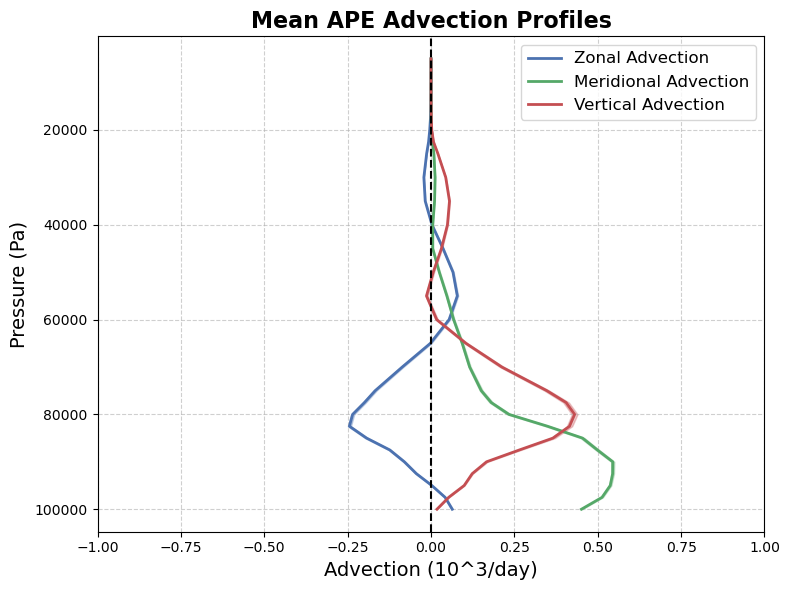

In [361]:
# Convert your lists of profiles to 2D NumPy arrays.

# Each array has shape (n_samples, 29), where n_samples is the number of APE events.

zonal_profiles = np.array(all_zonal_profiles)

merid_profiles = np.array(all_meridional_profiles)

vertical_profiles = np.array(all_vertical_profiles)

# Compute the mean profile along the sample axis (axis=0).
mean_zonal = np.mean(zonal_profiles, axis=0)

mean_merid = np.mean(merid_profiles, axis=0)

mean_vertical = np.mean(vertical_profiles, axis=0)

# Calculate standard errors (with degrees of freedom = 1).

n_zonal = zonal_profiles.shape[0]

n_merid = merid_profiles.shape[0]

n_vertical = vertical_profiles.shape[0]

se_zonal = np.std(zonal_profiles, axis=0, ddof=1) / np.sqrt(n_zonal)

se_merid = np.std(merid_profiles, axis=0, ddof=1) / np.sqrt(n_merid)

se_vertical = np.std(vertical_profiles, axis=0, ddof=1) / np.sqrt(n_vertical)

# Get the t-value for a 95% confidence interval.
# t.ppf(0.975, df) returns the critical value for a two-tailed 95% CI.
t_zonal = t.ppf(0.975, df=n_zonal - 1)

t_merid = t.ppf(0.975, df=n_merid - 1)

t_vertical = t.ppf(0.975, df=n_vertical - 1)

# Compute the margin of error (CI = t * SE).

ci_zonal = t_zonal * se_zonal

ci_merid = t_merid * se_merid

ci_vertical = t_vertical * se_vertical

# Assume pressure is a 1D array of 29 levels (e.g., in hPa)
# Adjust the values below to match your actual pressure levels.

max_val = np.max([np.abs(mean_zonal + ci_zonal),
                  np.abs(mean_merid + ci_merid),
                  np.abs(mean_vertical + ci_vertical)])
xlimit = np.ceil(max_val * 1.1)  # add 10% margin

# Define a custom color palette.

color_zonal = '#4C72B0'    # blue

color_merid = '#55A868'    # green

color_vertical = '#C44E52' # red

# Create the plot
plt.figure(figsize=(8, 6))

# Plot the mean profiles and add uncertainty bands using fill_betweenx.
plt.plot(mean_zonal, pressure, label='Zonal Advection', linewidth=2, color=color_zonal)

plt.fill_betweenx(pressure, mean_zonal - ci_zonal, mean_zonal + ci_zonal,
                  color=color_zonal, alpha=0.3)

plt.plot(mean_merid, pressure, label='Meridional Advection', linewidth=2, color=color_merid)

plt.fill_betweenx(pressure, mean_merid - ci_merid, mean_merid + ci_merid,
                  color=color_merid, alpha=0.3)

plt.plot(mean_vertical, pressure, label='Vertical Advection', linewidth=2, color=color_vertical)

plt.fill_betweenx(pressure, mean_vertical - ci_vertical, mean_vertical + ci_vertical,
                  color=color_vertical, alpha=0.3)

# Invert the y-axis so that pressure decreases upward.
plt.gca().invert_yaxis()

plt.xlim(-xlimit, xlimit)
plt.axvline(x=0, color='black', linestyle='--', linewidth=1.5)

# Add labels, title, legend, and grid.
plt.xlabel('Advection (10^3/day)', fontsize=14)

plt.ylabel('Pressure (Pa)', fontsize=14)

plt.title('Mean APE Advection Profiles', fontsize=16, fontweight='bold')

plt.legend(fontsize=12)

plt.grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()

plt.show()

In [391]:
apes['zonal_advection_profile'] = all_zonal_profiles

apes['meridional_advection_profile'] = all_meridional_profiles

apes['vertical_advection_profile'] = all_vertical_profiles

In [392]:
dry_apes = dryapes[['date', 'latitude', 'longitude']].copy()

dry_apes['dryape'] = True

apes = apes.merge(dry_apes, on=['date', 'latitude', 'longitude'], how='left')

apes['dryape'] = apes['dryape'].fillna(False)

wet_apes = wetapes[['date', 'latitude', 'longitude']].copy()

wet_apes['wetape'] = True

apes = apes.merge(wet_apes, on=['date', 'latitude', 'longitude'], how='left')

apes['wetape'] = apes['wetape'].fillna(False)

/tmp/ipykernel_13935/1614783727.py:7: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  apes['dryape'] = apes['dryape'].fillna(False)
/tmp/ipykernel_13935/1614783727.py:15: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  apes['wetape'] = apes['wetape'].fillna(False)


In [402]:
dry_zonal_profiles = apes[apes['dryape']==True][['zonal_advection_profile']].values

dry_meridional_profiles = apes[apes['dryape']==True][['meridional_advection_profile']].values

dry_vertical_profiles = apes[apes['dryape']==True][['vertical_advection_profile']].values

wet_zonal_profiles = apes[apes['wetape']==True][['zonal_advection_profile']].values

wet_meridional_profiles = apes[apes['wetape']==True][['meridional_advection_profile']].values

wet_vertical_profiles = apes[apes['wetape']==True][['vertical_advection_profile']].values

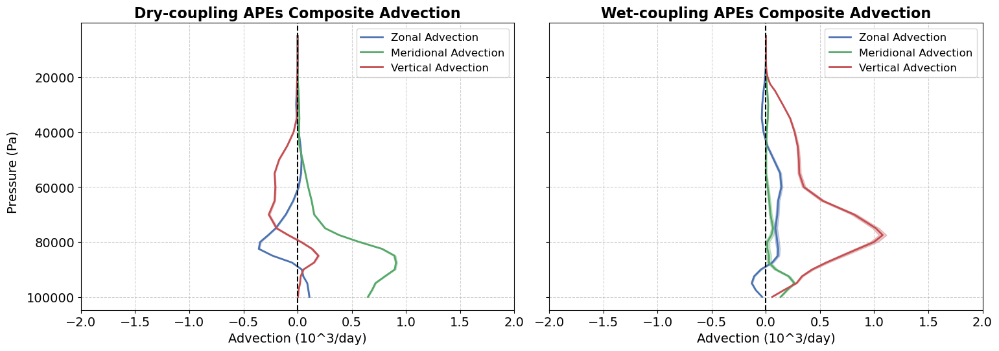

In [415]:
# -- Extract and convert profiles for dry and wet cases --

# For Dry APEs
pressure = daily_avg['level'].data * 100

dry_zonal = np.array(apes[apes['dryape'] == True]['zonal_advection_profile'].tolist())

dry_merid = np.array(apes[apes['dryape'] == True]['meridional_advection_profile'].tolist())

dry_vertical = np.array(apes[apes['dryape'] == True]['vertical_advection_profile'].tolist())

# For Wet APEs
wet_zonal = np.array(apes[apes['wetape'] == True]['zonal_advection_profile'].tolist())

wet_merid = np.array(apes[apes['wetape'] == True]['meridional_advection_profile'].tolist())

wet_vertical = np.array(apes[apes['wetape'] == True]['vertical_advection_profile'].tolist())

# -- Function to compute mean and 95% CI --
def compute_stats(profiles):
    """
    profiles: 2D array of shape (n_samples, 29)
    Returns: mean (1D, 29), margin of error (CI, 1D, 29)
    """
    mean_profile = np.mean(profiles, axis=0)
    n = profiles.shape[0]
    se = np.std(profiles, axis=0, ddof=1) / np.sqrt(n)
    t_val = t.ppf(0.975, df=n - 1)
    ci = t_val * se
    return mean_profile, ci

dry_mean_zonal, dry_ci_zonal = compute_stats(dry_zonal)

dry_mean_merid, dry_ci_merid = compute_stats(dry_merid)

dry_mean_vertical, dry_ci_vertical = compute_stats(dry_vertical)

wet_mean_zonal, wet_ci_zonal = compute_stats(wet_zonal)

wet_mean_merid, wet_ci_merid = compute_stats(wet_merid)

wet_mean_vertical, wet_ci_vertical = compute_stats(wet_vertical)

# -- Determine symmetric x-axis limits for each subplot --
max_dry = np.max([np.abs(dry_mean_zonal + dry_ci_zonal),
                  np.abs(dry_mean_merid + dry_ci_merid),
                  np.abs(dry_mean_vertical + dry_ci_vertical)])
xlimit_dry = np.ceil(max_dry * 1.1)  # 10% extra margin

max_wet = np.max([np.abs(wet_mean_zonal + wet_ci_zonal),
                  np.abs(wet_mean_merid + wet_ci_merid),
                  np.abs(wet_mean_vertical + wet_ci_vertical)])

xlimit_wet = np.ceil(max_wet * 1.1)

# -- Define a custom color palette --

color_zonal = '#4C72B0'    # blue

color_merid = '#55A868'    # green

color_vertical = '#C44E52' # red

# -- Create the figure with two subplots side by side --
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

# Plot for Dry APEs on ax1
ax1.plot(dry_mean_zonal, pressure, label='Zonal Advection', linewidth=2, color=color_zonal)

ax1.fill_betweenx(pressure, dry_mean_zonal - dry_ci_zonal, dry_mean_zonal + dry_ci_zonal,
                  color=color_zonal, alpha=0.3)

ax1.plot(dry_mean_merid, pressure, label='Meridional Advection', linewidth=2, color=color_merid)

ax1.fill_betweenx(pressure, dry_mean_merid - dry_ci_merid, dry_mean_merid + dry_ci_merid,
                  color=color_merid, alpha=0.3)

ax1.plot(dry_mean_vertical, pressure, label='Vertical Advection', linewidth=2, color=color_vertical)

ax1.fill_betweenx(pressure, dry_mean_vertical - dry_ci_vertical, dry_mean_vertical + dry_ci_vertical,
                  color=color_vertical, alpha=0.3)

ax1.invert_yaxis()
ax1.set_xlim(-xlimit_dry, xlimit_dry)
ax1.axvline(x=0, color='black', linestyle='--', linewidth=1.5)
ax1.set_xlabel('Advection (10^3/day)', fontsize=14)
ax1.set_title('Dry-coupling APEs Composite Advection', fontsize=16, fontweight='bold')
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.legend(fontsize=12)

# Increase tick label size for ax1
ax1.tick_params(axis='both', labelsize=14)

# Plot for Wet APEs on ax2
ax2.plot(wet_mean_zonal, pressure, label='Zonal Advection', linewidth=2, color=color_zonal)

ax2.fill_betweenx(pressure, wet_mean_zonal - wet_ci_zonal, wet_mean_zonal + wet_ci_zonal,
                  color=color_zonal, alpha=0.3)

ax2.plot(wet_mean_merid, pressure, label='Meridional Advection', linewidth=2, color=color_merid)

ax2.fill_betweenx(pressure, wet_mean_merid - wet_ci_merid, wet_mean_merid + wet_ci_merid,
                  color=color_merid, alpha=0.3)

ax2.plot(wet_mean_vertical, pressure, label='Vertical Advection', linewidth=2, color=color_vertical)

ax2.fill_betweenx(pressure, wet_mean_vertical - wet_ci_vertical, wet_mean_vertical + wet_ci_vertical,
                  color=color_vertical, alpha=0.3)

ax2.invert_yaxis()
ax2.set_xlim(-xlimit_wet, xlimit_wet)
ax2.axvline(x=0, color='black', linestyle='--', linewidth=1.5)
ax2.set_xlabel('Advection (10^3/day)', fontsize=14)
ax2.set_title('Wet-coupling APEs Composite Advection', fontsize=16, fontweight='bold')
ax2.grid(True, linestyle='--', alpha=0.6)

ax2.legend(fontsize=12)

# Increase tick label size for ax2

ax2.tick_params(axis='both', labelsize=14)

# Common y-label for the figure

fig.text(0.04, 0.5, 'Pressure (Pa)', va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.03, 1, 0.95])

plt.gca().invert_yaxis()

plt.show()


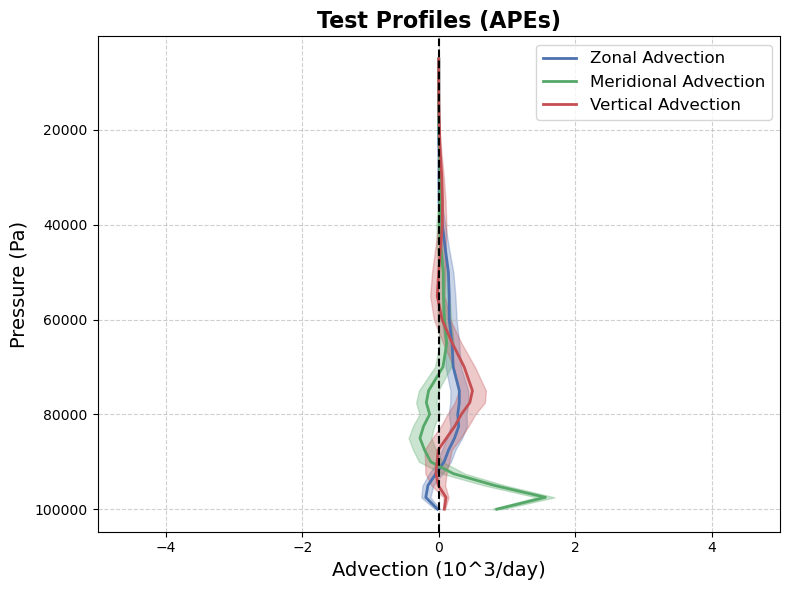

In [446]:
test_lon = -96

test_lat = 31

# -- Extract test profiles for a specific longitude and dry APE condition --
# Note: use the correct column names for each profile.
test_zonal = np.array(apes[(apes['longitude'] == test_lon) & 
                            (apes['latitude'] == test_lat)]['zonal_advection_profile'].tolist())
test_meridional = np.array(apes[(apes['longitude'] == test_lon) & 
                           (apes['latitude']== test_lat)]['meridional_advection_profile'].tolist())
test_vertical = np.array(apes[(apes['longitude'] == test_lon) & 
                              (apes['latitude']== test_lat)]['vertical_advection_profile'].tolist())

# -- Function to compute mean profile and 95% confidence interval --
def compute_stats(profiles):
    """
    profiles: 2D array of shape (n_samples, 29)
    Returns: mean (1D array of length 29), margin of error (CI, 1D array of length 29)
    """
    mean_profile = np.mean(profiles, axis=0)
    n = profiles.shape[0]
    se = np.std(profiles, axis=0, ddof=1) / np.sqrt(n)
    t_val = t.ppf(0.975, df=n - 1)
    ci = t_val * se
    return mean_profile, ci

test_mean_zonal, test_ci_zonal = compute_stats(test_zonal)
test_mean_merid, test_ci_merid = compute_stats(test_meridional)
test_mean_vertical, test_ci_vertical = compute_stats(test_vertical)

# -- Assume pressure is defined (here using the daily_avg levels converted to Pa) --
pressure = daily_avg['level'].data * 100  # Adjust if needed

# -- Determine symmetric x-axis limit for test profiles --
max_test = np.max([
    np.abs(test_mean_zonal + test_ci_zonal),
    np.abs(test_mean_merid + test_ci_merid),
    np.abs(test_mean_vertical + test_ci_vertical)
])
xlimit_test = np.ceil(max_test * 1.1)  # 10% extra margin

# -- Define custom colors --
color_zonal = '#4C72B0'    # blue
color_merid = '#55A868'    # green
color_vertical = '#C44E52' # red

# -- Create the plot for the test profiles --
plt.figure(figsize=(8, 6))

plt.plot(test_mean_zonal, pressure, label='Zonal Advection', linewidth=2, color=color_zonal)
plt.fill_betweenx(pressure, test_mean_zonal - test_ci_zonal, test_mean_zonal + test_ci_zonal,
                  color=color_zonal, alpha=0.3)

plt.plot(test_mean_merid, pressure, label='Meridional Advection', linewidth=2, color=color_merid)
plt.fill_betweenx(pressure, test_mean_merid - test_ci_merid, test_mean_merid + test_ci_merid,
                  color=color_merid, alpha=0.3)

plt.plot(test_mean_vertical, pressure, label='Vertical Advection', linewidth=2, color=color_vertical)
plt.fill_betweenx(pressure, test_mean_vertical - test_ci_vertical, test_mean_vertical + test_ci_vertical,
                  color=color_vertical, alpha=0.3)

# Invert y-axis (pressure decreases upward)
plt.gca().invert_yaxis()

# Make x-axis symmetric and add vertical zero line
plt.xlim(-5, 5)
plt.axvline(x=0, color='black', linestyle='--', linewidth=1.5)

# Add labels, title, legend, and grid
plt.xlabel('Advection (10^3/day)', fontsize=14)
plt.ylabel('Pressure (Pa)', fontsize=14)
plt.title('Test Profiles (APEs)', fontsize=16, fontweight='bold')
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()

plt.show()
